# Problem Statement:
Many news aggregators face the challenge of common news stories published from many
providers. The importance of grouping based on similarity is very much important, so it can save
end users’ reading time. This is a more sort of clustering problem where similar articles should
be in the same group.

### IMPORT LIBRARIES

In [1]:
import pandas as pd
import re 

import nltk 
from nltk.tokenize import RegexpTokenizer
from collections import Counter 
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

import numpy as np 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.feature_extraction.text import TfidfVectorizer, TfidfTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics  import classification_report
from sklearn import metrics
import time

### LOAD DATASET

In [2]:
news_dataset=pd.read_csv("uci-news-aggregator.csv")

In [3]:
news_dataset

,ID,TITLE,URL,PUBLISHER,CATEGORY,STORY,HOSTNAME,TIMESTAMP
0,1,"Fed official says weak data caused by weather,...",http://www.latimes.com/business/money/la-fi-mo...,Los Angeles Times,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.latimes.com,1394470370698
1,2,Fed's Charles Plosser sees high bar for change...,http://www.livemint.com/Politics/H2EvwJSK2VE6O...,Livemint,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.livemint.com,1394470371207
2,3,US open: Stocks fall after Fed official hints ...,http://www.ifamagazine.com/news/us-open-stocks...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371550
3,4,"Fed risks falling 'behind the curve', Charles ...",http://www.ifamagazine.com/news/fed-risks-fall...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371793
4,5,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,http://www.moneynews.com/Economy/federal-reser...,Moneynews,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.moneynews.com,1394470372027
...,...,...,...,...,...,...,...,...
422414,422933,Surgeons to remove 4-year-old's rib to rebuild...,http://www.cbs3springfield.com/story/26378648/...,WSHM-TV,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.cbs3springfield.com,1409229190251
422415,422934,Boy to have surgery on esophagus after battery...,http://www.wlwt.com/news/boy-to-have-surgery-o...,WLWT Cincinnati,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.wlwt.com,1409229190508
422416,422935,Child who swallowed battery to have reconstruc...,http://www.newsnet5.com/news/local-news/child-...,NewsNet5.com,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.newsnet5.com,1409229190771
422417,422936,Phoenix boy undergoes surgery to repair throat...,http://www.wfsb.com/story/26368078/phoenix-boy...,WFSB,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.wfsb.com,1409229191071


In [4]:
# Find all category
category = list(news_dataset['CATEGORY'].unique())
category

['b', 't', 'e', 'm']

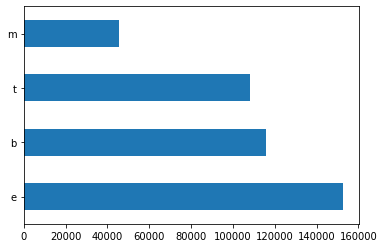

In [5]:
news_dataset['CATEGORY'].value_counts().plot(kind='barh')
plt.show()

In [6]:
# Check null values
news_dataset.isnull().sum()

ID           0
TITLE        0
URL          0
PUBLISHER    2
CATEGORY     0
STORY        0
HOSTNAME     0
TIMESTAMP    0
dtype: int64

### Text Preprocessing

In [7]:
# Text preprocessing
def preprocess(text):
    
    """
    Function: split text into words and return the root form of the words
    Args:
      text(str): the article
    Return:
      lem(list of str): a list of the root form of the article words
    """
        
    # Normalize text
    text = re.sub(r"[^a-zA-Z]", " ", str(text).lower())
    
    # Tokenize text
    token = word_tokenize(text)
    
    # Remove stop words
    stop = stopwords.words("english")
    words = [t for t in token if t not in stop]
    
    # Lemmatization
    lem = [WordNetLemmatizer().lemmatize(w) for w in words]
    
    return lem

In [8]:
news_dataset["Preprocessed_Title"] = news_dataset['TITLE'].apply(lambda x: preprocess(x))
news_dataset.head(10)

,ID,TITLE,URL,PUBLISHER,CATEGORY,STORY,HOSTNAME,TIMESTAMP,Preprocessed_Title
0,1,"Fed official says weak data caused by weather,...",http://www.latimes.com/business/money/la-fi-mo...,Los Angeles Times,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.latimes.com,1394470370698,"[fed, official, say, weak, data, caused, weath..."
1,2,Fed's Charles Plosser sees high bar for change...,http://www.livemint.com/Politics/H2EvwJSK2VE6O...,Livemint,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.livemint.com,1394470371207,"[fed, charles, plosser, see, high, bar, change..."
2,3,US open: Stocks fall after Fed official hints ...,http://www.ifamagazine.com/news/us-open-stocks...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371550,"[u, open, stock, fall, fed, official, hint, ac..."
3,4,"Fed risks falling 'behind the curve', Charles ...",http://www.ifamagazine.com/news/fed-risks-fall...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371793,"[fed, risk, falling, behind, curve, charles, p..."
4,5,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,http://www.moneynews.com/Economy/federal-reser...,Moneynews,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.moneynews.com,1394470372027,"[fed, plosser, nasty, weather, curbed, job, gr..."
5,6,Plosser: Fed May Have to Accelerate Tapering Pace,http://www.nasdaq.com/article/plosser-fed-may-...,NASDAQ,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.nasdaq.com,1394470372212,"[plosser, fed, may, accelerate, tapering, pace]"
6,7,Fed's Plosser: Taper pace may be too slow,http://www.marketwatch.com/story/feds-plosser-...,MarketWatch,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.marketwatch.com,1394470372405,"[fed, plosser, taper, pace, may, slow]"
7,8,Fed's Plosser expects US unemployment to fall ...,http://www.fxstreet.com/news/forex-news/articl...,FXstreet.com,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.fxstreet.com,1394470372615,"[fed, plosser, expects, u, unemployment, fall,..."
8,9,US jobs growth last month hit by weather:Fed P...,http://economictimes.indiatimes.com/news/inter...,Economic Times,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,economictimes.indiatimes.com,1394470372792,"[u, job, growth, last, month, hit, weather, fe..."
9,10,ECB unlikely to end sterilisation of SMP purch...,http://www.iii.co.uk/news-opinion/reuters/news...,Interactive Investor,b,dPhGU51DcrolUIMxbRm0InaHGA2XM,www.iii.co.uk,1394470501265,"[ecb, unlikely, end, sterilisation, smp, purch..."


### Text Exploration

In [9]:
# Find the common words in each category
def find_common_words(df, category):
        
    """
    Function: find the most frequent words in the category and return the them
    Args:
      df(dataframe): the dataframe of articles
      category(str): the category name
    Return:
      the most frequant words in the category
    """
        
    # Create dataframes for the category
   # cat_df = df[df["category"]==category]
    
    # Initialize words list for the category
    words = [word for tokens in df["Preprocessed_Title"] for word in tokens]
    
    # Count words frequency
    words_counter = Counter(words)
 
    return words_counter.most_common(10)

In [10]:
print("Most common words in each category")
for c in category:
    print(c, " News")
    print(find_common_words(news_dataset, c))
    print()

Most common words in each category
b  News
[('new', 24461), ('u', 20453), ('google', 12545), ('say', 10944), ('apple', 10473), ('video', 10155), ('star', 8549), ('first', 8446), ('report', 8331), ('samsung', 8284)]

t  News
[('new', 24461), ('u', 20453), ('google', 12545), ('say', 10944), ('apple', 10473), ('video', 10155), ('star', 8549), ('first', 8446), ('report', 8331), ('samsung', 8284)]

e  News
[('new', 24461), ('u', 20453), ('google', 12545), ('say', 10944), ('apple', 10473), ('video', 10155), ('star', 8549), ('first', 8446), ('report', 8331), ('samsung', 8284)]

m  News
[('new', 24461), ('u', 20453), ('google', 12545), ('say', 10944), ('apple', 10473), ('video', 10155), ('star', 8549), ('first', 8446), ('report', 8331), ('samsung', 8284)]



In [11]:
news_dataset['Preprocessed_Title1'] = news_dataset['Preprocessed_Title'].apply(' '.join)
news_dataset.head()

,ID,TITLE,URL,PUBLISHER,CATEGORY,STORY,HOSTNAME,TIMESTAMP,Preprocessed_Title,Preprocessed_Title1
0,1,"Fed official says weak data caused by weather,...",http://www.latimes.com/business/money/la-fi-mo...,Los Angeles Times,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.latimes.com,1394470370698,"[fed, official, say, weak, data, caused, weath...",fed official say weak data caused weather slow...
1,2,Fed's Charles Plosser sees high bar for change...,http://www.livemint.com/Politics/H2EvwJSK2VE6O...,Livemint,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.livemint.com,1394470371207,"[fed, charles, plosser, see, high, bar, change...",fed charles plosser see high bar change pace t...
2,3,US open: Stocks fall after Fed official hints ...,http://www.ifamagazine.com/news/us-open-stocks...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371550,"[u, open, stock, fall, fed, official, hint, ac...",u open stock fall fed official hint accelerate...
3,4,"Fed risks falling 'behind the curve', Charles ...",http://www.ifamagazine.com/news/fed-risks-fall...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371793,"[fed, risk, falling, behind, curve, charles, p...",fed risk falling behind curve charles plosser say
4,5,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,http://www.moneynews.com/Economy/federal-reser...,Moneynews,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.moneynews.com,1394470372027,"[fed, plosser, nasty, weather, curbed, job, gr...",fed plosser nasty weather curbed job growth


In [12]:
# Determine data and target
X = news_dataset['Preprocessed_Title1']
y = news_dataset['CATEGORY']

### Feature Extraction¶
 #### use TF-IDF method to extract the text features.

In [13]:
# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

In [14]:
# Use TF-IDF
tf_vec = TfidfVectorizer()
train_features = tf_vec.fit(X_train)
train_features = tf_vec.transform(X_train)
test_features = tf_vec.transform(X_test)

### Modeling


## USING K-MEANS CLUSTERING ALGORITHM

In [15]:
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import cosine_similarity


In [16]:
km = KMeans(n_clusters=4, random_state=None).fit(train_features)

In [17]:
labels = km.labels_
clusters = labels.tolist()

In [18]:
clusters

[1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [23]:
c_list = [ [] for i in range(4) ]
for i, cluster in enumerate(clusters):
    tfidf_news = train_features[i,:]
    if cosine_similarity(tfidf_news, km.cluster_centers_[cluster].reshape(1, -1))[0][0] > 0:
        c_list[cluster].append(i)

In [21]:
c_list

[[],
 [],
 [2457,
  2471,
  3539,
  4266,
  5021,
  5675,
  7672,
  8676,
  9296,
  10853,
  11057,
  12591,
  12893,
  14358,
  15421,
  16925,
  17503,
  18374,
  21540,
  21730,
  22268,
  22342,
  22791,
  24054,
  24072,
  26531,
  26590,
  29920,
  30063,
  30327,
  30414,
  31415,
  33390,
  33595,
  33715,
  35069,
  35602,
  36536,
  37122,
  37420,
  37560,
  40648,
  40747,
  41669,
  42707,
  43468,
  43568,
  44458,
  51467,
  51635,
  52096,
  53379,
  53416,
  53979,
  55999,
  58211,
  59943,
  60899,
  61403,
  61598,
  63130,
  63675,
  64558,
  67168,
  67238,
  68050,
  68648,
  68806,
  69416,
  69513,
  71447,
  73378,
  74849,
  76404,
  76560,
  78196,
  78491,
  78498,
  81286,
  81563,
  82467,
  83137,
  83212,
  84245,
  85975,
  86119,
  86595,
  87627,
  88406,
  88997,
  90063,
  92355,
  93751,
  95909,
  96085,
  96088,
  96778,
  98643,
  99575,
  99826,
  100076,
  100667,
  101845,
  101984,
  102328,
  103184,
  103360,
  105231,
  105820,
  108398,

In [39]:
for i, group in enumerate(c_list):
    #if len(group) < 3:
     #   continue
    print('TOPIC', i)
    for id in group:
        print(news_dataset.TITLE[id])
    print()

TOPIC 0
Fed risks falling 'behind the curve', Charles Plosser says
ECB to reveal bad loan hurdles for euro zone bank test
ECB's Christian Noyer says 'not happy' with euro's rise
EBay asks shareholders to vote against Icahn board nominees
EBay says Carl Icahn's board picks 'not qualified'
McDonald's sales decline as chain looks to adapt to changing tastes
McDonald's posts weak February sales results
McDonald's Reports a 0.3 Percent Drop in February Sales, U.S. Down 1.4 percent
Five years after stock meltdown, most Cleveland-area companies have  ...
Market Hustle: Stocks Fall on Weak Asian Data, Ukraine Gas Tensions
Despite several obstacles, the bull market makes it to year 5
Bull market still has some sizzle
Mt. Gox Seeks U.S. Court Shield During Japan Bankruptcy
'Hacked docs' prove MtGox has 1 MILLION Bitcoins, claim blog-snatchers
Mt. Gox files for bankruptcy in US
Hackers Claim to Have Evidence of Fraud Surrounding Mt. Gox Closure
Hackers Break Into Mt. Gox CEO's Blog, Reveal Custom

Has 'Dancing With the Stars' finally found the right formula?
TV Monday: Nobody puts Tom Bergeron in the corner
Chris Pine Pleads Guilty To DUI, Loses License
Chris Pine Pleads Guilty To Drink Driving But Wanted To Avoid Conviction To  ...
Chris Pine pleads guilty to drunk driving
NZ court fines Chris Pine for DUI
Chris Pine Admits Drink Driving In New Zealand
Star Trek actor Chris Pine: I was driving after drinking four vodkas
`Star Trek` star Chris Pine pleads guilty to DUI
Chris Pine Gets Flocked by Fans Outside New Zealand Court
Film star Chris Pine pleads guilty
Johnny Depp, Amber Heard Host Dark Engagement Party
Stooges' Scott Asheton, the Cornerstone of...
Legendary punk-rock band Stooges drummer Scott Asheton dies at 64
Iggy and the Stooges drummer Scott Asheton passes away
The Stooges drummer Scott Asheton dies at 64
RIP Scott Asheton
Britney Spears - Britney Spears' Sister Weds In Las Vegas
Jamie Lynn Spears Marries James Watson In New Orleans Wedding
Jamie Lynn Spears Marrie

Game of Thrones stars attend New York premiere
Team Dark-Haired Emilia Clarke Will Enjoy The Awkward Dance She Did During  ...
George RR Martin suggests movie possibility
Thrones author says film a possibility
“Game of Thrones” fourth season premiere
George RR Martin Teases Possible 'Game of Thrones' Movies
Game of Thrones Premiere Draws Stars and Crowds to NYC
'Game of Thrones' Meets 'The Wolf of Wall Street' in 'The Dworf of Westeros  ...
Trailer: 'Game of Thrones' Secrets
“Game of Thrones” Season Four Premieres in New York City
HBO puts fans first with Facebook fueled 'Game of Thrones' premiere in NYC
Paul Walker's Mom Fights for Custody of Granddaughter, Claims His Ex Is Unfit
Paul Walker's Mum Files For Guardianship Of Fast And Furious Star's Teenage  ...
Eminem is Coming Home – with Rihanna – in 'Monster Tour': Ticket Info
Eminem & Rihanna Presale Tickets: QueenBeeTickets.com Announces Discount  ...
Rihanna, Eminem will tour together this summer as part of the concert series  ...

GWAR frontman Dave Brockie dies
Gwar frontman David Brockie, 50, found dead at Virginia home
Music Video Of The Day: GWAR 'Carry On Wayward Son'
GWAR fans mourn loss of Oderus Urungus (aka Dave Brockie); share your  ...
GWAR's Oderus Urungus (aka Dave Brockie) dead at 50; watch his last Detroit  ...
The Sly, Shocking Soul of GWAR
Passings: David Brockie (aka Oderus Utungus) of GWAR (1963 - 2014)
Gwar lead singer found dead in Virginia home
Gwar's Dave Brockie: Here's to a bloody great frontman
Remembering GWAR leader David Brockie, 50, a First Ave favorite
GWAR's Dave Brockie aka 'Oderus Urungus' Dead at 50
'The Voice': Are Contestants Madilyn Paige & Tanner James Dating?
Dawn and Hawkes vs Josh Murley – The Voice Battle Rounds – Stuck In the  ...
Who Went Home On The Voice 2014 Season 6 Tonight? 3/24/2014
Watch Madilyn Paige vs. Tanner James on The Voice 2014 Season 6 Battle  ...
'The Voice' battle rounds week 2 starts tonight: Blake has a tough choice
Nick Cannon Wears Whiteface To P

Amazon Plans a Free Ad-Supported Streaming Service
Amazon schedules 'video business' NYC event for next week, to finally reveal set  ...
Amazon to Host Event on April 2, Could Feature TV Streaming Box
Amazon Is Holding a Video Event on April 2
Amazon Is Going To Announce Its Streaming Media Gadget At An Event In New  ...
Amazon may reveal its set-top box next week in New York
Slkinbox Receiving Chromecast Support Soon
Competition Commission slaps Rs 1 crore fine on Google
With iPad app, Microsoft begins to move out of the office
Microsoft unveils Office software for Apple iPad
Apple won't get squat from Office for iPad sales, UBS says
Microsoft Launches Office for iPad: Free to View, Subscription to Edit
Microsoft confirms Office for iPad, expands cloud services
Microsoft unveils Office for the iPad
Microsoft relents: Office for iPad launches with freemium strategy
Microsoft releases Office apps for iPad
Office for iPad is out, lets you view documents for free
Microsoft announces Offic

Minecraft Video Game Update and Rumors: Game's Creator Cancels Version of  ...
Tech's baby-faced multi-millionaires — and billionaires
GamesBeat community: Write about VR and win The Witch and the Hundred  ...
This Oculus Rift competitor will work on PlayStation 4, Xbox One, and PC
Gas Prices Surging in Bay Area
Lenovo Recalls ThinkPad Batteries Worldwide Due to Fire Hazard
Lenovo recalls thousands of ThinkPads, overheating battery could cause a fire
Apple, Samsung to revive patent battle in US court
Apple Inc. and Samsung Electronics to renew smartphone and tablet patent battle
Apple, Samsung renew copyright battle Monday
Report claims Yahoo! plans to lure YouTube stars to its own video service
Mozilla plunged into crisis as three board members quit over CEO appointment
'I will not work with Facebook... they seem creepy to me'
Mozilla CEO Responds to Prop 8 Controversy
Brendan Eich's appointment as Mozilla CEO causes ripples across company
Microsoft Offering $100 For You To Upgrade Yo

Election commission allows RBI to announce new bank licences
Why interest rates will remain high
Rajan warns of turmoil in markets if polls deliver unstable govt
Sensex, Nifty attain record closing high
Window for differential bank licence soon: Rajan
UPDATE 2-India c.bank leaves rates on hold; election, monsoon in focus
Banks should not levy penal charges for non-maintenance of minimum balances  ...
5 concerns Raghuram Rajan has about India
Rajan Leaves India Key Rate Unchanged as Inflation Eases (1)
Rajan Leaves India Key Rate Unchanged as Inflation Eases
Monetary Policy: RBI keeps policy rates, CRR unchanged
RBI voices concern over LS polls, keeps key policy rates unchanged
White House says more than 7M have enrolled under Affordable Care Act
Maryland health exchange expected to adopt Connecticut's technology
Greece said to plan 2 billion-euro bond sale in first half
'Too Big to Fail' still thriving
Riot police, anti-austerity protesters clash in Greece
Greece to return to bond mark

Ben and Jerry's Free Cone Day
Ice Cream Social with Ben & Jerry's Jeff Furman
Snap up a scoop for nothing: Ben and Jerry's 'Free Cone Day'
Why Is Jennifer Lawrence on the Cover of 'Martha Stewart: Weddings'?
Jennifer Lawrence Wears J. Crew For Her First Wedding Magazine Cover
PICS: Jennifer Lawrence as a bridesmaid
Chinese Ming-era 'chicken cup' sells for record $38.5 million
Ming dynasty 'chicken cup' $36M sale smashes record
China asks US to refrain from Hong Kong affairs
Tiny, ultra-rare Ming Dynasty 'chicken cup' smashes records after fetching $36  ...
Ming Dynasty 'chicken cup' sold for record $36M - WNCN: News, Weather for  ...
Record $27.6 Million Jadeite Necklace Sold at Sotheby's
China Warns US To Stay Out Of Hong Kong Over Democratic Reform
China warns US not to meddle in Hong Kong over reform
Typhoon warning: Is Hong Kong the epicentre of the next financial crisis?
Financial typhoon warning for Hong Kong
The Wookiee is back! Peter Mayhew 'to reprise role of Chewbacca' in Sta

iPad hacker's conviction tossed out on technicality
Weev Is Free, Because You Can't Prosecute a Hacker Just Anywhere
Court Overturns Conviction of iPad Hacker Weev
3rd Circ. Nixes Hacker's Conviction For AT&T Data Breach
Hacker Weev Free After Appeal
Astronomers May Have Spotted A Moon Orbiting an Extrasolar Planet
First Evidence Of a Possible 'Exomoon' Found
Samsung offering tons of freebies with Galaxy S5
Samsung Galaxy S5: Payments via Fingerprint Sensor Launched by Paypal
The HTC One M8 is better than the Galaxy S5, just ask HTC
12 fun tips and hidden tricks inside Samsung's Galaxy S5
Verizon Wireless Announces The Release Of The Samsung Galaxy S5
Best Samsung Galaxy S5 deals in South Africa
National Grilled Cheese Day: Celebrate with a 20-layer grilled cheese! [Video]
Celebrate grilled cheese day with these important cheese facts
Get it while it's hot: A restaurant in Chicago is serving a $100 grilled cheese  ...
A Raisin in the Sun - Broadway
Khloe Kardashian 'Ignores Lamar Odom 

'GMA' adds Michael Strahan to mix
Cody Simpson - Cody Simpson Voted Off America's Dancing With The Stars
TV ratings: 'Dancing With the Stars' leads Monday viewership
Who Went Home On Dancing with the Stars 2014 Last Night? Week 5
It's Disney week featuring your favorites on 'Dancing with the Stars'
'Dancing with the Stars' recap: Meryl Davis dethroned, Cody Simpson sent home
'Dancing With The Stars' week 5 elimination - Find out who went home (Spoilers)
Dancing With the Stars 2014 Recap: Disney Night Shocker! Still Magical or  ...
Dancing with the Stars Recap: Cody & Witney Out (4/14/14)
Disney Week on "Dancing with the Stars"...and shocking elimination
Cody Simpson Dancing With the Stars Samba Video 4/14/14 #DWTS
Dancing With The Stars Takes On Disney Songs
FX's 'Fargo' Brings More Midwestern Murder
Philadelphia Daily News Ellen Gray column
Murder, Snow and Minnesota Nice: The Return of 'Fargo'
What to Watch on Tuesday: New 'Fargo' is deeply, darkly funny
FX's 'Fargo' a worthy compani

Home Loan Requirements In Effect For 2014 - Loan Love Clarifies the New  ...
Wednesday's Refinance and Mortgage Interest Rates at Chase Bank Apr 16
Yellen helps Asia currencies crawl higher
Federal Reserve Chair Wants Further Stimulus for Job Market
Forex - AUD/USD edges lower after downbeat Australia data
Asian stocks struggle higher, lack conviction
US stocks end mostly higher
Earnings lift S&P 500, Nasdaq
US stocks rise as Ukraine tension eases amid corporate results
Can the Nasdaq Turn This Bounce Into a True Reversal?
U.S. Stocks Open Lower
U.S. Stock Futures Edge Higher
Stocks Gain, Dow Rises Triple Digits At Midday
Asian stocks higher, US markets closed for Good Friday
ASIA MARKETS: Asian Shares Rise; Nikkei Rebound Continues
Nikkei jumps
Asian stocks mostly higher after mixed US earnings - KTVN Channel 2 - Reno  ...
Nikkei's early gains erased by profit-taking
Japan's Topix Swings After Steepest Rally in Two Months
Nikkei bounces on Wall Street performance
Tokyo shares soar on 

Stars gather to support Bob as daughter Peaches laid to rest
Listen To Jack White “Lazaretto” (Stream)
Hear Jack White's ultra-fast Record Store Day single
Mad Men Mondays: 'What The Government Is Doing About Our Drinking Problem'
'Tell the truth, Don'
The Mad Men Style Report Card: Season 7, Episode 2
A not very happy Valentine's Day for the characters in “Mad Men.” (AMC photo)
Don and Sally Draper Are Forced to Keep It Real in Latest 'Mad Men' Episode
Terry Richardson Accused Of Soliciting Sex From ANOTHER Model!? You  ...
Celebrity Photographer Fights New Allegations of Impromper Sexual Conduct
Vogue Reveals It Has Cut Ties With Terry Richardson Following Latest Sexual  ...
Apparently, Terry Richardson Is Trading Sex For A Vogue Cameo
Model Posts Screenshot Of Creepy Text Allegedly Proving Terry Richardson  ...
Emma Appleton: Terry Richardson Offered Vogue Photo Shoot if He Could F--k  ...
Steven Spielberg & Tom Hanks May Reteam for New Cold War Drama
Game of Thrones Power Shift: Ty

Ebola outbreak death toll in West Africa over 140
Ebola virus death toll continues to rise in West Africa
Ebola Virus Disease in West Africa: 208 Cases, 136 Deaths
Ebola death toll rises to over 140 in Liberia, Guinea
West Africa's Ebola outbreak prompts changes in I.Coast cuisine
FDA announces rules restricting e-cigarettes and cigars
The FDA proposed a ban on selling e-cigarettes to minors. (Credit: Audrey C  ...
FDA pitches e-cigarette regulations
FDA Proposes First E-Cigarette Rules
FDA E-Cig Regulations
E-cigarettes sale to be banned to US minors
Vapers, take note: The FDA wants to clamp down on e-cigarettes
Your money is dirtier than it looks: 3000 different bacteria thrive on the bills
Obama rule cuts coal dust in mines by 25%
Marijuana, heart complications interlinked: study
Marijuana use may increase heart complications in young, middle-aged adults
Saudi reports 11 new Mers infection cases
Sharp rise in MERS cases, many human spread, has world health experts  ...
Home health c

Atari games dug up from 'grave' after 30 years
Long-lost legendarily bad 'ET' video game found in landfill
Google, Volvo Test Drive Autonomous Cars on City Streets
Volvo begins testing autonomous cars on city streets
Google Self-Driving Car Completes Test Drive in Mountain View, Ready to  ...
Google's self-driving car tests focused on city driving
Google Says Driverless Cars Mastering City Streets
Video: What the Google Self-Driving Car Sees
Google self-driving car now on the streets
Ocean Springs student's design for Google wins him a trip to California
Carl Albert Middle School student wins state Google Design Competition
Ocean Springs student's doodle advances in Google competition
Portland 3rd-grader up for national Doodle 4 Google award
Charlotte third-grader finalist in national “Doodle for Google” competition
Vote for Local Student in "Doodle 4 Google" Contest
Valley girl's drawing chosen for Doodle 4 Google contest
Photos: Olympus High student wins Utah Doodle 4 Google competit

Eczema is linked to lower skin cancer risk
Nigerian Government Vows to Find Kidnapped Girls
Plan is offered to solve medical custody dispute - CBS 3 Springfield - WSHM
MERS patient is isolated in Indiana hospital
Hospital: Preliminary tests show that hospital staff, patient's relatives don't have  ...
Saudi MERS cases reach more than 400, more than 100 dead
MERS: CDC confirms first US case of Middle East respiratory syndrome
Editorial: Travel ban to
1st American MERS patient improving and may be released from hospital soon  ...
HEALTH LAUNCHES AWARENESS CAMPAIGN ON MERS
US trade deficit narrows but not enough to help
US trade gap narrows in March
Disney second quarter earnings beat expectations, helped by Frozen, Thor
Disney Flies Past Expectations With Q2 Earnings On Continued Success Of  ...
Disney's Earnings Aren't Frozen
Company Update: The Walt Disney Company (NYSE:DIS) – The Walt Disney  ...
Disney Profit Rises as 'Frozen' DVD Tops Home-Video Chart
Walt Disney Holds Bullish Histo

Scientists add new letters to genetic code of life
Scientists Create Living Organism Using Controversial Artificial DNA
Scientists create first organisms to pass on artificial DNA
First life forms to pass on artificial DNA engineered by US scientists
Mayor Lee, city leaders pedal to City Hall for 20th Bike to Work Day
Ride of Silence bicycle ride to be held in Portage next week
Portal for Android on NVIDIA SHIELD Review
Indian cities, led by Delhi, have the worst air says WHO
Cities in India Among the Most Polluted, WHO Says New Delhi's polluted air  ...
Breathing world's dirtiest air, Delhi needs to clean up its act now
Our dangerously dirty cities
Bangladesh 4th most polluted in world
WHO study report on India's air pollution a 'shocker': NGO
Shrimpers Catch Rare Goblin Shark Off Florida Keys
Tablet shipments waning, but still outpace laptops: Canalys
The demise of the tablet has been greatly exaggerated
Go Figure: Tablet Satisfaction Declines As Budget Models Launch
iPad stays on to

Moto E specs, images leaked ahead of launch
Motorola Moto E official images and specifications leaked online
AEG Tech Updates – 11 May 2014
Motorola Moto X Now Available for ₹19999 under Buy-Back Scheme in India
Motorola Moto E Complete Specifications List Along with Photos Leak
Mid-Range Motorola Moto E Spotted In Leaked Images With Full Specs
Motorola Moto E photos leak ahead of Tuesday launch event
Android this week: Moto E appears and new Nexus devices are hinted
Moto X+1 Release Date, Specs & Price: Android 4.4.3, Snapdragon 800, 5.2in  ...
Moto X+1 Appears On Motorola Website, Again
Motorola Moto E: Everything We Know So Far
BlackBerry fights back
Touch and go? BlackBerry launches low-cost phone in bid to revive sales
BlackBerry's “Jakarta” handset arrives in Indonesia for $191
US Republicans harden positions on climate change
Global warming will create higher costs at grocery stores
Climate change: A cure worse than the disease
With New Push, New Language: Now It's "Climate Disr

Game Of Thrones Season 4 Episode 8 Preview: The Mountain and the Viper
Game of Thrones, Mockingbird review: Best GIFs from season 4, episode 7
Michael Jackson 'hologram' and Kendall's flub get BMA buzz
Justin Timberlake thanks everyone 'but Donald Sterling' for Billboard award
Justin Timberlake Jabs Donald Sterling During Billboard Music Awards
And the winners are... 2014 Billboard Music Awards
Billboard Music Awards Hit 13-Year Ratings High
Billboard Music Awards 2014: Nicki Minaj Almost Had A Wardrobe Malfunction
Billboard Music Awards 2014: Complete Winners List!
Ratings: Michael Jackson Hologram Lures Most 'Billboard Music Awards  ...
Let's All Watch Kendall Jenner Being "The Worst Reader" at Last Night's  ...
Michael Jackson's hologram rocks Billboard Music Awards 2014
ABC's Billboard Music Awards Scores Most-Watched Telecast in 13 Years
Justin Timberlake, Michael Jackson Hologram & Kendall Jenner Goof Mark Most  ...
Timberlake, Imagine Dragons are Big Winners at Billboard Awards


Jolie talks 'Maleficent,' mastectomy, kidnap victims
New 'Maleficent' trailer cleverly mashes up 'Sleeping Beauty' and the Angelina  ...
Angelina Jolie: We don't want our children to be actors
Michael Jace's Wife Stood Up for Him, Saying He Was A Great Dad
Neighbors Say Michael Jace's Wife Left With Their Kids The Night Before Her  ...
Michael Jace turned himself in for shooting his wife
Guitarist's estate says Led Zeppelin lifted 'Stairway to Heaven' part
Led Zeppelin sued for stealing Stairway to Heaven
Lawsuit looms over Led Zeppelin song
Led Zeppelin's 'Stairway to Heaven' Targeted for Plagiarism
Amazon Adds HBO Series to Prime Instant Video Including 'Boardwalk Empire  ...
Which HBO Shows Are Now On Amazon Prime?
Maksim Chmerkovskiy & Meryl Davis React to Dancing With the Stars Win  ...
Meryl Davis and Maksim Chmerkovskiy win season eighteen of 'Dancing with  ...
Is Len Goodman Really Leaving Dancing With the Stars?
Amy Purdy & Derek Hough: Our Accomplishments Are Better Than The 

Standard & Poor's closes above 1900 for first time
S&P 500 Closes In On New High,But Volume Lags
DAILY BRIEFING Wall St. - Midday report
Today's Dow Jones Industrial Average DJIA Nasdaq S&P 500 stock market  ...
Wall Street gains as small-caps rally; biotech lifts Nasdaq
Experts expect Memorial Day weekend traffic to be busier
Gas prices have familiar look again this summer
Gasoline Futures Gain on Higher Memorial Day Driving
Gasoline prices look familiar
Gas prices edge higher in state
Summer gas prices look familiar
Pre-summer gas prices have familiar look – $3.65 a gallon
Statewide gas price average up two cents before Memorial Day
Bay Area Tech Companies Fare Well in Glassdoor Review of Benefits  ...
How tech companies keep using perks to win the 'war on talent'
The 14 Tech Companies With The Best Pay
Uber vs. taxis
Trade tensions mount
U.S. automakers win WTO trade victory over China
US Claims Win in Auto Trade Dispute With China
U.S. wins trade ruling that China imposed illegal d

Wealthy real estate developer who is anonymously stashing cash around San  ...
Reaction Mixed To FCC Data Broker Report
Starbucks testing build-your-own burgers restaurant
Chiquita is valued at $1 billion and WhatsApp 19 times that—the numbers that  ...
Is the US heading towards a trade war with China?
'China pushes banks to remove IBM servers'
Chinese government threatens IBM's bank server business with shut out
China Tells Local Banks to Avoid IBM Servers as US Spying Row Escalates
Median CEO pay crosses $10 million in 2013
The Average CEO Makes How Much?!?
5 reasons CEOs got a huge raise (and 5 reasons you didn't)
Health care tops other industries for highest median CEO pay, again
Public Company CEO Pay Hits High Mark
CEO given $60 million lump sum to buy out contract
Daily business briefing: CEO pay up
Intel, China's Rockchip in Android tablets alliance
Sector Update: Technology
Tech Stocks Still Adding to Earlier Gains; Intel, Chinese Rival Teaming to Work  ...
News & Analysis Int

Obama to announce new pollution targets for power plants
US plans 30% cuts in power carbon emissions
Kansas governor decries EPA carbon emissions rule
Texas remains near top for Fortune 500 companies
HSBC: China manufacturing improves but needs stimulus
China HSBC PMI at 4-month high, but still contracts
Factory sector expands at slightly faster pace in May as orders climb
India factory orders hit 3-month high
India manufacturing output hits 3-month high
Markets Performance Dependent On Upcoming Manufacturing ISM Report
UK Market Advances
Euro Drops As Eurozone Manufacturing Activity Slows
Polish Manufacturing PMI Eases to 50.8, 11-Month Low
China factory activity rises to 5-month high
Futures slide after Dow, S&P 500 hit record highs
Stock Futures Steady Into Factory Orders; Nasdaq Continues to Trade Defensively
US futures dip
Dow, S&P 500 end at record highs; Apple, Google drag on Nasdaq
Apple and Google weigh on Nasdaq
Market Wrap For June 2: Dow, S&P Continue Rising, Nasdaq Slightl

It's not a good day if you're superstitious! Rare event sees the full moon fall on  ...
Five things to do: Full moon risin' and hot cars
20 Full Moon Artworks To Welcome Tonight's Spooky Honey Moon
Forecast: Shower chance Thursday night
'Honey Moon' Will Sweeten Our Skies Tonight
Full moon meets Friday 13th
Tomorrow's Friday the 13th full moon is so rare, it won't happen again until 2049
Full moon falls on Friday the 13th
Full moon and Friday the 13th collide this week
Facebook's two-faced deal: Slate opinion
Now users can alter their Ad Profiles in Facebook
Facebook to let advertisers see where you're surfing
Facebook allows users to skip targeted adverts
Facebook makes big changes to ad targeting
No Targeted Facebook Ads for You, If You Want
Facebook makes some big changes to its advertisements
Facebook: Ads are 'better' by using users recent Web usage from elsewhere on  ...
Facebook gives users the tools to remove ads based on topic
Facebook expands users' ad targeting profiles
How 

Kennedy roadwork not a problem, it's a looming traffic nightmare
Kennedy Closures: Details and detours you need to know
Williams poised to acquire Access Midstream
Chinese Yuan Posts Biggest Gain In 2.5 Years
ECB policymaker: bank tests may be too tough
European Central Bank Policymaker: Bank Tests May Be Too Tough
ECB inflation could give a hint to future ECB action
'Europe bank stress tests may be too tough'
Funds keep faith with eurozone money markets
Monday Morning Business Brief
Traders await Fed signals
Yen, Swiss franc rise on Iraq concerns, pound at 5-yr high vs dollar
GLOBAL ECONOMY WEEKAHEAD-Fed in focus as investors seek reassurance
UPDATE 3-Brent up near $113 on supply worries as Iraq violence rises
GLOBAL MARKETS-Asian shares struggle, oil firms on Iraq anxiety
Yen firms in Asia on Iraq, pound hits 5-year high
Crude Nears 8-Month Highs Amid Escalating Tension In Iraq
Kiev Says Russia Has Cut Off All Gas To Ukraine
EU Gas Fears As Russia Restricts Ukraine Supply
Russia cuts

Tumblr Sponsored Posts Now Promoted Across Yahoo
How Yahoo's Diversity Numbers Compare To Google's
Hands On With Lightroom Mobile For The iPhone
Adobe launches new art apps for smartphones, tablets
Adobe updates Creative Cloud with new apps, new features, and even new  ...
Adobe unveils Creative Cloud updates, apps
Adobe Up 6%: FYQ2 Beats; Q3 View Light; Raises Recurring Forecast
Today's Best Stocks: Adobe Systems Incorporated (NASDAQ:ADBE  ...
Will Adobe Shares Hit $100?
Adobe results beat estimates on strong subscription growth
Today's Top Wall Street Stories: Adobe Systems Incorporated (NASDAQ:ADBE  ...
adobe%e2%80%99s cloud solutions fuel strong financial results
Adobe Systems (ADBE): Stock With Unusual Social Activity
Better Buy Now: SolarCity or SunPower?
SolarCity Corp's Silevo Purchase A Positive Strategic Move
Press Release - NextGen Delivering Promised Efficiency for Airlines and  ...
Siemens Boss In Paris To Sell Deal For Alstom
The Fed Has Affected Rational Market Performan

Kristen Bell and Dax Shepard Expecting a Second Baby! (VIDEO)
Dax Shepard and Kristen Bell are expecting their second child together
Aww, Kristen Bell and Dax Shepard Are Expecting Baby Number 2!
'The Bachelorette' Andi Dorfman: I get my biggest shock of the season next week
'The Bachelorette' Season 10, Episode 6 Recap: Because Nothing Says  ...
American Young To Be Featured In Upcoming Episode Of ABC's Hit Romance  ...
Bachelorette 2014: Who Is Eliminated Contestant Cody Sattler?
The Bachelorette 2014 LIVE Recap: Season 10 Episode 6 Andi Dorfman
Chris Harrison blogs 'The Bachelorette' episode 6
Spoilers for 'The Bachelorette 2014': Andi heads to Belgium in episode 10x07
The Bachelorette Review: Do You Swear To Tell The Truth?
'The Bachelorette' 2014 episode 7 spoilers: It's time to head to Belgium
Bachelorette 2014 Spoilers: Who Goes Home Tonight? 6/23/2014
Bachelorette 2014: Cody Sattler Gets Sent Home on his Solo Date [SPOILER]
Oldman's Playboy interview stirs controversy
Oldman co

AP: Florida Lags In Home, Community Services For The Disabled
Excessive drinking causes 1 in 10 deaths among working-age adults
Check out the feds' new 'heavy drinker' definition — 'That seems awfully low'
Alcohol leads to one in 10 working-age deaths
Report: 1 in 10 working age Wisconsin adults die from excessive alcohol effects
CDC Report Shows Dangers Of Excessive Drinking
A Simple Blood Test Could Help Predict The Risk Of Breast Cancer, Study Finds
New blood test might be used to predict which women will get breast cancers  ...
Breast cancer drug hope from leukaemia research
Blood test in development to predict breast cancer risk
Breast cancer blood test gives women hope for early warning
WHO Warns against Proportion of Ebola Outbreak in West Africa
WHO urges 'drastic action' on Ebola
Ebola epidemic in West Africa: WHO urges comprehensive inter-country response
Runaway Ebola Patient Strikes Terror
'Drastic action is needed' now to stop Ebola
Outbreak Watch: Ebola Needs 'Drastic Act

Aaliyah Biopic On Hold As Actress Pulls Out
`Aaliyah` biopic put on hold as lead star Zendaya backs out
Zendaya is Aaliyah no more!
Zendaya Coleman Drops Out of Aaliyah Biopic, Production Is Now On Hold
Erykah Badu Tries To Kiss WPIX Reporter During Broadcast About Shia  ...
ERYKAH BADU HILARIOUSLY CRASHES LIVE NEWS REPORT
Watch Erykah Badu Get Rejected By A Newscaster
Melissa McCarthy and our nasty, tedious habit of confusing a woman's worth  ...
Melissa McCarthy Was Rightly Offended By This Backhanded Article! See What  ...
Shia LaBeouf: A Troubled Timeline Leading Up to the Actor's Latest Arrest
Mick Jagger Mocks Monty Python As "Old Men Trying To Relive Their Youth  ...
Mick Jagger Pokes Fun at Himself and the Stones in Promo Video for Monty  ...
'Sexting' linked to sex in middle school
Have you had the 'sext' talk with your kids?
Have you had the 'sexting' talk with your kids?
Sexting by tweens linked to real-life sexual activity
Plan to End AIDS Epidemic in New York State Announc

Titanfall Xbox One Launch: Microsoft Releases Critically Acclaimed First-Person  ...
Titanfall launching at 792p for Xbox One, resolution "likely to increase"
Titanfall Will Increase Resolution Post Launch
Titanfall ships at 792p on Xbox One, post-release resolution 'likely to increase'
Titanfall wallpapers for your Windows Phone
Standby for Titanfall: We Talk With Respawn CEO Vince Zampella
Microsoft Xbox One Titanfall Another Non-1080p Title
Microsoft's Walt Whitman store girds for Titanfall landing
Toys R Us Is Offering 50% Off A Game With Purchase Of Titanfall
Titanfall review in progress
Titanfall takes aim at the cloud: 'We've really let the designers go crazy'
Titanfall: Xbox One resolution confirmed to be 792p, is 'likely' to be increased  ...
Gamers get their hands on long-awaited 'Titanfall'
Titanfall Tuesday Release Means Great Deal on Xbox One, Find Out When You  ...
The launch of 'Titanfall' will push the Xbox One to its limits
Insider claims Titanfall has already helped s

RI heating oil drops ten cents a gallon
Why Does Ohio Have Such Erratic Gas Prices?
Weekly gas prices: Surge in Nebraska almost triple of national increase
Amarillo Gas Prices Rise Again
As Temps Rise, So Do Gas Prices
Texas Weekly Gas Price Update and Outlook
Gas prices still rising
Gas prices continue to rise in state
Gas prices headed upwards
Ohio gas prices flatten out after weeks of increases; still higher than national  ...
Gasoline prices rise 1.6 cents over last week
What's Behind the Price of Gas Last Week
Gas price up nearly 8 cents in Yakima area
Survey: US average gas price up 10 cents a gallon
Rockford gas prices see another spike
Gas prices in NH rise 2 cents over past week
Savannah metro gas prices dip slightly
Gas prices up 3.4 cents
Gas Prices continue to Rise
Nashville's per-gallon gas price average unchanged
Ohio gas prices steady to start the week
Gas Prices Stay at $3.63 in PA
AAA Mich.: Gas prices fall 1 cent over past week
Gas prices rise
Maine gas prices rise 2.

Juan Pablo Called 'The Worst Bachelor Ever?' Producers Of 'The Bachelor' Can't  ...
Juan Pablo Galavis Defends Offensive 'Retard' Twitter Joke
'The Bachelor' Juan Pablo Spoilers: Galavis' Mom Talks 'Very Rude' Son, Star  ...
Juan Pablo 'The Bachelor 2014' spoilers: 'lots of fighting' now with final lady
'The Bachelor': Worst hunk? Bad ending?
Juan Pablo Galavis Controversy: 'Bachelor' Star Blames His Poor English for  ...
'The Bachelor' star re-tweets offensive joke and fans blast him for insensitivity
Why Clare Crawley Will NOT Win The Bachelor 2014
Why Nikki Ferrell Should NOT Win the Bachelor 2014
Juan Pablo Galavis and Bachelor 2014 Winner Already Near Breakup — Report
Which Bachelors Did NOT Propose in the Finale?
Bachelor star Juan Pablo Galavis blames poor English for mocking the mentally  ...
2014 Season 18 'Bachelor' Juan Pablo Girls Spoilers: Winner Disappointed  ...
Bachelor's Chris Harrison Fights With Juan Pablo After Andi Dorfman Quits  ...
Juan Pablo Defends R-Word Twitt

Neil Young launches US$399 Pono Music player to 'save us from MP3s'
iPod rival PonoMusic will cost just $399
Neil Young's music player for audiophiles reaches Kickstarter on March 15th
Neil Young Set to Launch PonoMusic
Food and Social Media Converge in Film at #SXSW
Favreau goes from 'Iron Man' to stainless steel food truck in new film
Jon Favreau goes from 'Iron Man' to stainless steel food truck in new film
Jon Favreau To Direct, Star In New Cooking Movie For Much Needed Change  ...
What To Expect From Jon Favreau's New Movie 'Chef'
Bigger can be better or worse at SXSW Film
'Chef' Is A Double Passion Project for Jon Favreau: Food and Film [Clip + Pictures]
The Early Word on Jon Favreau's New Film Chef
Favreau goes from Iron Man to stainless steel food truck
From Iron Man to food truck man
Jon Favreau sizzles as 'Chef' at SXSW
Iron Man veteran trades armor suit for kitchen knives
Jon Favreau's 'Chef': First Look and Early Buzz
Jon Favreau On His New Movie 'Chef', Rules Out A Tinder-

Libya MPs in new bid to oust PM after rebel oil shipment
Ship leaves Libya rebel port carrying oil- UPDATED
Ship leaves Libya rebel port carrying oil, official and gunmen say
Morning Glory pops out
Libya parliament votes to bring down Zeidan government
Tanker laden with Libyan rebel oil slips naval escort
Libya: Impounded North Korean-flagged vessel escapes
Libyan Govt Threatens to Destroy North Korean Oil Tanker in Rebel Territory
Oil tanker now in international waters, says GNC member
N. Korean Tanker Escapes to Sea with Cargo of Libyan Rebel Oil
Rebel group manoeuvres over Libya's oil could lead to renewed civil conflict
Libya says North Korean oil ranker Morning Glory seized
Libya impounds tanker registered in Sharjah
North Korean-flagged tanker escapes in new humiliation for Libya
Ship leaves Libya rebel port carrying oil- report
Libya threatens to bomb N.Korean tanker if it ships oil from rebel port
Brincat gives no details asLibya tanker standoff continues
Tanker laden with Liby

Sprint's owner to make major policy speech Tuesday in Washington
Sprint Owner May Push T-Mobile Merger As Broadband Competition Solution
Entner: A Japanese reality check for Sprint and SoftBank
SoftBank chief will pit Sprint-T-Mobile against cable companies
Twitter Back Online After Brief Outage
Twitter blames software glitch for latest crash
Twitter Blacks Out for All Users
Twitter crashes for a second time in nine days
Twitter blames software glitch for lengthy crash
Twitter says most users having 'issues' accessing service
Twitter goes down — and there's no place now for the Internet to freak out
Twitter blames software glitch for outage
Twitter crashes 2nd time in 9 days, blames software glitch
Twitter crashes second time in nine days, blames software glitch
UPDATE 1-Twitter crashes 2nd time in 9 days, blames software glitch
Twittapocalypse! Twitter implodes, locked out tweeps around the world
Twitter crashes for second time in nine days
Twitter crashes again, software glitch blame

The Unreleased Film Noah is Already Banned!
Russell Crowe's New Movie Noah 'Re-Cut By Studio'
Noah Studio Cut Featured 'Religious Montage and Christian Rock Song'
'Noah' Movie Makes First Waves In Mexico Despite Religious Controversy [Trailer]
Darren Aronofsky: Noah is the perfect film to bring believers and non-believers  ...
Bahrain cinema bosses back the big ban on "Noah"
Studio cut of Noah 'featured religious montage and Christian rock song'
Watch The Ark Knight Rise in new Noah clip
NOAH presents the Ark Featurette
Early Reactions To Darren Aronofsky's Noah Hit The Web
'Noah' banned in 3 countries
Watch: First Clip from Darren Aronofsky's 'Noah'
Three Arab countries ban new 'Noah' film before release
First Clip From Darren Aronofsky's Noah
Cinemas back ban on movie
Hollywood blockbuster 'Noah' faces ban in Arab world
'Noah' banned in three countries weeks before world premiere
Noah Clip: A Great Flood is Coming
New 'Noah' clip reveals plan to survive the flood
Watch: First Clip & 

20 Strangers Kiss For The First Time On Camera
Watch viral video of 20 strangers' first kiss - sweet or awkward?
Director Tatia Pilieva pairs off 20 strangers for love in 'First Kiss'
Watch How Awkward And Sweet It Is When 20 Complete Strangers Kiss On  ...
Watch 20 Strangers Share a First Kiss
PICK OF THE WEEK: First Kiss Video
Video: Artist shows strangers kissing for the first time
Video: 20 straight, gay strangers asked to kiss; you will be surprised to see the  ...
Video of Strangers Kissing for the First Time Is Strangely Adorable
7 Perfect YouTube Comments on That Cute 'FIRST KISS' Video
Viral video: 20 strangers asked to kiss for the first time
This could be the sweetest video you'll watch today 1:21PM
This Video of Total Strangers Kissing For the First Time is Awkward and Adorable
Filmmaker gets 20 complete strangers to kiss for the first time
20 Strangers Kiss For The First Time - Video
Watch: 20 strangers kissing each other for the first time is just as awkward as it  ...
20

US stocks mixed on Ukraine fears; Dow slides 0.07%
Wall Street little changed as Ukraine, China concerns brushed off
Nasdaq, S&P 500 Reverse Higher
Stock Prices Reverse Higher
Wall Street little changed amid concerns about Ukraine
US stocks shake off listless start to finish mostly higher, led by oil refiners, tech  ...
Stocks rebound but investors remain wary of crisis in Ukraine
S&P 500 rises a bit, and Dow Jones drops a little as investors watch Ukraine
China fears hit world stocks; copper recovers from near four-year low
S&P 500 Erases Loss as Investors Weigh Economy, Ukraine Crisis
Stocks Close Mostly Higher After Shaky Start
A late rise saved the stock market from a third straight day of losses.
US stocks turn mixed after a weak start
Stocks shake off an early slump, close mixed; S&P 500 narrowly avoids its third  ...
Stock Market Today: Dow Jones Industrial Average Falls, These Stocks Soar
Stock market struggles to a mixed finish
Stocks close mixed; Dow falls for a third day
Wal

Zillow Mortgage Marketplace: 30-Year Rate Rises
30-Year Fixed Mortgage Rates Jump 10 Basis Points; Current Rate is 4.21  ...
Mortgage Interest Rates at TD Bank Experience a Steep Rise on March 11, 2014
Chase Bank Made No Change to its Mortgage Interest Rates on March 11, 2014
Today's Mortgage Home Loan Rates at Capital One (March 11, 2014)
Guaranteed Rate Expanding Mortgage Lending Presence in Mid-Atlantic
Mortgage Interest Rates Remain Unchanged at BB&T Bank on March 11, 2014
Mortgage Interest Rates Show No Movement at US Bank Corp on March 11, 2014
Current Mortgage Rates at Wells Fargo for March 11
Best Mortgage Rates at Bank of America (March 11, 2014)
Better Mortgage Rates at Commerce Bank, HSBC and Citizens Bank (March 11)
Mortgage Rate Summary for BMO Harris Bank, Capital One and Quicken Loans  ...
Mortgage Rates Unchanged at Wells Fargo, US Bank and PHH Mortgage Today  ...
Mortgage Interest Flat at TD Bank, Chase Bank and PNC Bank Today (March 11)
Best Mortgage Rates Today at BB

The World Wide Web is 25 years old
The World Wide Web is 25 years old, can rent a car
Web Magna Carta proposed to thwart US and UK government snooping
Moments that shaped the web
The Web at 25: How it changed my life
The Web we want
25 Years Later: How a 'Mesh' Turned Into the World Wide Web
Tim Berners-Lee, Inventor Of World Wide Web, Calls For Online 'Bill Of Rights'
World Wide Web turns 25-years-old
What Would An Internet Bill Of Rights Look Like?
What It Was Like to Surf the Web in 1989
Inventor of the World Wide Web, Tim Berners-Lee, hosts Ask Me Anything Reddit  ...
Inventor of Web calls for digital bill of rights on Internet's 25th anniversary
Happy 25th birthday www: 8 ways the web has changed our lives
Web inventor calls for Internet Bill of Rights
The Web at 25: I was a teenage dial-up addict
Is Surfin' The Web A Human Right? Its Founder Thinks So...
Sir Tim Berners-Lee calls for 'Magna Carta' bill of rights for world wide web
5 predictions for the Web that were WAY off
World

The Veronica Mars Movie Is More of the Same, and That's a Beautiful Thing
With the help of thousands, 'Veronica Mars' is reborn on the big screen
Veronica Mars Cast Performs Epic Marshmallow Challenge!
Fans' Fiction: Veronica Mars Gets Kickstarted Into Adulthood
Crowd-funding helps to get Veronica Mars on big screen
'Veronica Mars' hits the big screen with dramatic flair
'Veronica Mars': Where Are They Now
Veronica Mars Bad Boy Talks Relationships
Now a Major Motion Picture
I Love Television™
'Veronica Mars' movie has small-screen feel
'Veronica Mars' Infographic: Catch Up on Her History and Mysteries
Veronica Mars, Logan Echolls, and Our Silly Need to 'Ship
Seven TV shows that would make great movies
Scott D. Pierce: Time for a celebration —Veronica Mars is back!
CS Video Interviews: Kristen Bell and the Cast of Veronica Mars Return!
Review: 'Veronica' a solid cinematic turn
6 TV Shows We'd Like To See Get The Big-Screen, 'Veronica Mars' Treatment
Kristen Bell's best red carpet looks


A common psychiatric disorder becoming more popular among young adults
ADHD Medication Use in Adults Doubles
More young adults taking ADHD meds
Use of ADHD Drugs Increasing Rapidly Among US Adults
Prescriptions for ADHD Drugs Doubled for Adults in Last Four Years
ADHD prescriptions skyrocket in US
ADHD Drug Use Surges in US With Young Women Leading Increase
Number of Adults Using ADHD Drugs Reaches New High
Use of ADHD Drugs Surges With Young Women Leading Gain
Report: Adults Using ADHD Medications On The Rise
Prescriptions for ADHD drugs double among adults
The ADHD explosion: How much do you know about the disorder?
SARAH VINE: ADHD and why we working mums need to look in the mirror
Missed ADHD Diagnosis, Lost Childhood
The associations between ADHD and asthma in Korean children
FDA Approves Electric Headband for Migraines
Cefaly Headband For Migraines Receives FDA Approval Despite Lackluster  ...
Cefaly -- a new device to stop a migraine in its tracks
FDA approves device for prevent

Eat Momofuku, Twin Peaks Pies at Dear Mom Today
Vancouver celebrates Pi Day with experiments and pie
Pie flies as Detroit school celebrates Pi Day
Happy Pi Day: Eat a piece of pie to celebrate mathematics on 3/14
What We Should Actually Eat on Pi Day
Top 10 Pies for Pi Day
14 Pi Day Pies You Definitely Have to Try! Because PIE.
Celebrate National Pi Day by Indulging in These Delicious Pies
It's National (Pi) Pie Day – here's where to grab a slice
Happy National Pi Day
Try This Raw "Apple Pi" for Pi Day!
It's Pi Day, and there's no better way to celebrate than a slice of pie
It's Pi Day! Celebrate 3.14 with 10 perfect pie recipes
Happy Pi Day! Here's 5 Pie Recipes To Celebrate 3.14 Plus Fun Facts
6 Pie Movies to Help You Celebrate Pi Day
Chemical Kim: St. Patty's Green Pi Pies
National Pi Day 2014 Celebrate Math with Pizza and Pie Deals Today
Celebrate Pi Day
It's Pi Day, And Pie Day, Too
Celebrate Pi Day with what else?
Happy Pi Day! Here are 15 vegan pie recipes.
Restaurants, pastry s

'Mr. Peabody And Sherman' Rules Box Office For Second Consecutive Week
'Mr. Peabody' top dog at US box office, revs past 'Speed,' '300'
'Mr. Peabody & Sherman' No. 1 at U.S. box office; 'Need for Speed' is No. 3
Animation Animates the Box Office
Fetching 'Peabody & Sherman' tops box office in week 2
Mr. Peabody tops North American box office
Mr Peabody and Sherman top dog in US box office
'Peabody & Sherman' rises to top of weekend box office
'Mr. Peabody' overtakes '300' sequel at box office
Fetching 'Mr. Peabody & Sherman' tops box office with $21.2M
Box Office: 'Mr. Peabody and Sherman' Bites Into Top Spot, 'Need for Speed' in  ...
'Mr. Peabody & Sherman' Tops US Weekend Box Office, Overtaking '300: Rise of  ...
'Mr. Peabody & Sherman' rises to No. 1 at the box office
'Mr. Peabody' Leads Box Office as Video-Game Movie Disappoints
TOP 10 MOVIES AT THE WEEKEND BOX OFFICE
300: Rise of an Empire knocked "Mr. Peabody & Sherman" way back at the box  ...
'Mr. Peabody & Sherman' tops box of

US core CPI up 0.1%
Inflation slows to just 1.1 percent through February
US consumer prices rose as expected in February
DHM Markets/Marketers: CPI, LGM-Dairy
US home construction fell for a 3rd month in February but building permits rose
US CPI rises 0.1% in February; core prices inch up 0.1%
US Consumer Prices Tick Up 0.1 Percent
Inflation slows to just just 1.1 percent through February
Consumer prices edge up in February as food prices jump
Consumer prices edge up 0.1% in February
Experts forcast 5% decrease in food prices
Inflation rate drops to 7.7% –NBS
Mt.Gox is back ... sort of
Mt. Gox Teases Old Customers With a Screenshot of Their Balance
Mt. Gox updates website, allows customers to...
Mt. Gox lets users see bitcoin balances
Mt. Gox allows customers to check bitcoin balances
Mt. Gox allows users to check Bitcoin balances
Japanese bank Mizuho faces legal action over Mt. Gox collapse
Mt. Gox updates website, allows customers to check bitcoin balances
Mt. Gox lets customers view

Colorado unemployment rate down in January
Wichita unemployment rate higher in January; state's rate fell
State jobless rate closes in on nation's
Unemployment rate drops – again
North Carolina's jobless rate decreases in January
Iowa Unemployment Rate Ticks Up
Interactive Data: Vermont's unemployment rate drops to 4 percent
State Jobless Rate Drops in January from December
Unemployment rates
America's unemployment rate falls
Florida's jobs market weakens in January after 2013 turns out better than thought
Florida unemployment rate drops to 6.1 percent; Collier-Lee rise
5 Things to Know in Florida for March 18
Hawaii's unemployment dropped to 4.6 percent in January
Unemployment rates for the counties of eastern Alabama in January.
Area employment dips with loss of holiday jobs in January
Fla. unemployment rate drops to 6.1 percent
Mixed News As Indiana Unemployment Rate Drops
Unemployment rates drop in 43 US states
Hawaii jobless rate down slightly in January
Jobless rate rises in Janu

Apple releases the 8GB iPhone 5c across Europe
Apple introduces cheaper version of the iPhone 5C with 8GB storage
Apple discontinues iPad 2 and replaces it with fourth-generation iPad with  ...
Apple to launch less costly 8GB iPhone 5c, relaunch 'iPad 4'
Fourth gen 16GB iPad replaces discontinued iPad 2
Apple reportedly set to fight iPhone 5c flop with new cheaper version launching  ...
Apple quietly tries to fix iPhone 5c flop with new cheaper model
New 8GB iPhone 5C is cheaper on O2, at £410
iPhone 5c now available in 8GB option, £429 SIM-free in the UK
Apple discontinues iPad 2 in favour of 16GB iPad 4 as new entry-level model
Samsung To Start Making Retina Displays For iPad Mini 2
Concept design shows larger Apple iPad Pro having iPhone5S-like TouchID
Report: An 8GB iPhone 5C Launches Tomorrow
Apple releases 8GB version of iPhone 5c, retires iPad 2
iPhone 5C 8GB: Apple Launches Cheaper iPhone
Cheaper 8GB iPhone 5C goes official, iPhone 6 ready for mass production in Q2
Apple Inc. R

'I Was a Paid Hypocrite': Actor Who Called His Own TV Show 'Filth' Explains Why  ...
Angus T. Jones Talks Religion and Two And a Half Men With Texas TV Station
Former 'Two and a Half Men' star Angus Jones still hates show
'Two and a Half Men' star Angus T. Jones has criticised the sitcom again
Former Two and a Half Men star Angus T. Jones sorry for insulting Chuck Lorre's  ...
Two and a Half Men Child Star Now Fully Bearded, Preaching Against His  ...
Angus T. Jones Slams Two and a Half Men Again: I Was "Paid Hypocrite" (VIDEO)
'Two and a Half Men' star Angus T. Jones denounces series
The kid from Two and a Half Men said his role was like being a 'paid hypocrite  ...
Former "Two and a Half Men" star opens up about leaving show, his faith
A 'bad day' in rehab costs Chris Brown his freedom
Chris Brown to remain behind bars
Chris Brown to remain in jail until probation hearing
LA court orders Chris Brown to remain in custody until hearing
'Bad day' in rehab costs Chris Brown his freedom
J

Angelina Jolie Has Badass Wings, Loses Them In Maleficent Trailer
Angelina Jolie's Maleficent Gets Her Wings In A New Banner & Teaser
Maleficent Unveils Her Wings in New Banner and Trailer
My God, Would You Look at Maleficent's Wings
Disney's 'Maleficent': “Maleficent's Wings” Clip and Poster
Angelina Jolie's "Maleficent" spreads her wings in new clip
Disney Maleficent's Wings: Film gives title character a winged backstory
Maleficent Doesn't Have to Explain Her Wings to You (VIDEO)
Maleficent Wings Teaser Trailer: Angelina Jolie Flies!
Angelina Jolie Spreads Her Wings In New 'Maleficent' Poster
New Banner, Stills and Trailer for Maleficent Starring Angelina Jolie
New 'Maleficent' trailer teaser, banner released
New 'Maleficent' Trailer Preview and Banner Tease the Mystery of Her Wings
See Angelina Jolie's Daughter, Vivienne Jolie-Pitt, With Her Mom In 'Maleficent'
Disney Reveals 'Maleficent' Movie Twist
'Maleficent': Angelina Jolie spreads her wings in new clip, poster
Maleficent Gets 

New American Cancer Society Data Show that Investing in Colorectal Cancer  ...
Screening makes a difference in colon cancer rates
Star Medical Center Gastroenterologist Provides Tips for Colon Health
ACG Partners With National Colorectal Cancer Roundtable to Work Towards '80  ...
Exercise is secret weapon in battle against cancer
Cancer survivor promotes early detection
Screenings Slash Colon Cancer Rate 30% in a Decade
Cancer survivor promotes benefits of early detection
Men, don't put off screening for colon cancer: Cynthia Tucker
Cancer screening's new goal could save lives
Colon Cancer Rates Fall
Free colon cancer test kits available throughout Lincoln
Groups launch CRC screening campaign as incidence declines
Do screening early
Colon cancer on the decline
Screening Catches 95% of Colorectal Cancers, Say Researchers
Ferring Pharmaceuticals Launches New Campaign Urging Baby Boomers  ...
Regular screening can help prevent colorectal cancer
Dozens Of Groups Meet in Washington, D.C. to

New Evidence From Space Supports Stanford Physicist's Theory Of How  ...
Massive breakthrough: The moment when the universe came into being  ...
Big discovery could help explain how the Universe began
Major Discovery Bolsters Big Bang Theory of Universe
Stephen Hawking 'wins inflation debate'
Setting a Trap for Gravity Waves
Watch a big-bang physicist learn his theory was right
What Is the Big Bang Theory?
Check Out This Uplifting Clip Of Physicist Andrei Linde Learning That His Big  ...
Physicists Announce Breakthrough Gravity-Wave Discovery
VIDEO: Scientists confirm Universe's growth spurt after the Big Bang
Evidence spotted for universe's early growth spurt
Big Bang waves: Was Einstein wrong? (+video)
NASA telescope observes evidence of creation of the Universe
Big Bangs, Inflation and B-Modes... Oh, My!
The Discovery of 'Cosmic Inflation' Provides Support for Big Bang Theory
Smoking gun found for Big Bang birth of the universe
Cosmic inflation finding first predicted by JHU cosmolo

'Glee' season 5, episode 13 preview: More Heather Morris; a 'Don't Stop Believin  ...
Glee-Cap: 100!
'Glee' season 5, episode 12 review: Puck / Quinn, Brittany / Santana shine in  ...
'Glee' Turns 100 With Homage to the Past
Glee Spoilers: Images From “New Directions” & “New New York”
From NPH and Kate Hudson to SJP and Ricky Martin, Here's a Look Back at the  ...
Glee (Video) – Season 5 Episode 12 “100″ – RECAP
'Glee' Episode 100: Get a Sneak Peek at the Songs [LISTEN]
'Glee's' 100th Episode Featuring 'Iron Man 3' Gwyneth Paltrow and Broadway's  ...
Tonight on Glee: “100″
Glee 100: 21 most NOSTALGIC pictures - Cory Monteith, Lea Michele
Glee '100' Spoilers: Here's EVERYTHING we know about tonight's episode  ...
'Glee' Episode 5.12 Songs: Listen to 5 Remixes from 100th Episode
Darren Criss Talks GLEE's 100th Episode & NYC Storyline Future Plans
Glee's 100th Episode Sneak Peek: Dianna Agron and Chace Crawford Preview  ...
'Glee's 100th Episode' Airs TONIGHT!
'Glee' season 5, episode 12 

Getting colon cancer screening can save a life
New Study Looks To Tackle Colorectal Cancer Diagnoses
OUR VIEW: The life you save by screening for colon cancer could be your own
Exact Sciences' Colon Cancer Test Detects More Tumors
Colorectal cancer treatable, preventable
March is Colorectal Cancer Awareness Month
Exercise is secret weapon in battle against cancer
Colon cancer survivor warns young people to not take disease lightly
St. Rose surgeon reminds community about colon screenings
Colon Cancer at Age 40.
Colonoscopy tests help lower cancer numbers
REPORT: Colon Cancer Rates Down 30 Percent
DOH Launches Colorectal Cancer Campaign
Area Woman Battles Colon Cancer at Age 40.
2014 Laurels Awards to Recognize Cancer Prevention and Early Detection  ...
Noninvasive Colorectal Cancer Screening Tool Shows Unprecedented  ...
Big Drop In Colon Cancer Fuels Push To Get More People Screened
Colon cancer rates down since 1980s
Medical Conspiracy Theories Believed By Half The Country, Underscor

Alibaba's $215 million purchase in Tango is about copying, not competing with  ...
Tango Secures $280 Million in Financing Led by Alibaba Group
Alibaba Investing $215Millon To Acquire Stake In Tango Mobile Messaging  ...
Alibaba Invests $215m In Video Messaging App Tango
Tango raises $280M from Alibaba to take on WhatsApp
Alibaba investing $215mln to acquire stake in Tango app
Alibaba buys stake in messaging app maker Tango
China's Alibaba Group Invests $215 Million In California-Based Messaging App  ...
Alibaba leads $280 million investment in Tango as interest in mobile messaging  ...
Alibaba invests S$353 million in messaging app Tango
Alibaba leads $280M investment in Tango mobile messaging app
Alibaba invests $215m in Tango mobile messaging service
Exclusive: Alibaba Sinks $250 Million Into Messaging App Tango, Valuing It At  ...
Alibaba invests $280M in messaging app Tango
Alibaba's Investment Entry Into Messaging App Tango
China's Alibaba bets $280 million on chat app Tango
Alib

Samsung Galaxy Note 4 vs Galaxy Note 3 - Are the price and specs worth an  ...
Samsung Takes On Apple And Microsoft In latest TV advert
Free Galaxy Gear With Galaxy S4 Or Galaxy Note 3 At Vodafone
Review: Samsung Galaxy Note Pro 12.2 blurs distinction between laptop and  ...
Samsung to launch a website dedicated to its product designs on March 27
Samsung Teases New Upcoming Design Site Launching Later This Month (video)
Apple iPad Air vs Samsung Galaxy Tab Pro 8.4 2014 – Price and Specs  ...
Samsung Galaxy Tab Pro 8.4 2014 vs Samsung Galaxy Tab Pro 10.1 2014  ...
Samsung Galaxy S5 To Retail For Less Than S4 Launch Price In Korea
Samsung Galaxy Note 4 To Be Water Proof (Rumor)
First impressions: Samsung Galaxy Note Pro 12.2
Samsung Galaxy S5 could be cheaper than Galaxy S4
Android 4.3 Jelly Bean XXUENC3 Official Firmware For Samsung Galaxy Note 2  ...
Samsung Galaxy Note Pro 12.2 tablet: Review
LG G Pro 2 Priced Cheaper Than Galaxy S5 In Taiwan
Apple iPad Air vs Samsung Galaxy Note Pro1

Lindsay Lohan's Conquest List Just Got Bigger
[Gossip] Lindsay Lohan Says She Hooked Up With Ashton Kutcher, Orlando  ...
Bingle's footy star ex on Lohan's list of lovers
Mila Kunis and Ashton Kutcher NEWS: 'Jupiter Ascending' Actress Upset 'Two  ...
Ashton Kutcher added to Lindsay Lohan's list of conquests
Lindsay Lohan's Ex-Lovers Revealed On Growing List, Includes Ashton Kutcher  ...
Lindsay Lohan 'Lovers List': Ashton Kutcher, Orlando Bloom, Ryan Phillipe  ...
More of Lindsay Lohan's Famous Lovers Revealed -- One Will Shock You!
Revealed: More of Lindsay Lohan's numerous conquests!
Lindsay Lohan Fires Sobriety Coach After Cameras Turn Off
Lindsay Lohan's bang list: Twitter sinks to “slut shaming”
Lindsay's List Keeps Growing!
Lindsay Lohan's Celebrity Sex List Got Some Big New Names
More names revealed on Lindsay Lohan's list of sexual conquests
Lindsay Lohan's sex list … continued
Lindsay Lohan Fired Sober Coach After Reality Show Finished Filming?
Where Have James Franco, Zac Efr

Divergent Fails To Impress Critics - Good Acting, Bad Action [Video + Pictures]
'Divergent': the latest product from the teen-warrior factory
First Look: 'Divergent'
'Divergent': the next 'Hunger Games' teen film smash?
'Divergent' to hit US theatres on Friday
VIDEO: Would You Have Worn This to the Divergent Premiere?
'Divergent' lands halfway between 'Twilight' and 'The Hunger Games'
Divergent VIDEO: Shailene Woodley
Shailene Woodley is surfing the crest
Review: 'Divergent' ideal title for film's tangled story
A 'Divergent' life
'Divergent' is 'Hunger Games' without the arrows
Is 'Divergent' the next big thing? Well, it does show promise
Shailene Woodley Raises Money For Charity with 'Divergent' Screening
'Divergent' is a bold start to new series
Movie Review: 'Divergent' is more than a 'Hunger Games' imitation
Divergent: Of fiction and factions
Theo James portrays a character with plenty of walls in 'Divergent'
British actor Theo James plays 'Four' in new film Divergent
Shailene Wood

US stocks retreat after early advance sent S&P 500 to record
Biotech stocks drag down indexes after S&P mark
Biotechs flip early market gains
Early stock gains slip away
US markets fall after hitting a new high
Health care shares drag down indexes
Wall St ends lower as biotechs fall
Healthcare stocks hit US markets
Biotechs pull U.S. stock markets down
S&P 500 flirts with new high before early stock market gains fade
Health care stocks drag indexes down
Stocks End Lower After S&P Hits Record
How the Dow Jones industrial average fared Friday
Health Care Stocks Bring Down Market
An early gain fades away on Wall Street; Health care stocks slump
Gains fade on Wall Street, hit by health-care stocks
US stock market heads for a solid weekly gain
Stocks down...Oil up... Crash victims' families sue GM
Profit taking drags on US stocks
An early gain fades on Wall Street; Dow down 28
Stocks Close Lower After Early Gains Fade
Wall Street turns lower, but still records weekly gains
Early gain fades 

Stress Test Shows 29 Banks Meet or Top Capital Target
JPMorgan hits highest level since 2000; Zions Bancorp drops after Fed stress  ...
Federal Reserve Issues Corrected Results For The 2014 Dodd-Frank Act Stress  ...
Almost all major U.S. banks pass Fed "stress test"; Zions Bancorp fails
Zions Bancorp to resubmit capital plan to Fed; Vectra CEO says bank is strong
Fed: Stress Tests Show Banking System Stronger
Bank of America Corp (BAC) news: Bank Of America: No. 28 For Yellen, No. 1  ...
No Surprises in Fed's Stress Test Results
29 out of 30 US Banks pass Fed stress test: Bigger dividends to follow?
Banks Aced Their Big Test This Week
Nearly all major US banks pass new round of 'stress tests'
Citigroup Inc (NYSE:C): Passes Stress Test With Flying Colors
Zions May Benefit Most From Rising Interest Rates
Nearly all top US banks pass annual stress tests
Fed says 29 out of 30 banks meet stress test capital requirements
California Bank & Trust parent to retake stress test it failed
Most Ba

VIDEO: AT Thinks Increased Bandwidth Costs Are Netflix Subscribers' Problem
VIDEO: Netflix CEO Slams ISPs For 'Extracting A Toll Because They Can'
How the internet works, and why it's impossible to know what makes your Netflix  ...
Netflix CEO: Reluctantly paid Comcast for streaming deal
Netflix CEO Calls for Stronger Rules on Handling Web Traffic (1)
AT&T fires back over Netflix's net neutrality stance
Netflix CEO Calls for Stronger Rules on Handling of Web Traffic
'No free lunch': AT&T rejects Netflix CEO's call for free interconnection
AT&T: 'Arrogant' Netflix Wants a Free Lunch
Irony not dead: Comcast claims it is Net Neutrality's best friend
Netflix CEO Slams Web Companies Over Net Neutrality
Netflix Calls For New Restrictions On ISPs
AT&T rebuffs Netflix CEO's net neutrality defense
AT&T Exec Calls Netflix's Reed Hastings “Arrogant” For Net Neutrality Post
Yeah, let's 'band' Fagioli from BetaNews
AT&T thinks increased bandwidth costs are Netflix subscribers' problem
Netflix's Ree

'I'm now a Twit': the best celebrity first tweets
Twitter turns 8, lets users see their first tweet
Twitter turns 8, launches new tool to instantly view your first ever tweet
First tweets: a look back at some shaky celebrity openers on Twitter
Twitter turns 8: What was your first tweet?
Twitter Now Lets You Search For Anyone's First Tweet
Twitter celebrates eighth year
Twitter Birthday Bash: First Tweets of Famous People
As Twitter turns 8, a look at your favourite celebs' first tweet
Twitter marks birthday with celebs' first tweet search
Twitter launches 'First Tweet' website for 8th birthday
How to check your first ever tweet
Twitter celebrates 8th birthday with #FirstTweet tool
Twitter turns 8 today, discover your first tweet
Birthday Gift: Turkey Bans Twitter as 140-Character Sensation Celebrates 8th  ...
Twitter turns eight – but what impact has it made on business?
Twitter turns eight: Find out people's first ever tweet
Twitter launches First Tweet tool in celebration of eighth b

L'Wren struggled with issues from childhood, ex-boyfriend says
L'Wren Scott's friends were concerned about her behaviour in the weeks leading  ...
Scott's sister wants body sent to Utah
Scott's family want Utah funeral
Coroner says L'Wren Scott took own life
Dry Clean Only: Mourning the loss of L'Wren Scott
Fashion designer L'Wren Scott's death a suicide
L'Wren Scott's sister wants body returned home to Utah
L'wren Scott - L'wren Scott's Sister Wants Body Returned Home To Utah
L'Wren Scott's family want Utah funeral
L'Wren Scott was £3.5 million in debt when she died.
L'Wren Scott Was "Discouraged," Friends Were "Deeply Concerned" for Her  ...
Sir Mick Jagger is "completely shocked" by the death of L'Wren Scott.
Cathy Horyn: L'Wren Scott Was Planning to Close Her Business Today
L'Wren Scott's estranged sister talks about her desire for kids
L'Wren Scott's family wants her buried in Utah where she was raised
Aniston keen to elope with Theroux
Aniston admits Theroux takes her beauty prod

Madonna Shows Off Her Armpit Hair: 'Long Hair Don't Care!'
James Franco Gets Shirtless, Madonna Shows Off Armpit Hair: Celeb News In  ...
Madonna's Armpit Hair Confirmed To Be Brown
We should celebrate Madonna's hairy armpit selfie
See the pic
Madonna's armpits and more photos celebs should never have put on Instagram
Her Armpits Are Hairy. So What?
Madonna Shocks With 'Natural' Armpit Hair Look
Madonna's not the only one to flaunt hairy armpits - here's more famous faces  ...
Madonna shares armpit hair pic
Madonna Hairy Armpit Instagram Selfie: Is It Fake Or Just Really Hairy?
Madonna proudly shows off hairy armpits while wearing fetish corset
Madonna Instagram Photo Shocking? Desperate Armpit Hair Pic Latest Attention  ...
Madonna Shows Off Armpit Hair, Just Doesn't Care
Madonna Wants Attention Again, So She Shared A Hairy Body Part On  ...
Madonna Grows Her Hair Out — Under Her Arms! Check Out Her Piliferous Pits  ...
Madonna in hairy situation with Instagram pic
Madonna Takes Selfi

Survey Reveals Psoriasis and Psoriatic Arthritis Are Undertreated
UPDATE 2-US FDA approves Celgene drug for psoriatic arthritis
Otezla Approved for Psoriatic Arthritis
Psoriatic arthritis pill Otezla wins over the FDA
FDA Approves Celgene's OTEZLA For Treatment Of Psoriatic Arthritis
FDA: Celgene's Otezla OK for Psoriatic Arthritis
Celgene Corp. pill, Otezla, to treat psoriatic arthritis
Celgene Wins Approval for Pill to Treat Psoriatic Arthritis (2)
FDA Approve Celgene's OTEZLA For Treatment Of Psoriatic Arthritis
Celgene Gets FDA Nod For Oral Arthritis Drug
OTEZLA(R) (apremilast) -- First Oral Therapy Approved by the US Food and  ...
Celgene wins FDA approval for its blockbuster arthritis contender
Calgene Corp's New Psoriatic Arthritis Drug Approved In US
New Oral Tablets Approved for Psoriatic Arthritis
Celgene wins US approval for pill to treat psoriatic arthritis
Celgene Wins U.S. Approval for Psoriatic Arthritis Pill
New survey confirms psoriasis and psoriatic arthritis patients

S&P 500 Caps Best Week Since February on Improving Economic Data
US stocks pull back
Wall Street turns lower but ends week positive
S&P 500 sets record on bullish sentiment
Wall Street ends down as investors book profits
E-Mini S&P 500: Fed rate hike projections may keep the market pinned!
US stocks pull back amid Ukraine caution
Stocks end lower as S&P 500 retreats from record
US: Wall St ends down as investors book profits
Stocks Move To The Downside After Early Buying Interest Fades - U.S.  ...
Major Averages Close In The Red, Nasdaq Underperforms
U.S. Stocks End Lower
The Dow Jones Industrial Average Ends Week on a Bullish Note
US STOCKS SNAPSHOT-Wall St ends down as investors book profits
MARKET SNAPSHOT: US Stocks Retreat; Nasdaq Off 1%
US stocks back amid caution on Ukraine
Stocks slump at end of strong week
Closing Update: Markets Drift Lower in Afternoon Swoon; Bullard Comments  ...
Stocks Close Lower After S&P 500 Hits Intraday Record
Wall Street Slumps, But Still Posts Weekl

Pregnant Ciara and Fiance Future Celebrate Baby Shower, La La Anthony and  ...
Kim Kardashian, LaLa Anthony and hold baby shower for Ciara
Ciara hosts baby shower
Kim Kardashian makes appearance at Ciara's babyshower
Posted on March 23rd, 2014 at 1:49 pm
Ciara celebrates her baby shower with celeb friends
Oh Baby! Ciara Celebrates Her Baby Shower With Kim Kardashian and LaLa  ...
Kim Kardashian puts Vogue backlash behind her as she celebrates Ciara's baby  ...
Kim Kardashian Stuns at Ciara's Baby Shower Alongside BFF La La Anthony
Ciara - Ciara celebrates baby shower with Kim Kardashian
Ciara Celebrates Her Baby Shower With The Help Of Kim Kardashian & La La  ...
Ciara's Baby Shower Attended by Kim Kardashian and La La Anthony Plus Baby  ...
Kim Kardashian Celebrates Ciara's Baby Shower With LaLa Anthony
Kim Kardashian at Ciara's Baby Shower: See Her Plastic Surgery and Butt  ...
Kim Kardashian celebrates close friend Ciara's baby shower
Kim Kardashian Celebrates Impending Ciara Baby, 

Madoff Staff Convicted on 31 Counts of Fraud
After five months, jurors for Madoff aides find decision easy
Five former employees of Bernard Madoff convicted in New York fraud trial
Bernie Madoff's former aides found guilty of fraud
UPDATE 3-Former Madoff associates found guilty of fraud
After five months, jurors for Madoff aides find...
jurors for Madoff aides find decision easy
Bernie Madoff's former aides were found guilty of fraud
Madoff Former Employees Convicted Of Concealing Ponzi Scheme
VIDEO: 5 Former Madoff Employees Convicted Of Fraud
Bernard Madoff employees convicted of fraud
5 Former Madoff Workers Convicted
Five Madoff employees found guilty of abetting Ponzi scheme
Jury says five ex-Madoff employees helped swindle of clients' billions
Five former aides to Bernard Madoff convicted in fraud case
Report: Obama to give up NSA's phone call sweep
Five former Madoff employees guilty
Former Madoff Employees Convicted of Roles in Fraud
Former Bernard Madoff associates found guilt

Apple in talks with Comcast for streaming-TV service - WSJ
Apple + Comcast = ?
Apple-Comcast streaming deal seems far-fetched
Netflix, Inc. (NFLX) Plummets on Potential Competition from Apple Inc (AAPL)
Net neutrality and the fight for your TV
Apple in talks with Comcast on streaming deal
ExxonMobil and Bank of Internet: Stocks to Watch This Week
Apple seeking partnership with Comcast to reinvent television
Apple Inc. (AAPL) news: WSJ's Apple / Comcast Story Not Accurate, News Being  ...
Apple gains on Comcast talk, new iPhone buzz
Apple in talks with Comcast to provide streaming TV service on future Apple TV
Will Comcast Abandon ARRIS Group for Apple?
Apple, Comcast Wade Into Streaming Content Talks
Comcast and Apple said to be exploring video partnership
Market correction, Apple-Comcast rumors send tech stocks falling
Apple + Comcast: The Future of Your TV?
Apple, Comcast in talks over TV
Comcast May Join Apple to Stem Cord-Cutting
Home News Business Apple in talks with Comcast to de

TV Judge Joe Brown sentenced to six days in jail after calling trial proceedings 'a  ...
Judge Joe Brown Arrested After Courtroom Outburst
Judge Joe Brown Released From Jail
Judge Joe Brown's arrest prompts jokes
Judge Joe Brown arrested
Ex-TV Judge Joe Brown released from jail in Tennessee
Judge Joe Brown Arrested In Tennessee
Judge Joe Brown jailed in Tennessee
TV's Judge Joe Brown Gets Jail Time for Courtroom Outburst
TV's Judge Joe Brown Gets Jail Time
Ex-TV Judge Joe Brown arrested in Memphis
Judge Joe Brown Sentenced to 5 Days in Jail
Ex-TV Judge Joe Brown arrested in Tennessee
Judge Joe Brown released on his own recognizance
Ex-TV Judge Joe Brown arrested in US
Update: Judge Joe Brown ARRESTED [VIDEO]
Judge Joe Brown arrested in Tennessee following court outburst
Judge Joe Brown arrested for contempt, released o...
Judge Joe Brown held in contempt by a Tennessee juvenile judge
Judge Joe Brown gets arrested, sent to jail
TV Judge Jailed After Courtroom Outburst
Ex-TV host Judge J

Actor Chris Hemsworth, wife welcome twin sons
Chris Hemsworth's wife Elsa Pataky has given birth to twin boys.
Chris Hemsworth & Elsa Pataky Welcome Twin Boys
Chris Hemsworth and Elsa Pataky Welcome Twin Boys!
Lady Gaga explains 'GUY' music video: 'It's a metaphor for my life'
Lady Gaga: Boyfriend Taylor Kinney is 'in charge' in relationship
Lady Gaga Says She's Submissive In Relationship With Taylor Kinney
Lady Gaga rises from the ashes in new single 'GUY' artwork
Lady Gaga + The Real Housewives: An Act Of Desperation?
Andy Cohen Reacts to Lady Gaga G.U.Y. Music Video; Watch What Happens  ...
Lady Gaga is 'submissive' at home with boyfriend Taylor Kinney
Gaga, a submissive partner
Lady Gaga releases video/film for G.U.Y.
Lady Gaga, a submissive partner
Lady Gaga Spreads Her Wings For 'G.U.Y.' Single Artwork
Lady Gaga unveils official video and artwork for new single GUY
Lady Gaga isn't so dominant after all! She reveals boyfriend is "totally in charge  ...
Lady Gaga Wears Silver Foil 

Welcome to the new 10News.com
Payday loans create 'debt traps' for borrowers, study finds
Consumer protection bureau says it's nearing crackdown on payday loans: Plain  ...
I need a loan now ith no credit check
Great loan
Statue of Norman Borlaug, scientist credited with 'Green Revolution,' unveiled at  ...
WORLD HERO: Dr. Borlaug's Statue Unveiled
Congress Honors Dr. Norman Borlaug's Legacy on National Agriculture Day
Thoughts About Norm Borlaug On : The 100th Birthday Of "The Man Who Fed  ...
Borlaug statue will be installed in US Capitol
Agriculture visionary from Iowa honored with bronze statue at U.S. Capitol
Nathan Hansen: In America, food is a thorny issue
Norman Borlaug: Celebrating 100 years
Statement from Agriculture Secretary Tom Vilsack on National Agriculture Day
Today is the 100th birthday of an ag giant
Ag Secretary Takes Time on Ag Day for Ethanol
Borlaug's new home: National Statuary Hall
Statue of Iowa native unveiled at US Capitol
Ag Secretary Vilsack thanks farmers 

Microsoft's Office for iPad Isn't a Big Deal
Ballmer may not stick around on the Microsoft board
Steve Ballmer Says Board Term Depends on "How he Sees his Life Playing Out"
Steve Ballmer Hints He is Unsure How Long He Will Continue as Microsoft Director
Ballmer's Microsoft swan song might not be far away
Steve Ballmer Considering Leaving Microsoft Board
Microsoft Corporation (MSFT) news: Microsoft: Getting Way Ahead Of Itself?
Steve Ballmer Enjoys Downtime, Ponders Whether to Relinquish Board Seat at  ...
Ballmer not setting a timeline for his tenure on Microsoft's board
Technology Stock Roundup: Microsoft Soars On iPad Rumor - Analyst Blog
Ballmer unsure how long he'll stay on the Microsoft board
Ballmer May Leave Microsoft to Avoid Becoming 'Lame Duck'
Former Microsoft (MSFT) CEO Ballmer Unsure When He'll Step Down as Director
Ballmer not sure how long he'll be on Microsoft board
Microsoft Office On iPad Would Hardly Be A Game Changer
Ballmer not sure how long he'll stay on Microsoft

Air pollution 'kiss of death' for 7 million in 2012
Seven million people have died from polluted air
One in eight dies for air pollution
World Health Organization: Air pollution kills 7 million people a year
VIDEO: WHO: 1 In 8 Global Deaths Linked To Air Pollution
Polluted air linked to 7 million deaths in 2012, says WHO
WHO says tainted air behind one in eight deaths in the world
Air Pollution Killed Seven Million In 2012: World Health Organization
WHO: Pollution kills 7 million people a year
Air Pollution Kills A Staggering Number Of People - And Here's Where It's Worst
WHO: Air pollution kills 7 million people every year
Study - Air pollution causes 1 in 8 deaths globally
Air pollution kills seven million each year as WHO scientists call for policy  ...
Air pollution kills 7 million yearly reports the World Health Organization
Air pollution caused 7 million deaths in 2012: UN agency
7 Mln Deaths Link to Air Pollution Worldwide in 2012: WHO
Seven million deaths caused by air pollutio

Some Will Get Extra Time To Enroll In Health Insurance
White House Extends Obamacare Enrollment Deadline
Another Delay: Open Enrollment ACA Deadline to Be Moved to April
Administration grants extra time to enroll for health care
Feds grant more time to apply for health insurance
Surprise! White House To Delay 'Firm' Obamacare Enrollment Deadline Past  ...
Obama administration extends ObamaCare deadline for some
White House Extends Enrollment Time for Obamacare
Obamacare sign-up deadline more flexible
Some People Will Get More Time to Apply for Health Care
Extra time granted for some on Obamacare
Obamacare signup deadline extended for tough cases, administration says
Feds granting extra time to enroll in Obamacare to those who started the  ...
Health care application deadline extended for those "in line"
Obama Administration Adds More Time For Some Health Care Applicants
Obamacare deadline extended for some
Obama administration announces 'grace period' extension to enroll for health car

UPDATED: Gwyneth Paltrow and Coldplay's Chris Martin separate after 11 years  ...
Gwyneth Paltrow pictured kissing ex-boyfriend Donovan Leitch just months  ...
Chris Martin And Gwyneth Paltrow Split: Fans Confused Over 'Conscious  ...
Gwyneth Paltrow, Chris Martin announce their separation
Why Chris and Gwyneth split: The wacky theories
Gwyneth Paltrow, Chris Martin splitting up
Gwyneth Paltrow and Chris Martin split
Gwyneth Paltrow, Chris Martin separating
Gwyneth Paltrow and Coldplay singer Chris Martin announce separation
Gwyneth Paltrow and Chris Martin Split - He Buys Her a Symbolic Painting
Gwyneth Paltrow, Chris Martin Announce Breakup
Gwyneth Paltrow and Chris Martin announce split after 10 years of marriage
Gwyneth Paltrow & Chris Martin Split After 10 Years of Marriage
Video: Gwyneth Paltrow and Chris Martin split new In a statement posted on Iron  ...
Hollywood Actress Gwyneth Paltrow and Coldplay frontman Chris Martin have  ...
Gwyneth Paltrow Website 'Goop' Crashes After C

US Fed rejects Citigroup's capital plan in stress test
Fed rules 5 big banks need better plans to cope with recession if they want to  ...
Fed Blocks Citigroup From Raising Dividends
Fed rejects Citigroup's payout plan
Fed bars shareholder payout plans from Citi, four other banks
UPDATE 4-US Fed bars shareholder payouts from Citi, 4 others
Stock Update (NYSE:COF): Capital One expects to repurchase $2.5 billion of  ...
Citigroup stumbles in Fed's annual stress test
RBS Citizens fails Federal Reserve stress test
Fed gives thumbs down to five banks over capital plans
Citigroup share buyback and dividend plan rejected by Fed
Federal Reserve Completes Review of RBS Citizens Financial Group's 2014  ...
Federal Reserve bars Citigroup, 4 other big banks from raising dividends and  ...
Federal Reserve rejects 5 banks' capital plans, including Citigroup
Fed Bars Shareholder Payout Plans from Citi, 4 Other Banks
U.S. Federal Reserve blocks Citigroup from raising dividends
Citi, Four Others Fail S

Pandora Media Inc (P) news: Internet stocks tumble again; Twitter falls below  ...
The 4 Stocks That Wrecked The Market
King Digital stumble causes concern in IPO land
Candy Crush maker King sinks below IPO price
Candy Crush Stock Drops 13 Percent From Game-Maker's IPO
UPDATE: Stocks give up an early gain and turn lower
Facebook slumps on Oculus deal; King Digital IPO flops
How 'fast money' crushed 'Candy Crush' IPO
King Digital IPO 'Crushed' In First Day Of Trading; Can It Avoid The Fate Of Zynga?
King Digital vs. Facebook Inc vs. Twitter Inc: Tale Of 3 IPOs
Sour Candy: King Digital dethroned as investors crush IPO
Investors lukewarm on King IPO
US stocks give up an early gain and turn lower
Candy Crush maker King Digital's market debut turns sour
Sweet, Sweet Poetic Justice: "Candy Crush Saga" Maker's Stock Stumbles After  ...
Markets not sweet on King
Candy Crush games developer King valued at over $7bn
Candy Crush Saga Developer's IPO Fizzles On Wall Street
The Candy Crash No One W

HTC One (2013) vs HTC One (2014) – Specs Overview and Comparison
Google-ized HTC One M8 now on sale for $699
HTC One (M8) iFixit teardown shows the juicy insides
AT&T Adds HTC One?? (M8) to Industry Leading Device Portfolio and the  ...
Mein Tera Hero: One M8 is indeed the best from HTC till date
HTC One M8 launched, impressive full metal and glass design
The HTC One M8 Developer Edition, SIM-unlocked versions are available via  ...
HTC updates One phone; features larger screen, better software
HTC One (M8, 2014) 4G LTE 16GB - The Revitalized Flagship Phone Now
HTC – Flagship Hits and Flops and Why The HTC ONE (M8) is so Important to  ...
HTC 816 specs, pictures, features and global availability
HTC One (M8) debuts in race against Samsung
A closer look at the HTC One M8's features: photos
HTC 'New One' Hits April 1, $60+
HTC One 2 Price Announced for Verizon, AT&T and Google Play Edition
'BLAH BLAH BLAH' is all Gary Oldman has to say about the phone he's  ...
HTC's new One is the Cadil

Mick Jagger attends L'Wren Scott funeral in Los Angeles
Funeral Held For L'Wren Scott In California
L'Wren Scott's Funeral Held at Hollywood Forever Funeral Home in Los Angeles
Mick Jagger pays tribute to L'Wren Scott
Mick Jagger mourns girlfriend Scott at private LA funeral
L'Wren Scott remembered by Jagger, close friends at LA funeral
L'Wren Scott Funeral Includes A Tribute From Mick Jagger
Sir Mick And Family Attend Scott Funeral In LA
Jagger's tribute at Scott funeral
Mick Jagger leads mourners at funeral of L'Wren Scott: Security outnumber  ...
L'Wren Scott Funeral: Mick Jagger and Family, Ellen Barkin Among Mourners
L'Wren Scott Laid to Rest in Private Ceremony
Mick Jagger, Ellen Barkin among mourners at L'Wren Scott funeral
Mick Jagger Girlfriend Death Breakup Rumors: Suicide NOT Murder, Says  ...
Mick Jagger pays tribute to L'Wren Scott at Hollywood funeral
Jagger pays tribute at Scott funeral
L'Wren Scott laid to rest
Jagger's goodbye to L'Wren Scott at funeral
L`Wren scott`s 

Baxter International will split into two companies
UPDATE 4-Baxter plans to spin off biotech business in 2015
Baxter International Inc. (NYSE: BAX) Stock Up 10% on News of Split
Baxter plans to spin off biotech business in 2015
Baxter To Split Into Pharma And Medical Products Companies
Why Baxter International (BAX) Stock Hit an All-Time High Today
Will Baxter International Inc's Split Unlock Shareholder Value?
Baxter plans split: one pharma company, one medical products company
Baxter To Split Into Two Companies; Stock Jumps
Baxter To Split Into Two Companies; Stock Jumps BAX BIIB NVO
Baxter CEO Says Complex Markets Prompted Split In Two
Baxter to split into two companies, spin off biotech
Baxter Jumps on Split: Fade the Bounce?
Baxter to Split Into Two Companies by the Middle of 2015 (3)
Baxter Splits Into Biopharma and Medical Product Companies
Baxter Details Plan to Create Two Separate Global Healthcare Cos.
Baxter International Inc. (BAX) Has Jumped To A New High On Separation New

Stock futures point to mixed open for the US stock market; Citigroup slumps
The Biggest Stock Market News Today, March 27, 2014
Stock Futures Turn Mixed; Winnebago Up, Citigroup Down C SAN
Rejection of banks' capital plans cancels out improving unemployment data
Citigroup Inc Denied Permission to Raise Dividend (C)
Microsoft announces Office for iPad
Microsoft unveils Office for iPad with touch features
Don't get lost trying to find Office for iPad on the App Store - it's not there
Microsoft Office for Android is now free
Microsoft snubs Surface, touts Office for iPad – but there's a catch
Microsoft (MSFT) Brings its Office Suite to Apple's iPad
Microsoft Office for iPad is free (kinda) and ready to download
Watch Microsoft CEO Satya Nadella's Office for iPad announcement
Microsoft finally launches lucrative Office for iPad app that opens up potential  ...
Microsoft launches Office for iPad
Office for iPad first look: Echoing the desktop with a touch-based twist
Microsoft announces new

AT&T, Cisco, GE, IBM, Intel Band For A Better Internet
Industrial Internet Consortium Will Make Machines and People Talk to Each Other
Industry Titans Form IoT Consortium
The Internet of Things Is Coming, But We Don't Know When
The industrial internet gets its own standards organization, drenched in puffery
Intel, Cisco, IBM collaborate on Internet of Things
AT&T, Cisco, GE, IBM, Intel ally to create "Industrial Internet"
GE, Tech Firms Aim For Industrial Internet Standards
AT&T, Cisco, GE, IBM And Intel Unveil The Industrial Internet Consortium
PrismTech Joins the Industrial Internet Consortium
IBM - International Business Machines Corporation : AT&T, Cisco, GE, IBM and  ...
Consortium wants to standardize Internet of Things
OMG to Manage the Industrial Internet Consortium
AT&T, Cisco, GE, IBM and Intel Form Industrial Internet Consortium to Improve
Cisco To Partners: It's Time To Monetize The Internet Of Everything
Woman Abandoned as a Baby in Fast Food Restroom Finds Her Mom & It's 

Fox Announces “Prince Harry” Dating Show
“I Wanna Marry Harry” show tricks women vying for a shot at royal love
Prince Harry Dating Show Set to Fool Women Into Thinking They're Dating  ...
Prince Harry lookalike finding wife on American dating show I Wanna Marry 'Harry'
12 American women convinced they were competing for affection of Prince Harry  ...
Fox orders Zig Zag's Prince Harry lookalike dating series
'I Wanna Marry 'Harry'' dating show coming to Fox, report says
Is this the best EVER TV spoof? 12 American girls believe they're vying for  ...
Zig Zag preps Prince Harry dating show for Fox
I Wanna Marry 'Harry' lets contestants believe they can date Prince Harry
Prince Harry 'Reality Show' to Air This Summer, But There's A Twist
Fox's fake Prince Harry tricks 12 women in new reality series
Fox Announces "Prince Harry" Dating Show
Reality show tricks women into courting Prince Harry lookalike
New reality TV show has a Prince Harry con
I Wanna Marry Harry: The Reality TV Show That 

Miley Cyrus sociology course at Skidmore College to focus on 'Wrecking Ball  ...
One College Is Offering a Very Serious Class on Miley Cyrus
You Can Now Study Miley Cyrus At This Pricey College
It's not Twerking 101 — sociology prof offers summer course on Miley Cyrus
College offers Miley Cyrus course (no twerking required)
Miley Cyrus course offered at Skidmore College
NY college offers Cyrus course (w/video)
Skidmore College To Offer Class On Miley Cyrus | News
College In NY Offering Course On Miley Cyrus
College offers Miley Cyrus class
You Can Now Study Miley Cyrus in College
Get An A+ In This Miley Cyrus College Course
Miley Cyrus & Emma Roberts Carve A Path To BFF Status During A Hollywood  ...
Miley Cyrus course offered at Skidmore College in New York
NY college to offer class on Miley Cyrus
First Beyonce, now Miley Cyrus is the subject of a new college class
Skidmore offers Miley Cyrus class, twerk-free
Upstate college to offer course on Miley Cyrus
College To Offer Sociology C

Endemic threat: 'Pakistan can transmit polio abroad'
WHO records new Asia milestone in fight against polio
EPIDEMIC ECONOMICS Why it's worth spending a billion dollars a year to  ...
Build on Polio success to fight other diseases
Nepal to be declared polio-free today
Nepal to get polio-free status today
WHO to certify South-East Asia polio-free today
Building on the polio success
Healthcare-associated infections: 722000 infections in 2011 in the US according  ...
CDC reports one in 25 U.S. hospitalizations results in infection
One in 25 patients has an infection acquired during hospital stay, CDC says
Hospital Infections Kill 200 Patients a Day
CDC: 1 in 25 hospital patients gets infection during treatment
Ga. notes decline in hospital patient infections
Georgia notes decline in hospital patient infections
Hospital-Acquired Infection Rate At 4% And Falling: What Dangers Still Linger?
CDC study ranks Alabama better than national average in 3 of 4 hospital  ...
1 in 25 patients acquire h

Forex - Euro hits session lows vs. dollar after US data
FOREX-Dollar up against euro on policy outlook, strong data
The Message From The Bundesbank [CurrencyShares Euro Trust]
ECB's Linde says Spain's economy slowly recovering from recession
Message From The Bundesbank
EUR/GBP Fundamental Analysis March 27, 2014 Forecast
Europe midday: Bullish central bankers boost stocks
Is ice between ECB and Bundesbank melting?
CurrencyShares Euro Trust (FXE) news: ECB members try and talk down euro
Speculation thins in absence of profit windows
Actions (other than words) needed to bring EUR lower - BTMU
What do Draghi's words mean?
Bundesbank opens door to European QE
ECB Considers Taking The Deposit Rate Below Zero
AUD under pressure as RBA chief shadows Draghi
EUR/USD Fundamental Analysis March 27, 2014 Forecast
French Market Rises
European stocks extends gains amid ECB speculation; Dax jumps 1.41%
Dollar higher against euro, yen steady
Euro resists ECB Doves As AUD/USD Breaches 200-Day MA
Euro r

The Story of Cesar Chavez Comes to the Big Screen
Film Review: Famed labor leader gets routine treatment in the inert biopic 'Cesar  ...
Harvey Weinstein: Diego Luna's 'Cesar Chavez' Should Be Required Viewing for  ...
EXCLUSIVE: America Ferrera Discusses 'Cesar Chavez', Strong Women, and  ...
Making History
'Cesar Chavez': Just the facts leave biopic flat
The legacy of Cesar Chavez told in a new film
Cesar Chavez too tempered to be stirring
Cesar Chavez: This Film Has an Important Message for White People
UFW's Gilbert Padilla recalls battles, boycotts of Cesar Chavez era (video)
Kern County communities celebrate the life of Cesar Chavez
Navarrette: An incomplete Chavez film
Win a 'Cesar Chavez' Script and Poster Signed by Diego Luna
'Cesar Chavez' Screens For Farm Workers At Labor Union's Historic Birthplace  ...
'Cesar Chavez' film looks at the labor leader's legacy with hopes to spark  ...
1000 Farmworkers attend preview of Cesar Chavez film
CLOSER LOOK Closer Look Wrap Up: 3/25/14

In space, no one can hear the thousands of explosions in Jupiter Ascending's  ...
Jupiter Descends in the Second 'Jupiter Ascending' Trailer
Channing Tatum dons Mr Spock ears in new Jupiter Ascending trailer
Channing Tatum & Mila Kunis Make Out In New Trailer For 'Jupiter Ascending  ...
Does It Matter if the Plot of 'Jupiter Ascending' Is Any Good?
New 'Jupiter Ascending' Trailer: Lasers and Goblins and Channing -- Oh My  ...
New 'Jupiter Ascending' Trailer Features Bees, Toilet-Cleaning, and Channing  ...
Mila Kunis & Ashton Kutcher Don't Like Surprises & Have Been Talkin' Babies  ...
Mila Kunis, Ashton Kutcher Wedding in April? Couple to Wed Ahead of Baby Birth
Report: Kunis, Kutcher wanted kids for nearly a year
Mila Kunis Pregnant Update: Demi Moore Finally Speaks Out About Ashton  ...
Mila Kunis and Ashton Kutcher have been talking about having children for  ...
Pregnant celebrities
Mila Kunis Flashes 'Baby Bump' As She Hits The Shops Amid Claims Of 'Shot  ...
Demi Moore: Should A

Search for missing Malaysian aircraft shifts north
MH370: China showcases rising maritime power in search for plane
Object Sighted In New Search Area
Investigators shift search zone for Malaysian jetliner
The disappearance of Malaysia Airlines Flight 370 shows world how much and  ...
AMSA reports relocation of objects
'Coloured objects' spotted in MH370 search area
Technology hindered, helped search for Malaysia Flight 370
Technology hindered, helped search for Flight 370
Planes spot objects after search for lost Malaysian jet shifts north
Australia Says Search For Missing Plane Depends on Weather
Malaysian Crew Member's Husband Asks Court's Aid for Suit (1)
Technology hindered, helped search for Malaysian Flight 370
Australians say latest objects need to be checked - KTVN Channel 2 - Reno  ...
Australians say latest objects need to be checked - WNCT
Flight MH370: NZ Orion spots debris in new search area
The search for missing Flight MH370 will continue today, weather permitting.
Searc

CBS Outdoor Caps IPO Week
CBS Outdoor Scores Big With IPO
CBS Outdoor shares climb 5% in first trading day
CBS Outdoor Shares Rise on First Day of Trading
Ga. teen accused of spending cash after bank error
Newly developed Cobain photos show suicide scene
Comedian George Lopez makes no apologies
Christian school pressures 'tomboy' to transfer
Vatican says it's willing, wants to help Venezuela
UPDATE 3-CBS Outdoor jumps in trading debut as it targets more ad spending
CBS Outdoor jumps in trading debut as it targets more ad spending
CBS Outdoor Up on First Day
Eye-Opening Research Behind Billboard Sector's Growth
Why CBS Outdoor Americas (CBSO) Stock Is Up Today
Dow gains triple digits on upbeat data; CBS Outdoor rises amid debut
CBS Outdoor Stock Rises in IPO
CBS Outdoor Americas is rising in its 1st day as a publicly traded company
CBS Outdoor shares rise in market debut
CBS Outdoor Looks to Purchase Small Rivals Post-IPO
CBS Outdoor Americas Rallies in Debut
CBS Outdoor Shares Rise in 

Facebook to Use Drones to Deliver Internet Access Worldwide
Does Zuckerberg Expect Facebook Stock to Drop?
Facebook's plan for global domination includes drones, satellites and lasers
WATCH: Facebook wants to deliver internet from drones
Facebook Inc (NASDAQ:FB): Strategizing For Mass Acquisition
VIDEO: Facebook launches Connectivity Lab, taking internet to the skies
Facebook Working With NASA To Expand Global Web Connectivity Allowing  ...
Facebook Connectivity Drones to Give Wifi to Remote Areas
Facebook Looks to the Sky to Bring Internet to Everyone
Facebook Plans To Use Drones To Get the Unconnected Online
Facebook's Connectivity Lab aims to spread Internet access via satellites  ...
Facebook strives for global connectivity
Facebook Drones Aim To Offer 3 Million People Without Internet Access Online  ...
Facebook will beam internet with drones, satellites, and even lasers
Facebook's Connectivity Lab Aims To Bring The Internet Everywhere | News
Facebook CEO Mark Zuckerberg outlines 

The Talker: Zac Efron punched while in skid row
Efron attacked in Los Angeles: report
Zac Efron Reportedly Intoxicated + Punched After Running Out of Gas in Sketchy  ...
Zac Efron in LA street fight
NY college to offer Miley Cyrus class, twerk-free
Miley Cyrus & Beyonce classes coming to colleges in the US
'The Sociology Of Miley Cyrus' And Other Useless College Courses
American Students to be Taught a Sociology Course About Miley Cyrus, [SEE  ...
Miley Cyrus Under Fire for Allegedly Ruining Dying 7-Year-Old's Wish
The Miley Cyrus College Course Is Actually a Great Idea
College Offers Miley Cyrus Course: Will It Teach You How to Twerk?
Miley Cyrus: 'We Can't Stop' Star Becoming A Diva, Focusing On Herself  ...
New York college to offer summer course on Miley Cyrus
NY college to offer Miley class, twerk-free
Miley Cyrus College Course Offered by Skidmore Sociology Prof
X Factor 2014: Miley Cyrus snubs Simon Cowell over judging role
It's sociology class, starring Miley Cyrus
You can now 

GM adding 971000 vehicles to ignition recall
GM recalls 1.5 million vehicles
General Motors recalls 1.5 million vehicles over ignition defects
GM recall expands, Colorado Rep. Diana DeGette to lead investigation
GM adds 971000 cars to ignition recall
GM recalls 1.5 million vehicles in US
General Motors Recalls 970700 More Cars Worldwide, 824000 in US
General Motors recalls 1.5 million vehicles with possible ignition faults
VIDEO: GM's Ignition Recall Grows As Date With Congress Nears
GM recalls Cruze compacts to fix front axle shafts
GM recalling 971000 more cars for bad ignition switch
GM Recalls 824000 More Vehicles In US
GM Expands Ignition Switch Recall, Adds 824000 Vehicles
2 more recalls push GM total to 4.8M in a month - WBAY
Information on GM's recall of small cars
Congress to seeks answers about why GM, gov't didn't act sooner to recall cars  ...
GM Recalls 824000 More Models Over Ignition Switch Concerns
Mexico's 'green gold': Growers guard limes as prices rise
Gallegos: Mexi

BlackBerry Wins Patent Ruling Against Ryan Seacrest's Typo iPhone Keyboard  ...
BlackBerry wins sales injunction against Typo's familiar-looking keyboard case
BlackBerry wins injunction against Ryan Seacrest's iPhone keyboard in patent  ...
BlackBerry Gets Injunction Stopping Sale of Typo iPhone Keyboard Case
BlackBerry wins court order to halt Typo sales
Microsoft's Office apps for iPad ushers in new era
Microsoft Office for iPad apps occupy Apple App Store
This Microsoft Corporation Deal May Trump Office for iOS
Is Microsoft Word For iPad Worth The Hype And The Price?
Microsoft Office For iPad: 7 Questions Answered
New iOS Games, Apps and JB Tweaks of the Week: Windows Office, Game of  ...
Microsoft Office for the iPad: It's the Suite You Want If You Want Office on Your iPad
Microsoft Set to Make an Impact in 2014
Apple Inc. Stock this Week: Office for iPad and iPhone 6 Rumors
'Office for iPad' hits top spot in Apple's free app category
Office for iPad to get printing support
Review:

Daylight saving time linked to heart attacks: study
Time changes linked to heart attacks
Heart attacks rise after clocks go forward: study
Summer (time) starts tomorrow
Heart attacks rise after clocks go forward
Daylight Saving Impacts The Timing Of Heart Attacks, Study Finds
Heart attacks spike following start of daylight saving time, US study finds
Daylight saving time linked to heart attacks, study finds
Your Heart Attack Date And Time May Be Affected By Daylight Savings
Lost Sleep from Daylight Savings Time May Increase Heart Attacks, Research  ...
Daylight Savings Time Could Be Deadly; Increase In Heart Attacks After Clocks  ...
Study Shows Daylight Saving Time May Cause Heart Attacks
Daylight saving switch and lost sleep increase heart attack risk, study says
Heart Disease People Vulnerable To Daylight Saving Time
Daylight saving time can cause heart attacks, study finds
Study: Daylight saving time linked to heart attacks
Daylight Saving Impacts The Timing Of Heart Attacks
Heart 

Rosetta gets first look at its destination comet: ESA
After a decadelong chase, Rosetta preps to tag a comet
ESA Awakens Rosetta's Comet Lander
Comet lander awakes from hibernation
ESA's Rosetta comet hunter closes in on its target
Rosetta mission: Philae lander 'wakes up' as planned
Robot Awakes From Long Space Hibernation, First-Ever Spacecraft Ready To  ...
Rosetta Mission's Comet Lander Wakes Up From Deep Space Sleep
Comet lander awakes from long deep space hibernation
ESA's Comet Lander Releases First Image from Space, Sets Sight on Target
First Images Of Deep Space Comet Transmitted From ESA's Rosetta
Rosetta Captures Images of its Destination Comet, 67P/Churyumov-Gerasimenko
Space lander Philae wakes from deep sleep
Distant hunter of comets to awaken
Robotic Spacecraft Rosetta Catches First Glimpse of Destination Comet
Robot prepares for first-ever spacecraft landing on a comet
Rosetta Has Finally Spotted Her Comet, Sent Back First Images
Rosetta Just Took Its First Glimpse of I

Glitz and glamour at Kid's Choice Awards
Ariana Grande wins Favorite TV actress at Kid's Choice Awards
Nathan Kress Doesn't Want to Get Slimed at the Kids' Choice Awards
One Direction cleans up at Kids' Choice
Kira Kosarin Wants to Get Slimed at the Kids' Choice Awards on Nickelodeon
Drake Bell Talks New Music at the Nickelodeon Kids' Choice Awards
Nickelodeon Kids' Choice Awards Orange Carpet Coverage
One Direction, Jennifer Lawrence win big at Kids Choice Awards
Nickelodeon Kids' Choice Awards 2014 - List of Winners
Lea Michele's Kids' Choice Awards Dress: Pretty In Pink
Kids' Choice Awards 2014 Winners List HERE – See Who Took Home The Blimps!
Mark Wahlberg Was The Best Kids' Choice Awards Host Ever
Iron Man 3′s Robert Downey Jr. Wins Kids' Choice Award
Nickelodeon Kids Choice Awards: The Complete List of Winners
2014 Kids Choice Awards: Full Winners List
One Direction & Jennifer Lawrence Receive Top Awards At Nickelodeon's Kids  ...
Kids Have Spoken: Selena Gomez is Their Favourite

Fire-Plagued Tesla Cleared by Feds
Tesla Model S Gets Upgraded Armor Despite Feds Closing Fire Investigation
Tesla To Add Triple Underbody Shield And Better Fire Protection To Magnificent  ...
Tesla fire probe halted after safety vow
Tesla Model S fire investigation ends: brand blameless
Tesla Motors Inc Adds Battery Protection To Model S Undercarriage
Tesla probe halted after fire safety vow
Fire News: Tesla Installs Fire Shields Under Model S
Tesla's Giga-Plan Looks Too Ambitious
Tesla Motors, Inc. Just Made the World's Best Car Even Better
Tesla titanium shield removes all doubt about safety
US regulators halt Tesla fire probe after safety vow
Tesla Motors, Inc. Stock This Week: Titanium Armor and Concerned Analysts
VIDEO: NHTSA Closes Probe Into Tesla Model S Fires: "Defect Not Identified"
Tesla Motors adds titanium shield under cars to protect battery
Consumer Goods Most Active: Apple Inc. (NASDAQ:AAPL), Tesla Motors  ...
NHTSA Closes Probe Into Tesla Model S Fires: "Defect Not Id

The Wu-Tang Clan are about to sell out
The Good Wife: Alicia's "Tremendous Loss" Leads to Lots of Questions
The Good Wife Review: Searching for Answers
'The Good Wife' recap: the post-shocker fallout begins
'The Good Wife' season 5, episode 16 reaction: Alicia tries to move on from Will
'The Good Wife' Reacts to Will's Death: Get Out the Tissues
'The Good Wife' Recap: Season 5, Episode 16, 'The Last Call'
'The Good Wife's' Good Call: Putting a Face on Grief
'The Good Wife' and a new breed of atheism on TV
The Good Wife "The Last Call" Review: The Unknown
'The Good Wife': Will's Final Call Leaves Unanswered Questions (Poll)
The Good Wife: “The Last Call”
'The Good Wife' - 'The Last Call': Alicia grieves for Will and pulls away from Peter
'The Good Wife' Season 5 Episode 16 Stream [+SPOILERS] Who Is Returning In  ...
Good Wife Season 5 Live Stream Free: Watch Episode 16 Online (CBS TV Start  ...
The Good Wife Mourns Bombshell Death: Our Critic's Take
The Good Wife Season 5 Spoilers: Alic

Gold price at 6-week low; down nearly 3% in March
Gold near 6-week low; headed for first monthly decline this year
Gold futures rebound from 6 week low as drop below USD 1300 seen spurring  ...
Gold futures set for first monthly drop in three months on Fed stimulus outlook
Gold prices up in Asia as dollar slightly retraces gains from last week
Economic Recovery Supports Industrial Metals And Weighs On Precious Metals
Futures File: Market stops yellin' for gold
Shanghai Gold Cheapest to London Since '12 on Weak Demand
Gold heads for first monthly loss in 2014 on US rates outlook
Silver price heads towards a one month high, gold follows suit
Gold Declines on Speculation Recovery to Slow Stimulus
Gold falls on solid U.S. personal spending data
Weekly commodity wrap-up
Gold Fundamental Analysis March 28, 2014 Forecast
Fiat Chrysler: can boost output to 6M cars a year
Fiat Chrysler: Can boost output to 6 million cars a year
Fiat Chrysler CEO says new plan includes boosting capacity to produ

Latest Round Of Apple Vs. Samsung Begins
Apple And Samsung Back In Court For Round Eleventy Billion Of Their Legal Fight
Apple vs. Samsung Lawsuit Drags in Google
Apple v. Samsung II: What the pundits are saying
Apple and Samsung Square Off... Again
Apple sues Samsung for $2bn in patent clash, Google Android caught in crossfire
Apple copyright case could cost Samsung $2bn
Apple, Samsung return to court
Apple Already Has Its First Victory In New $2B Samsung Patent Fight [VIDEO]
Here we go again: Apple seeks $2bn from Samsung in all-new patent battle
Apple advances as company renews patent battle against Samsung
Apple Pursuit of Samsung Starts Bordering On Farce
Google's stake in Apple vs. Samsung tech patent battle
Apple, Samsung patent war to resume in US courts
Tech stocks: Apple, Samsung in court, King rebounds
Samsung looks to Google for help in its latest legal battle with Apple
Samsung looks to Google for help in it's latest legal battle with Apple
Apple Pursuit Of Samsung Starts 

'Harry Potter' spin-off adaptation will be a trilogy
Will The New Harry Potter Spin-Off Answer Our Lingering Questions About The  ...
Harry Potter spin-off set to be trilogy
A Harry Potter Spin-Off Film Trilogy By JK Rowling Is Happening
Harry Potter spin-off 'will be a film trilogy'
J.K. Rowling Harry Potter Spin-Off To Be Trilogy
J.K. Rowling Majorly Expands Her 'Harry Potter' Spin-Off Project
Students pose for selfies during Arizona riot; 'Harry Potter' spinoff to be movie  ...
Three New 'Harry Potter' Inspired Movies In The Works; 'Fantastic Beasts And  ...
Big Screen Adaptation of Harry Potter Companion 'FANTASTIC BEASTS' to Be a  ...
Harry Potter spin-off movie 'Fantastic Beasts and Where to Find Them' to be  ...
Three Megamovies Harry Potter prequel Fantastic Beasts
Can Half Bad be the next Harry Potter?
JK Rowling is expanding the Harry Potter universe
JK Rowling's 'Harry Potter' Spinoff 'Fantastic Beasts' Will Be Trilogy
Fantastic Beasts And Where To Find Them: All Your Questi

The Walking Dead Recap, 4x16: "A"
'Walking Dead' recap: Rick becomes Really Dirty Harry
'Walking Dead' Cast Looks Ahead at Season 5
Walking Dead season finale takes a bite out of ... something
The Most Watched Hour Ever: Why 'The Walking Dead' Season Finale Will Break  ...
Walking Dead Season 4 Finale Reaction: What's Next For Rick and Everyone  ...
'The Walking Dead' Season 4 finale: Hershel was always intended to return
The Walking Dead season 4 finale: The End Is Here - watch teaser
'The Walking Dead' Season 4 Finale Goes for the Jugular… Literally
The Walking Dead Season 5: 7 Things To Expect
Rick Bites Back in Fourth Season Finale of “The Walking Dead”
'The Walking Dead' Season 5: Cast and Crew Talk What's Next After the Season  ...
The Walking Dead Season Finale: 7 Cool Things You Might Not Have Noticed
'The Walking Dead' Season Finale Discussion: Do You Smell What The  ...
'The Walking Dead' Season 4.2 Finale Most Talked About Scene (Video)
Tastiest Kill of the Season and More A

Ae vs Samsung case to start before fresh jury
Most Jurors In Latest Apple-Samsung Trial Use IPhones
Apple's Latest Suit Against Samsung May Target Google
Daily Briefing: Apple vs Samsung case to start before fresh jury; 2-room HDB  ...
Why your smartphone could soon cost more
Tech novices set to determine the fate of Apple v. Samsung
Latest trial begins as Apple battles Samsung (but really Google)
Apple v. Samsung: Jury has non-tech look and feel
Apple-Samsung Jury Is Seated in Patent Trial in California
Live blog: Opening statements in Apple-Samsung patent trial, 8:30 am Tuesday
Jury Picked as Another Apple-Samsung Patent Trial Kicks Off in San Jose
Samsung seeks Google's help in Apple battle
Apple And Samsung Head Back To Court As Jurors Are Chosen For Second  ...
'I Have No Idea What An iPad Even Is,' Says Potential Apple-Samsung Juror
Apple Seeks $2 Billion From Samsung in New Patent Trial
Apple, Samsung Heavyweight Legal Bout Heads Back to Court
Jury Selection Begins In Apple-Sams

Miranda Kerr Opens Up About Wanting To "Explore" Sexuality In Racy GQ Photo  ...
Miranda Kerr on life after Orlando Bloom: 'I've had crazy proposals'
Miranda Kerr Opens Up About Her Sexuality
Miranda Kerr's high-flying sex life revelations
'Never Say Never', Miranda Kerr Wants To Explore Her Sexuality
Miranda Kerr's high-flying sex revelations
Miranda Kerr's concerned about muscle tone because of lack of sex
Miranda Kerr Talks Dating Women: The Stars Who Say They Are Bisexual
Miranda Kerr admits to being willing to explore a same-sex relationship
Miranda Kerr Poses Naked, Talks Bisexuality & Mile High Club in British GQ!
Miranda Kerr on Dating: “I Appreciate Both Men and Women” (VIDEO)
Miranda Kerr gets naked for GQ UK, shares sex stories and fantasies
Miranda Kerr poses nude and talks sex in GQ, wants to 'explore' sexual  ...
Kerr wants to explore bisexuality
Miranda Kerr Open To Bisexuality Post Orlando Bloom Split
Miranda Kerr on Her Sexuality: 'I Appreciate Both Men and Women'
13 c

Noah reviewed
Emma Watson Is A Dream In White At The Noah London Premiere
'Noah' swept to the top in North America's theatres
Movie clock
Noah's All-White Ark, and Other Odd Directorial Choices
'Noah' nude beach scene left Russell Crowe with stones in unwanted places
'Noah' film is both anti-religious and anti-biblical
Hey, 'Noah' supporters, enough with the guilt trip already
Controversial 'Noah' a sprawling tale of love, devotion
Crowe: 'Noah' criticism irrational
Bible epics like 'Noah' setting sail
Emma Watson 'more spiritual' than religious
If Christians Are Going to Complain About The Movie Noah, Then Create  ...
Noah – Review
Noah Hits US Theaters, Inspires Audiences, Controversy
NOAH movie an epic #fail
Noah: far from a natural disaster
Crowe deluged by fans as Hollywood star attends Noah premiere in capital
In Biblical Blockbuster, Aronofsky Rocks Noah's Boat
'Noah' movie will get more people reading Genesis
The Makers of Noah Straddled the Fence
'I Loved Pembrokeshire, It Is 

Call to eat seven portions of fruit and veg a day
Seven fruit and veg portions a day saves lives, say experts
TODAY'S TALKING POINT - Is five-a-day enough?
Five a day fruit and veg 'not healthy enough', warn researchers
Eat seven portions of fruit and veg a day to live longer
Ten parts of fruits and vegetable a day to live longer
Your 10-a-day: why slaying a sacred cow of health advice is dangerous
Daily Seven portions of fresh fruits, veggies for long life
New research says seven fruit and veg portions a day are now recommended
Fruit and vegetable intake: five a day may not be enough, scientists say
Get your 5-a-day? That might still not be enough fruit and veg
Five-a-day 'not healthy enough' as seven-a-day is now recommended intake
Experts raise fruit & veg recommendation to 7 portions a day
Poll: Is new advice to eat seven portions of fruit and veg per day too tall an order?
Seven portions of fruit and veg a day for best health, says study
Seven-a-day fruit and veg 'reduces risk of 

Va. advocates report rush to sign up for insurance
Insurers prepare for rising rates in 2015 and beyond
Many newly insured still face health coverage upheaval
Enroll Alabama helps people meet Obamacare deadlines
FAQ: A big day for the ACA
East Texans greeted with confusing news while signing up for Affordable Care Act
ACA Exchanges See Late Surge As Enrollment Winds Down
ACA Exchanges See 11th-Hour Rush As Enrollment Winds Down
The party that cried wolf
Virginia advocates report surge of interest to sign up for insurance as deadline  ...
Health Insurance Deadline
Local Health Care Providers see plenty of health insurance applicants before  ...
On Last Day Of Enrollment, Shoppers Rush To Sign Up For Health Insurance
Last Day to enroll in Affordable Care Act
Reform Update: Community health centers brace for influx of newly insured
People on low incomes turn to community clinics for ACA advice
More problems with HealthCare.gov as deadline approaches
Congressman Miller Would Take Away Cove

Japan ordered to immediately stop whaling in Antarctic as International Court of  ...
IPCC report - fossil-fuel extraction needs to stop now!
News at Nine, March 31
Japan will abide by court's whaling decision
International Ruling Puts Stop To Japan's 'Scientific' Whaling
ICJ: Japan must halt whaling program
A great day for whales thanks to Australia
Victory for Kiwis involved in Australian case
Japan ordered to end whaling as UN destroys 'science' claim
Court orders stay on Japanese Antarctic whaling
Warning Japan may sidestep whaling ban
Japan was ordered to stop hunting whales in the Antarctic
Whaling ruling a 'decisive win': Key
Australia, activists hail verdict on Japan's whaling hunt
ICJ decision harpoons 'scientific' whaling
ICJ rules Japan's whaling 'not for scientific research'
Court rules against Japan
Japan banned from Antarctic whaling
Japan ordered to halt whaling
Japan ordered to halt whaling programme
International court tells Japan to stop whale hunt
Japan Loses in Inte

New Michael Jackson music coming from estate
Michael Jackson's New Album 'Xscape' Confirmed For May Release: Watch  ...
First listen: Michael Jackson's Xscape
New Michael Jackson album to be released in May
Another new Michael Jackson album to be released
New Michael Jackson songs set for release
The King Of Pop Returning! New Michael Jackson Album Will Feature 8 Never  ...
Which of Michigan's Olympic Ice Dancers Scored 1 Point Shy of Perfect on  ...
Poll: Weigh in on last night's 'Dancing with the Stars'
Chronic Back Problem Forces Billy Dee Williams Out Of 'Dancing With The Stars'
Billy Dee Williams abandons Dancing With The Stars, just like he abandoned  ...
'Dancing With The Stars' Week 3 Recap
Billy Dee Williams Leaves 'Dancing With The Stars' Due To Back Problems
Ouch! The force just wasn't with Billy Dee Williams on 'Dancing With the Stars'
'Dancing With the Stars' Week Three recap: Touching performances from Amy  ...
Dancing with the Stars: Find out who bowed out
Dancing With t

Federal Judge Will Not Block Arizona Rules Limiting Use Of Abortion Drugs
Judge Won't Block Ariz. Law Which Bans Women From Taking Abortion-Inducing  ...
Abortion restrictions go into effect in Arizona
Judge won't block new abortion restrictions in Arizona
Kay Hagan to Planned Parenthood: I got your back
HB 2 clears Texas court, women set to suffer
Federal judge not blocking new Arizona abortion-drug rules
Judge Won't Block Arizona Rules on Abortion Drugs
Judge rejects bid to delay new abortion rules in Arizona
Worst Week for Abortion in 50 Years
Judge won't block new Arizona abortion drug rules, limiting use of abortion drugs
Both sides of abortion debate cite agendas in arguments
Hear Planned Parenthood hide botched abortion
Federal judge will not block Arizona rules on use of abortion drugs
Legal challenge to Alabama abortion law will go to trial, judge rules
AZ Abortion Drug Limits Upheld
Legal Challenge To Alabama Abortion Law Will Go To Trial
Federal judge allows Arizona's aborti

RBI monetary policy review: Rajan delivers no surprises, says current policy rate  ...
India's Reserve Bank leaves policy rates unchanged
RBI keeps policy rates unchanged
India's Central Bank Keeps Rates Steady
Rajan warns banks against year-end window-dressing
New banks post EC nod; on-tap permits, special banks soon
Why Raghuram Rajan's battle is far from over
Allow customers to pre-pay floating rate loans without penalty: RBI
Rajan leaves key rate unchanged
India keeps rates on hold ahead of polls
RBI asks banks not to levy penalty on savings account
Reserve Bank of India (RBI) leaves key policy rates unchanged
Relief for consumers as RBI scraps minimum balance penalty
RBI may hold interest rates for now, but tightening cycle isn't over
RBI holds repo rate at 8%, rules out further hike if inflation keeps falling
RBI keeps key policy rates unchanged; pegs growth for 2014-15 at 5.5  ...
RBI keeps repo, CRR, and other key rates unchanged
RBI leaves repo rate on hold at 8%, as expected


Is Japan playing hunger games with climate change?
UN author says draft climate report alarmist, pulls out of team
The true cost of climate change
IPCC author brands upcoming climate report 'alarmist'
The Future of Global Warming Looks Bleak
Climate change: IPCC eyes new bio-energy fix
The Global Warming/Climate Change Debate is Getting Interesting
Extracting carbon from nature can aid climate but will be costly-UN
Long-term sea level rise will be much higher, but barely studied - IPCC
New CEO Barra Faces Tough Task In Shedding Old GM
New GM CEO Mary Barra to appear before Congress again today
GM left faulty ignition switch due to $1 added cost
GM hires Feinberg to advise on recall victims
Barra: 'Today's GM will do the right thing'
The One Important Thing GM CEO Mary Barra Told Congress
GM Chief Mary Barra Apologises for Ignition Switch Defect Leading to 13 Deaths
Lawmakers question GM CEO over automaker's failure to fix ignition-switch defect
GM CEO Says She Doesn't Know Why It Took 

Kaley Cuoco talks about Henry Cavill fling, marriage to Ryan Sweeting
Kaley Cuoco-Sweeting says no one followed her until her Henry Cavill fling
Kaley Cuoco-Sweeting Is Obsessed With Internet Comments About Her Looks!
Kaley Calls Breast Implants 'Best Decision' She Ever Made
Kaley Cuoco Talks Speedy Wedding!
Kaley Cuoco-Sweeting, Henry Cavill broke up, but the paparazzi stayed
Kaley Cuoco Radiates Joy Over Showing Off Her Bra On The Cover Of  ...
'I'm Obsessed!' Kaley Cuoco Reads Negative Tweets!
Kaley Cuoco's life changed after dating Superman
Kaley Cuoco's fling with Superman; Miley Cyrus slaps Avril Lavigne; O-Town  ...
Kaley Cuoco-Sweeting covers Cosmopolitan, talks past loves and husband
Kaley Cuoco on that fleeting Henry Cavill romance: 'I had no one following me  ...
Kaley Cuoco felt like a 'Rock star' bride
Kaley Cuoco-Sweeting Dons Short Shorts on Cosmo Cover, Talks Chaos of  ...
Kaley Cuoco Talks Exposure After Superman, Ex-Boyfriends
Kaley Cuoco Talks Henry Cavill Romance!
K

Frankie Knuckles, 'Godfather Of House Music,' Dead At 59
Frankie Knuckles: Remembering a Chicago House Icon
10 Greatest Frankie Knuckles Tracks
Frankie Knuckles Dead: 'Godfather' Of House Music Dies At 59 In Chicago
The 'godfather of house music' Frankie Knuckles dead at 59
Frankie Knuckles, the 'Godfather of House Music,' dead a 59
Frankie Knuckles, Dance Music Legend, Dead at 59
'Godfather of House Music' Frankie Knuckles dead at 59 in Chicago | The Republic
Frankie Knuckles, 'Godfather Of House Music,' Dies
Frankie Knuckles, Chicago DJ and 'Godfather of House Music,' passes away at 59
7 Of The Best: Frankie Knuckles
RIP Frankie Knuckles “The Godfather Of House Music”
Frankie Knuckles, Godfather of House Music, dead at 59
Frankie Knuckles dead, 'Godfather of House' music was 59
Frankie Knuckles Dead at 59
Obits: Frankie Knuckles, 'Godfather' Of House Music, Passes Away At 59
House music 'godfather' Frankie Knuckles dead at 59
RIP: Frankie Knuckles Godfather Of Chicago House Music Dea

Tyson Recalling Chicken Nuggets Sold at Sam's Club
Tyson Foods recalls frozen chicken nuggets
Large Bags of Tyson Chicken Nuggets Recalled
Tyson Foods Recalls 75320 Pounds Of Chicken Nuggets For Plastic  ...
Tyson Foods Recalls 75K Pounds Of Chicken Nuggets
Popular chicken company recalling 75000 pounds of chicken nuggets
Tyson Recalls Chicken Nuggets That May Contain Plastic
Tyson Chicken Nuggets Recalled After Plastic Bits Cause Mouth Injuries
Chicken Products Recalled After Oral Injury
Tyson Foods recalls frozen Chicken Tenders
Tyson Foods recalls chicken nuggets after complaints
Tyson recalls chicken nuggets sold at Sam's stores
Missouri firm recalls chicken nugget products
Tyson chicken nuggets being recalled
Tyson recalls more than 75000 pounds of chicken nuggets
Tyson recalls chicken nuggets due to possible plastic pieces
RECALL: Tyson recalls over 75000 pounds in chicken nuggets
Nikkei falls to one-week low, SoftBank dives on selloff in U.S. tech stocks
World stocks slip from s

Stunning Nasa footage shows solar flare erupting from the Sun
Watch: Amazing solar flare footage from Nasa
NASA releases images of solar flare
Five Year Old Boy Finds Out Xbox Live Security Flaw, Receives Free Stuff
California: 5-Year-Old Discovers Xbox Security Flaw
5-year-old finds flaw in Xbox Live security
5-year-old hacks Xbox, becomes Microsoft 'security researcher'
Five-Year-Old Kristoffer Von Hassel Bypasses Microsoft Xbox Live Security
Xbox password flaw: 5-year-old hacks dad's Xbox, shows major Xbox security flaw
Five-year-old boy beats Xbox Live security
Five-year-old boy discovers serious Xbox Live security flaw
Kid's work: 5-year-old finds flaw in Xbox Live security
5-Year-Old Hacker Exposes Microsoft Xbox Security Flaw: Video
5-year-old boy exposes Microsoft Xbox vulnerability
5-year-old San Diego boy finds security flaw in Xbox, gets acknowledged by  ...
5-year-old boy exposes Microsoft Xbox security flaw
Xbox security flaw exposed by five-year-old boy
Xbox Live Hacked B

Chris Martin: 'I did not cheat on Gwyneth'
Chris Martin reportedly had an affair with SNL assistant
Chris Martin's spokesman responds to affair allegations involving 'Saturday  ...
Gwyneth Paltrow wants 15m home
'She Wants to See Big Ben': Gwyneth Paltrow to Buy $30 Million London Home?
Chris Martin blasts 'completely untrue' reports that he had an affair with a TV  ...
Gwyneth Paltrow sets £15MILLION budget to buy a luxury break-up pad
Chris Martin - Chris Martin: 'Affair Report Is Totally Untrue'
Gwyneth Paltrow and Chris Martin split: Coldplay frontman forced to deny affair  ...
Chris Martin Forced To Deny TV Assistant Affair Claims
'Completely Untrue': Chris Martin Denies Cheating On Gwyneth Paltrow
Gwyneth Paltrow, Chris Martin took part in ceremony to prepare for split?
Chris Martin Reportedly Cheated on Gwyneth Paltrow With 'SNL' Assistant
Paltrow, Martin took part in ceremony to prepare for split?
Gwyneth Paltrow wants to buy a new London home.
Chris Martin had an affair while 

Captain America Breaks April Opening Records
Old School Suspense
The Cap is back and better than ever
'Captain America: The Winter Soldier'
Superhero role ideal for Mackie
Marvel's 'Captain America: The Winter Soldier' sets record
Disney's latest hero, 'Captain America,' sets box office record
VIDEO: “Captain America” soars past “Noah” at box office
'Captain America' sets box-office record for April
Box office: Captain America drowns Noah in its second weekend
'Captain America: The Winter Soldier' brings in $96.2 million
'Captain America' sequel bows with $96 million
'Captain America' sets box office record
Top 10 movies at the Weekend box office (04/06/14)
'Captain America: The Winter Soldier' dominates opening weekend
Kevin Feige talks about Doctor Strange as mentioned in 'Captain America 2'
April record with $96.2M
Captain America sequel sets US box office record
'Captain America' soars at the Box Office
“Captain America: The Winter Soldier” sets box office record
'Captain America: 

Citigroup to pay investors on GFC claims
Citigroup takes US$100m charge after US$1b mortgage bond settlement
Citigroup agrees to pay $1.1 billion in mortgage settlement
UPDATE 1-Citi to settle legacy securities claims, incur $100 mln charge
Citi to settle legacy securities claims, incur $100 mln charge
Citi to settle legacy securities claims, incur $100 million charge
Citi agrees to pay US$1.1b in mortgage settlement
Citi agrees to pay $1.1 bn in settlement
Citigroup pays US$1.1b in claim
Citigroup to pay $1.13 billion to settle investor claims
Citigroup to pay $US1bn to settle investor claims
Citi Agrees To Pay $1.1 Billion In Mortgage Settlement
Citigroup Inc (NYSE:C) – Citigroup Announces Agreement to Resolve Certain  ...
Citi takes $100M charge, settles claims
Citigroup to pay $1.12 billion to investors
Citigroup to Pay $1.12 Billion to Investors -- Update
Citi agrees to $1.125 billion mortgage bond investor settlement
Jerk.com probed by FTC
FTC Says Operators Of "Jerk.com" Website

Android TV aims for the centre of the living room through "fun, fluid and fast  ...
Install Android apps on your BB10 phone with Amazon App Store
Google readies Android TV for launch - report
Virus Shield Is Top Paid App In Play Store, Turns Out To Be A Scam
Google Prepares To Launch Android TV
Leaked: Google's Android TV plans
Google Cracks Down on App Piracy with New Patented Technique
Google to Reveal Android TV Says Leaked Report
Major Android update tipped to improve multitasking across devices and web
Google Play quietly adds 'People' section
Reports: Google to Launch Android TV
Hugely popular Android security app revealed as a complete scam
Google Prepares To Launch Android TV (Report)
Google Reportedly Launching Set-Top Box Called Android TV
Project Hera bridges Android, Chrome and Search
That Android Anti-Virus App You Paid $4 For? Yeah, It's A Scam.
Why 'Android TV' and Chromecast Should Coexist
Google's Android TV: Strike Three or a Home Run?
Google Launching New Entertainme

Tributes paid to Peaches Geldof found dead at home aged 25
'Sparkling, lovely': Tributes to Peaches Geldof
Peaches Geldof found dead at Wrotham home
Lily Allen leads tributes to Peaches Geldof
Bob Geldof 'beyond pain' at death of Peaches
Peaches Geldof dies unexpectedly at age 25
Peaches Geldof Dies Aged 25: Spoke Fondly of Sons in her Last Interview
Peaches Geldof dead: A woman who barely had a moment to live away from the  ...
Police Not Treating Peaches Geldof Death As Suspicious After Finding 'No  ...
Peaches Geldof dead: 'She was the wildest, funniest, cleverest, wittiest and the  ...
Peaches Geldof found dead at home
Peaches found dead
Peaches Geldof dies at the age of 25
'Tragic' Peaches Geldof, Maria Miller, Prince George and Mickey Rooney
Peaches Geldof was devoted to sons
Peaches Geldof death 'not suspicious'
Feature Focus
Model Peaches Geldof, daughter of rocker Bob Geldof, dead at 25
VIDEO: Bob Geldof's Daughter Peaches Found Dead at 25
Peaches Geldof dead at age 25
VIDEO: 

Brazil economic growth slow in 2014: IMF
IMF says global economic recovery is strengthening
British economy basks in manufacturing growth, IMF upgrade
UK Economy To Grow By 2.9% In 2014
US growth slow but steady, IMF says
China's GDP growth to slow to 7.5pc this year, 7.3pc next: IMF
IMF cuts Japan growth forecast, warns over 'Abenomics'
Tunisian economy to strengthen: IMF
IMF predicts sluggish economic growth for Egypt
Forex - Pound advances after IMF raises U.K. growth forecast
IMF: World economy stronger; recovery uneven
Japan only major advanced economy to have IMF growth estimate cut
Latin America stuck in slow gear: IMF
IMF estimates Colombia's economy to grow 4.5% in 2014
IMF trims world growth forecast to 3.6 percent for 2014
Latin America stuck in slow gear
UK economy basks in IMF upgrade
IMF re-affirms Bulgaria economic growth forecast at 1.6%
IMF Looks for Better 2014 to 2015 Growth
IMF: Brazil growth slow in 2014
US stocks little changed on IMF outlook
Brace for life in slo

Mars to be at its brightest in 2 years Wed.
Sun, Mars, Earth to align in rare cosmic event
Earth, Sun and Mars to align Tuesday in rare space event
Mars moves into 'opposition' in Tuesday night sky
Orange Sky Predicted When Mars, Earth, Sun Align Tonight
Tonight's The Night For Catching Mars
Brilliant Mars to grace eastern sky as it passes Earth
Sun, Earth and Mars align tonight
Mars Lines Up With Earth, Sun Tonight
Mars passes close to Earth tonight
Look to the Sky for an Impressive Show Tonight
LOOK UP TONIGHT! Mars, Earth and Sun to Line Up
Mars in Opposition Tuesday Night: How to View the Red Planet, Venus, Neptune  ...
How to spot Jupiter, Mars and more in April's night sky
Rare alignment: Mars, Earth, sun to line up tonight
Awesome alignment: How to see Mars, Earth, sun line up
Watch Mars Invade Our Sky: Biggest and Brightest Since 2007
Rare treat in the sky tonight as bright orange Mars is expected to be visible
Cosmic alignment makes Mars 10 times brighter than brightest star
S

Microsoft Kills Windows XP Security Updates, Turning Millions Of Computers Into  ...
Microsoft declares Windows XP dead
Microsoft Says R.I.P. To Windows XP
How To Get the Microsoft Windows 8.1 Update, and Why You Need It
Windows XP Support Ends, But In A Strange Twist Microsoft Bothers Users With  ...
Microsoft Patch Tuesday: Retire Comfortably, Windows XP
Windows XP still has 27 percent market share as Microsoft ends support
Windows 8.1 Update arrives, just as Windows XP support ends
Windows XP support officially ends today, still used by over 25 percent of PCs
As Windows XP security updates cease, what's next for healthcare providers?
Windows 8.1 Update arrives today
End of Windows XP support spells trouble for users
Hands-on: Windows 8.1 Update review
Azure Price Drops and More from Microsoft's Build Conference.
Windows XP: April 8 End is Here, Are you Ready?
Microsoft Inc. Lets Windows XP Go Gentle Into That Good Night -- But Where's  ...
At A Glance: How to upgrade from Windows XP

Chinese porcelain cup could sell for record $38m
PRESS DIGEST - Hong Kong - April 7
Will Taiwan become a new Hong Kong - or vice versa?
Hong Kong plays catch up after Asean pact neglect
Daily items top mainland China tourists' Hong Kong shopping list
Hong Kong property experts call for new tack to lure shoppers
Ming-era wine 'chicken cup' could fetch record price of HK$300m
China 'chicken cup' could sell for record US$38 mil.
Hong Kong May Curb Growth In Number Of Visitors
This chicken cup could sell for $38 million
Kingsoft taps Chinese tech trend with $300m CB
Chinese 'chicken cup' could sell for record US$38 mil
HKIFF Review: Interesting Dot 2 Dot Concept Draws Too Slowly
Zhang Xiaogang $12.1 Million Painting Sets Artist Auction Record
'Star Wars: Episode VII': Peter Mayhew's in?
Peter Mayhew Returns As Chewbacca For 'Star Wars: Episode VII'
'Star Wars Episode 7' Cast: 'A Lot' Of Actors Set To Make An Appearance, Film  ...
Original Chewbacca actor set to return in Star Wars: Episode

OH THANK GOD: Kate Mulgrew Is Mad About the Geocentric Documentary, Too
Star Trek's Kate Mulgrew says she was tricked into narrating film that argues the  ...
'Star Trek's Kate Mulgrew on geocentrist film: 'I was a voice for hire, and a  ...
'Orange Is The New Black' Star Kate Mulgrew Has A Strange New Project In The  ...
Star Trek Captain Narrates Insane Documentary About Geocentrism
Former 'Star Trek' actress to voice film promoting geocentrism
Scientist has no clue how he ended up in Holocaust-denier's creationism  ...
Um, Guys, Captain Janeway Thinks The Sun Revolves Around The Earth
Captain Janeway Thinks The Sun Revolves Around The Earth?
Star Trek Actress Kate Mulgrew Narrates Documentary Claiming Earth is Centre  ...
Kate Mulgrew: 'Star Trek' star gets on board with debunked idea that sun circles  ...
Kate Mulgrew Is in a Doc that Argues the Sun Revolves Around the Earth
New Documentary Narrated By Star Trek Actress Seems To Argue Earth Is  ...
Why Are All These Physicists in a

Breast cancer treatment ups lung cancer risk
For teen girls, fruits and veggies linked to lower risk of breast condition
Lorraine Downes and her mother spearhead breast cancer education
Mammograms: New online decision aid for over 70s
Age no barrier in breast cancer
Addressing 'death inequality'
Advanced Breast Cancer Support Group loses funding
GP who says checking your breasts for lumps can do more harm than good
Increased Risk Of Developing Lung Cancer After Radiotherapy For Breast Cancer
VIDEO: Breast cancer patients devastated by funding cut
Study: Fertility Drugs Don't Increase Breast Cancer Risk for Most Women
Schneck Offers Free Mammograms
Breast Cancer Summit at University of Michigan this Weekend
In a Fog: The Physical and Emotional Effects of Breast Cancer Chemotherapy
Pink – the controversy
Breast cancer still taboo
Fertility drugs may not increase breast cancer risk
New York Mets legends unite with Nassau County and 1000 Breast Cancer  ...
Radiation Therapy For Breast Canc

So who blinked, Icahn or eBay? CEO's take on truce
Carl Icahn Ends eBay Fight While Receiving Little
eBay, Carl Icahn end war
This Morning: Thumbs Up for Apple, eBay's Pax Icahnica, Cloud Survey Said…
EBay Settles Proxy Fight As Icahn Agrees To Withdraw Spin Off Proposal
eBay And Icahn Bury The Hatchet
So much for that rally. Stocks open down
Carl Icahn and eBay strike a truce; Tesla to begin selling in China; French law  ...
Icahn backs down in eBay spat over PayPal spin-off
Icahn's Battle With eBay Isn't Over
Carl Icahn and eBay end their battle
EBay, Carl Icahn reach truce
Why Does eBay Want To Keep PayPal?
EBay, Carl Icahn reach truce 0
Icahn withdraws proposal that PayPal be spun off from eBay
EBay Settles Icahn Proxy Fight, Adds Independent Director
First on CNBC: CNBC Transcript: eBay President & CEO John Donahoe Speaks  ...
Tech Five: eBay settles Icahn spat, Facebook messaging update
EBay, Icahn End Proxy Fight
Carl Icahn drops bid to split eBay for concessions
Will Settlement

Google Glass to go on sale for one day
Google Glass goes on sale in the US 'for one day only'
Want Google Glass? Here's How To Get One
Researchers See if Google Glass Can Help Parkinson's Patients
Google Glass opens to all US customers for one day only, Google confirms
Google Glass' Latest Gambit: Eye-wear Technology To Sell To The General  ...
Buy Google Glass On April 15th
Google Glass available to the public for one day only
Google Glass on sale for one day...but only in the US
Wish you could buy Google Glass? You can, but only on April 15
Google Glass Available to the Public For One Day Only on 15 April - Costing  ...
Google Glass on sale for 24 hours at $1500
Google Bringing Glass To Masses Yearning To See Like A Cyborg In Public  ...
Google Glass goes on sale for 24 hours only, April 15th
Google Glass to go on limited sale next week
Anybody In The U.S. Can Buy Google Glass On April 15
Google Glass goes on sale next week, but Brits aren't allowed a pair just yet
Google Glass Goes 

Heartbleed security bug: what can you do?
HeartBleed Bug - What should I do?
Heartbleed bug affects Internet security
Security bug Heartbleed takes over Internet
Heartbleed Bug: 368 Cloud Services Are Still Dangerous But This Simple Trick  ...
Heartbleed: What You Need to Know About the Security Fiasco in 3 Minutes or  ...
Apple claims its was not affected by Heartbleed security bug
Networking Equipment Makers Scramble to Patch Heartbleed
Heartbleed live chat replay: Q & A
Facebook Unfriends In-App Mobile Messaging
Why Facebook Wants To Separate Messaging From Its Mobile App
Facebook WhatsApp Acquisition Approved By FTC With Privacy Warning
FTC Warns Facebook Not To Violate WhatsApp Users' Privacy
Social Media Today: FTC OKs Facebook Acquisition, New Twitter Alerts
Facebook to pull Messages from app
FTC Gives The Go-Ahead To Facebook Inc (FB), WhatsApp Merger
Facebook's dodgy privacy record prompts FTC warning over WhatsApp buy
FTC OKs Facebook-WhatsApp deal, warns both to honor privac

Review Roundup: BULLETS OVER BROADWAY Opens - All the Reviews!
'Bullets Over Broadway' is mildly entertaining but not a blockbuster
Woody Allen's “Bullets Over Broadway” Opens at NYC's St. James Theatre
Bullets Over Broadway: Theater Review
'Bullets' casting is on Woody's Great White Way
Bullets Oscar Winner Dianne Wiest is Happy to Let Marin Mazzie Be the Diva  ...
Review: 'Bullets Over Broadway' misses the bull's-eye
Bullets Review: Woody Allen, Susan Stroman Musical Hits its Target
Bullets Over Broadway, St James Theatre, New York
New York Magazine profiles Marin Mazzie, star of Woody Allen's 'Bullets Over  ...
Charmed! Follow Bullets Over Broadway's Journey From the Silver Screen to the  ...
NYDaily News Does Mia Farrow's Dirty Work: Bullets Over Broadway is Not  ...
Woody Allen under fire for all-white cast of Broadway production about Harlem's  ...
Woody Allen's Bullets Over Broadway Opens Tonight at the St. James Theatre
Marin Mazzie on Bullets Over Broadway
BULLETS OVER BROADWA

Docs defend Medicare billings
Secret out: Docs reap millions in Medicare
Federal Database: Tiny Group of Doctors Getting Millions from Medicare
Medicare Pulls Back The Curtain On How Much It Pays Doctors
CMS releases Medicare physician payment information, includes some nursing  ...
Cost of Medicare drugs varies greatly by region
Eye docs are Minnesota's top Medicare billers
Medicare Data Could Change How Patients Choose Doctors
Top-paid Medicare doctors defend rankings
Tampa labs are top Florida Medicare recipients
Florida Ophthalmologist Salomon Melgen Top Paid US Physician in 2012 With  ...
Medicare shares hospital and doctor payment details
Medicare Rx cost to doctors varies widely by region
Top-paid Medicare doctors revealed
Millionaires of Medicare: Top-Paid Doctors Say Payments Reasonable
Medicare record release irks doctors
Millions made on Medicare
30 Mass. doctors split up $45 million from Medicare
Metro Detroit doctor charged with fraud ranks high on Medicare payment list
To

Dollar Hits New Intraday High Against Euro after PPI Report
A Turbulent Week for the European Financial Markets
Dollar edges higher on equities gloom
Are your clients ready for an end to QE?
FOREX-Dollar edges higher on equities gloom
The more the Fed explains, the less markets understand
Are your clients ready for the QE aftermath?
Will Interest Rates Rise Earlier Than Predicted?
CURRENCIES: Dollar Gets Boost From March Wholesale Prices
Dollar gets boost from March wholesale prices
No respite for dollar after rough week
US Dollar Index (DXY) drops all the way to a 22-week low
US dollar set for largest weekly slide in eight months
Dollar Licking Its Wounds As Week Winds Down
USD/JPY – Steady As Markets Eye US Inflation Data
Forex Market: USD/JPY trades little changed, poised for first weekly advance in a  ...
In Andrew Jackson we trust
Dollar stung by Fed minutes, Aussie rises on solid jobs data
DIARY - Major Central Bank Meetings for 2014
DIARY - Top economic Events to April 23
CURREN

Samsung Galaxy Note 3 Case Deals – Amazon Offering Low Prices on Different  ...
Samsung's cancer-stricken workers are focus of fresh debate in South Korea
Samsung Misled Investors and Analysts About Galaxy Tab Sales [Chart]
PayPal goes biometric (VIDEO)
Samsung Galaxy S5 on sale with extra perks from Sprint and Verizon
Verizon Samsung Galaxy S5 can already be yours essentially for free
How to Trade In Your Cellphone for a New Samsung Galaxy S5
You Can Now Sign In to PayPal with Just Your Fingerprint
Samsung mislead everyone about Galaxy Tab sales figures
Samsung Galaxy Ace Style Review
Samsung Galaxy S6 Rumors Fire Up Early, Hint at Snapdragon 810 CPU
Samsung offers freebies with Galaxy S5 to fend off rivals
Paypal adopts fingerprint scanner tech with Samsung Galaxy S5
Samsung Galaxy S5 arrives on Three
Samsung Galaxy S5, Gear Smartwatches Hit Stores
Samsung's New Flagship Galaxy S5 A Biometric Beast
Switch to Sprint for the Samsung Galaxy S5, Get up to $650 Back
Samsung Galaxy S5 Rele

Amazing Spider-Man 2 swinging onto a device near you next week
The Sinister Six Plots a Story of Redemption
Sinister Six Movie Will Be A Story About Redemption
Gameloft Posts New 'The Amazing Spider-Man 2' Trailer, Launching April 17th
Foxx: I'm not a fan of spiders!
Spider-Man Andrew Garfield surprises schoolchildren
The Sinister Six Movie is a Tale of Redemption
What Will The Amazing Spider-Man 2 Fans Get With A Regal Super Ticket?
The Amazing Spider-Man 2: 24 Easter Eggs, References & In-Jokes You Need  ...
Andrew Garfield: 'I Love Being Naked'
Emma Stone would love to work with Garfield again
GALLERY: Emma Stone looks INCREDIBLE at The Amazing Spider-Man 2  ...
Emma Stone pairs yellow gown with berry lips at Spider-Man premiere
Andrew Garfield - Andrew Garfield Confronted By Kids Over Spider-man's Powers
New The Amazing Spider-Man 2 trailer presents the Kingpin
Andrew Garfield: I love going nude
Emma Stone Makes Old Hollywood Glamour New In Yellow Versace At The  ...
Emma Stone out

Dove 'Patches' Ad Tricks Women Into Believing That A Sticker Can Solve Low  ...
After Sketches, Dove's Newest Experiment Is "The Beauty Patch"
This Dove Ad Is Garbage
Dove's “beauty patch” experiment puts the self back in self-esteem
Ad of the Day: Dove's 'Beauty Patch' Seeks to Empower Women by Fooling Them
Dove's Latest Commercial Is Their Most Bullshit Yet
Dove's new ad campaign: A beauty placebo?
Dove Shows Us Confidence Comes From Your Brain, Not Arm Patches
Dove's New Ad Is So Meaningful That You'll Forget They're Selling Beauty  ...
Confidence in a patch? Dove beauty experiment has surprising twi - WRCBtv  ...
Dove's Beauty Patch Experiment Wants You to Embrace What You Have
Confidence in a patch? Dove beauty experiment has surprising twist
TYRRELL: Society sets unreachable beauty standards for women
Researchers using math to whittle away at jet lag
Researchers shed light on how to fight jet lag
Math may cure jet lag
'Body hack' app by UM researchers shortcuts jet-lag recovery
S

BMW Recalls Over 156000 Vehicles: Cars and SUVs for Stalling
BMW to recall nearly half a million cars worldwide over defective engine bolts
BMW recalls nearly half a million cars
BMW extends recall worldwide to half-million cars
BMW recalls half million cars worldwide
BMW extends recall to half-million cars
Luxury automaker BMW to recall 156000 cars in the US
BMW Recalls 156K US Cars Over Engine Defect
BMW Extends Recall To 156000 Cars World Wide
BMW Announces Recall Of 156K Vehicles
BMW EXTENDS RECALL TO HALF-MILLION CARS WORLDWIDE
BMW Shows It's Not Immune to the Recall Bug
BMW expands recall over engine bolts in 489K vehicles
BMW recalls 156000 cars to check bolts
BMW Recall (UPDATE): Car Company Pulls Back 498000 Total Vehicles For  ...
BMW recall now affects almost 500000 vehicles worldwide
BMW Recalls 500000 Cars Worldwide
BMW recalls sports sedans and SUVs to fix potential stall problem
BMW to Recall Around Half a Million Vehicles
BMW widens recall for engine-bolt defect to 4890

Scroll that mentions Jesus wife not fake
'Jesus' wife' text not a modern forgery: Study
Jesus 'had a wife'
Papyrus that suggests Jesus was married is genuine, but it still doesn't prove much
Harvard study: Tests indicate controversial 'Jesus' wife' text likely ancient document
'Gospel of Jesus's wife is not a modern forgery'
The Gospel of Jesus' Wife Enters the Limelight
Jesus had a wife, say scientists, as ancient papyrus scroll verified
Scholars: 'Gospel Of Jesus' Wife' Authentic
A New Scientific Discovery Could Turn What We Know About Jesus Upside Down
“Jesus's Wife”: Still Fake
Extrabiblical supposition? Jesus speaks of 'my wife'
Gospel of Jesus' Wife: Complete Possibility of Jesus' wife being real
Scientific tests show 'Gospel of Jesus' Wife' wasn't faked
The Papyrus Proving Jesus Christ Had a Wife Isn't Fake, Scientists Claim
Jesus' Fantasy Wife Unfurls
Tests prove Gospel of Jesus' Wife authentic
Ancient scroll mentioning wife of Jesus may be authentic
Scientists say fragment abo

Report: Ten times more U.S. mentally ill sent to prisons than hospitals
Prisons are the 'new asylums' of the US: Report
Disturbing New Report Shows How America Really Treats Its Mentally Ill
America's Mentally Ill Prisoners Outnumber Hospital Patients, Tenfold
There Are 10 Times More Mentally Ill Americans Behind Bars Than Being  ...
More Mentally Ill in Jails Than Hospitals
Texas leading country in putting more mentally ill in jails than treatment centers  ...
There Are 10 Times More Mentally Ill People Behind Bars Than in State Hospitals
This Jet Lag App Does The Math So You'll Feel Better Faster
Mathematical model can help you overcome jet-lag faster
Michigan mathematicians claims iPhone app Entrain helps prevent jetlag
Mathematical Model to Overcome Jetlag Developed
Researchers using math to whittle away at jet lag
New app uses algorithm to beat jet lag
New app may help travelers deal with jet lag
Jet-Lagged? New App May Help
Phone app trains you to beat jet lag
Banish jet lag with

ONLY ON 3: St. James realtor using Google Glass to reach far away customers
Google prepares to start selling Glass eyewear to the public
Google Glass on limited sale on Tuesday
Google Glass Sales Going Public, But Act Fast
Limited number of Google Glass will be available to buy on Tuesday
Google to Sell 'Glass' Headset to the Public For 24 Hours
Google Glass available in US for $1800 starting April 15
Google making Glass available to buy in the US this week
Google Makes Glass Available To Anyone (Who Can Afford it) (For A Few Days)
VIDEO: Sick Children Visit the Zoo Without Ever Leaving Their Hospital Beds  ...
Google Glass May Soon Be Sold to Normal People--But Just for One Day
Anyone in the U.S. Can Buy Google Glass For One Day Only
Google Glass to go on sale on April 15
Google Lets Anyone In The US Become A Glass Explorer For $1500 Starting  ...
Google Glass Sales to Expand April 15
Google reportedly planning a promotion to sell Glass to anyone in the US for a  ...
Time to Get in Li

Nirvana, Kiss and the E Street Band join rock hall
Nirvana, Kiss, Springsteen's E Street Band inducted into rock hall in New York  ...
Nirvana, Hall and Oates inducted by Rock and Roll Hall of Fame
Kiss not the first to tell Rock Hall to kiss off
Now it's time for the R&B Hall of Fame
Emotional night at Rock Hall of Fame Induction
Long-winded lauding: Not enough music at rock hall induction ceremony
Hall of Fame 2014: Joan Jett, Lorde and more step in for Kurt Cobain
Nirvana, Kiss lead Rock Hall of Fame
Courtney Love, Dave Grohl Feud Over? At Nirvana's Rock And Roll Hall Of  ...
Watch Nirvana Inducted Into The Rock And Roll Hall Of Fame By R.E.M.'s  ...
Watch: Courtney Love hugs Dave Grohl, pays tribute to Kurt Cobain
KISS, Nirvana, Hall and Oates inducted by Rock and Roll Hall of Fame
KISS, Nirvana, E Street Band and others join Rock Hall of Fame
NIRVANA AND KISS LEAD NEW CLASS INTO ROCK AND ROLL HALL OF FAME
Rock and Roll Hall of Fame induction night's high notes and clunkers
Nirvana

Total Lunar Eclipse Monday Night into Tuesday (April 14-15)
'Blood Moons' a special message to America?
Blood moon rising: Astronomers say Tuesday's total lunar eclipse is the first in a  ...
Tuesday's lunar eclipse not likely an indication of world's end
get ready for front-row seat on a colorful lunar eclipse
Watch sky for 'blood moon' Monday night
Coast-to-coast view of total lunar eclipse this week
Rare 'blood moon' Eclipse To Be Visible To Most Canadians
RED MOON: April 15 lunar eclipse is first of series of four
Lunar eclipse to appear Tuesday morning
Lunar eclipse to be visible to Colorado late Monday
NASA hosting two online events for Blood Moon
First total lunar eclipse to show tomorrow
Tuesday eclipse will be last full lunar eclipse visible from US until 2019
Two sure things for Tuesday: a lunar eclipse and taxes
Lunar eclipse: 'Blood moon' sparks woes about biblical prophecy of apocalypse
'Blood moon' attracts stargazers, conspiracy theories
Watch for lunar eclipse Tuesday
B

Roman Catholics Celebrate Palm Sunday
Forgiveness the key message of Easter | message
The strictest week of fasting began for Christians
New Paltz Christians observe Palm Sunday
For Christians, the holy week starts
Palm Sunday Photos 2014: Christians Celebrate Around The World
Charlotte Christians mark Palm Sunday
Palm Sunday 2014 around the world
Playhouse South Presents JESUS CHRIST SUPERSTAR, 5/2-17
Celebrating the passion and death of Christ
Lake Wylie church celebrates Palm Sunday with fair-trade palm fronds
A4 sunday briefs
Palm Sunday Marks Start of Easter Week
Jesus did not come to defeat the Roman rulers, but to save our souls
Jesus' Twin Brother and the Truth About Easter
Palm Sunday begins Holy Week for Christians
Christians mark the start of Holy Week
Sombre, tired-looking pope presides at Palm Sunday services
Palm Sunday celebrations
Millions around the world observe Palm Sunday
Palm Sunday celebrated in Lahore
York church celebrates Palm Sunday with fair trade palm fronds

UPDATED: Relativity Offers Up to $1.1 Billion for Maker Studios, In Move to  ...
Why The Walt Disney Company (DIS) Stock Is Up Today
Disney's Maker Studios Acquisition Is Getting Messy
Disney Has a New Rival in Bid for Maker Studios
Relativity Makes Last-Minute Offer for Maker Studios
Will This Downgrade Hurt Johnson & Johnson (JNJ) Today?
Relativity offers up to $900 Million for Maker Studios, in bid to outflank Disney
LA film firm Relativity Media is looking to hijack The Walt Disney Company's  ...
Relativity Media To Bid For Maker Studios In Clash With Disney
Relativity Media Bids For Maker Studios: WSJ Reports - Quick Facts
Relativity Media bids for YouTube network Maker Studios: Report
Relativity Media bids for YouTube network Maker Studios - WSJ
Relativity Media Bids for Maker Studios
Relativity Media Bids for Maker Studios -- Update
You've paid your taxes
Study finds Indiana residents paying more in taxes
Congrats, Ohio — today is your Tax Freedom Day
Average tax bill for the 1%

T-Mobile launches a petition to end domestic overage
T-Mobile CEO Announces the End of Data Overage Charges
T-Mobile to drop domestic overages for all plans, calls on AT&T, Verizon and  ...
T-Mobile to drop overage charges, throttle data instead
T-Mobile petition calls for other carriers to end overage fees
T-Mobile Announces Plan to Abolish Overage Fees
T-Mobile to Nix Overage Charges for All Consumer Plans
How T-Mobile Plans to Shake Up Wireless Industry
T-Mobile Ending Overage Fees in May
T-Mobile campaigns against 'greedy, predatory' fees
T-Mobile Petitions Operators to Kill Overages
T-Mobile Abolishes Consumer Overages
T-Mobile Abolishes Consumer Overages, Challenges Other Wireless Providers  ...
T-Mobile ends overage charges with latest Uncarrier announcement
T-Mobile's third act: A push to end industry overage fees
Sprint And T-Mobile Merger: More Of A Necessity Now
Does the Bible predict the 'blood moon'?
April Blood Moon Kicks Off Lunar Eclipse Quartet, Biblical Prophecies
Doe

The Bottom Line: Netflix Scam
Caught on tape: Blanco severe hail store
MTV Movie Awards recap: Show glitz, glamour, funny stuff and Zac Efron's abs  ...
EXCLUSIVE! Ellie Goulding, Iggy Azalea, & Dave Franco Dish About Their  ...
Travel Club scheme arrested
MTV Movie Awards 2014: Best Dressed
MTV Movie Awards 2014: Worst Dressed
Nicki Minaj Sizzles In A McQueen Dress At 2014 MTV Movie Awards
MTV 2014 Movie Awards: the highlights package
Love It Or Hate It? The Fashion From This Year's MTV Movie Awards
JJJ's MTV Movie Awards 2014 Best Dressed! Who Took The Top Spot?
Zac Efron or Calvin Harris - which of Rita Ora's men is hotter?
Mila Kunis: Get The Sexy Bump-Hiding Dress From the MTV Movie Awards
Claverack brush fire threatens homes
A gay man's perspective: Zac Efron gets naked at the MTV Movie Awards
Hunger Games sweeps MTV Movie Awards
Zac Efron's Sexiest Shirtless Moments On Screen
Mila Kunis Tries to Hide Baby Bump During 2014 MTV Movie Awards
Sexy Latinas invade the MTV Movie Awards

US Airways sorry for x-rated tweet
US Airways tweets vulgar image to customer, apologizes
Not quite the model tweet by US Airways
US Airways tweets pornographic picture in response to customer complaints  ...
US Airways Deletes, Apologizes After A Pornographic Reply On Twitter
Ooops! US Airways Accidentally Includes Lewd Photo In Tweet
US Airways apologizes for accidental pornographic tweet
Obscene sexual photo sent out by USAirways' Twitter account
US Airways apologises after tweeting lewd photo of naked woman in sexual  ...
US Airways says lewd tweet was a mistake
US Airways Tweets Porn to Disgruntled Customer
Social Fail: US Airways Tweets Complaining Customer's Lewd Photo
US Airways' X-rated Twitter blunder is historically bad
US Airways sends out tweet with graphic porn image, is really sorry
US Airways sends lewdest brand tweet ever
US Airways apologizes for NSFW tweet of plane in the wrong place
US Airways Tweets Bizarre NSFW Photo And Twitter Can't Stop Reacting
U.S. Airways Is

IRS holds refunds to recover parents' Social Security
Federal debt collectors halt program to seize unpaid Social Security
People With Social Security Debts Get Reprieve
Social Security debts get reprieve
Social Security Halts Effort To Collect Old Debts
Social Security Suspends Program Targeting Tax Refunds
Those with old Social Security debts get reprieve
Social Security tax refund seizures suspended while program is reviewed
Temporary reprieve for old Social Security debts
Social Security stops taking refunds to collect old debts
Social Security suspends program that seized tax refunds to recoup decade-old  ...
WASHINGTON (AP) — People with old Social Security debts are getting a  ...
Social Security Halts Collection of Kin's Old Debt
Social Security Halts Controversial Practice Used to Collect Old Debts
Social Security stops seizing tax refunds from children of parents who received  ...
Government suspends controversial program to recover money from adult  ...
Obama having silent m

US consumer prices rose 0.2% in March
Average UK House Price Rising at Quickest Pace Since June 2010
Consumer prices rose just 0.2 percent in March
Inflation down as environment of stability continues
March US Consumer Prices Rise 0.2 Percent, But Long-Term Inflation Remains  ...
US core CPI up 0.2%
Costlier Food Items Push Inflation Higher At 5.7% In March
News Analysis: British inflation dip may boost real wage
CORE INFLATION UNEXPECTEDLY RISES
U.S. consumer prices rise 0.2% on shelter costs in March
Azerbaijan's consumer inflation continues outpacing monetary one
Retail inflation rises to 9.1% in March
Latest ONS House Price Index reveals strong growth in UK house price inflation
BOE Trapped by Low CPI And Soaring House Prices
UK house prices rise by 1.9% in February
INDEC posts March inflation today
First-time buyers pay 10.5pc more to get a home
inflation fall shows UK 'moving in the right direction'
Falling inflation takes the heat off consumers
GBP/USD: The pound is higher as th

With Office for iPad Microsoft finally 'gets' the iPad business user
Microsoft Office has finally made it's way onto the iPad
Second person wearing Google Glass attacked in San Francisco
Google Glass Available To Public Today Only
5 things to know about today's Google Glass sale
Google Glass Available for Purchase Today
Google Glass available Tuesday
Google Glass: Is It Worth The Hype?
Get your Google Glass via the Explorer program—but get it soon
Resident assaulted in SF for wearing Google Glass
fish out of water What Google Glass has taught us one year in
Google Glass for sale, but for how long?
Google Glass Explorer bundle now available for purchase
Google Glass Update Brings Support For Android 4.4 KitKat, Removes Glass  ...
Google Glass Open to the Public for Today Only
Glass Warfare: How Google's Headgear Problems Went From Bad To Worse
Reminder: Google Glass Available to General Public Today
Google Glass available for one-day for $1500; should we be interested?
Buy Google Glass 

How is 'Fargo' the TV series similar to 'Fargo' the movie? Not much, and a lot
Billy Bob Thornton Gives Insight To FX's Dark Comedy 'Fargo'
'Fargo' comes to TV starring Billy Bob Thornton
'Fargo' TV show spins a new story out of the world of the Oscar-winning film
Review: FX's 'Fargo' reinvents the Coen brothers movie
Series inspired by 'Fargo' of film fame
Review: 'Fargo' blazes a dark new trail
'Fargo:' Read what others are writing about the new FX drama
Tonight's TV picks: 'Fargo' series as addictive as movie
Aw, Jeez! Fargo Series "Too Good" for Stars to Pass Up
'Fargo' Season 1 premieres today (VIDEO)
TV picks for April 15: 'Fargo'
How far can Fargo go from original movie?
TV's 'Fargo,' with Billy Bob Thornton, captures the original's weirdness
Billy Bob Thornton Is Scary Good as 'Fargo's' Bad Guy
'Fargo': Once more across the frozen plains of the soul
Is Fx's 'Fargo' Tv Series The Next Big Thing?
Fargo premiers on small screen
FX's 'Fargo' captures spirit of Coen Bros. movie
Thor

'Mad Men' Season 7 [Final] Episode 2: 'A Day's Work' [VIDEO]
Steep drop in ratings as Mad Men begins its final season
The 10 Best Moments From The Mad Men Season 7 Premiere
'Mad Men' premiere draws lowest numbers yet
'Mad Men' Final Season Premiere Recap
Missed 'Mad Men'? Here's how to fake it
'Mad Men' Posts Lowest Ratings for Season Premiere Since 2008
'Mad Men' premiere ratings drop significantly
Jon Hamm: When Mad Men ends, there will be tears, fist fights and hair-pulling
Ratings: Mad Men Posts Lowest Premiere Since 2008
Mad Men's Season 7 Premiere: Is It Too Late for Don Draper to Change?
'Mad Men' marks the beginning of the end
'Mad Men' premiere draws 2.3 mln, lowest season debut since 2008
Is it really about “Mad Men” at all? Is “Fargo” about Fargo?
The beginning of the end for 'Mad Men'
Imagine 'Mad Men' As A Bad Ass Blaxpoitation Film And The Result Would Be  ...
5 Hilarious 'Mad Men' Spoofs
'Mad Men' premiere draws lowest season debut viewership since 2008
Walking tour give

Report: City of Detroit close to pension deal
Detroit Pushback: Drivers Outraged Over Push for $45 Parking Tickets
City Of Detroit and Retirees Reach Tentative Agreement
Detroit to Pay Another $85m to BOfA, UBS
Detroit close to pension deal, perhaps bankruptcy exit
City of Detroit close to pension deal, which could pave way for bankruptcy exit
Detroit closes in on pension fund deal
Oakland County cries foul after Detroit says water negotiations have 'run their  ...
Five seek post as judge's expert witness in Detroit bankruptcy case
Tentative agreement in mediation could help Detroit sail through bankruptcy
Detroit may end up privatizing water department
Detroiters raise objections to proposed parking fee hikes
Bankruptcy negotiations delay Detroit budget presentation
Detroit to hold parking fine hike hearings today
Detroit Emergency Manager Kevyn Orr proposes to double city parking tickets
China's economy slows sharply in first quarter
China's economic growth slows to 7.4 per cent, rai

Galaxy S5 breaks sales records at Carphone and Phones 4u
Galaxy S5 Fingerprint Sensor: Dangerous Inefficiency
Samsung Galaxy S5 fingerprint scanner security flaw, PayPal users could be at  ...
Galaxy S5 to outsell S4, says Samsung senior VP
Samsung to launch Tizen devices, Android smartwatch, and a Galaxy Note with  ...
Apple iPhone 5s has the edge over Samsung Galaxy S5 in terms of durability  ...
Samsung executive says Galaxy S5 to outsell S4, sees Q2 rollout for Tizen phone
Samsung's first Tizen phones launching in Q2 2014, Android remains 'main  ...
Samsung says it will launch Tizen phones before August, but Android still its  ...
Samsung Tizen Smartphones Launching Before August
Samsung's Android Wear watch and Google-less phone coming...
Galaxy S5 to outsell Galaxy S4, says Samsung executive
Samsung exec says Galaxy S5 to outsell S4
Samsung Galaxy Grand Z available online at Rs 18499
Galaxy S5 to outsell predecessor, Tizen phones coming Q2: Samsung SVP
Samsung's Tizen OS Likely T

Lindsay Lohan falls off the wagon at Coachella
Dina Lohan loses license over DWI: report
Lindsay Lohan Allegedly Relapsed At Coachella, Which Is Exactly Where You'd  ...
Discussing Lindsay Lohan's Performance on '2 Broke Girls'
Lindsay Lohan Plays A Bridezilla On '2 Broke Girls'
2 Broke Girls: “And Let Them Eat Cake Cake Cake”
Of Course: Lindsay Lohan caused drama for Elle Indonesia
Lindsay Lohan Bizarrely Films Herself Crying, Laughs as Friend Gets Ear  ...
AC/DC frontman squashes retirement rumours
AC/DC: We are not retiring
AC/DC Frontman Addresses Retirement Rumors, Says The Band Is Definitely  ...
AC/DC Not Breaking Up Amid Retirement Rumors
AC/DC Retirement Rumors Erupt
Rumours of AC/DC's demise greatly exaggerated, lead singer says
AC/DC guitarist 'too ill to play'
'AC/DC To Retire' Rumours As Guitarist Falls Ill
AC/DC star Malcolm Young "seriously ill"
AC/DC not on Cusp of Retirement: Sources
'We're Definitely Getting Together In May': AC/DC Frontman Brian Johnson  ...
Brian Jo

'Heaven is For Real' review: Minister in the middle
Nebraska family and town depicted on the big screen in 'Heaven is for Real'
Review: 'Heaven Is for Real' depicts a family that's for real
Severe weather causes flooding in midtown
Making heaven real: Child's account leads to book- and now a movie
Local pilot reunited with rescuers during ceremony
Box Office Prediction & Analysis: "Heaven Is For Real"
'Heaven is for Real' deals with earthly struggles, too
Stars, director of 'Heaven Is for Real' hope film starts conversations about faith
Greg Kinnear talks about whether "Heaven Is For Real"
'Heaven Is For Real' Review: You'll Believe a Boy This Cute Can't Lie
Heaven is for Real: Burpo Interview
Hollywood tries to win Christians' faith
Greg Kinnear explores spiritual side in 'Heaven is For Real'
“Heaven is for Real” dad tells his story
Greg Kinnear gets spiritual in 'Heaven is For Real'
This week's movie openings
This week in movies, TV and music
Opening in theaters next week
Paul Walker

Fed stimulus still needed for job market: Yellen
10 things to know for today
Federal Reserve Chair Yellen: Interest Rate Timetable Will Be Determined By  ...
MARKET SNAPSHOT: US Stocks Rise; Yellen Optimistic On Economy
Fed chair Yellen: Economic recovery still needs 'continuing commitment' from  ...
Fed chief sees low risk of inflation over 2%
Yellen stresses employment, inflation in Fed's coming tightening decision
Yellen says US job market still needs help from the Fed
Janet Yellen Gives First Speech On Monetary Policy As Fed Chair
Janet Yellen's Speech To Eco Club Of NY: Quick Analysis - CIBC
Fed's Janet Yellen says job market still needs stimulus
Inflation expected to rise slowly from current low levels: Yellen
Yellen says making 'very meaningful' progress in US jobs market
Yellen: Rates To Stay Low For Considerable Time
Yellen: The recovery could be nearly complete within two years
Fed considering further measures for US banks
U.S. ECONOMICS: Yellen Says Fed Committed to Appropri

Phone Makers and Carriers Agree to Add Anti-Theft Kill Switches to Smartphones
The Smartphone 'Kill Switch' Is Coming, But You'll Probably Have to Download It
Wireless providers agree to put anti-theft tools in mobile devices
Smartphones to come preloaded with anti-theft tech from next year
Smartphone industry commits to anti-theft measures in US
Apple, Google, Microsoft And Other Smartphone Companies Sign Global Anti  ...
Most Smartphones to Have Anti-Theft Kill Switches by 2015
Wireless Companies Agree to Add 'Kill Switches' to Smartphones to Prevent Theft
Carriers, along with Apple, Samsung, Nokia and others, join forces on anti-theft  ...
Bricked! Apple, Google, Microsoft, Nokia and Samsung to add anti-theft kill  ...
Phone Makers Back Kill Switch Tech by 2015
Resisting Automatic Kill Switch, Smartphones Get Voluntary Anti-Theft Software
Major smartphone carriers join Wireless Association's anti-theft initiative
Wireless operators agree to voluntary cellphone kill switches
Apple, S

Jay Z & Beyoncé Might Tour Together — Cancel Your Summer Plans
Jay Z & Beyonce To Reportedly Go On Summer Tour Together
Brunchin': Beyonce & Jay Z Enjoy Quiet Post-Coachella Meal In LA (PHOTOS)
Will Arnett Files For Divorce From Amy Poehler
Will Arnett Files for Divorce from Amy Poehler Nearly Two Years After Separating
Will Arnett files for divorce from Amy Poehler; couple announced separation in  ...
Will Arnett files for divorce from Amy Poehler, 18 months after their separation  ...
Will Arnett Files for Divorce from Amy Poehler, Asks Joint Custody for Their Sons
Will Arnett files for divorce
Arnett 'files for divorce from Poehler'
Will Arnett files for divorce from Amy Poehler two years after formally separating
Movie review | 'Bears' is an Earth Day 'awww'
Disneynature film follows family of Alaskan brown bears
Nature camerawoman enters the den with 'Bears'
Movie review: Vividly shot 'Bears' is wildlife drama at its best
New in theaters this week
'Bears' sticks close to the Disne

IBM Reports Q1 Earnings
IBM Sales Drop Amid Cloud Shift Weighs on CEO's Profit Goal (4)
IBM revenue hits five-year low
IBM Corp. (IBM) Is Down Sharply On Weak Q1 Revenues
IBM Sales Hit By Sluggish Hardware Market
Will IBM's low-end server sale make a difference to the bottom line?
International Business Machines Corp. PT Raised to $197.00 (IBM)
International Business Machines Corp. (IBM) Announces Quarterly Earnings  ...
IBM Q1 Earnings in Line, Revs Lag Again
IBM's 1st-quarter earnings hurt by reorganization charge; revenue slips amid  ...
Updates, advisories and surprises
Hardware woes drive IBM revenues down for 8th straight quarter
IBM's quarterly revenue sinks to 5-year low
IBM profit falls 21 percent on weak hardware sales, workforce writeoffs
IBM profit falls on weak hardware sales and transition costs
IBM's Quarterly Revenue Sinks as Hardware Sales Fall
Lacking Growth, IBM Is A Sell
Hardware business drags IBM down in Q1
IBM Finally Breaks Out: The Earnings Update.
Same Stuff, 

Twitterrific Adds A Smart 'Edit Tweet' Button To Its iOS App
Twitter uses MoPub for big push in mobile ads
Twitter Offers App Makers One Billion Potential Customers
Twitter to Start Selling Mobile-App Promotions to Facebook-Sized Audiences
Need App Promotion? Twitter and MoPub Offer Direct Engagement
Twitter and MoPub to Target 1B Users with Mobile App Promotions
Twitter steps further into mobile-app ads
Why Twitter (TWTR) Stock Is Gaining Today
Twitter Takes a Page From Facebook, Announces App Install Ads
Twitter introduces new mobile app install ads
Twitter Pushes Further Into Mobile Ads With MoPub Integration
Twitter Testing App Downloads in Ads
Twitter launches app-install ads, leverages MoPub acquisition
Twitter broadens reach through app-install ads
Twitter Just Borrowed One Of Facebook's Smartest Features
Twitter Takes the Wraps Off Its Version of Facebook's Giant Moneymaker
New Twitter Ads Feature 'Download' Button
Twitterrific adds tweet editing workaround as Twitter announces

James Franco Calls Critic a 'Little Bitch'
James Franco Calls Out Ben Brantley for New York Times Review of OF MICE  ...
James Franco Calls Times Theater Critic a 'Little Bitch' and Suggests He Work  ...
James Franco Calls NY Times Theater Critic a 'Little Bitch' on Instagram
O'Dowd's Of Mice and Men grips critics
Photo Coverage: OF MICE AND MEN Cast Arrives on Broadway- Inside the  ...
BWW TV: On the Red Carpet for OF MICE AND MEN's Opening Night!
Pacers coach Frank Vogel says he is resting starters Paul George, David West  ...
Broadway Review: 'Of Mice and Men'
Review: James Franco OK, but Chris O'Dowd shines in 'Of Mice and Men' on  ...
Chris O'Dowd's hair travels from head and sprouts out through face...
Stars and Warhorses: James Franco and Denzel Washington on Broadway
Leighton Meester Is Beautiful In Midnight Blue For Of Mice And Men Opening  ...
Read what the critics have to say about Anna D. Shapiro's production Of Mice  ...
James Franco and Chris O'Dowd Share A Joke On The Re

New Mrs Doubtfire movie planned
'Mrs. Doubtfire' Star Mara Wilson Blasts Planned Sequel
'Mrs. Doubtfire' sequel? This former star says 'pass'
A Mrs. Doubtfire Family Reunion Is So On! Mara Wilson May Be Out, But Another  ...
A Mrs. Doubtfire Sequel Is Happening! For Real!
Actor Matthew Lawrence Happy to Return For Mrs. Doubtfire 2
Instant Index: 'Mrs. Doubtfire' Sequel in the Works
Mara Wilson On Mrs. Doubtfire 2: “Sequels Generally Suck”
Mara Wilson: Mrs. Doubtfire Sequel Will Suck
Rumors Of Tom Cruise Dating Laura Prepon Are Here Again! And Now They're  ...
Where are the cast of Mrs Doubtfire now?
'Mrs. Doubtfire' Sequel Is In The Works, Robin Williams & Chris Columbus Will  ...
At least one of Robin Williams' children wants in on "Mrs. Doubtfire" sequel
All the reactions you probably had when you heard about “Mrs. Doubtfire 2″
Where are they now: 'Mrs. Doubtfire'?
'Mrs. Doubtfire' star Mara Wilson slams sequel idea
Robin Williams Joins 'Mrs. Doubtfire' Sequel
'Mrs. Doubtfire' star M

US warns of risks with fibroid removal procedure
Common Uterine Fibroid Surgery Can Spread Undetected Cancer, FDA Warns
FDA now discourages hysterectomy, fibroid procedure
FDA warns of risks with fibroid removal procedure (Update)
FDA discourages common uterine procedure on cancer threat
Laparoscopic Power Morcellation in Hysterectomy and Myomectomy: FDA  ...
FDA Advises on Laparoscopic Power Morcellation in Hysterectomy, Myomectomy
FDA Advises Halt of Common Uterine Fibroid Procedure
FDA Discourages Common Uterine Procedure on Cancer Threat (1)
PET scans could predict extent of recovery from brain injury, trials show
Study: “Significant Number” of Patients Wrongly Diagnosed as in “Vegetative” State
Brain scans may predict if patients will wake up
New Lancet study shows patients incorrectly diagnosed as in a PVS but some  ...
Hope for vegetative patients
Pet Imaging Can Predict Whether Brain-Damaged Patients Will Wake Again
New Study Shows One-Third of Vegetative Patients May Be Consci

Nader: Paulson, Bernanke Deceived Shareholders
PIMCO Joins Chorus Against Fannie Mae, Freddie Mac Wind-Down Plan
Johnson-Crapo Signals the Triumphant Return of Barney Frank to Washington
Bank of America reports $276m loss after $6bn legal hit
Legal Team Exodus at Mortgage Firm Said to Prompt US Review
U.S. Regulators Examining Departures at Mortgage Registry
Private Lenders Showing Stronger Presence In Mortgage Market
Spring Home Buying Season Shows More Positive Signs
The Senate Banking Committee Proposes Adoption of an Untried Model to  ...
Johnson-Crapo will endanger America's 5000 community banks
Borrow big. It's cheaper
PIMCO Sees Flaw in Obama Fannie Freddie Wind-down Plan
Phony Fannie-Freddie Reform Empowers the Left
Today's hot links: Earnings, inflation, new moon
CCAGW Warns of the GSEs' Debt Bomb
Don't Replace Fannie Mae And Freddie Mac: WSJ
Housing Industry Wonders: What Does Mel Watt Want?
WSJ: Johnson-Crapo isn't a cure, it's the illness 2.0
What Does FHFA Director Mel Wat

Mike Pound: Will new Earth-like planet have better cable offerings?
Scientists discover most earth-like planet
Distant planets
Newly discovered Earth-like planet holds 'possibility'
Boulder scientists celebrate discovery of most Earth-like planet yet
Kepler Telescope Discovers Most Earth-like Planet Yet
NASA discovers 'possibly habitable' planet
Kepler-186f: First Earth-Size Planet In The 'Habitable Zone' Discovered by  ...
Earth-sized planet discovered: Is our galaxy teeming with habitable worlds?
New planet discovered that just might hold life
Kepler-186f, most Earth-like planet is tip-of-the-iceberg discovery
First Earth-sized exoplanet orbiting habitable zone of another star confirmed
Kepler mission identifies most Earth-like exoplanet yet discovered
NASA discovers 'possible habitable' planet
Astronomers discover most Earth-like planet so far in 'Goldilocks zone'
'Earth-like' planet Kepler-186f discovered by NASA scientists
Scientists Find A Planet Like Earth
Astronomers discover f

Soon, Google Glass to assist surgeons
People keep getting mugged for their Google Glass
Starwood gambling on Google Glass technology
White Goggle Glass 'Cotton' star of single day sale
You are here! Home > SCIENCE and TECHNOLOGY > Google Glass to assist  ...
Technology can compromise student privacy
Now the time comes to stop hating Google Glass
A Google Glass App That Helps the Watchers Watch the Watchmen
Google Glass one-day sale ends in a sell-out
Google Glass, good for cooking, needs Internet
Google Glass certain to impact privacy laws
Google Glass update XE16 starts roll out, brings KitKat to the specs
Google Glass useful in surgery but poor battery life, privacy concerns remain  ...
Google Glass offers health care advantages, drawbacks
Google Glass, Not Yet on Shelves, Already Sold Online in China
Google Glass
What Google Glass Can't See
“OK Glass, book a room”: Starwood Hotels comes to Google Glass
Starwood Hotels welcome Google Glass with SPG Glassware
Google Glass Sells Out, M

Record Store Day 2014 field guide
Kids love cassettes, Record Store Day research claims
Record Store Day shoots vinyl into Orbit
Record shops around Oxfordshire to host an afternoon of live music and more
Musicians feel a connection to vinyl as they mark annual Record Store Day
Go Buy Vinyl!
The Kings of Vinyl set to Rock 'n' Roll on Saturday as part of Record Store Day
They're playing our song
Chuck D speaks!
Kristin Anderson weighs in on RSD
Zano Bathroom on Record Store Day's evolution
PHOTO/SAGE LEEHEY
Record Store Day brings musical throwback to fans
Fans come out for vinyl on Record Store Day
Playback: Record Store Day: Why Record Store Day matters
Why Vinyl Is Still Relevant
Record Store Day becomes a boon for independents
Empire of Sound: Ready yourself for Record Store Day
Record Store Day: Play it forward on April 19
Questioning The Pureness Of Record Store Day
State of Play: Pittsburgh's Record Store Day turns eight
Up and coming record store day may be epic
St. Paul gets tw

Children's Hospital admits mistake after fungal outbreak claims lives
The New Orleans Advocate
Children's Hospital acknowledges mistakes in handling of old fungal infection  ...
Hospital officials say fungus didn't kill 5 terminally ill children
Children's Hospital officials apologize for lack of information in deadly fungal  ...
Outbreak doesn't affect Jefferson Parish officials' support for Children's lease deal
Study sees drop in rates of most common major diabetes complications - heart  ...
Heart Attacks, Strokes Have Declined Significantly Among Diabetics Since 1990
Health Complications Related To Diabetes Falling
Diabetes complications have plunged since 1990: CDC
Study: Diabetic heart attacks and strokes falling
Study: Diabetic heart attacks, strokes falling
New CDC data show declines in some diabetes-related complications among  ...
Anti-diabetes efforts lead to cut in health risks
We've Made Huge Progress on One Diabetes Front
Diabetes-Related Problems Have Decreased Over Last

GM Recalled Switches
GM exploring compensation program for recall: lawyer
Sen. Blumenthal urges bankruptcy judge to reject GM liability protection
GM sales watched for recall's influence
GM Seeks to Fend Off Recall Lawsuits Using 2009 Bankruptcy Shield
GM Vetoed Better Ignition Part to Save Money, Advocates Say (4)
GM Requests Lawsuit Protection
GM Move to Freeze Lawsuits May Cut Customer Payouts by Billions
General Motors Company (NYSE:GM) | GM to seek court protection against  ...
Internal GM Documents Reveal GM May Have Rejected Safer Ignition Switch  ...
Safety advocates: Why did GM choose weaker ignition switch design?
General Motors seeks protection from bankruptcy judge
UPDATE 3-GM to seek court protection against ignition lawsuits
GM to Fend Off Recall Suits Using 2009 Bankruptcy Shield
GM Back In Court For Protection From Ignition Switch Lawsuits Prior To  ...
GM Raises Bankruptcy Shield in Recall Suits
The General Motors you want to sue no longer exists
GM to ask court for la

Good Friday marked
Message of hope during difficult days
What is the Christian 'Gospel'?
My pain does not compare
Pilgrimage pray
Jesus Lives!
A Good Friday reflection by New Orleans Archbishop Gregory Aymond: 'What  ...
Good news should be given, heard more often
Christians Mark Good Friday
Easter changed everything
Holy Saturday 2014: 7 Interesting Facts about Easter Eve
Christians mark Good Friday with reenactment of Christ's crucifixion in Bethlehem
The glory of God will triumph
Did Christ Preach A Different Kind Of Success?
Franklin Graham: Persecution of Christians Occurs Abroad and in US
The right choice
Rejoice! East Meets West for a Joint Celebration of Christ's Resurrection
Easter 2014: Graphic images show real life crucifixions on Good Friday
Fifteen of the best movies inspired by Jesus
Is Jesus' Message His Death or His Life?
TONY ELDER: As Christians, we can look forward to resurrected spirits
From Familiar to Foreign: A Gay Christian Goes Back to Church
Easter Bible Verse

ABC Pulls Promos Over Molestation Accusations Against Bryan Singer
Bryan Singer To Skip X-Men: Days Of Future Past WonderCon Panel
Bryan Singer accuser won $2 million over party 'attack' - report
Hollywood Playbook: Friday's Top 5 News Items
Bryan Singer accuser Michael Egan filed earlier sexual abuse suit but did not  ...
I Don't Know What Bryan Singer Did, and Neither Do You
Watch the Final Trailer for “X-Men: Days of Future Past” | Video
Clip Mania: X-Men: Days of Future Past, The Amazing Spider-Man 2, and More
Will Bryan Singer Sex Allegations Hurt 'X-Men: Days Of Future Past' At Box Office?
Three new featurettes arrive for X-Men: Days Of Future Past: watch now
'X-Men' director Bryan Singer hit with sex abuse lawsuit
X-Men Director Bryan Singer Accused of Sexually Abusing Teen Boy
ABC's 'Black Box' promos with Bryan Singer's name yanked
ABC removes Bryan Singer's name from 'Black Box' commercials: Report
A list of Easter services in Door County
Area Easter services
Ready to celebra

Blame Heartbleed: HealthCare.gov requires users to change their passwords
Obamacare website flagged in Heartbleed review
Healthcare.Gov Flagged In Security Flaw Review
Healthcare.gov users advised to change passwords after Heartbleed review
Healthcare.gov users asked to reset passwords following Heartbleed bug
Healthcare.gov Users Urged to Change Passwords Over Heartbleed Fears
Money Made Easy: Five-minute guide to...
Healthcare.gov users told to change passwords following Heartbleed flaw
HealthCare.gov Flagged in Heartbleed Review
Heartbleed bug could affect HealthCare.gov
Heart Bleed Virus Cured? Health Care Site Flagged in Heartbleed Review
Thanks, Heartbleed: Obamacare Site Urges Users to Change Passwords
Heartbleed alert: Health care site users told to change passwords
Health-care website flagged in Heartbleed cyber-security inquiry
PC Magazine May Issue Now on Sale: Heartbleed Is a Gaping Hole in the Internet
HealthCare.gov Site Flagged in Heartbleed Review
The online marketplace

Use drop sites to dispose of drugs
Drop off: Dispose of prescription drugs properly; take part in Take Back Day
York County police participate in drug take-back effort
Prescription Drug Take-Back Event Coming to Poughkeepsie
Aging, Medicines and Alcohol
Get Rid of Unwanted Medicines on Drug Take-Back Day Next Weekend
Got Drugs?
Need a Place to Dump Your Extra Pills?
REGION: State police among law enforcement agencies doing National  ...
Drug Take-Back Event Planned for April 26
GUN Buy Back and "DRUG Take Back" April 26th in Murfreesboro
Dispose of unused and expired prescription drugs on April 26
State police hold prescription drug take back
Sheriff's department offers drug disposal for residents
It's Not All Fun and Games: Effects of Bullying Still Evident 40 Years Later
Bullying's mental health toll may last years
Forty years on, bullying takes its toll on health and wealth
Mental And Physical Toll Of Bullying Persists For Decades
Effects Of Childhood Bullying Can Persist For Decade

'Godzilla' TV Spot: It's Not the End of the World...Oh Wait, It Is!
New Footage From Godzilla Debuts in Latest TV Spot!
Godzilla's Going To Be Fighting This Guy
The Original Japanese Godzilla: Feel His Wrath
Godzilla Featurette: The Man Behind the Monster
Watch: Director Gareth Edwards Talks "Serious" 'Godzilla' In Featurette Plus New  ...
Meet Godzilla Director Gareth Edwards Video Released
Godzilla Director Gareth Edwards on Taking the Film Seriously
Godzilla Toys Provide A Good Look At The Reboot's Other Monster
New Godzilla One-Sheet and Video Stomp In
Miley Cyrus Postpones U.S. Tour Dates Until August
Miley Cyrus in the Hospital: All Quacked Up!
Liam Hemsworth Reaches Out To Ex Miley Cyrus Over Health Scare, Actor  ...
'He Still Cares About Her': Liam Hemsworth 'Reaches Out To Miley Cyrus' As  ...
Miley Cyrus Demands Rumor Mill Stop Making Up Stories, Singer Cancels More  ...
Liam Hemsworth reaches out to ex-fiance Miley Cyrus in the hospital
Cyrus ill, postpones US tour, resumes 

Facebook's Nearby Friends To Sell your Data to Advertisers
Facebook launches a real-time friend tracker 'Nearby Friends'
facebook app
New Facebook App For iPhone and Android Systems to Tell You Where Your  ...
Facebook's 'Nearby Friends' -- 3 Critical Questions
Facebook's Nearby Friends Feature Will Let You See Where Friends Are
Traveling three times faster than a bullet, LADEE slams into the moon
NASA's LADEE lunar satellite slams into surface of moon
NASA's LADEE Moon-Orbiting Space Probe Smashes Into Lunar Surface
NASA's moon-orbiting robot crashes
Apple, Google vie to offer exclusive game apps - WSJ
Google, Amazon and Apple fighting for game exclusivity
Top Five Apps That Rival Google's Camera
New Sporting Life App launches
Android personalisation apps
Google ramps up Android security, now scans all apps
Top Free to Download Android Apps That Can Also Be Run on PC
Awesome apps for a new Android device
11 must-have Android utility apps
The Free Google Talk Download More Than Meets Y

Lindsay Lohan Reveals She Had a Miscarriage
Lindsay Lohan Reveals She Had a Miscarriage While Shooting Reality Show
Lindsay Lohan miscarriage revealed in tearful documentary finale
Lindsay hid shocking secret during reality show
Lindsay Lohan reveals she had miscarriage in OWN reality show finale
Lindsay Finale Shocker: Lohan Reveals She Had A Secret Miscarriage -- FULL  ...
Lindsay Lohan Reveals She Had a Miscarriage Filming OWN Show
Lindsay Lohan Claims She Had a Miscarriage While Filming Reality Show
Lindsay Lohan -- I HAD A MISCARRIAGE ... During My Reality Show
Lindsay Lohan reveals she had a miscarriage while filming her reality show
Lindsay Lohan reveals she was pregnant, had miscarriage while filming 'Lindsay'
Lindsay Lohan Reveals Recent Miscarriage During 'Lindsay' Finale
Lilo stiffs dancers after private party lap dance
'Lindsay' Season 1 Finale: Lohan Announces New Movie; Will There be a  ...
The Endless Push and Pull of Lindsay Lohan's Reality Show
Rosie O'Donnell On Linds

Country Music Singer Who Survived Cancer Dies At 43
Country singer Kevin dead 43
Country Singer Kevin Sharp Dies at Age 43 (VIDEO)
Kevin Sharp, 1990s Hitmaker, Dies at Age 43
Kevin Sharp, '90s country singer who beat teen cancer, dies at 43
Country music singer Kevin Sharp dies at age 43
Country News and Notes April 21.
Country singer Kevin Sharp dies in Fair Oaks
Country Singer, Motivational Speaker Kevin Sharp Dies at 43
Fellow country singers remember Kevin Sharp
Country singer Kevin Sharp dies
Kevin Sharp, 'Nobody Knows' Singer, Dead at 43
Kevin Sharp dead: Celebrated country singer dies aged 43
Kevin Sharp, country music singer, dead at 43
Country singer Kevin Sharp dies at age 43
Country singer and cancer survivor Kevin Sharp dies at 43
Country music singr Kevin Sharp dies at age 43
Country music singer Kevin Sharp dies
Kevin Sharp Passes; Country Artists Share Memories
Country Singer And "Make-A-Wish" Speaker Kevin Sharp Dies At Age 43
Country music singer Kevin Sharp dies of ca

Gold Prices Fall Despite Escalation in Ukraine Violence
Gold slides below $1300; oil ticks up 0.1%
Daily Gold Report
Gold Futures Decline to Two-Week Low on US Economic Outlook
Gold ends near 2-week lows as ETF flows dry up
Gold falls as ETF outflows weigh
PRECIOUS-Gold falls as ETF outflows weigh; palladium tumbles
Hedge Funds Cut Gold Bets in Longest Slide of 2014
Today's Gold price per ounce Spot gold per gram Spot silver per ounce precious  ...
Hedge Funds Cut Gold Bets in Longest Slide of 2014: Commodities
QE Conclusion Is Bearish For Gold
Gold falls to 2-1/2-week low in thin trade; fund outflows weigh
Gold falls to 2-1/2 week low in thin trade
​Gold speculators trim net-long positions again
Gold prices ease in Asia in holiday trade
Gold / Silver / Copper futures - weekly outlook: April 21 - 25
Five things new Ford CEO must do
Mark Fields named as new Ford CEO
Ford to name Mark Fields as CEO soon, replacing Alan Mulally: report
Mark Fields, Ford's chief operating officer, may succ

Lindsay Lohan miscarriage – real or faked?
Lindsay Lohan's Shocking Revelation: She Had A Miscarriage While Filming  ...
CELEBRITY NEWS LINDSAY LOHAN ROUNDUP
Did Lindsay Lohan Admit She's Dating a Married Father?
Lindsay Lohan Reveals Miscarriage News In Season Finale Of 'Lindsay'
Lindsay Lohan Is Totally Off The Wagon According To Kode Magazine! She  ...
Lindsay Lohan fires back at claims she's drinking, dating a married man
Lindsay Lohan says on OWN reality series finale she suffered miscarriage  ...
Sex list, pregnancy and married men: What's next for Lindsay Lohan?
Lindsay Lohan Claims She Had a Miscarriage While Filming Docu-Series
Lindsay Lohan Slams Kode Magazine: Interview Is Fake
Lindsay Lohan Cries Over Leaked Sex List: 'It's Not Only Humiliating, but just  ...
Kode Magazine claims Lindsay Lohan slammed vodkas, bragged about affair in  ...
Lohan Suffered Miscarriage, Geldof Funeral Held in UK
Lindsay Lohan says she's suffered a miscarriage
Perez Recommends
Lindsay: I had a mi

Saudi Arabia's health minister fired as country reports more deaths from MERS  ...
Philippines DOH still looking for 174 Etihad Airlines passengers, issue health  ...
Saudi reports two more virus deaths
MERS death toll keeps climbing in Saudi
Saudi health minister sacked as MERS toll rises
Saudi health minister dismissed over rise in MERS infections
DOH: 174 co-passengers of OFW not yet tested for MERS
What to do to avoid the deadly MERS virus
Govt urged to brief Middle East-bound OFWs about MERS-CoV
Saudi health minister sacked as Mers death toll rises
MERS death toll hits 81 in Saudi, which sacked its health minister
Saudi Health Minister Replaced Amid Virus Outbreak
OWWA joins search for Etihad passengers
Saudi Arabia sacks Health Minister as MERS toll rises
Saudi Arabia reports two more deaths from MERS virus
Mers coronavirus patient in Abu Dhabi 'stable in hospital'
Saudi replaces health minister as Mers toll rises
Saudi health authorities report 2 more deaths, 17 additional cases

Dean Baker | Economic Policy in a Post-Piketty World
Adam Smith is not the antidote to Thomas Piketty
Capital in the 21st Century is the bestselling book on Amazon
Upward Redistribution: Economic Policy in a Post-Piketty World
How income inequality can lead to more financial crises
Thoughts On Thomas Piketty's 'Capital'
Ross Douthat: Marx is back, but he's playing to a small house
Marx rises again
Economic inequality is exploding
Is class warfare really justified?
Douthat: Marx rises once again
Political Inequality Worsens Economic Inequality
Karl Marx rises again
ANALYST: There Is Very Little Piketty Got Right, And His Work Lacks Integrity
Calling a truce in class warfare
New Book Argues Higher Taxes Needed To End Wealth Disparities
Marx Redivivus?
On Tour With Rock-Star Economist Thomas Piketty
How Do You Pronounce Economist Thomas Piketty's Name, Anyway?
700-page book by French economist is Amazon's top seller
Capital Punishment
Is class warfare justified in this day and age?
Tax th

Apple Mocks Samsung in Earth Day Ad
Samsung claims Apple's FaceTime infringes patent
Apple Takes Subtle Shot at Samsung in Full-Page Newspaper Ad
Apple has subtle dig at Samsung in environmental advert
Apple vs. Samsung trial continues
Apple is goading Samsung to 'copy' its green policies
The big money of Apple v. Samsung
Samsung Attacks: Case Against Apple Begins
Samsung Says Apple's $2 Billion Damages Claim Is Gross Exaggeration
Apple's full-page Earth Day advert jabs fun at copycat competitors
Apple's green ads take a swipe at Samsung
Apple launches new green energy ad campaign, still finds time to aim a jab at  ...
Apple takes out full-page newspaper ad to highlight green practices, take swing  ...
With latest ad, Apple wants to make Samsung turn green
The Big Money of Apple vs. Samsung
Not All Copying Is Bad, Apple Tells Samsung
Samsung demands $6m as it attacks Apple's FaceTime video calling
Apple Takes A Swing At Samsung In Full-Page Print Earth Day Ad
Apple has a green dig at S

Neil Patrick Harris, Lena Hall, and Hedwig and the Angry Inch Rock Broadway  ...
First Nighter: Neil Patrick Harris Ratchets Up Hedwig and the Angry Inch
Review Roundup: HEDWIG AND THE ANGRY INCH Opens on Broadway - All  ...
Broadway Review: 'Hedwig and the Angry Inch' Starring Neil Patrick Harris
Hedwig and the Angry Inch
Changing Rooms: Where James Franco, Denzel Washington, and More Get  ...
Neil Patrick Harris blazes as Broadway's Hedwig
'Hedwig and the Angry Inch': Theater review
Stage Review Hedwig and the Angry Inch
Review: Neil Patrick Harris crushes it in 'Hedwig and the Angry Inch' | The Republic
'Hedwig and the Angry Inch' Theater Review: Neil Patrick Harris Crosses Over to  ...
Elisabeth Vincentelli
Hedwig Review: Take Away an Inch, or More, and NPH Gives You a Mile
STAGE TUBE: MURDER FOR TWO Welcomes HEDWIG AND THE ANGRY  ...
Hedwig and the Angry Inch, Belasco Theatre, New York
Neil Patrick Harris 'Hedwig' Outburst Taken Out of Context by Press
Live Active Cultures: Neil P

Boeing flies straight despite profit fall
Boeing lifts profit outlook as jetliner demand soars
Faster jet production boosts Boeing's profit
Boeing Reports Higher Q1 Revenue
Boeing Q1 Profit Down 13%, But Results Beat View; Lifts Adj. Earnings Outlook
Faster Production Brings Boeing $965 Million 1Q Profit
Boeing revenues rise in Q1 on increased deliveries
Boeing gains as Q1 results beat estimates on rising commercial jet deliveries
Boeing beats expectations in 1Q on demand for planes
Boeing Earnings Look Good, but Don't Be Fooled
Boeing posts higher adjusted profit, lifts 2014 forecast April 23, 2014, 10:35 pm
The Boeing Company Beats Q1 Estimates; Lifts Outlook (BA)
Boeing boosts full-year forecast
Boeing Earnings Beat Estimates, Company Raises Guidance
Boeing's Q1 revenue climbs 8 percent
Boeing's earnings dip 13%
Boeing exceeds profit, sales forecasts
Boeing's quarterly revenue rises 8 pct
Boeing's Profit Slides on Pension Costs -- Update
Boeing Beats Estimates on Higher Aircraft Del

Google, Samsung have deal for compensation
Samsung claims Apple damages should be 35 cent per phone
Google Offered to Help Fund Samsung Patent Fight
Apple v. Samsung: Google Agreed to Indemnify Samsung
Google Goes to Bat For Samsung in Apple Case
Google Offered to Help Samsung in its Patent Battles with Apple
The latest in Apple vs. Samsung, more
Google Financially Backing Samsung In Apple Inc. Patent Fight
Apple Takes A Shot At Samsung Copying In New Ad [Photo]
Google legally bound to back Samsung against Apple?
Google joins Samsung in the fight against Apple
Samsung bought two patents specifically for use in Apple trial, say attorneys
Apple, Samsung playing games citing big numbers in damages case: experts
Apple FaceTime's history and codename revealed
Google agreed to back Samsung in Apple patent feud, lawyer confirms
For Samsung Google's offer
Apple Vs. Samsung Patent War: Google Agrees To Pay Part Of Settlement In  ...
Samsung strikes back: Apple's $2.2 billion patent claim is unr

Amazon, HBO sign Prime Instant Video deal
UPDATE: Amazon, HBO Announces Exclusive Multi-Year Deal to Bring HBO  ...
Amazon Earnings Preview: Expect Impressive Growth Accompanied By Margin  ...
Charlize Theron Will Take To SNL's Stage To Host In May Along With THIS  ...
Andy Samberg, Charlize Theron To Host Upcoming 'SNL' Shows
St. Vincent, Black Keys to Play SNL in May
'Saturday Night Live': Charlize Theron, Andy Samberg to host final episodes
Andy Samberg returns to 'SNL'...as host
'Saturday Night Live': Andrew Garfield, Charlize Theron and Andy Samberg to host
St. Vincent and The Black Keys to Perform on Saturday Night Live
St. Vincent Tapped as Musical Guest For 'Saturday Night Live' Season Finale
Theron heading back to SNL
Andy Samberg Makes 'SNL' Hosting Debut For Season Finale As Part Of NBC  ...
Charlize Theron and Andy Samberg to Host SNL
The Black Keys, St. Vincent to Close Out 'SNL' Season
'SNL': Charlize Theron, Andy Samberg to host
The Black Keys Headed to 'Saturday Night L

Watchdog blocks £90000 'life-extending' breast cancer drug
NICE looks set to block use of 'unaffordable' new breast cancer drug
Breast Cancer Drug Blocked By Health Watchdog, Deemed Too Expensive For  ...
High-fat diets linked to breast cancer
NHS set to be priced out of a breast cancer drug keeping women alive
NHS set to reject new cancer drug on cost grounds
UK's NICE rejects use of Roche's Kadcyla for breast cancer on NHS
Roche's breast cancer drug Kadcyla price far too high
Herceptin-style drug for Breast cancer is turned down for NHS use due to high cost
Heat on Roche to cut Kadcyla price after NICE 'no'
Breast cancer drug Kadcyla trialled by Bath doctor rejected by NHS as six  ...
NICE blocks breast cancer drug
RUH doctor 'hugely disappointed' after NICE says no to breast cancer drug
Breast cancer drug that prolongs women's lives in Portsmouth 'is too expensive'
Breast Cancer Drug Deemed Too Expensive
Breast cancer drug turned down for NHS use due to high cost
Saturated fat intak

Ackman: Pharma Is Prime to Benefit Shareholders
Valeant CEO 'disappointed' in Allergan poison pill: report
Bill Ackman On Allergan, Valeant, Herbalife [FULL TRANSCRIPT]
Predatory Traders Front-Ran Bill Ackman's Botox Buy
Sector Update: Healthcare; Valeant Takeover Target Allergan Adopts 1-Yr  ...
Allergan Rating Lowered to Sell at Edward Jones (AGN)
Ackman, Allergan and insider trading
Allergan Now Covered by Analysts at Jefferies Group (AGN)
Allergan PT Raised to $155.00 (AGN)
Deals of the Day: Allergan's Poison Pill, Einhorn's 'Tech Bubble'
Three Valeant Directors Decline to Seek Re-Election
Valeant Pharma reveals Nominations For Board - quick facts
How Will Allergan (AGN) Stock Be Affected By Poison Pill Stance Against  ...
(CNW) Valeant Pharmaceuticals Announces Nominations For Board Of Directors
Allergan Price Target Increased to $164.00 by Analysts at Piper Jaffray (AGN)
Allergan Upgraded by JPMorgan Chase & Co. to "Overweight" (AGN)
M&A Lawyers Line Up for Major Pharma Deals
All

'Jurassic World' Sequels Are Pretty Much Invevitable
First Official Images Released From 'Jurassic World'
First Images Arrive from 'Jurassic World'
First Official Jurassic World Set Pics Emerge & Bryce Dallas Howard Is Looking  ...
First Images From Jurassic World Set
First images from 'Jurassic World' set published, shows Bryce Dallas Howard
First Photos Arrive From Set of 'Jurassic World'
Jurassic World Shows Off Dinosaur Destruction In First Official Photos
Jurassic World Could Start a New Series of Films, 1st Photos Released
The first Jurassic World photos have everything you love about Jurassic Park  ...
First Photos From Jurassic World; Plus Colin Trevorrow Reveals Sequel Plans
Universal Wants Jurassic World To Start A Series, Plus First Images From The Set
Jurassic World First Photos Released
First 'Jurassic World' official set images feature Bryce Howard
Official Jurassic World images released as Colin Trevorrow reveals sequels are  ...
First Look: Official Photos from Set of '

'Casual Vacancy' mini-series to be 3 episodes, film this summer
Big JK Rowling News! Joins Forces With HBO & The BBC For A Casual Vacancy  ...
HBO, BBC to Adapt JK Rowling's 'Casual Vacancy'
J.K. Rowling's novel 'Casual Vacancy' will become a miniseries thanks to HBO  ...
J.K. Rowling's THE CASUAL VACANCY Heading to TV Mini-Series
HBO To Co-Produce BBC Miniseries Based On JK Rowling Book 'The Casual  ...
JK Rowling's 'The Casual Vacancy' to air on HBO in 3 1-hour part segments in US
HBO to co-produce JK Rowling's BBC miniseries The Casual Vacancy
SHE'S BEAUTIFUL: Lupita Nyong'o is named the 2014 most beautiful person in  ...
Lupita Nyong'o: People's Most Beautiful 2014!
What's next for People's most beautiful woman in the world?
Lupita Nyong'o considered career in alternative medicine
Lupita is People's Most Beautiful
Oscar winner Lupita Nyong'o named People's most beautiful woman
Why Lupita Nyong'o Is People's 'Most Beautiful'
Lupita Nyong'o named People's 'Most Beautiful Woman'
Lupit

Why ECB Will Do Nothing
US OPENING NEWS INCLUDING: European equities are seen higher across  ...
Draghi maps out ECB reaction function
RPT-UPDATE 1-Cash drop in the euro zone adds to impetus for ECB action
ECB's Draghi says weak inflation could result in broader asset buying
FOREX -Euro dips after Draghi says ECB may ease policy further
QE Sera, Sera
ECB head says publishing minutes of bank decision without names would help  ...
EUR/USD Fundamental Analysis April 25, 2014 Forecast
Draghi Just Can't Knock a Good Euro
RPT-Spare cash in euro zone falls below 100 billion euro threshold
Europe's blue-chips warn on euro strength
Why The ECB Will Do Nothing‏
European stocks rise ahead of German data, Draghi speech; Dax up 0.47%
Euro Eases As ECB's Draghi Signals On Asset Purchase Programme
Higher Euro Could Derail Euro-Zone Recovery, Says ECB's Draghi
Spare cash in euro zone falls below 100 billion euro threshold
EUR/USD keeps the range on Draghi
Dollar mixed to lower on US home sales figures

Sums up top ILO official over failure of stakeholders in compensating families of  ...
Rana Plaza episode: let's not repeat it
Global rally for victims of industrial tragedy
US unhappy over progress in GSP action plan
Is the factory collapsea turning point?
Survivors of Rana Plaza collapse wait for compensation
One Year After Rana Plaza Collapse, Here's Every Company That Hasn't Paid  ...
Has Bangladesh learned lessons from Rana Plaza tragedy?
Bangladesh garment workers still vulnerable a year after Rana Plaza
Violent protests on disaster anniversary
'messy' clothing sector tidies up
A Guide To The Rana Plaza Tragedy, And Its Implications, In Bangladesh
Eyes on Bangladeshi factories
What has changed one year after Rana Plaza
Post-Rana-Plaza efforts praised
Tributes to Bangladesh mishap victims
Bangladesh's Rana Plaza factory collapse spurs change, finger-pointing
They couldn't hold back tears
1 year after factory collapse, Bangladeshis suffer
Bodies still buried in rubble one year afte

Apple's iPhone continues to drive record quarterly profits, despite iPad sales  ...
Apple iPhone 6 Tipped To Feature Curved Display: Most Gorgeous Concept We  ...
Apple Inc. Has an Amazing Quarter
7-for-1 AAPL split to encourage smaller investors, may also open entry to Dow  ...
Earnings Reports 2014: Apple (NASDAQ: AAPL) and Facebook (NASDAQ: FB)
The 5 most important takeaways from Apple's Q2 earnings report
Video: Here's how a 4.7-inch iPhone 6 would stack up against top Android phones
This is the perfect iPhone 6
iPad sales slow as iPhone continues to shift more units
Tidbits you might have missed from Apple's earnings call
Money Minute: Apple Shares Set to Shine; Travel Looking Up
Apple Stock Split Approved for Inclusion in Dow
AAPL Soars on Earnings Beat, 7-for-1 Apple Stock Split
Apple earnings report: The iPhone is king and the iPad might as well be dead
Ladies And Gentlemen, May I Introduce To You The Financial Engineer Of The  ...
Apple CEO Says Stock Is 'Undervalued' – AAPL
A

George Clooney blasts Steve Wynn after Obama argument
George Clooney Calls Out Steve Wynn in Las Vegas
George Clooney Blasts Steve Wynn as an "A--hole" After Fight Over President  ...
Wynn: Never Seen A Gambler Win Over Long Run
George Clooney gets in drunken tiff with Vegas bigwig
George Clooney Storms Out in Dinner with Steve Wynn After Casino Magnate  ...
George Clooney had a drunken 'hissy fit' at Las Vegas casino, Steve Wynn says  ...
Steve Wynn: The Uncrowned King of Las Vegas
George Clooney Defended Obama's Honor In A Boozy Argument In Las Vegas
Reports: George Clooney in Blowup With Steve Wynn Over Obama
George Clooney accused of dinnertime 'hissy fit' over Steve Wynn's political  ...
George Clooney Gets In Altercation In Las Vegas
George Clooney's Business Partner: "We Weren't Drunk" During Steve Wynn  ...
George Clooney Curses Out Steve Wynn for Calling Pres. Obama an 'A**hole'
Obama diss enrages Clooney
George Clooney Storms Out Of Dinner With Casino Mogul Steve Wynn Over  .

Meyers named one of Time magazine's most influential people
Seth Meyers to Host the 2014 Emmy Awards
Seth Meyers to host Primetime Emmys this summer
Seth Meyers Will Host the 2014 Emmys
Seth Meyers Officially Announced as Host of 2014 Emmy Awards
Seth Meyers Named Host of the 66th Primetime Emmy Awards
Seth Meyers to Host the 66th Annual Emmy Awards
2014 Emmys: Seth Meyers set to host awards show for NBC
Seth Meyers to Host Emmys
Seth Meyers will host the 2014 Emmy Awards this August
Seth Meyers Is Hosting the 2014 Primetime Emmy Awards
Seth Meyers chosen as 66th Primetime Emmy Award host
Seth Meyers to host Emmy Awards telecast
SETH MEYERS NAMED HOST OF '66TH PRIMETIME EMMY® AWARDS'
Seth Meyers to host 66th Primetime Emmy Awards
NBC ANNOUNCEMENTS: SETH MEYERS TO HOST EMMYS
2014 Emmy Awards
Seth Meyers Set to Host Emmy Awards 2014!
Seth Meyers To Host The 2014 Primetime Emmy Awards
'Late Night' Host Seth Meyers Specifies His 'Jew-ish' Credentials
Anthony Bourdain Previews Russia Show o

Ex-NY Islanders co-owner pleads guilty in scam
Ex-Islanders owner admits investment fraud
Former Islanders owner admits to role in $554 million cheat
Stephen Walsh, former Islanders co-owner, pleads guilty to securities fraud in  ...
Stephen Walsh, Former Partial Owner Of Isles, Pleads Guilty To Securities Fraud
UPDATE 1-US money manager pleads guilty in long-running fraud case
WG Trading's Walsh Guilty in $554 Million Investor Swindle (2)
WG Trading's Walsh Guilty in $554 Million Investor Scam
Stephen Walsh, ex-Islanders exec, pleads guilty to fraud
Microsoft Rising: Nadella's 'Humility' Shines; Nokia Absorption Looms
Microsoft sees gains from new CEO's cloud computing push
Future of Microsoft (Nasdaq: MSFT) Stock Hinges on the Cloud
Microsoft beats Wall Street on new CEO debut
Microsoft Beats Expectations as Cloud Segment Shows Strength
Microsoft's Q3 Betters Estimates - Analyst Blog
Satya Nadella: Microsoft's Chief Believability Officer
Microsoft Earnings: Windows Licensing And Clou

Blackburn To FCC: Do Cost/Benefit Analysis of Net Neutrality Rules
Former FCC Commissioners, Lawmakers Weigh in on Proposed Open Internet  ...
FCC proposes new Internet traffic rules
Blackburn requests cost-benefit analysis of proposed net neutrality rules
FCC proposes 'Net neutrality' changes
Net Neutrality is Coming to an End
Tim Wu on FCC's new internet rules: Goodbye, Net Neutrality; Hello, Net  ...
Businesses Erupt Over FCC Proposals for Limiting Net Neutrality
Politics is about to destroy the internet
It's Groundhog Day: Government Taking Third Stab at Net Neutrality Power Grab
Potential Net Neutrality Changes Spark Lobbying Storm
FCC's Internet Fast Lanes Should Outrun Net Neutrality Bias
You Know Who Made A Great Case Against Internet Fast Lanes? The FCC
New rules of the (Internet) road
Who Is Tom Wheeler And Why Is He Killing The Internet?
FCC Considers Killing Net Neutrality… Again
Paying Too Much To Pay Providers? Get In The Slow Lane
4 no-bull facts you need to know about t

Lucasfilm Announces New Star Wars Books As Part Of 'New Unified Storytelling  ...
FAQ: Everything you need to know about Lucasfilm's Star Wars 'Expanded  ...
Star Wars Bits: 'A New Dawn' Revealed, Plus May 4 Disney Store Exclusives  ...
'Star Wars' Rumor: Disney Can't Quite Crack the 'Boba Fett' Spinoff
It's Official - The Star Wars Expanded Universe Is Being Rebooted
Lucasfilm on Past, Present & Future of 'Star Wars' Expanded Universe
Lucasfilm Issues Official Word on the Future of the Star Wars Expanded Universe
Lucasfilm Confirms That The Future 'Star Wars' Canon Will Not Be Dictated By  ...
The Fate of the Expanded Universe
Moving Beyond Existing EU, Lucasfilm Announces New Direction For Star Wars  ...
Lucasfilm Officially Addresses Star Wars Expanded Universe and Its Role in the  ...
Lucasfilm Makes a Statement About the Expanded Universe
Is Disney struggling with a Boba Fett spin off Movie as 'Star Wars: Episode VII  ...
Del Rey Teases 'A New Dawn' For Star Wars Book Fans
Learn, 

Ukraine+mayor+shot%3B+US+announces+new+sanctions
More Russians face sanctions over Ukraine
EU blacklists 15 more Russian officials over Ukraine
Russia "not inclined" to take over southeast Ukraine - senior official
New US sanctions on Putin allies cause few ripples
Russia vows painful response to new U.S. sanctions over Ukraine
Disarray in eastern Ukraine as rally attacked, mayor shot
Poll: Americans support sanctions, not arms for Ukraine
EU targets politicians, military chiefs in sanctions on Russia
EU slaps new sanctions on 15 top politicians over Ukraine row
No grounds to fear repeting of 'Crimean scenario' in southeastern Ukraine - FM
Shot Kharkiv Mayor Treated in Israel, Remains Critical
New sanctions unlikely to force Putin's hand on Ukraine
Shot Ukrainian mayor hospitalized in Israel
Ukraine crisis: EU adds 15 to sanctions list
Reverberations of the Ukraine crisis
Ukraine crisis: Tone down the rhetoric, Russia tells US as more sanctions imposed
FACTBOX - EU targets politicians,

AOL investigates cyber attack, says user data compromised
AOL Mail accounts breached, users advised to change passwords
AOL says it's investigating security breach
AOL hit by massive data breach
Security breach at AOL. Users told to change passwords
AOL probing email breach that let hackers gain access to user data
AOL says security breach may have exposed a 'significant number' of users  ...
Business Briefcase
AOL email users' information exposed
AOL looks into data breach, says user data compromised
AOL confirms email breach, urges users to change passwords
AOL investigates email security breach
Half million AOL Mail accounts compromised in attack
AOL user data compromised
AOL may be target of security breach
AOL probing security breach
AOL Hit With Data Breach, User Accounts Compromised
AOL Advises Users to Reset Passwords After Breach
AOL Urges Password Change for Tens of Millions of Members
AOL reports 'significant' security breach of user passwords, address books
AOL: We got spoo

Go Grease Lightening! Grease Set To Make A Return With Three Hour Live  ...
Fox Plans Grease Live Broadcast for 2015
VIDEO: Fox To Broadcast New 'Grease Live' Musical In 2015
FOX ANNOUNCEMENTS: GREASE LIVE TO AIR IN 2015
Fox to Air Grease Live Musical
Fox plans to stage live 'Grease' musical in 2015
'Grease' Live Musical Is Coming To Fox In 2015
Fox to go live with 'Grease'
'Grease' Live Stage Production To Be Aired On Fox
Fox To Air "Grease Live" Special Musical Event In 2015
'Grease' live musical to air on Fox
Fox To Broadcast New 'Grease Live' Musical In 2015
FOX Plans Live 'Grease' Special for 2015
Fox to Air Live 'Grease' TV Special in 2015
FOX's live 'Grease' casting: Joseph Gordon-Levitt, Katie Stevens and more
Fox Announces Live Grease Event
'Grease': FOX Announces Live Musical Coming To TV In 2015
Live version of Grease coming to Fox
'Grease Live' Dances Its Way To Fox
Fox to Air Live "Grease" Update
Fox To Air Three-Hour Live 'Grease' Musical
'Grease' Live Musical Set to Air 

The Amazing Spider-Man 2 Finds Spidey Doing the Usual Stuff
'Amazing Spider-Man 2' Review: Garfield-Stone Chemistry Saves The Film
The Amazing Spider-Man 2 Now (Inexplicably) Available on Xbox Store
Andrew Garfield Wants A Black Spider-Man Next
The Amazing Spider-Man 2 For Xbox One Exists, Footage Streamed
The Amazing Spider-Man 2 lands early in digital form for Xbox One
Delayed Amazing Spider-Man 2 for Xbox One appears on US store
Garfield-Stone chemistry saves Spider-Man 2
Amazing Spider-Man 2 video game hits Xbox One despite 'indefinite delay'
Amazing Spider-Man relaunch reveals another victim of radioactive spider bite
The Amazing Spider-Man 2 Listed for Xbox One Again, It's Coming
Postponed Xbox One version of Spider-Man 2 available to download
Amazing Spider-Man 2 is available to download on Xbox One right now
The Amazing Spider-Man 2 Xbox One digital version available now, size 10 GB  ...
Our friendly superhero shows his fierce side in an Amazing Spider-Man 2 launch  ...
Andrew 

Researchers: Deadly MERS Outbreak Comes From Camels
Saudi announces 3 new MERS deaths, toll hits 105
Columbia researchers extract live MERS coronaviru...
MERS virus from camels and humans called indistinguishable
MERS Infections Spread, Asia on its Toes, Reflects on SARS
Avoid camels to escape MERS, warns Saudi minister
Camels Most Likely Spreading Deadly MERS Virus in Saudi Arabia
Greek man returning from Persian Gulf cleared for MERS
Live Virus Implicates Camels in MERS Outbreak
Yup, camels can catch MERS, new study says
MERS Virus: Camels Further Implicated Through Live Sample
Saudi Health Ministry Recommends Some Restrictions on Pilgrims
Saudis announce 3 new Mers deaths
Saudi camel tradition may hinder control of new disease
MERS Watch: New Cases, New Antibodies
Saudi announces 3 new MERS...
WHO scientists head to Saudi Arabia to help with growing MERS outbreak
3 new MERS deaths in Saudi Arabia bring total to 105کرونا وائرس؛سعودی عرب  ...
Six suspected MERS cases in Egypt: Health 

Consumer confidence declines
US consumer confidence rebounds to pre-crisis levels in Q1
In Brief: US consumer confidence dips in April
US consumer confidence slips slightly in April
Consumer confidence falls
US consumer confidence near 6-yr high, home prices rise
Here's Why Americans Still Aren't Confident in the Economy
Economy looking up
US consumer confidence falls
Consumer Confidence Slumps 1.9% for April
US consumer confidence falls slightly in April
Home price gains slow for 3rd straight month; consumer confidence down in April
US consumer confidence near six-year high
Consumer confidence edges down in April
Consumer Confidence Dips
US consumer confidence near 6-year high
WRAPUP 1-US consumer confidence near 6-yr high, home prices rise
Conference Board: Consumer Confidence Somewhat Disappoints in April
Consumer Confidence falls, restoring our precious national economic chaos
U.S. CB consumer confidence falls to 82.3 in April
US consumer confidence fell in April
UPDATE: US consume

In Brief: German carmakers announce recalls
Mercedes, BMW recall cars to fix lights, bolts
Mercedes recalls 284000 cars in US, Canada over tail lights
In brief: Mercedes-Benz recalls 253000 vehicles
Car Recalls
Mercedes-Benz S-Class Review S500 L
Electric Killer B: Prices for the Mercedes-Benz B-class Electric Drive Start at  ...
Mercedes-Benz recalls 253000 C-Class cars for fire hazard
Mercedes recalls more than 284000 C-class cars; rear lights can rust and fail
Mercedes-Benz Recalls Some C-Class Models
Mercedes recalls over 284000 cars
Mercedes-Benz Recalls More Than 284000 Cars To Fix Lights
Mercedes Recalling Vehicles Due to Rear Lights Malfunction
BMW Issues Engine Recall, Mercedes Recalling C-Class Taillights
Luxury Car Recalls, Mercedes, BMW Recall Thousands
Latest Mercedes recall model list for 2014
Priced: 2014 Mercedes-Benz B-Class Electric Drive
Design Project Previews Ultra-Luxury Mercedes U-Class
Mercedes Recalls 284K Sedans To Fix Rear Lights
Mercedes & BMW Announce Car R

CORRECTED-FOREX-Dollar up against euro, stung by German inflation data
Exchange Rates Outlook: Pound Sterling to Euro, US Dollar, Canadian Dollar  ...
More hope than conviction for euro zone inflation rebound
GLOBAL MARKETS-Corporate results boost stocks, euro falls on inflation data
Euro zone bonds flip-flop as inflation clouds ECB easing bets
Corporate cheer for stocks, policy frontier for euro
EUR/USD Tumbles on Soft German Inflation Data
Sterling races higher vs euro after UK data, German inflation
FOREX-Dollar up against euro, stung by German inflation data
ECB Squeezed And EBA Posts Stress Test Scenarios
Euro Plunges As German Inflation Raise Flags
German inflation lower than expected, we revise our euro inflation forecast down
German inflation picks up, points to higher euro zone rate
Will the price be right for the ECB?
European Bonds Stymied as Investors Ponder ECB's Policy Options
Is the inflation data enough now for action from the ECB?
German inflation, pointing to euro zon

Samsung Galaxy S5 Rival: Xperia Z2 Coming to India on May 15 [Specs  ...
HTC Desire 816 Vs Sony Xperia M2 Dual: Dual SIM Dominance the Target
Sony has announced the Xperia Z2 at MWC, alongside an Xperia Z2 tablet and  ...
Sony Xperia Z vs LG Nexus 5 (32 GB) : Sony Xperia Z marginally Ahead
HTC Desire 816 vs Sony Xperia T2 Ultra: Phablets specs battle
Xperia Z2 vs HTC One M8
Made in Chelsea partners with Sony in new product placement deal
Smartphone Duel-HTC Desire 816 vs Sony Xperia M2 Dual
Sony Xperia Z2 vs HTC One (M8) - Specs and Price Comparison
Samsung Galaxy S5 vs Sony Xperia Z2 vs LG G Pro 2 vs HTC One M8: Slow  ...
Made in Chelsea in product placement deal with Sony
Sony Xperia Z1 Compact joins the cast of Made in Chelsea as part of product  ...
Sony Xperia N: 4″ Display, Android 4.4 KitKat & 8MP Camera Makes This One  ...
iPhone 5S vs Sony Xperia Z1 – Comparison of the Specifications
Sony Xperia M2: Specs, features and best deals in India
HTC Desire 816 vs Nokia Lumia 1320 vs 

Origins and Evolutions: The Sinister Six
This rendering of 'Spider-Man' gets it right
Movie Mom | 'The Amazing Spider-Man 2'
'Amazing Spider-Man 2' a weird, wonderful ride
Andrew Garfield Wants Miles Morales to Succeed His Peter Parker
Sinister Six Villains Revealed In The Amazing Spider-Man 2 Credits
'The Amazing Spider-Man 2' review: Blockbuster sequel will make your Spidey  ...
The Amazing Spider-Man 2: Five Movies in 12 Years, and He's Still Only Just  ...
Sinister Six Lineup Not Final, Could Start Shooting In January
Review: 'The Amazing Spider-Man 2' comes back strong
'The Amazing Spider-Man 2' Credits Tease Sinister Six, Marc Webb Talks  ...
Celebrate Peter Parker's return with exclusive digital AMAZING SPIDER-MAN #1  ...
Emma Stone of 'Amazing Spider-Man 2' thinks 'it would be kind of cool to be a  ...
Turning Point
Emma Stone admits how much she loves co-star and boyfriend Andrew Garfield.
The Best Comics in April Part 1: The Mediocre Return of Peter Parker
The Amazing Spider-

Etihad Airways to offer bed and bath suites on planes
Luxury wars: Etihad rolls out bed-and-bath airline suites
Etihad's new A380 suites feature showers and your very own 'Jeeves'
Etihad Airways unveils new luxury hotel-style cabins
New airplane cabin comes with three rooms including shower and butler
Etihad Airways puts apartment inside an A380 as part of new luxury travel service
Etihad Airways: Luxury fleet Cabin Crew recruitment
Etihad A380s to offer “The Residence”, a three-room suite for the super rich
Etihad offers premium bed, bath suites with dedicated butler
Mideast airline Etihad offers luxury suites
This might be the way to fly
THE RESIDENCE: Airline Reveals Mindblowingly Luxurious Flying Apartment  ...
Etihad launches The Residence, a multi-room cabin in an Airbus A380
Got $21K? Fly in luxury with a private bedroom, bathroom, and butler
Luxury travel reaches new heights
Luxury in the sky: 3-room suite for elite flyers
Etihad Airways to offer Bed-and-Bath suites
Photos: Pri

WATCH: Andrew Garfield Pays the Price for Dissing Beyonce in "SNL's" "The  ...
Movie Review: “'The Amazing Spider-Man 2'
Love and villains clash in sequel
Beware "The Beygency"
Kiefer Sutherland: Jack Bauer To The Rescue In 'The Beygency' — Watch
VIDEO: Andrew Garfield Pays The Price For Dissing Beyoncé In SNL's “The  ...
VIDEO: Andrew Garfield Pays The Price For Dissing Beyoncé In SNL's "The  ...
'Saturday Night Live': Andrew Garfield dares to not like Beyoncé, pays the price
Watch Andrew Garfield-Emma Stone French Kiss In SNL
The Amazing Spider-Man 2′s Huge Moment: Let's talk about it!
Review: The not-quite-so-amazing Spider-Man 2
Coldplay star kisses Spider-Man on Saturday Night Live
Summer Movie Review – The Amazing Spider-Man 2
Spider-Man 'kisses' girlfriend, male vocalist
Andrew Garfield and Emma Stone get kissing lesson from Chris Martin on SNL
Watch! Chris Martin romances Garfield on SNL
Coldplay Brings 'Magic' and 'A Sky Full of Stars' to 'SNL'
Chris Martin, Andrew Garfield lo

Officials say clamp snapped in circus accident
Ringling Bros. Circus: 9 Injured After Tragic Trapeze Collapse — Watch
Snapped clamp suspected in circus accident; 2 critical
Prayers for Ringling Circus Aerialists
Clamp Malfunction Caused Scary Circus Accident, Three Critical
9 acrobats seriously hurt after falling at circus
VIDEO: Failed clamp blamed for circus act plunge
Carabiner eyed in circus accident; 2 critical - KTUL.com - Tulsa, Oklahoma  ...
9 people injured in circus accident
VIDEO: Circus performers critically injured after scary fall
Providence Circus Accident Probe Focuses On Failed Clamp
Circus to resume performances in Hartford after fall - Cincinnati News, FOX19  ...
Worst circus disaster happened in New England
Ringling Bros Trapeze Accident Video: 9 Performers Injured in 40-Foot Fall  ...
The Circus Is Coming - To Stamps, That Is
Circus Accident: Clamp Snapped, According to Investigators
Ringling Bros. Circus acrobats seriously injured after falling during aerial stunt

Infusion of young blood recharges brains of old mice
Young Blood can Rejuvenate Brains of Old Mice; Stanford Study Finds
New blood 'recharges old brain', mouse study suggests
Young Blood-The Key to Halt Ageing In Mice
Blood of young mice may help boost aging minds
Infusion of young blood recharges 'old' brains?
Key to Eternal Life Lies in Young Blood – Harvard Scientists' Major Breakthrough
Scientists reverse aging in mice by giving them young blood
Young mouse blood may be the key to the fountain of youth, Report
Young blood may hold key to reversing ageing
The elixir of youth lies in blood?
Vampire therapy or injecting younger blood stops aging in old - study
Young Blood Could Reverse Age: Study on Mice Successful
Mice Vampirism is a bloody fountain of youth - Young blood can rejuvenate  ...
'Vampire therapy' could reverse ageing, scientists find
In old mice, young blood reverses aging: Study
Growing old? Roll back the years with young blood
Scientists: Young Blood Rejuvenates Older 

Holder Vows No Bank Is 'Too Big To Jail' As Charges Loom
DoJ signals action against banks within weeks and other banking reads
Bramwell's Lunch Beat: Highway Fund's Rocky Road Ahead
Attorney General Says Banks May Face Criminal Cases Soon
Holder: No banks 'too big to jail'
Holder Signals Criminal Charges Coming Against Some Banks
Holder warns banks: 'No such thing as too big to jail'
Barclays to Credit Suisse Battling Banker Exits, US Woes
Barclays, Credit Suisse battle banker exodus, legal woes
House to vote on R&D credit this week The Lerner saga continues
Barclays, Credit Suisse Battle Banker Exodus, U.S. Woes
US Authorities Want Credit Suisse to Plead Guilty in Tax Row
Credit Suisse sags on reports of US pressure in tax probe
Barclays to Credit Suisse Battling Banker Exits, US Legal Woes
US asks Credit Suisse to plead guilty in tax row
US wants Credit Suisse to plead guilty in tax dispute: Report
Pressure on Credit Suisse in tax row
US seeks Credit Suisse to plead guilty in tax dis

Laissez les Cinco de Mayo roule?
Kansas City celebrates Cinco de Mayo in festive fashion
Your photos of Mexican food in Toronto
Obama uses Cinco to push immigration
Flag t-shirt controversy revisited at school 4 years later
Tulsa's Cinco de Mayo celebration
Sand Bar Mexican Restaurant Hosts Taco Eating Contest And More
Officers Work To Make Cinco de Mayo Safe
Biden asks Boehner to set House vote on immigration reform
Moe's Celebrates Cinco de Mayo
Happy Cinco de Mayo! Our five favorite No. 5's
Rock Hill parking problem for Cinco de Mayo eases
Cinco de Mayo Festivities Around NOLA
Downtown's tempo soars at first Cinco de Mayo fest
Free Rides Offered For Bay Area Cinco De Mayo Revelers To Prevent Drunk  ...
Professor: History of Cinco de Mayo Misunderstood, Celebration Perpetuates  ...
Police Step Up Patrols for Cinco de Mayo
Macon celebrates Cinco de Mayo
Cazadores celebrates Cinco de Mayo
President Obama Hosts Cinco de Mayo Reception at the White House
Cinco de Mayo: Obama uses holiday

Coldplay pays tribute to Mick Jagger at NYC concert
Coldplay dedicates song to Jagger in NY
(click the phrases to see a list)
Sir Mick Jagger sings at memorial service of his late girlfriend L'Wren Scott
Mick Jagger Sings Bob Dylan's 'Just Like A Woman' At L'Wren Scott's Memorial
Saying Goodbye to L'Wren Scott
Mick Jagger sings Bob Dylan song at L'Wren Scott memorial service
Mick Jagger performs at L'Wren Scott's memorial service
Miley Cyrus back on tour, Scotty McCreery gets robbed
'American Idol' Scott McCreery victim of home invasion
Scotty McCreery Talks Gunpoint Robbery: "A Very Scary Night"
Woah! Scotty McCreery speaks about robbery at gunpoint
'Idol' alum Scotty McCreery robbed
Police: 'American Idol' winner Scotty McCreery victim of home invasion
Police: Singer McCreery victim of home invasion
'American Idol' Scott McCreery victim of home invasion robbery
Scotty McCreery, Friends Robbed During a 'Very Scary' Home Invasion
American Idol Winner Scotty McCreery Robbed at Gunpoint


US trade deficit narrows
US Exports Rise in March Reduce Trade Deficit
US Trade Gap Narrowed in March as Exports, Imports Rose -- Update
US trade deficit drops 3.6%
Trade Gap Shrinks as U.S. Exports Rise by Most in Nine Months
US Trade Deficit Narrowed in March
Canada Trade Surplus Narrows in March
U.S. Trade Deficit Narrows In March Amid Rebound In Exports
US Trade Deficit Dropped 3.6% in March
Two Data Points Impacting the Stock Market Today
US trade gap narrows in March on export jump
US Trade Deficit Narrows Slightly More Than Expected In March
US Trade Deficit Narrowed Slightly in March on Increased Goods Exports and  ...
Trade Deficit Drops 3.6% as Exports Rebound
US trade deficit falls in March on strong exports
Office Depot plans to close at least 400 US stores
Weaker sales slowed US home price gains in March
US trade deficit narrows in March as exports grow
US Trade With Russia Grows in March Despite Ukraine Crisis
US Exports Hit Record in March
U.S. ECONOMICS: Trade Deficit N

Government says may use public interest test in Pfizer bid for AstraZeneca
Pfizer Takeover Threat Highlights Miliband/Cameron Ideological Split
Pfizer's already beaten Ed Miliband. Now it just needs to offer the right price
Jobs 'sole interest' in Pfizer bid
MPs raise pressure on Pfizer over AstraZeneca bid
AstraZeneca Pfizer: Vince Cable will 'not rule out intervention'
Government 'not ruling out intervention' in Pfizer bid
British government does not rule out stepping in over AstraZeneca bid
Pfizer and AstraZeneca Deal: UK Government Makes 'No Apology' For Getting  ...
AstraZeneca sets out growth plans
Astrazeneca share price: Pfizer defence takes new twist
AstraZeneca sets out its value stall, projecting annual revenues of $45 billion by  ...
Cable hits out at Osborne for seeking to turn UK into a "tax haven"
Sector movers: Barclays and Astra drag banks and pharma stocks lower
Major Acquisitions Now A Necessary Part Of Pfizer's Future Strategy
Loud opposition to Pfizer's AstraZeneca

General Motors Offers Discounts to Owners of Recalled Cars
GM recalls 56000 Saturns
More Recalls for GM and its Saturn Aura cars
General Motors recalls about 60000 Saturn Auras to fix problem it's known about  ...
GM recalls 56000 Saturns over faulty cable
GM recalls nearly 60000 Saturn Auras to fix cable issue linked to 28 injuries
GM Recalls 60000 Saturns to Fix Gear Shifts
GM to recall 60000 Saturn Auras to fix transmission cable
GM Recalls 60K Saturns Over Gear Shift Flaw
General Motors recalls about 60000 Saturn Auras to fix cable problem linked to  ...
GM Recalls 56000 Saturns for Gear Shift Problem
General Motors recalls about 60000 Saturns to fix gear shifts
GM Recalls 59000 Saturn Aura Cars in US for Transmission Defect
General Motors recalling 56000 Saturns that could 'roll away'
General Motors Recalls 60000 Saturns For Gear Shift Problem
GM recalls 60K Saturns
GM's Latest Recall Impacts 56000 Saturns
GM Graphic/MGN Online
CONSUMER ALERT: GM recalls 60000 Saturn Auras
GM reca

Jessica Alba reveals why she won't film nude scenes
Jessica Alba Reveals Reason For No-Nudity Clause: "I Don't Want My  ...
Jessica Alba Glamour Magazine: Latina Reveals Why She Won't Get Naked On  ...
Jessica Alba on Nude Scenes: 'I Don't Want My Grandparents to See My Boobs'
Why Jessica Alba has a nudity clause in movie contracts
Jessica Alba Naked and Topless News: Sin City 2 Actress on Glamour Magazine  ...
Why Jessica Alba doesn't do nudity
Jessica Alba Explains Why She Won't Get Naked On Screen
Jessica Alba: "I don't do nudity. I just don't"
Jessica Alba doesn't do nude scenes in front of grandparents
Jessica Alba - Jessica Alba doesn't do nude scenes in front of grandparents
Jessica Alba Reveals Why She Won't Get Naked In Glamour
Jessica Alba reveals why she maintains strict no-nudity clause as she covers up  ...
'Neighbors': A 3-in-1 Comedy
Seth Rogen and Zac Efron Play Teen Girls on 'Ew'
Seth Rogen, Zac Efron show their feminine sides on The Tonight Show
Here's Seth Rogen Dres

Polls Show ObamaCare Not Getting More Popular, Despite Their Happy  ...
Massachusetts coverage proved a lifesaver
Steve Duin: Jason Conger, Monica Wehby and the growing appeal of Obamacare
Health premiums projected to rise for many small firms under Obamacare
First Edition: May 6, 2014
Massachusetts State Exchange Set to Get Overhaul
Health care's $85 billion challenge – uncompensated care in the Obamacare age
A logical repair plan for Obamacare
Obamacare and Romneycare
Massachusetts Latest Blue State Facing Exchange Failure
'2010 Wasn't About ObamaCare'
9 ObamaCare-Agnostic Health Care Stocks
One by one, states ditch health insurance exchanges
Massachusetts Health Connector Moves Forward with 'Dual Track' Solution
Big Ambitions And Flawed Technology Tripped Up State Exchanges
Massachusetts mortality rate drops under Romneycare
What's Obamacare worth if it makes people happier? Bloomberg opinion
High Cancer Drug Prices Forcing Patients Out Of Therapy; Obamacare And  ...
Massachusetts T

Apple's Media Strategy Architect Katie Cotton to Retire
Longtime Apple PR Chief Katie Cotton To Retire
Apple VP of Worldwide Corporate Communications Katie Cotton is Retiring
Apple loses canny PR queen who crafted air of mystique
Apple Public Relations Vice President Katie Cotton to Retire
New 'Pinocchio Rex" Dinosaur Discovered - That's No Lie
Scientists discover 'Pinnochio Rex', cousin of the Tyrannosaurus
New dino nicknamed 'Pinocchio rex'
Scientists discover "Pinnochio Rex", cousin ofScientists discover 'Pinnochio Rex  ...
'Pinocchio Rex,' A New Species Of Long-Nosed Dinosaur, Discovered In China
Paleontologists Announce Discovery of "Pinocchio Rex"
MOVE OVER, T-REX
A long-snouted tyrannosaur nicknamed 'Pinocchio rex' has been found in China
The Talker: New dinosaur Pinocchio rex discovered
'Pinocchio Rex': T. Rex's Long-Snouted Cousin Discovered
'Pinnochio Rex' had one of the biggest schnozzes of the Late Cretaceous
No lie: Pinocchio rex, strange, long-snouted cousin of T. rex, wa

Neil Patrick Harris Goes Completely Naked, Covers His Penis with a Top Hat for  ...
Gender Bender: An Oral History of 'Hedwig and the Angry Inch'
Neil Patrick Harris And David Burtka Wear Crop Top Tuxes To Met Gala
Neil Patrick Harris says he's lost 22lbs for role in Broadway musical Hedwig And  ...
Neil Patrick Harris, David Burtka Turn Heads in Bizarre Met Gala 2014 Tuxedos
Neil Patrick Harris & David Burtka Wear Crop Top Tuxedos to Met Ball 2014!
Shovel Girl 2014 Vine Fight Video: Death Talk About 16-Year-Old Miranda  ...
'Shovel Girl' Vine sparks criminal investigation
'Shovel girl' speaks out about viral video
'Shovel Girl' Fight Video Triggers Criminal Investigation
16-Yr Old Girl Miranda Is NOT Dead After Being Hit In The Head With Shovel, It's  ...
16-Year-Old Girl-On-Girl Fight Ends With A Shocking Shovel To The Head!! You  ...
Shovel Girl Death Hoax: The Trending Video Of A 16-Year-Old Girl Hit By A  ...
Sharkeisha: Miranda Lynn Fugate Claims She Wants to Fight Her
'Shovel Gi

MERS Concerns in the United States
First MERS Case Reported in US, Still Not a Concern
Indiana MERS patient in 'good condition', hospital working on discharge plans
Saudi Arabia detects 7 more MERS cases; Jordan reports death
MERS Death Toll 115 in Saudi Arabia, Jeddah Hospital Head Replaced
MERS Can Be Transmitted From Camel to Human, Study Confirms
Discharge plans underway for local MERS patient
Health officials: No other MERS cases reported
Seven more with MERS
Indiana MERS patient's condition improving
The first American with MERS is recovering; where did virus come from?
MERS Surge: Many Questions, Few Answers
Experimental Vaccine Produces Immune Response Against MERS-CoV
An American Has MERS: Where Did Virus Come From?
Pilgrims to Saudi alerted over MERS
Hospital closely monitoring staff amid MERS case
MERS Watch: Investigate Virus, Dems Urge
University of Iowa Virologist Developed First MERS Mouse Model. Says SARS  ...
MERS Experts Working on Way to Block Virus
MERS Vaccine Deve

China's trade volumes creep up in April
U.S. oil futures hold above $100 a barrel on China trade data
China commodity imports top expectations as stockpiling supports
China trade volumes creep up in April
Oil prices mixed in Asia
WRAPUP 1-China commodity imports top expectations as stockpiling supports
Yuan Faces Appreciation Pressure as China Trade Revives
China exports regain some strength on US, EU demand
Brent Crude Prices Slip Despite Strong Chinese Imports
Oil prices mixed as investors digest drop in US stockpiles
UPDATE 2-Brent holds steady near $108; Chinese trade data supports
Organizers prepare for Arkansas' Big Bass Bonanza
China's int'l trade volume reachs 8.1 tln Yuan in 2014
Studio interview: Weaker international demand impacts China's foreign trade
China April Trade Data Beat Expectations -- 2nd Update
China's April Trade Data Offer Latest Upbeat Signs for Economy
Rebound in Chinese exports and imports
Posted by Shoaib-ur-Rehman Siddiqui
Posted by Parvez Jabri
China's Ap

Samsung Galaxy S4 Active Price and Spec Review
Samsung Galaxy S5 mini: not so small at 4.47in
4K Samsung Galaxy Note 4 Too Far Fetched – 2K and Waterproofing Far More  ...
10 essential apps you need to install on your new Samsung Galaxy S5
Samsung 'Galaxy S5 Dx' name and images purportedly shown in new leak
Knox gets tougher in version 2.0
Galaxy S5 Mini Release Date Coming Soon, Handset Name to Be S5 DX?
Samsung Galaxy S5 Prime Might Be Hard To Come By In Most Countries
Samsung Galaxy S5 Camera Is Troublesome
Samsung Galaxy S5: 10 Secret Features You Likely Missed
Samsung Galaxy Note 3 Coming In 2 More Colors
HTC One M8 Prime Specs Seem Impressive If They Are True
Samsung Galaxy Tab 2 vs Samsung Galaxy Tab 3 – Price and Specs Comparison
Samsung Galaxy S5 now secured with KNOX 2.0
Samsung Galaxy S5 Mini Sighted, May Come with Different Name
iPhone 6 vs Samsung Galaxy Note 4: Battle Of Mythical Proportions
Galaxy S5 Gets Samsung Knox 2.0 Security Software
Samsung Galaxy Note 10.1 2014 L

Kim Kardashian Worries About Daughter North Encountering Racism
Kim Kardashian Just Discovered That Racism Exists, So Let's Give Her A Round  ...
Kanye West To Throw Bachelor Party In Ireland
Kim Kardashian Wows In White Weeks Before Wedding
Kim Kardashian Sets the Record Straight on Wedding Rumors (VIDEO)
It's Official! Kim Kardashian & Kanye West Will NOT Be Filming Their Wedding  ...
Kim Kardashian Kanye West Wedding: Prenup Holding Back Kimye From Tying  ...
Kim Kardashian Clears Up Bogus Wedding Rumors
Welcome To The Party: Kim Kardashian Discovers “Racism And Discrimination  ...
Kim Kardashian and Kanye West's lawyers are still working on prenup
Kim Kardashian Takes To Twitter To Squash Wedding Rumors
Kim Kardashian & Kanye West's Wedding NOT Moving Forward! These Two  ...
Kim Kardashian Just Realized Racism Still Exists After Having A Baby
Yeezy Taught Me: Kim Kardashian Talks Racism & A Better World For North  ...
Kim Kardashian & Kanye West Might Be Forced to Call Off Their We

Jennifer Lawrence Tells Marie Claire About Romance, Clumsiness + More
Jennifer Lawrence Fears Overexposure As 'Mockingjay' Filming Continues
Jennifer Lawrence Talks Nicholas Hoult And Fame In Marie Claire
Jennifer Lawrence Refuses To Live Her Life As A Walking GIF
Jennifer Lawrence Gets The Backlash
'We Ignore Each Other': Jennifer Lawrence Reveals How She and Nicholas  ...
The Surprising Secret to Jennifer Lawrence and Nicholas Hoult's Relationship
Jennifer Lawrence talks relationship with Nicholas Hoult, Internet backlash
'I get why people find me annoying'
Jennifer Lawrence Tells Marie Claire 'I Don't Trust A Girl Who Doesn't Have Any  ...
Jennifer Lawrence Talks About Being "Jealous" of Kristen Stewart, Boyfriend  ...
Jennifer Lawrence Gets Dramatic Makeover On Marie Claire Cover
Jennifer Lawrence Knew You Were Going To Think Her Oscars Trip Was An Act
Jennifer Lawrence Tells Marie Claire: "I'm Way Too Annoying," I "Need to Calm  ...
Jennifer Lawrence On Nicholas Hoult: 'We Mutuall

UPDATE 3-Omnicom, Publicis call off proposed $35 billion merger
Omnicom, Publicis deal was driven by ego: WPP
Omnicom And Publicis Call Off $35 Billion Merger
Moelis Stung by Failure of Omnicom-Publicis Deal
Big Ad merger sorely misjudged its audience
A Dead POG May Trigger More Adland Consolidation
Why Did the Omnicom-Publicis Deal Fall Apart?
Don Coyote says ...
Omnicom & Publicis' 'merger of equals' deal falls through
$30B-Plus Mega-Merger Of Ad Giants Publicis and Omnicom …
Omnicom, Publicis Scrap Plans for Big Advertising Merger
(BW) Publicis and Omnicom Agree to Terminate Proposed Merger of Equals
Omnicom, Publicis Call Off $35B Merger Over 'Slow Pace'
Omnicom-Publicis Merger Called Off
Publicis and Omnicom to go their separate ways as merger is called off  ...
Publicis and Omnicom Call Quits on $35 Billion Merger
Advertising giants Omnicom, Publicis call off $35-billion merger
Ad titans' $35bn mega-merger finally crumbles
Proposed mega-merger of Omnicom and Publicis Groupe colla

Tesla shares fall as projected costs rise; California in Gigafactory race
No decision yet from Tesla on factory plans
Tesla sells 6450 Model S sedans in Q1, posts $50M loss
For Tesla, another year ahead of ramping up Model S production
Tesla shares fall as Model S sales come in short of highest estimate
Engadget's OnePlus One review
OnePlus One review: a $300 smartphone has never looked so good
Calling all ladies: Cyanogen Inc needs your help to fine tune the OnePlus One's  ...
OnePlus One 64GB Sandstone Black availability pushed ahead to late May
Apple iPhone 5 Crushed Using 40000lbs Of Pressure In The Name Of Advertising
64GB OnePlus One Will Launch Ahead Of Schedule
OnePlus moves forward launch of 300 USD flagship killer
Cyanogen Inc. Looking For Female Volunteers To Provide Voice Samples
Cyanogen Inc Is Collecting Voice Samples For OnePlus One Custom Wake-Up  ...
OnePlus tweaks One production plans in effort to get 64GB model out earlier
OnePlus One increasing production, now estim

5 Reasons why Apple might want to buy Beats
Dr Dre could be upping Apple's cool factor in $3.2 billion deal to buy Beats
Dr Dre says Apple/Beats deal makes him 'the first billionaire in hip-hop'
Apple may buy Beats Electronics for $3.2bn, reports say
What is Tim Cook Thinking? Let's Read His Mind!
Apple rumoured to be in talks to acquire Beats for $3.2bn
Apple Buys Beats Audio For $3.2 Billion
Apple could be spending $3.2 billion on Dr Dre's Beats Electronics
Apple on verge of buying Beats for $3.2B
Apple buying Beats is sensible but unexciting
Apple's $3.2bn Deal With Beats Electronics Almost Final
I Haven't Updated My iTunes Software Since 2011. That's Why Apple Needs Beats
Apple to spend big bucks on Beats in $3.2 billion deal
BIG PICTURE - Apple's pursuit of Beats International raises stakes in music  ...
Apple To Buy Headphone Specialists Beats For £1.9bn?
Apple Near Buying Beats Electronics for $3.2 Billion
Apple set to acquire Beats for £1.9bn - Computer giant Apple is reportedl

Legends of Oz: Dorothy's Return
Movie Review: 'Legends of Oz' a dud at the end of the rainbow
'Legends of Oz: Dorothy's Return' is pretty charmless
Legends Of Oz: Dorothy's Return to hit the big screen
Family Filmgoer reviews 'Legends of Oz,' 'Neighbors' and 'Locke'
Hanging with Lea Michele at the 'Legends of Oz' Premiere
Legends of Oz: Dorothy's Return, reviewed: Why revisit the Wizard?
'Legends of Oz: Dorothy's Return' review: Shoulda stayed in Kansas
'Legends of Oz: Dorothy's Return' lacks brains, heart, nerve
'Legends of Oz: Dorothy's Return' review: third act missing
Review: LEGENDS OF OZ: DOROTHY'S RETURN Is A Trip Worth Taking
Movie review: 'Legends of Oz' lacks heart
'Dorothy's Return' is not quite Oz-some
If only 'Legend of Oz' had depth, or good animation, or a decent ending
Even Dorothy can't save this 'Oz'
Animated sequel 'Legends of Oz: Dorothy's Return' adds little to the story
'Legends of Oz: Dorothy's Return,' movie review
'Legends of Oz': If I only had a clue | 1 star


Fixing capitalism's growth pains
The Piketty Problem: Why taxing the rich won't solve inequality
Economic inequality threatens a country's well-being
Peter Foster: Has Thomas Piketty become Francois Hollande's least favourite  ...
Pricking the Piketty bubble
Thomas Piketty's Mainstream Success Is Proof That America's New Language Is  ...
Capitalism, oligarchy and the new economic order
Daniel Ben-Ami: Poor Marx for Thomas Piketty
Where Is the Inequality Problem?
Ben Chu: We need to remember that there is more to 'capital' than asset values
A fashinable book about failed system
Live-Blogging Piketty: Review of Reviews, Pt 1
How executive pay regulations can increase inequality – not reduce it
“Super managers,” governance spotlighted in economist Piketty's blockbuster  ...
Live-blogging Piketty: Review of Reviews, Pt. 2
Inequality and the GDP
Book on capitalism strikes joy in hearts of liberals and fear in minds of  ...
Red-Baiting and Score-Settling in Conservatives' Responses to Thomas

Netflix Price Increased In The US By $1 A Month For New Customers
Netflix hikes prices by $1 per month (£1, €1 in UK, Europe)
Netflix Makes Good on That Previewed Price Increase
Netflix raises prices by a $1
Price Hike for Netflix, but Existing Subscribers Get Two-Year Break
Netflix $1 price hike gives 2-year reprieve to existing subscribers
Netflix ups UK subscription price to £6.99
Netflix Is Now $1 More Expensive For New Members
Netflix FREEZES prices for existing UK users to stop them quitting vid-streaming  ...
Netflix ups its UK monthly fee to £6.99 for new customers
Netflix confirms UK price hike but existing members are safe for two years
What Damage Could Netflix See From Price Hikes?
In net neutrality dispute, investors come out in support of small companies
FCC chair responds to net neutrality backlash: 'I could not agree with you more'
10 Senators Blast FCC-Proposed Internet 'Fast Lane' Net Neutrality Rules
Democratic Senators Ask FCC to Ponder Title II
Heinrich: Preserve N

Kardashian slams wedding rumours
Kim Kardashian vows to fight racism
Kim Kardashian 'Banned From Meeting President Obama' At USC Shoah  ...
O No You Don't! Kim Kardashian BANNED From Meeting President Obama At  ...
Kim gets deep
Kim Kardashian drives camera-filled luxury car after attending gala events in  ...
Kim Kardashian tackles wedding rumors, racism
Kim Kardashian Wears All-White Outfit in Preparation For Her Wedding (PHOTOS)
Kim Kardashian honours Armenian heritage
Kim Kardashian Emerges from Under a Rock, Discovers Racism
Kim Kardashian 'Sickened' by Racism and Ready to Fight Back
Kim Kardashian: mags are super lame
Kim Kardashian: Activist? KUWTK Star Attends Genocide Awareness Event
Kanye West to host second bachelor party in Ireland
Kim Kardashian declares war on racism
Kim Kardashian Pens Open Letter About Racism: 'Before I had North, I never  ...
Kim Kardashian and Kanye West's Wedding Delayed By Prenup — Report
Kim Kardashian Opens Up About Racism In Open Letter, Says She

Blood, gore, steamy sex, Victorian style
New Penny Dreadful Video Blog Explores The Science of Medicine
'Penny Dreadful' Begins With A Bloody Splash [Spoilers]
'Penny Dreadful': John Logan's Thriller Debuts Sunday on Showtime
TV Review: 'Penny Dreadful'
Eva Green goes to the extreme in 'Penny Dreadful'
Penny Dreadful is a penny delight
Chris Brown Sentenced to 131 Days in Jail After Admitting Probation Violation
Singer Chris Brown sentenced to a year in jail
Chris Brown sentenced to 131 days in jail
More jail for Chris Brown on probation violation
US judge jails Chris Brown for violating probation
Brown admits probation violation
Jailed singer Chris Brown admits probation violation
Chris Brown Gets 131 More Days In Jail
Chris Brown Sentenced to Four Months in Jail
Chris Brown could be released from jail in as little as 72 hours
Chris Brown stuck in the slammer for 131 more days, maybe
Judge Oders Chris Brown To Stay In Jail For Four More Months [VIDEO]
Chris Brown gets 131 more days in

US indexes at all-time highs; Pinnacle Foods soars
Hillshire looks beyond meat with Birds Eye, Vlasic
Hillshire Brands buying Pinnacle Foods for $4.23B
Jimmy Dean Maker Hillshire Brands Shelling Out $4.2 Billion For Aunt Jemima's  ...
Hillshire Brands Co.'s share price up, announces a 4.3-billion-dollar agreement  ...
Hillshire Brands looks beyond meat products with Pinnacle acquisition at $4.23  ...
News Analysis for the Investor on May 12, 2014
US open: Stocks rise on M&A activity
Hillshire Brands To Acquire Pinnacle Foods
Hillshire buys maker of Birds Eye, Duncan Hines and Vlasic for $4.3 billion
Hillshire aims at supermarket centre aisle with Pinnacle deal
Hillshire aims at supermarket center aisle with Pinnacle deal
Pinnacle Foods Inc. Shareholder Alert: Bernstein Liebhard LLP Announces  ...
Hillshire to buy Pinnacle Foods in $6.6 billion deal
US indexes at all-time highs; Pinnacle Foods soars on word of takeover by  ...
Hillshire Brands buying Mrs Paul's, Van de Kamp's parent
Not

A Simple Explanation on Why Apple Bought Dr. Dre's Beats for $3.2 Billion
Dr Dre Spending His Billions Already? Beats Star Puts '$50 Million Offer' On  ...
Apple's Potential $3.2 Billion Deal Works
Dr. Dre And Jimmy Iovine Will Receive Senior Positions At Apple
Why the Beats Deal Shows Apple is Actually Listening
Dr Dre and Jimmy Iovine: Beats of success
Home > Dr Dre > Dr. Dre To Buy Gisele's $50million La Mansion
The AppAdvice Week In Review: Watch Out Spotify, Apple Is Set To Buy Beats
Apple is dancing to Dr. Dre's Beats: Who's the real winner here?
Apple Reportedly Betting $3.2B on Dre's Beats
Dr. Dre & Jimmy Iovine Reportedly Receiving Senior Positions At Apple
Beats by Dr. Dre: Is This How Apple Gets Its Groove Back?
Dr. Dre Beats Deal: An Apple For Dre Keeps The Dr. Well Paid
It's Dre day
The Reason for Apple's Massive $3 Billion Beats Deal? Spotify
Dr. Dre & Jimmy Iovine Will Reportedly Receive Senior Positions At Apple
Dre reportedly picking up Tom Brady's LA digs for a cool $

Mad Men recap: 'The Runaways'
Mad Men 705: Not With a Bang, But a Nipple
Unpacking Last Night's Mad Men: From Computers To Breakdowns
Mad Men's Craziest Episode Yet
Mad Men season 7 episode 5 review: The Runaways
Mad Men: The Runaways: Episode 5 Season 7—TV Review
RECAP: Mad Men, "The Runaways"
MAD MEN 7x05: For the ties that bind
'Mad Men': A Family Matter
Surprise Appearances And Severed Nipples On Latest Episode Of 'Mad Men'
Mad Men Mondays: Alas, poor Ginsberg
'Mad Men' Discussion: Weirdest F*cking Episode Ever. Scout's Honor.
Mad Men Recap: The Mechanized Hum of Another World
Mad Men Review: "The Runaways"
'Mad Men' Season 7, Episode 5 recap: Don Draper's threesome is least bizarre  ...
'Mad Men' coming attractions poetry: Episode 706 'The Strategy' teaser in verse
'Mad Men' Season 7, Episode 5: 'The Runaways'
'Mad Men' Episode 5 Recap: Can Anyone Take Orders Around Here?
Mad Men Recap: It Makes Men Do Unnatural Things
'Mad Men' recap: Ginsberg's nipple, Don's three-way add to the

Second case of Middle East coronavirus reported in the U.S.
Saudi believes its camels are responsible for MERS virus
Jordanian government urges caution as 5th MERS death reported
Second US case of deadly MERS virus confirmed in Florida, CDC says
Saudi homes in on camels in bid to combat MERS
Confirmed case of MERS in Florida
Florida reports the second case of MERS virus in the US
URGENT - Florida-MERS
MERS hits US where it could hurt most (Breaking News)
Second US case of deadly MERS virus identified in Florida
2nd U.S. case of MERS reported in Florida
1st MERS virus case reported in Central Florida
Second Person Found with MERS Disease
UPDATE 1-US, Florida officials confirm second case of MERS
DOD Lab Identified First Cases of Middle East Coronavirus
Second Case of Deadly MERS Virus Found in Florida
Florida officials confirm second case of deadly MERS virus in the United States
MERS Patient Released From Hospital
Second Case Of MERS Being Investigated In Florida
Second case of MERS vi

Obamacare Doctor Shortage Predictions Were Overhyped
Another Obamacare Failure: Health-Care Spending on the Rise
Effects of Health Care Compact uncertain as debate continues
Nations Primary Care System Holding Up Well So Far Under Obamacare
The Affordable Care Act—Countdown to Compliance for Employers, Week 33  ...
Health Software Funding, Driven by Obamacare, Hits Post-Dot-Com High
Failure To Expand Medicaid Hits Community Health Centers Hard
Mass. Mortality Rate Dropped After Health Care Mandate
The Next Big Health-Care Issue
Federally-funded clinics in anti-ACA states face financial struggles
Health Care Law Update - May 12, 2014
What surge? Nation's primary care system holding up well so far under Obamacare
Insurance Campaign Targets Moms
Hospitals Report Big Drop in Uninsured Admissions in Blue States
Kentuckians Hate Kynect A Lot Less Than Obamacare
Kentuckians only hate Obamacare if you call it Obamacare
Family Receives Bill For Son's Shots After 'Surprise' Switch From Obamacare

Moto E branding confirmed in leaked import database
Motorola likely to price Moto E under Rs 10000: Report
Panasonic P31 Vs Moto G preference
Moto E gets imported into India, might be the device that will get announced next  ...
Motorola's Moto E smartphone slated as budget bet
Upcoming Moto E will set the price bar even lower
Motorola Moto E will have a 5 MP camera
Motorola's Moto E leaks out in an import database: specs, features and global  ...
Restoring Motorola Moto G to Stock Firmware
Moto E Spotted In India Import/Export Database
Moto E Might be Cheaper than Moto G: Pricing Leaked in India Ahead of Launch
Motorola Moto E units arrive in India, may launch on May 13
Moto E Naming and Price Revealed in Shipping Documents for India
Motorola Moto E 'XT1022' Spotted on Indian Import Website
Acer Liquid Z5 review
Motorola Moto E Almost Confimed to Debut on 13 May in India: Report
Motorola Moto E spotted on Indian import website, confirms sub-Rs 10000 price  ...
Forget Nexus 6 Release D

Castle (Video) – Season 6 Finale “For Better or Worse” – RECAP
'Castle' season 6, episode 23 airs tonight: Will there be a wedding?
Castle Spoilers: Season 6 Finale a 'Wild mission filled with masked men and  ...
Castle Season 7 Renewal: ABC TV Show Renewed, Projected Premiere Date  ...
'Castle' spoilers, season 7 news: A glitch threatens the big wedding for Beckett
'Castle' Finale: Will Castle & Beckett Finally Get Married? — Watch
Castle RECAP 5/12/14: Season 6 Finale “For Better or Worse”
'Castle' season finale 'For Better or Worse' Airing Tonight on ABC (spoilers)
Castle Season 6 Finale 'For Better or Worse' Preview: Where to Watch Online  ...
Castle TV show. Nathan Fillion true personality. He is sexy Richard Castle
'Mad Men' Review: Nip It in the Bud
Mad Men recap: S7, E5, 'The Runaways'
'Mad Men' brings business boom for antique dealers
'Mad Men' Review: Everyone's Out Of Place In 'The Runaways'
'Mad Men' recap: Under pressure
'Mad Men' gets weird: Threesome, severed nipple, com

'Dancing with the Stars': Charlie White eliminated; Olympic teammate Meryl  ...
Dancing With The Stars 2014 results: Who left? Charlie White
'DWTS' Elimination Shocking? Candace Safe, Charlie Voted Off And Other  ...
'Dancing with the Stars' Eliminates Early Frontrunner
'Dancing With the Stars' 2014: One Olympian out in the cold
The article requested cannot be found! Please refresh your browser or go back  ...
“Dancing With the Stars” Recap: Charlie White Voted Off in Semifinal Shocker
'Dancing With the Stars' Recap -- This Season's Most Shocking Elimination Yet!
Dancing With the Stars Watch: Semifinals With a Samba Tribute to Notorious BIG
Dancing With the Stars recap: Mo Medals, Mo Problems
DWTS: Semi-finals dances revealed, stars stress
'Dancing With the Stars': Charlie White Voted Off in Semifinal Shocker
'Dancing' Semifinals Recap: Who Had A Perfect Night?
Olympic ice dancer Charlie White gets the boot on 'Dancing'
Charlie White bounced from 'Dancing with the Stars'; Meryl Davis r

Vietnam's PM Calls for End to Anti-China Protests
The problem is Chinese gov't, not its people
Hanoi disrupts momentum of bilateral ties
China's maritime claims Modi is India's new PM test Obama's Asia 'pivot'
Vietnam vows tough measures to avert anti-China unrest
China, Vietnam row heats up
Vietnam's PM Calls for End to Anti-China Protests (+Videos)
AFP China evacuates its nationals from Vietnam after deadly unrest
China urges Vietnam to take tough measures, issues travel advice
Obama seeks to assure allies
Fires in Vietnam could ultimately burn in Beijing
Why there's bad blood between China and Vietnam?
UPDATE 1-Vietnam vows tough measures to avert anti-China unrest
China's South China Sea Strategy Unmoved by Vietnam Protests
Vietnam Prime Minister Calls For End To Anti-China Protests
Dispute in South China Sea Impacts Footwear Industry
Vietnam Mayor calls for end to anti-china protests
In U-turn, Vietnam premier orders end to anti-China protests
Vietnamese NGOs urge more anti-China 

Apple under Fire over iMessage as a Second Class Action Lawsuit is Filed  ...
Balmoral video highlights
Apple sued over iMessage texting snafu
Helicopter golf balls drop
In Secret
Apple recalls their staff from vacations September 15 – 28 for launching of the  ...
Apple sued over iMessage bug
Can't wait for iOS 8? Here's a preview...on Android
The Two Faces of January
Baby seat loss leaves family stranded
Sued over disapearing iMessage texts by Apple
Samsung user sues Apple over lost messages after switching to Android
Robins Cousins visits the Rainbow Centre
Fraudster to pay back £1
iPhone App Development: Today's Demand from the Business World - Mobile  ...
Meat thief caught out
Boy and bike in collision
iOS 8 release date at WWDC 2014? Apple set for busy year with iPhone 6  ...
Free iPad, iPhone apps for downloading now plus news about iOS 8
PressReader iOS App Updated with New Interface and Top Stories
WISE OWL SATURDAY SELECTION
Share files securely with Send Anywhere
Five things 

Microsoft opening store at Maine Mall on Saturday
Surface Pro 3 possibly teased by Microsoft support site, could debut next week  ...
Will Microsoft (MSFT) Stock Be Affected By Surface Pro 3 Rumors?
Microsoft lets possible Surface Pro 3 reveal slip ahead of Surface event next week
Microsoft Surface Pro 3, Surface Mini to release May 20; Tablets to take on iPad  ...
Microsoft's Surface Pro 3 may appear at event next week
Microsoft opening store at Maine Mall Saturday
Microsoft Surface Pro 3 Release Date: Intel-Based Tablet Will Likely Launch  ...
Microsoft Surface Pro 3 to launch alongside Surface Mini?
Surface Pro 3 may be announced next week, support page suggests
Has Microsoft just accidentally revealed the Surface Pro 3?
Microsoft May Launch Surface Pro 3, Mini Next Week
Microsoft support page hints at Surface Pro 3
Microsoft To Release Surface Pro 3 Tablet With Windows 8.1 Update
Microsoft Surface Pro 3 on the way (along with Surface mini)
Surface Pro 3 might, uh, surface next week

Lawson: New Star Wars would bore me
New Details and Preview of Scrawl, Featuring Star Wars Episode VII's Daisy Ridley
Oscar Isaac's 'Star Wars nerd-gasm'
Original 'Star Wars' Actor Turns Down 'Episode VII,' Says It Would Have 'Bored' Him
Star Wars Episode 7 Movie Cast Rumors and News: Denis Lawson Turns Down  ...
Original 'Star Wars' Actor Tells New Movie to Take a Hike: It'll Just Bore Me
'They asked me but it just would have bored me': Star Wars actor Denis Lawson  ...
'Star Wars 7' Casting News, Rumors: Is Adam Driver playing Han Solo and Leia's  ...
Adam Driver May Play Han & Leia's Dark Side-Loving Son In 'Star Wars  ...
Rita Ora overwhelmed to have Jay Z as boss
CANNES WATCH: Hayek's nod, Baruchel's 'Star Wars'
CANNES WATCH: Rita Ora plans to soak up Cannes
Rita Ora still can't believe Jay Z is her boss
CANNES WATCH: Hayek hashtags; Baruchel's 'Star Wars;' Spandau draws  ...
'Fifty Shades of Grey' Movie Cast News & Release Date: Victor Rasuk and Rita  ...
Rita Ora opens up about 

Cancer-Patient Demands Rarely Lead to Unnecessary Treatments
ASCO: Fat Hurts Chances in ER+ Breast Cancer
Dr. Neal Meropol honored as American Society of Clinical Oncology Fellow
Obesity Raises Mortality Rates For Breast Cancer!
Obesity linked to ER+ breast CA mortality premenopause
Gene expression profiling weighs heavily in decisions for breast cancer patients  ...
Young obese women at greater risk of breast cancer death: research
Obesity Raises Breast Cancer Death Rate By a Third, Study Finds
Breast Cancer Hope
Obesity tied to increase risk of breast cancer death in pre-menopausal women
Cancer survivor grateful for community support
Obesity may raise breast cancer death risk for some women
Breast Cancer Patients Suffering From Obesity Face Higher Death Risk Than  ...
Penn Medicine: Large Panel Genetic Testing Produces More Questions than  ...
Study from Penn Medicine's Abramson Cancer Center Helps Dispel Commonly  ...
Study: Obesity Increases Risk of Breast Cancer Related Death in Y

Xbox One system update now available, adds new audio controls and opt-in  ...
PS4 and Xbox One discounted at Frys, other consoles and games too
New Xbox One System Update: Rolling Out Now
Including Kinect was 'the right call,' says Microsoft exec
NRDC Report: Video Game Systems Use Over $1 Billion In Energy Each Year
Weekly Recap: Xbox One Ditches Kinect And 5 Other Shocking News Stories
Why Microsoft just killed the Kinect
The Elder Scrolls Online Requires Xbox Live Gold Subscription On Xbox One
PS4 Receiving Massive Performance Boost From Team ICE, Xbox One Port  ...
People More Satisfied With Xbox 360 Than PS3 Says Microsoft
Microsoft Corporation Will Need More Than a Price Cut for the Xbox One to  ...
Microsoft Just Made the Xbox 360 an Attractive Alternative to the Apple TV  ...
4J Shares Minecraft Images on PS4 & Xbox One, Release Expected in Q2 or Q3
'Minecraft Xbox One Edition' multiplayer, patch updates and more details posted
Minecraft Xbox 360 vs Minecraft Xbox One - New Fea

Rock singer sentenced to prison for trying to hire hit man to kill wife
Metal band singer gets 6 years in prison for plotting wife's murder
As I Lay Dying's Frontman Sentenced to Six Years in Prison…
As I Lay Dying Singer Gets 6 Years For Murder Plot
Lead singer in Grammy-nominated metal band gets 6 years in prison for plot to  ...
Lambesis: I lost everything after hiring hitman
Metalcore Singer Sentenced In Murder Plot
Lead singer for metal band As I Lay Dying gets 6 years in prison for plotting  ...
Christian metal singer gets six-year prison sentence in California murder plot
Metal Band Lead Singer Gets 6 Years For Plotting To Kill His Wife
Singer gets 6 years for plotting to kill his wife
Metal Singer Tim Lambesis Sentenced for Plot to Kill His Wife
Local metal band lead singer sentenced for murder plot
As I Lay Dying frontman sentenced
Metal band singer gets 6 years for murder plot - KTVN Channel 2 - Reno Tahoe  ...
Christian Rocker Tim Lambesis Gets 6 Years For Soliciting Hit on 

Cambridge: AstraZeneca Reject 'Final Bid'
AstraZeneca rejects Pfizer's final $117bn bid
Pfizer raises AztraZeneca offer for 3rd time highlighting flurry of drug industry deals
AstraZeneca rejects Pfizer's final $117bn bid, shares plunge
AstraZeneca: Pfizer can only proceed with a £55 recommended bid
10 Things You Need To Know Before The Opening Bell
AstraZeneca rejects Pfizer's takeover offer
AstraZeneca Drags European Shares Lower
AstraZeneca Rejects Pfizer's 'Final' Buyout Offer
British PM Cameron says government talking to Pfizer, AstraZeneca
Pfizer Inc. (PFE)'s Take-It-Or-Leave-It Offer Rejected By AstraZeneca
AstraZeneca shares plunge 14% on snub to raised Pfizer bid
Deals of the day- Mergers and acquisitions
AstraZeneca shareholders upset at rejection of Pfizer offer (AZN)
AstraZeneca Rjects Pfizer's $119 Billion Bid
Market Hustle: Futures Fall; AT&T Slips Following DirecTV Deal
AstraZeneca-Pfizer: Investors split over bid rejection
UK Market Declines, AstraZeneca Plunges
Europea

Google 'to pay $1b to watch gamers'
With Suitors Lined Up, Twitch Chose Google's Infrastructure
Twitch: Everything you need to know about the games streaming service
Campbell Soup cuts outlook; WWE to hold conference call after Friday's stock  ...
Has YouTube Dropped $1 Billion to Buy Twitch?
Google Reportedly About To Seal Deal To Acquire Twitch For $1 Billion
Google in talks to buy streaming-video site Twitch
[Update] YouTube & Twitch Still In Talks, No Deal Yet
YouTube Makes $1B Play for Game Streaming Site: Report
YouTube May Be Preparing to Buy Twitch
Report: YouTube to acquire Twitch for $1 billion
Google to Acquire Favorite Live Streaming Service Twitch for $1B
Google buying Twitch (wha...
Software Google Picks Up Twitch for $1B USD
Google nears deal to buy Twitch for $1 billion
YouTube finalising deal to buy Twitch for $1 billion, sources say
Google Could Expand Into eSports if YouTube Buys Twitch.tv for $1 Billion
YouTube Is Buying Video Game Streaming Service Twitch
Google's 

'Game of Thrones' Recap: Tyrion's Champion and a Moon Door Surprise
'Game of Thrones' Recap: 'Mockingbird' Proves Littlefinger Is the Ultimate Schemer
Game Of Thrones Review - Mockingbird
Game of Thrones: Petyr Baelish kills Lysa after saving Sansa (GIF)
Game of Thrones season 4, episode 8: The Mountain and the Viper preview  ...
Game Of Thrones Season 4 Episode 7: Mockingbird Recap With Spoilers
'Game of Thrones' season 4, episode 7 review: Tyrion's champion; Lysa's  ...
Game of Thrones, Mockingbird review: Who died, what happened?
Game of Thrones season 4: No new episode on 5/25 for Memorial Day
'Game of Thrones' season 4, episode 8 preview: Peter Dinklage in 'The Mountain  ...
Game of Thrones season 4, episode 7 live stream: Watch 'Mockingbird' online
'Game of Thrones' season 4, episode 7 airs tonight: Murderous intentions
Game Of Thrones Mockingbird: Five Huge Possible Spoilers
LIVE CHAT: Game of Thrones, Ep. 7,'Mockingbird,' Sunday, 9 pm ET
Game of Thrones Season 4: Episode 7 'Moc

Kaiser Permanente Pharmacist Strike Canceled as Negotiations Continue
Kaiser Permanente pharmacies to stay open after union strike canceled
Kaiser Permanente pharmacist strike postponed
Kaiser Permanente Pharmacist Strike Postponed Following Last-Minute  ...
KAISER: Pharmacist strike called off — for now
Kaiser Permanente strike put on hold two hours before scheduled standoff
Kaiser Permanente Statement Regarding Pharmacy Guild Negotiations
Kaiser Permanente Pharmacists Will Not Strike Monday
Contract negotiations continue between Kaiser Permanente, pharmacists
Kaiser Permanente Pharmacists Could Strike As Early As Monday
Proposed Strike Could Shut Down SoCal Kaiser Permanente Pharmacies
Kaiser patients jam pharmacies in light of possible strike
Lines swell at Kaiser pharmacies in anticipation of possible Monday strike
Pharmacy union leaders say 3 issues have led to Kaiser Permanente strike
1430 Kaiser Pharmacists Prepare To Strike Over Pension Benefits
NY health commissioner wooed awa

Extreme IPO! GoPro plans $100 million offering
Hotshot Camera&Maker GoPro Files For $100 Million IPO
GoPro's Next Crazy Stunt: Going Public
GoPro publicly files for $100-million IPO
GoPro Set to Brave Investors After Filing for IPO
GoPro files for an IPO to grow its media empire
Extreme video camera maker GoPro files paperwork for IPO | The Republic
The GoPro IPO Filing Has Arrived - Risk and Reward Alike
Action Camera Maker GoPro Files For $100 Million IPO
Camera maker GoPro files IPO plan
GoPro Is Going Public. Will It Sink or Swim?
Google turns its logo into giant Rubik's Cube
Google has now joined Instagram
Google's New Social Adventure Leads To A New Instagram Account
Google debuts on Instagram
Interactive Rubik's Cube Google Doodle marks the puzzle toy's 40th anniversary
Instagram Account of Google
Google opens account on Instagram
Word Lens Feature in Google's Translator app
Google joins Facebook-owned Instagram
Google joins Instagram, announcement via twitter
Google makes Insta

Illinois MERS Victim No Longer Contagious
Pa. Ready to deal with MERS
CDC: Man who met MERS patient has virus, not sick
MERS hits the midwest
MERS Crosses State Line
Saudi announces new MERS death
MERS virus spread in U.S., health officials say
MERS transmitted in the U.S. for the first time: CDC
Health officials see possible 3rd MERS infection in U.S.
Third U.S. Man Tests Positive for MERS Virus, CDC Reports
The MERS Outbreak: Is The Government Doing Enough?
MERS toll rises to 168 in Saudi Arabia
89-year old did not die from MERS-CoV
Third case of MERS respiratory virus confirmed in the US
CDC: 1st case of MERS transmitted inside US
Saudi reports additional deaths from MERS infection
Report: Pancreatic cancer deaths on the rise
Scientists make progress against pancreatic cancer
Pancreatic cancer will become the second most deadly by 2030, study shows
Pancreatic cancer may become number two cause of cancer deaths
Pancreatic cancer projected to become second leading cause of cancer-rela

How the Federal Reserve is Impacting Gold Prices Today and This Week
Silver Prices Rally 1%+ Today on Weaker Stock Market
US GOLD PRICE- Comex edges above $1300/oz after NDA win in India
Gold Inches Back Above $1300 As Stocks Wobble
Gold Inches Back Above USD1300 As Stocks Wobble
Crude Oil Rises Above USD102 On Ukraine Worries
Gold price clings to $1300/oz as Ukraine tension eases
Gold edges higher with Ukraine events in focus
Gold and silver trading outlook: futures gain as Ukraine election is in focus
Gold Steadies Below $1300; Platinum Gains As Str...
PRECIOUS-Gold steadies below $1300; platinum gains as strikes drag on
Gold prices weaken in Asia with focus on Fed meeting this week
Gold Slips On Economic Optimism; Platinum Adds To Gains
Gold steady, but under pressure from strong US data
Gold at $1295 on Economic Optimism
Losses for bullion metals on Friday
Gold Holds Below $1300 as US Economy Weighed Against Ukraine
Home Depot Shares Limp After Earnings Disappoint
Home Depot 1Q res

Microsoft to press China after Windows 8 ban
Microsoft Office's 'Touch-First' Productivity Suite Leaked; Images of Word, Excel  ...
China Excludes Win 8 from Government Computers
China bans Windows 8 from government PCs with twisted logic, and embraces  ...
Microsoft 'surprised' at move to change systems
China bans Windows 8
No XP Support? China Bans Windows 8 on Government PCs
China bans Windows 8 from govt computers
China bans windows 8 operating system
China bans Windows 8 on its government computers
Homeless in Vancouver: China bans Windows 8 from government PCs
China Rejects Windows 8 For Government Computers
THE NEWS WRAP: Twitter changes its tune on SoundCloud deal
Chinese government bans the use of Windows 8 on its PCs
Microsoft to appeal ban in China
China bans Windows 8 from government computers
China bans use of Windows 8 on gov't computers
China bans Windows 8 from government PCs
China bans Windows 8 on government computers
China bans use of Microsoft's Windows 8 on governm

Macklemore Swears He Didn't Mean to Mock Jewish People
Rapper Macklemore apologizes for offensive costume
Macklemore Apologizes for Performing in Offensive Costume
Macklemore Apologizes for Concert Costume
Macklemore sorry you saw his costume as an offensive Jewish caricature
Macklemore apologizes after concert costume is called anti-Semitic
US rapper apologises after wearing 'fake Jew' outfit
Macklemore apologizes for costume that offended
Macklemore apologizes for wearing costume, says it wasn't meant to seem anti  ...
Macklemore sorry for alleged anti-Semitic costume
Macklemore Plays Dress-Up And Lands In Hot Water
Macklemore: I Apologize for Offensive Costume
Macklemore denies concert costume was a Jewish stereotype
Rapper apologises for 'anti-Semitic' costume
Macklemore apologizes but defends 'disguise'
Macklemore apologizes for costume, unaware it would offend
Macklemore Apologizes for Wearing Costume Deemed Anti-Semitic and Offensive
Is Macklemore's Apology Too Late? Seth Rogen 

Actor's Wife Found Dead -- and He's Being Investigated for It
Police: Actor told 911 he shot wife
Police: 'Shield' actor Michael Jace told 911 he shot wife; April Jace found dead in  ...
Actor arrested and charged in the death of his wife, police say
US actor arrested for wife's murder
Police: Actor Michael Jace told 911 he shot wife
10 Things to Know for Wednesday - 21 May 2014
Cops: Jace confessed to killing wife on 911 call
Hollywood actor, Michael Jace, arrested for shooting and killing wife
Police: 'The Shield' actor Michael Jace told 911 he shot wife in Los Angeles
'Shield' actor Michael Jace arrested in wife's death
Actor Michael Jace told 911 he shot his wife, police say
TV actor arrested in wife's shooting death
UPDATE 2-'Shield' actor Michael Jace arrested for murder of wife
Actor's 911 call cited in killing of his wife
'The Shield' Actor Michael Jace Arrested In Fatal Shooting Of His Wife
ET Investigates Gun Death of Michael Jace's Wife
The Shield Actor Detained After Wife I

Wednesday Morning Business Update
Netflix moves to conquer Europe
Netflix confirms it wants to take Europe by storm next
In six more European countries Netflix
May 21 Premarket Briefing: 10 Things You Should Know
Netflix makes major European push
Netflix expands in Europe, comes to Germany
Netflix to launch in six more European countries
Netflix in Belgium, France and Germany at end of 2014
Amsterdam new home to Netflix Europe HQ
Netflix Coming To Germany, France, Four Other Markets
Netflix Coming To 6 More European Countries In 2014
Netflix continues European expansion with six new locations
Netflix Enters Germany, France in Biggest Push Since 2011 (1)
Netflix Inc.'s share price up, plans expansion in six European countries  ...
Netflix announces European expansion plans
Netflix to Expand Its International Reach with Germany, France and 4 Other  ...
Netflix To Enter France, Germany, Belgium, Austria, …
Netflix Plans European Expansion
Netflix To Launch In Germany, Austria, and Switzer

Forex - Euro sinks against yen, sterling
BOJ Kuroda's Upbeat View Boosts Yen
FOREX-Yen at 3-1/2 mth high on BOJ Kuroda's optimism, sterling shines
Bank of Japan on Hold But Too Early to be Complacent
USD/JPY regains 101.00
BOJ Kuroda's Upbeat View Boosts Yen -- Update
Barchart Morning Call
No Change In Monetary Policy Anticipated
Asia slides on BOJ monetary stance
Asia stocks fall a fourth day as BOJ refrains from more easing
WRAPUP 3-BOJ offers brighter view on economy, dashes near-term policy  ...
BOJ offers brighter view on economy, dashes near-term policy easing hopes
Japanese Yen (JPY) Exchange Rate Holds Gains against US Dollar, Dips  ...
USD/JPY Tests Yearly Low as BoJ Refrains - On Cusp of Major Yen Rally?
Bank of Japan offers brighter view
Yen at three and a half month high on BOJ Kuroda's optimism, sterling shines
Asia shares mixed
BoJ says Japan economy improving, dampens easing speculation
Yen Rises to Three-Month High Versus Dollar on BOJ; Pound Climbs
Kuroda confident abo

General Motors recalls Aveos and Optras
GM overhauling legal department in recalls' wake
UPDATE 1-GM adds 218000 older small cars to growing recall list
GM recalls 218000 Aveo cars in U.S.: NHTSA filing
GM to Pay $10 Billion For Faulty Ignition Switches Lawsuit Settlement
Another day, another recall for GM
General Motors to recall another 2.42 million vehicles
GM recalls 218000 more cars in US
2015 Cadillac Escalade Recalled; Stop-Sale Order Issued
2004-'08 Chevrolet Aveo, Optra Recalled for Fire Risk
'We had no idea' about faulty switch: Car czar
GM Adds 218000 Chevrolet Aveo Cars To Growing Recall List
GM recalls another 218000 vehicles
Video: GM adds 218000 subcompacts to growing recall list
GM Recalls Another 218000 Cars Over Dashboard Fire Risk
GM said overhauling legal department to avoid recall delay
From ColumbusAlive.com
More Recalls: General Motors issues another set for 2.42 million cars in the US
Another Day And Another GM Recall - This Time 218000 Vehicles For Fire  ...
GM

Jessica Chastain Will Head Up 'True Detective' Season 2
Nevermind: Jessica Chastain Won't Star in "True Detective" Season Two
Jessica Chastain on 'True Detective'? Not so fast
Jessica Chastain reportedly offered lead 'True Detective' season 2 role
'True Detective' Season 2 Spoilers: Jessica Chastain Offered Lead Role; Will  ...
Jessica Chastain Will Not Be on True Detective
Jessica Chastain's Rep on 'True Detective': 'She's Not Doing This Project Officially'
Jessica Chastain to Star in True Detective Season Two?
Reps Say That Jessica Chastain Will Not Be in True Detective Season 2
Does Jessica Chastain Have the Constitution For True Detective?
Breaking: Jessica Chastain to Star in Second Season of HBO's TRUE  ...
Reps Say Chastain Won't Be In True Detective S2
Report: Jessica Chastain offered role in season 2 of 'True Detective'
Jessica Chastain Has Been Offered A HUGE Role On HBO, But Does She Have  ...
Jessica Chastain to star in 'True Detective' Season 2?
Jessica Chastain Reportedly

Four reasons why some E-Cigs are a safer alternative to traditional smoking
e-cigarettes kill smoking habit
Evidence builds that e-cigarettes help smokers quit
Can E-Cigarettes Really Help You Quit Smoking?
Study suggests alternative method for smokers trying to kick the habit
Evidence proves e-cigarettes help chain smokers quit nicotine habit
Study Finds E-Cigarette Users Are More Likely to Stop Smoking Than People  ...
E-Cigarettes ARE Effective At Helping Smokers Quit
E-cigarettes at center of health debate
Efficacy of e-cigarettes in focus: UK study says vaping helps
New Evidence Suggests that E-cigarette can help Smokers Quit
Study: Electronic Cigarettes More Effective Than NRTs
Some Good News for the E-Cig Industry: Vaping Can Help Smokers Quit
Blowing smoke: The lost legacy of the 1964 surgeon general's report on smoking  ...
E-cigarettes boost quitting success among smokers, study finds
E-cigs 'better than patches and gum' as quitting aid
'E-cigarettes help smokers quit,' new s

Flipkart Buys Out Myntra Fashion E-retailer
It's official: Flipkart announces Myntra acquisition; to remain independent for now
Flipkart to Acquire Myntra to Widen Lead Over Amazon in India
Flipkart acquires Myntra; to invest $100 mn in fashion business
Fashion to be largest category for next few years: Flipkart
Flipkart to Buy Myntra to Widen Lead Over Amazon in India (1)
Flipkart acquires Myntra
Flipkart to acquire Myntra stake in potential Rs 2000 cr deal
Flipkart acquires Myntra; to invest $100 mn in biz
Flipkart acquires Myntra to invest USD 100 million in fashion business
E-Commerce Giant Flipkart Buys Myntra For Close To $300 Million
Flipkart fully acquires online fashion retailer Myntra, deal valued at about Rs  ...
Flipkart acquires Myntra; to invest $100 mn in fashion biz. (File Photo)
Flipkart acquires Myntra; to invest $100 million in fashion biz
Flipkart buys Myntra in biggest e-commerce deal
India's Flipkart acquires smaller e-commerce rival Myntra to combat threat of  ..

Will and Jada Smith Under Investigation By Child Protective Services Over  ...
'Gotham' Jada Pinkett Smith Under CPS Investigation After Willow Bed Photo  ...
Will, Jada Pinkett Smith Investigated by Child Protective Services Over Willow  ...
Will Smith and wife Jada 'under investigation by child services'
Willow Smith investigation: Disturbing picture beckons child protection services
Is Child Services investigating Will and Jada Pinkett Smith?
Will Smith, Jada Pinkett Smith Investigated for Daughter´s "Inappropriate" Photo
Will Smith & wife Jada Pinkett Smith 'being investigated' after 13-year-old  ...
Will and Jada Smith Investigated by Children Services Over Daughter Willow  ...
Will Smith and Jada Pinkett-Smith Investigated by Child Protective Services
BREAKING: Will & Jada Smith Under Investigation By Child Protective Services
Willow Smith Investigation: Child Services Probes Scandalous Bed Photo
Will and Jada Pinkett Smith facing Child Protective Services investigation over  ...

Star Wars fans could be in new film
United Arab Emirates company says new 'Star Wars' has begun shooting
'Star Wars' role offered up for charitable donations
Star Wars shoot begins in Abu Dhabi
JJ Abrams raffles off 'Stars Wars' cameo for charity
The article requested cannot be found! Please refresh your browser or go back  ...
JJ Abrams Wants You To Be In Star Wars: Episode VII - First Set Photo Revealed
But for the grace of Godzilla
Opinion: Godzilla the green crusader always part of a nuclear family
Film Review: Godzilla
'Godzilla' features 'well-done' special effects, tense moments
Film review: Godzilla steps out of the blockbuster gate
Why You Should Watch the (Actual) Original Godzilla
Column: How two Godzilla flicks killed the concept of the 'event movie'
Chilling 'Godzilla' reboot upholds legacy
'Godzilla' remake best of movie monster's franchise
Film Hot Ticket: He's baaaaack!
King of the monsters?
Does Godzilla still have that monster charm?
Is it here yet?
Hollywood Box Offi

HP to Cut Up to 16000 More Jobs as Outlook Dims
HP quarterly revenue misses, more job cuts ahead
H-P Lifts 2Q Profit Despite Weaker Sales, Unveils More Job Cuts
HP Shares Fall on Light Results; Plans to Cut up to 16000 More Jobs
Hewlett-Packard plans to cut up to 16000 more jobs
HP to cut up to 16000 more jobs 0
HP to cut 11000 to 16000 more jobs - KTVN Channel 2 - Reno Tahoe News  ...
HP Lays Off 16000 People
HP - Hewlett Packard Company: HP Reports Fiscal 2014 Second Quarter Results
Best Buy says hot new products are needed to spur sales growth
Minn.-based Best Buy posts profit on cost-cutting, tax benefit
More cost cutting lets Best Buy turn a proft but revenue falls again
Best Buy would also love Apple to unveil a new product
Best Buy Blames Slow Sales On Device Manufacturers
Best Buy struggles in 'very, very soft' Canadian electronics market
Best Buy Earnings Surpass Outlook Despite Weak Demand
Best Buy's quarterly profit beats Street view as cost-cutting efforts gain traction
Bes

3 Reasons Why Intel's Tablet Move Will Fail
Microsoft Brings Out Surface Pro 3
Review: Surface works as laptop, has trade-offs
The Apple-ization of Microsoft's New Surface
Surface Pro 3: niche product, not a savior
Microsoft Surface Mini Coming After Touch Based Office
Microsoft reveals Surface Pro 3
Microsoft May Have A Hit With Surface Pro 3... Here Are The 5 Things I Will Be  ...
Microsoft Surface Pro 3: The pen, the screen, and the keyboard
Best Buy kicks off Microsoft Surface Pro 3 preorders
Will Surface Pro 3 end WinTel hegemony?
Is Microsoft's Surface Pro 3 Capable Enough To Replace Your Laptop?
Microsoft Surface Pro 3: 8 Winning Features
Microsoft Aims High by Going After MacBook Air With Surface Pro 3
Review: Microsoft's new Surface Pro tablet works as laptop, but comes with trade  ...
Microsoft Surface Pro 3: 3 Updates That Matter and 3 That Don't
Microsoft unveils larger Surface tablet
Qualcomm Has a Lock on Microsoft's Windows Phone
Microsoft Corporation (NASDAQ:MSFT): A Ne

Pitman Student Brett Nichols' Michael Jackson Video Hits No.1 on YouTube  ...
Young California MJ Impersonator Doesn't Miss a Beat!
WATCH: Teen rocks Michael Jackson impersonation
Turlock teen's Michael Jackson video goes viral
VIDEO: Calif. teen performs great impression of Michael Jackson's 'Billie Jean'
High Schooler's Michael Jackson Dance Will Blow You Away: Talent Show  ...
Watch This Kid Destroy At His High School Talent Show By Dancing To Michael  ...
VIRAL VIDEO: Teen dances to Michael Jackson's 'Billie Jean' at school talent show
Turlock student's Michael Jackson moves even impress other teens (video)
Michael Jackson at High School Talent Show -- MJ Reincarnated! [VIDEO]
Teen steals show with Michael Jackson moves
See this 17-year-old bring Michael Jackson's moves to life during high school  ...
High Schooler Moonwalks to 'Billie Jean' Better Than Michael Jackson (VIDEO)
Watch Michael Jackson Help This Kid Win His High School Talent Show With  ...
Forget That Hologram: Teen S

Euro slides to three-month low on German data, EU election uncertainty
Euro falls to 3-month low on German data, EU election uncertainty
Treasury Futures Recover
ECB Policy Change Expectation Drives EUR Down
Will The ECB Steal From The Fed This Weekend?
Euro slides to 3-month low on German data, EU election jitters
Euro Falls to 3-Month Low as German Confidence Drops; Krona Down
Euro hits three-month low after German data surprise
GLOBAL MARKETS-ECB easing bets push euro to 3-month low
ECB easing bets push euro to three-month low
FOREX-Euro slides to 3-month low on German data, EU election uncertainty
Euro hits 3-month low
Euro slides to 3-month low on German data, EU election uncertainty
European shares slightly down
European Markets Today: Elections, Upgrades and AstraZeneca
Euro to US Dollar (EUR/USD) Exchange Rate at a Three-Month Low
Focus on Draghi's speech in search for clues on ECB easing - Investec
European Stocks Dip Ahead of Election Results
Euro Weakens As German Business S

How to see tonight's new meteor shower
New Meteor Shower on Tap Tonight: How to See It
Ohioans Expected To Get Meteor Show Early Saturday Morning
Tonight's meteor shower could bring best show in decades
Meteor Shower could turn into a Meteor Storm
New Meteor Shower May Spark Meteor Storm Tonight: Watch It Live
What you need to know about the new meteor shower
'Giraffe' meteor shower may burst into meteor storm Friday night: science roundup
NASA expects never-before-seen meteor shower this weekend
Forecast Good for 'May Camelopardalids' Meteor Shower
Meteor shower may make a dazzling sight this week
Camelopardalis meteor shower to peak Saturday morning
Camelopardalid Meteor Shower: Where to Watch Shooting Stars Live Online
Meteor "storm" possible tonight
Rare 'new' meteor shower predicted for Saturday
Rare meteor shower "Camelopardalids" likely to be hidden in clouds over the  ...
Brand new meteor shower will make its debut tonight
Tri-State should have good view of new meteor shower
Oh

Angela Bassett Tapped To Direct 'Whitney Houston' Movie
Adam Sandler Admits His Movies Have Just Become Expensive Vacations  ...
Movie review: 'Blended' is not the best of Barrymore and Sandler
A Viewer's Guide to Weekend Movies: Return of the X-Men and the Man-Child
Drew Barrymore, Adam Sandler Reveal Whether They've Ever Hooked Up, Dated
AO Scott's scathing Blended takedown is infinitely more entertaining than Blended
FILM REVIEW: Blended
Movies in a Minute: 'Blended'
Drew Barrymore & Adam Sandler talk 'Blended'
In 'Blended,' Sandler, Barrymore an amiable couple lost in thin premise
Obviously: Adam Sandler Admits His Movies Are Paid Vacations
Adam Sandler: I Pick My Movies Based On Where I Want To Vacation (VIDEO)
Adam Sandler, Drew Barrymore grow up, but the jokes don't in 'Blended' - REVIEW
The 15 Harshest Quotes from Reviews of Adam Sandler's 'Blended'
A.O. Scott's scathing Blended takedown is infinitely more entertaining than  ...
Critical Mass: Blended
Sandler and Barrymore Hurt

Fan could win chance to be in new Star Wars movie
JJ Abrams raffles off 'Star Wars' cameo
Star Wars fans get a chance at cameo
'Star Wars' fans to get chance at cameo for donation
'Star Wars' fans to get chance at cameo in new film
'Star Wars, Episode VII' director offers fans a chance to be part of the movie
“Star Wars” Shooting Begins
JJ Abrams is Offering a Lucky Fan a Part in 'Star Wars: Episode VII'
Star Wars shooting in Abu Dhabi
Star Wars Episode VII now shooting in Abu Dhabi, says firm
Star Wars begins Abu Dhabi shoot
Win a Role in Star Wars: Episode VII
'Star Wars': JJ Abrams announces fan contest for 'Episode VII'
Revealed: Emirates' Star Wars filming
Star Wars fans offered film role
A galaxy far, far away in Abu Dhabi: State-backed media hub says 'Star Wars  ...
Fans have a chance to be in Star Wars: Episode VII
Star Wars Episode VII now shooting in Abu Dhabi, says firm
Here's your chance to be in Star Wars: Episode VII
Puppets Unveiled on Star Wars Episode VII Set
Star Wars

Novel antigen holds promise for malaria vaccine
VIDEO: Children With Rare Malaria Immunity Could Mean New Vaccine
Parasite-Blocking Antigen Discovery May Lead To Malaria Vaccine
Scientists ID Vaccine Candidate for Pediatric Malaria
Potential malaria vaccine candidate found
Researchers discover protein that could lead to new malaria vaccine
New vaccine fights malaria in unique way - by trapping it in blood cells
New Malaria Vaccine That Contains Parasite within RBC to Be Launched Soon!
New vaccine approach imprisons malaria parasite in blood cells
Scientists identify potential vaccine candidate for malaria
Immune kids could help develop malaria vaccine
New vaccine arrests malaria parasite
Soon, vaccine that stops malaria parasites from multiplying
Novel Vaccine against Malaria Developed
There's a promising new malaria vaccine made from the blood of children
Malaria vaccine could be ready in TWO YEARS - and would save 620000 lives a  ...
Scientists Explore New Target for Malaria Vaccine


US wins WTO ruling against China in luxury car tariffs dispute
US wins car export spat with China in WTO ruling
US gains trade victory in auto dispute with china, Report
China voices reservations on WTO auto case ruling
China wrongly levied duties on US autos, WTO decides
WTO Ruling Against China Likely to Worsen Tensions Between China and the US
US Wins Car Import Duties Trade Case Against China
US wins auto dispute with China
US wins WTO case against China on luxury cars
US gains trade victory in auto dispute with China
US Trade-Case Win Against China Contributes to Tensions
US wins bout with China-set car tariffs
World Trade Organization sides with US in auto trade dispute with China over  ...
US wins WTO trade dispute with China - Report
US announces win in WTO case over Chinese duty on cars
US wins trade victory over China
Business update: US claims win in car trade dispute with China
U.S. wins trade dispute with China over duties on cars, SUVs
US claims win in car trade dispute w

Director Edgar Wright Exits Marvel's 'Ant-Man'
Edgar Wright's 'Ant-Man' Departure: How Social Media Reacted
Edgar Wright Shrinks From Marvel's 'Ant Man' Over Creative Differences
Filmmaking Disassembled: Examining Marvel's History of "Creative Differences"
Edgar Wright Leaves Marvel 'Ant-Man' Film Project
Afte Being Attached Since 2006, Director Edgar Wright Leaves Marvel's 'Ant-Man'
Edgar Wright Quits Marvel's Ant-Man
VIDEO: Edgar Wright Departs Marvel's Ant-Man
Ant-Man: Edgar Wright Leaves Marvel Movie
EDGAR WRIGHT, Marvel Part Ways on 2015's ANT-MAN
BREAKING: Edgar Wright No Longer Helming 'Ant-Man
Edgar Wright will no longer direct an 'Ant-Man' adaptation
Edgar Wright exits Marvel's Ant-Man
Edgar Wright departs Marvel's Ant-Man due to 'differences in vision'
Edgar Wright Gets Squashed By Ant-Man
Edgar Wright leaves Marvel's 'Ant-Man' over creative differences
Edgar Wright Exits 'Ant-Man'
Report: Edgar Wright leaves Ant-Man
Edgar Wright & Ant-Man: Was THIS Why He Left?
Edgar Wright 

Canadians likely involved in Credit Suisse tax...
Credit Suisse in court
Credit Suisse says committed to commodities as rivals follow its model
A solicitous prosecution
Canadians likely involved in Credit Suisse tax fraud: Canadians for Tax Fairness
Credit Suisse Pleads Guilty, Pays $2.6 Billion To Settle US Tax Evasion Charges
Credit Suisse Sees Commodities Opportunities on Pullback
Credit Suisse Sells Bonds Worth $5bn
Texas Pension Drops Credit Suisse After Guilty Plea
Questioning Credit Suisse case justice
Credit Suisse, Deutsche bank surprise with Yankee bonds
This is a ticking time bomb for banks
US in another probe of Credit Suisse
Posted by Imaduddin
Posted by Shoaib-ur-Rehman Siddiqui
Credit Suisse, Deutsche surprise with Yankee bonds
Credit Suisse Pleads Guilty To Aiding In Tax Evasion, But Does The Punishment  ...
Charlottesville Resident Involved in Billion-Dollar Tax Scam
Credit Suisse issues $5bn of bonds after tax settlement
Credit Suisse Sells $5 Billion of Bonds After S

'Winter Sleep' wins the Palme d'Or at Cannes
Julianne Moore, Timothy Spall, 'Winter Sleep' Take Top Prizes at Cannes
What do those Cannes awards mean?
Cannes Film Festival Wraps Up With WINTER SLEEP Winning the Palme d'Or
'Winter Sleep' wins Palme d'Or
Turkish Film "Winter Sleep" Wins Palme d'Or At Cannes Film Festival
Cannes 2014: Winter Sleep wins Palme d'Or
Canadian wins major prize at Cannes Film Festival
Winter Sleep Wins Palme d'Or at Cannes
Turkish drama wins top prize at Cannes fest
Cannes comes to a close with a Palme d'Or for Winter Sleep
'Winter Sleep' Takes Cannes Palme d'Or
UPDATE 2-Turkey's harrowing 'Winter Sleep' takes top prize at Cannes
Epic Turkish drama "Winter Sleep" wins Cannes top prize
Winter Sleep, winner of the Cannes Palme d'Or - review
2014 Cannes Winners!
CINEMA-TV > Ceylan dedicates Palme d'or to Turkey's young victims
Turkish drama wins top prize at Cannes
Turkish drama 'Winter Sleep' wins Palme d'Or, the top honor of the Cannes Film  ...
Cannes 2014: 'Wi

Kardashian and Kanye West get married in Florence
Kim Kardashian and Kanye West wed in Renaissance fortress in Florence
7 Amazing Revelations From Kimye's Glamorous Pre-Wedding Brunch
Kim Kardashian's Wedding: Flower Wall, Dinner Plans & More Revealed
Beyoncé and Jay Z 'snub Kim Kardashian and Kanye West's wedding'
Kanye West's Loving Speech To Kim…
Hasbro executive who helped create GI Joe dies
Levine, Hasbro exec who helped create GI Joe, dies
Donald Levine, 'the father of GI Joe,' has died
Donald Levine, called father of G.I. Joe, dies at 86
Hasbro exec who helped create GI Joe dies
'Father of GI Joe' dies at age of 86
Don Levine, the father of GI Joe, dies
Newsmakers: Father of G.I. Joe dies
GI Joe creator; crooner Vale; Chicago novelist
Toy exec and Army vet credited as 'father of GI Joe' dies
Developer of 'GI Joe' dies at 86
Donald Levine, developer of G.I. Joe, dies at 86
Executive who helped create G.I. Joe dies
Donald Levine, father of GI Joe action figure, dead at 86
Hasbro e

India''s once iconic Ambassador car stalls
Production of Ambassador car is halted
Work suspended at car plant
Production of Indias Ambassador car suspended.
India's once iconic Ambassador car stalls
Production of iconic car Ambassador halted due to weak demand, lack of funds
Hindustan Motors put brakes on Ambassador output
HM revival in land sale jam
End of road for car of official India?
Production of India's Ambassador cars grinds to a halt
Farewell to the Amby (Ambassador)
End of the road for India's iconic Ambassador car
India finally calls time on its 'British' Ambassador
Ambassador factory shuts down
End of the road for the Ambassador as India carmaker halts production
Hidustan Motors Shutdown Production of Ambassador Car
Output of Indian Ambassador car halted
It's end of the road for Ambassador
Weak demand halts production of India's iconic Ambassador car
Ambassador shuts shop, another plant closes down in WB
Farewell to the Amby
India's once iconic Ambassador car grinds to a ha

Denzel Washington Reunites With Antoine Fuqua In “The Equalizer” [TRAILER]
The Equalizer first trailer arrives
Denzel Washington defends Chloë Grace Moretz in Equalizer trailer
Denzel Washington Goes Brutal in 'The Equalizer' Trailer
Denzel Washington takes on mob in "The Equalizer" trailer
Trailer : The Equalizer
Denzel Washington is The Equalizer in the First Trailer
Watch Denzel Washington In The First Trailer For 'The Equalizer'
Denzel Washington is “The Equalizer” – Official Trailer
The Equalizer Trailer: Denzel Washington Is a Knight in Bloody Armor
Watch Denzel Washington in The Equalizer Trailer
Denzel Washington Kills A Whole Lot Of People In The First Trailer For The  ...
'The Equalizer' Trailer: Denzel Washington Kicks Some Ass, Obviously
Watch: First Trailer For 'The Equalizer' Starring Denzel Washington & Chloe Moretz
First Trailer For The Equalizer Online
Denzel Washington's New Movie Looks Like Many Other Denzel Washington  ...
Denzel Washington kicks some in the trailer

Kim and Kanye marry in romantic Florence
Kim Kardashian and Kanye West's wedding: the notable no-shows
Kim Kardashian and Kanye West wedding bands were designed by close pal
Kanye's wedding speech attacks celebrity culture
Kim Kardashian and Kanye West heads to Ireland for Honeymoon
Exclusive: Kim Kardashian and Kanye West jet into Ireland for their honeymoon
Kanye and Kim tie the knot in Italy
How to holiday in Florence like Kim and Kanye
Kardashian – West wedding in Italy
10 stunning celebrity wedding dresses
Kim Kardashian and Kanye West have reportedly arrived in Ireland for their  ...
Kim Kardashian-Kanye West Get Married in Italy Fort; Beyonce Knowles Wishes  ...
How to get a Kimye wedding... on a budget
Selfies, spooning and champagne! Inside Kim Kardashian and Kanye West's  ...
Kanye West And Kim Kardashian Are Officially Man And Wife
Kanye West says 'Kardashians are an industry'
Mom overjoyed at Kimye wedding
Kanye West praises Kardashians for being 'the most remarkable people

Pfizer admits defeat on AstraZeneca bid
Pfizer abandons US$117-billion bid to take over AstraZeneca
AstraZeneca share price: Pfizer set to withdraw £69bn offer
Drugmaker Pfizer says it won't make new offer for AstraZeneca, halting $119B  ...
Pfizer Offers A Nice Dividend... But Not Much More
Pfizer on verge of ditching AstraZeneca buy
Pfizer Unrealistic With Sales Goals: Rundquist
Pfizer to Call off £69bn AstraZeneca Deal as Deadline About to End
AstraZeneca to attempt explain Pfizer offer rejection
Pfizer about to throw in the towel on AstraZeneca bid
Fracking may be coming to the land near you...
AstraZeneca 'Must Link Pay To New Targets'
Pfizer to walk away from £70bn AstraZeneca deal as time runs out
AstraZeneca is free of Pfizer – for now
AstraZeneca on brink of victory as Pfizer deadline set to expire
Courtney: Pfizer bid highlights the need for tax reform
Courtney says tax reform needed
Thomas Piketty's real challenge was to the FT's Rolex types
New Debate Over Piketty's Book On

Sony PlayStation 4 Headed To China
China, welcome to the world of PlayStation
Sony to sell PlayStation in China through tie-ups
Sony to Make and Sell PlayStation Games and Consoles in China
Xbox One loses its 1.3 billion player advantage as PS4 heads to China
Sony's Play Station plant in China
PlayStation to go on sale in China after video game console ban ends
Sony Bringing PlayStation To China
Video Games News And Rumors 5/26/14
Sony set to bring PlayStation to China in joint venture
Sony aggressively enter into ventures agreement to sell PlayStation in China
Shanghai Oriental Joint Venture to Push PS4 Sales in China
Sony to Sell PlayStation 4 in China by Fall?
Sony has signed a deal to sell PlayStations in China
Sony to officially launch PlayStation business in China soon
PlayStations To Be Sold In China For First Time
Sony follows Microsoft's lead and inks deal to push PlayStation into China
Sony PlayStation to go on sale in China after ban on video game consoles is lifted
Game on 

Rolling Stones resume tour after L'Wren Scott death
Rolling Stones unveil 14 on Fire Tour rehearsal video from Oslo, Norway
'X-Men' atop holiday opener bests with $111M
Box Office: Fifth Best Memorial Day Weekend Debut for X-Men: Days of Future Past
'X-Men' sequel tops 'Avatar'
Bryan Singer 'still planning to direct X-Men: Apocalypse'
'X-Men: Days Of Future Past' Post-Credits Scenes: 'Apocalypse,' the Next Great  ...
Box Office: X-Men Dominates Holiday Weekend
X Men Days Of Future Past collects Rs 16.6 crore!
X-Men reigns supreme at the box office
'X-Men' dominates holiday box office with $91M
Days of Future Past's writer-producer Simon Kinberg said the movie has 'time  ...
Holiday Weekend Box Office: X-Men Days of Future Past Takes Top Spot
Faces & names: 'X-Men' climbs to $302 million worldwide
'X-Men: Days of Future Past' rules box office with 91m dollars
'X-Men: Days Of Future Past' Boasts $261.8M Worldwide
X-Men: Days of Future Past': Rogue And Scarlet Witch Deleted Scene Explaine

A Call to Tear Down 10 Percent of Detroit's Buildings, Right Now
Detroit: $850 Million Is Cost Of Blight Removal
Eradicating Detroit blight may cost $2 billion, report says
Officials share blight survey, recommendations to deal with abandoned structures
Task force: blight removal to cost $850 million
Detroit leader to unveil new blight plan
JPMorgan Chase Makes $100M Commitment to Revitalize Detroit Communities
Eliminating Detroit's Blighted Buildings Seen Costing $2 Billion
Clearing Detroit blight to cost $850M, task force finds
Clearing neighborhood blight to cost $850M, Detroit group finds
Watch live: Detroit leaders detail new plan to fight blight
The Detroit Blight Removal Task Force to announce plan to eliminate blight
Detroit officials to share details of comprehensive blight survey, offer  ...
Twitter sees growth in emerging markets
Study: Twitter growth to slow by 2018
Nearly 400 million Twitter users estimated by 2018: study
Asia Feeding Twitter's Double-Digit Growth, Study S

Game Breaking Bug In Watch Dogs Resulting In Progression Loss
Watch Dogs ctOS Mobile App Available May 27
Watch Dogs Release Date for Xbox One, PS4: Conan O'Brien Reviews Game
Watch Dogs release date, trailer; Conan O'Brien tries the game out [Watch]
Watch Dogs Released! Notorious Hacker Aiden Pearce Seeks Revenge
GameStop Has a Lot Riding on Tonight's "Watch Dogs" Launch
Watch Dogs Single Player Mode Is Around 11 Hours Long, Online Report Reveals
Contrary To Reports Watch Dogs Has Dynamic Car Deformation According To  ...
Aisha Tyler Under DedSec Surveillance In Watch Dogs
Watch Dogs release time live for lucky regions
Early Watch Dogs Reviews – Combat A Step Above GTA 5, An Excellent First Draft
Watch Dogs: Midnight launch details
This Watch Dogs Glitch Is Beyond Crazy: Cop Car Rides The Train
Watch Dogs midnight US release at GameStop
Iran judge orders Facebook CEO Mark Zuckerberg to appear in court to answer  ...
Zuckerberg summoned by Iran court
Mark Zuckerberg ordered to appear b

iPhone and iPad Users Held to Ransom by Hacker in Australia
Hackers hijack Find My iPhone to hold iOS and Mac users to ransom
iOS devices are being held hostage by hackers down under
For Apple, a new urgency to keep products secure
Simpson shows off swimsuit body
Jessica Simpson Shows Off Weight Loss With Pics
Jessica Simpson Shows off Her Fierce Body in Amazing Swimsuit Photo: See  ...
More evidence of golf's many health benefits: A skinny Jessica Simpson poses in  ...
Jessica Simpson posts swimsuit pics on Instagram
Jess reveals shockingly thin body
Jessica Simpson Reveals Toned Post-Baby Body In Sexy Swimsuit — Pics
Jessica Simpson Flaunts Slim Figure In Cutout Bathing Suit: Get It Here
Jessica Simpson shares bikini photos on Instagram
PHOTO: Jessica Simpson shows off hot new beach body
Jessica Simpson flaunts her hot wedding body in new bikini pics
Jessica Simpson Shows Off Muscular Legs in New Swimsuit Pics! Has She  ...
Why Jessica Simpson's weight loss inspires us
Jessica Simpso

Don Hahn interview: Maleficent, Disney, animation and more
After playing the negative role in “Maleficent”, Angeline Jolie feels dull
Post `Maleficent`, Angelina Jolie finds her face `dull`
Maleficent Movie Review [WATCH VIDEO]
Watch: New Behind-the-Scenes Footage for Maleficent
Angelina Jolie brings your childhood nightmare to life with Maleficent
Box Office: Angelina Jolie's 'Maleficent' Targets $60 Million-Plus Opening
Behind The Scenes: 'Maleficent' (Exclusive)
With 'Maleficent,' Angelina Jolie finds the good in evil
Maleficent Will Likely Make $60 Million At Next Week's Box Office, Top X-Men  ...
Angelina Jolie says she feels dull
Sharlto Copley's Done Playing Villains After Maleficent
Down in The Dumps? Angelina Jolie Says She Looks Dull After Maleficent
This Incredible Maleficent Cake Will Teach You A Thing Or Two About Contouring
Angelina Jolie feels 'dull'
Elle Fanning Interview For 'Maleficent'
'I've had the best time': Elle Fanning always 'dreamed of being a princess' before

Diet Beverages Shown To Aid Weight Loss, Industry-Funded Study Finds
5/27 - CNN: Study - Diet Soda & Weight Loss
Diet drinks help in weight loss: Study
Diet soda helps weight loss industryfunded study finds - WFSB 3 Connecticut
Diet soda helps weight loss, study finds
Diet soda consumption helps people lose weight, industry-funded study finds
Diet Drinks Do Help You Lose Weight, Study Says
VIDEO: Industry-Funded Study Says Diet Soda Helps You Lose Weight
Diet Soda Beats Water for Weight Loss, Industry-Funded Study Finds
Industry Funded Research: Diet Soda = Weight Loss
Is diet pop a secret weapon for dieters?
Diet drinks can play positive role in weight loss, industry-funded study finds
Why diet soda might, or might not, help you lose weight
New study reignites debate on value of diet soda
Diet Soda Helps Weight Loss, Industry-Funded Study Finds (VIDEO)
Diet drinks can help with weight loss, study finds
Diet Soda Drinkers Lose Weight In New Short-Term Study, But Are Diet Soft  ...
Stud

LG G3 hands-on review - first impressions of the flagship Android phone
Global launch of LG G3 announced
LG launches flagship G3 smartphone, confirming most of the leaked details
Showdown: LG G3 v Samsung Galaxy S5
LG Officially Announces The G3 Flagship Android Smartphone
LG's new G3 smartphone dwarfs the competition
LG G3: 5.5" Quad HD + Core, + 13mp camera
Sony Xperia Z2 vs. LG G2 Specs and Price Comparison in Australia
Posted by Muhammad Iqbal
LG officially debuts G3 flagship smartphone
With New G3, LG Aims to Redfine Concept of Smart and Simple
LG May Have Just One-Upped Samsung And HTC With Its New G3
LG goes 'simple' with its new 5.5-inch flagship, the LG G3
Anticipated LG G3 Makes Its Official Debut
LG G3 packs the most powerful specs yet seen for a smartphone
LG G3 Smartphone Announced with 2560 x 1440 Display
LG Delivers their new G3 Smartphone with a QHD 5.5" Display
The LG G3 boasts an impressive screen
LG G3 vs. Galaxy Note 3: LG's phone stacks up well to Samsung's phablet

Google introduces fully self-driving car prototype in US
The Google self-driving car is here
Google's adorable ickle self-driving car set to take over the world
Google launches driverless cars
Google unveils first self-driving car
Google to build driverless car without steering wheel or pedals
Google Self-Driving Car Looks Creepy, But It Works
Google gets in gear with self-driving car
Google's driverless car: no steering wheel with two seats
The mystery of why Google+ failed has been solved
Meet Google's Own Self-driving Car That Will Change the Auto Market [Video]
Google reveals plans to build new self-driving electric cars
Google creates self-driving car controlled by computers
Google Unveils Self-Built Driverless Car Without Steering Wheel, Brakes or  ...
Google self-driving car: Why it's here, how it works and what's it like
Google's self-driving car: Prototype has no steering wheel, top speed of 25mph
Google designs own self-driving car with no steering wheel, testing begins this 

Appaz our former cover Hayden Panettiere is preggers!
The Rolling Stones Return for First Show Since L'Wren Scott's Death
Rolling Stones Return to Road in Norway
Rolling Stones play first show since L'Wren Scott's death
Rolling Stones resumes world tour
Stones Roll with Sold Out Show
Why Mick Jagger's biographer thinks the Rolling Stones singer is now the Albert  ...
People in the news
Stones Roll Back as Tour Resumes
Watch Rolling Stones Play First Concert Since L'Wren Scott's Death
Rolling Stones return to stage with high-energy show
Mick Jagger returns to the stage for the first time since L&#039;Wren Scott&#039  ...
The Rolling Stones resume world tour with Mick Jagger after L'Wren Scott's death
Rolling Stones resume interrupted world tour
Rolling Stones rocks Norway in 1st concert since Jagger girlfriend's death
Watch Massimo Vignelli Read a Few of the Hundreds of Letters He Received
RIP, Massimo Vignelli—who had a great idea for the pope
Remembering the Designer Who Changed the W

Eddie Cue and Jimmy Iovine talk Beats deal and future of Apple
Apple: Main Beats selling point is streaming service
Apple to buy Beats for about $3 billion, gain music mogul Iovine
Apple to buy Beats for $3 billion in streaming music gambit
Apple buys Dr Dre's Beats Electronics for $3 billion
Apple Confirms Acquiring Beats For $3 Billion Jimmy Iovine & Dr. Dre Both  ...
Apple adds more swagger with $3 billion Beats acquisition
Telstra still Beats the MOG drum, not yet affected by Apple's acquisition
Apple's Beats buyout: 5 things to know about the most expensive acquisition in  ...
Why Apple's $3 billion Beats deal still doesn't make any sense
Apple exec Eddy Cue: 'We've got the best product pipeline that I've seen in my  ...
Yep, it's happening: Dr. Dre is joining Apple — and so is Beats, for $3 billion
Apple Makes Dr. Dre Hip-Hop's Richest Man
And the Beats goes on: Apple deal finalized; a look at what it all means
How to fill your home with Beats music
Apple CEO Tim Cook believes he

Apple device hackers locking US devices after Australia
Back up your iPhone's data right now: Huge iOS ransomware scam hits the US
Apple Says iCloud Not Compromised In "Oleg Pliss" iOS Ransom Attack
Here's What To Do If Your iPhone Gets Hacked, Then Remotely Locked
The Australian Apple Hack That Locks iPhones Has Spread To The US
Apple's iCloud Service Hacked
Apple users hit by $100 ransom demand after mystery iCloud account breach
New Scam that Locks Apple Devices and Demands Ransom
iCloud hack not behind iPhone & iPad ransom attack: Apple
Apple Hints Password Reuse, Not iCloud Hack, at Heart of Locked iDevice  ...
Apple Says iCloud Not Hacked in Recent Australian iPhone Ransom Incidents
iPads, iPhones frozen by hackers in worldwide attacks
iPhone users being held hostage
Consumer Minute: iPhones held ransom & Starbucks does dinner
Aussie Apple Fans Awake to Find Hackers Have Locked their Devices
iPhones, iPads reportedly hacked using Apple's 'Find my iPhone'
Apple denies iCloud to bl

Brad Pitt attacked by prankster on red carpet
Brad Pitt Attacked At Movie Premiere
Jolie's performance the highlight of 'Maleficent'
Brad Pitt attacked by reporter, Vitalii Sediuk, at Maleficent premiere
Brad Pitt punched in the face at 'Maleficent' premiere
Brad Pitt 'Attacked' While On 'Maleficent' Premiere Red Carpet With Angelina  ...
VIDEO: Maleficent - Trailer and review
Watch: Brad Pitt 'attacked' on the red carpet at 'Maleficent' premiere in Hollywood
Prankster hits Brad Pitt at 'Maleficent' premiere
Elle Fanning Channels Fairy Tale Princess At Maleficent Premiere Actress  ...
Brad Pitt Attacked at LA Premiere
Brad Pitt struck in face at 'Maleficent' premiere
A complete timeline of LA's 'Maleficent' premiere (including that attack on Brad)
VIDEO: Prankster hits Brad Pitt in face at movie premiere
Video: Brad Pitt attacked by serial prankster Vitalii Sediuk while walking red  ...
Angelina hits red carpet for 'Maleficent,' Brad attacked
Actor Brad Pitt hit in the face at 'Malefic

SPC: tobacco taxation is a 'win-win' situation
SPC: Tobacco Taxation Is a "Win-Win" for Health and Government Funding
Survey exposes teenage smoking risk
Chinese Students Vulnerable to Cigarettes: Survey
DPHSS: World No Tobacco Day Is SATURDAY, May 31
WHO urged not to snuff out e-cigarette
WHO urged not to snuff out e-cig
World No Tobacco Day: Top scientists warn WHO not to stub out e-cigarettes
Help at hand to quit smoking
Health minister, senators call for 20 percent tax hike on tobacco
China's struggle to keep its young from smoking
ACLU questions new Northampton smoking regulations
Minister Reilly honoured by World Health Organisation for his work against  ...
Visual Effects Of E-Cigarette Use Carry Over To Regular Smokers
US FDA set to further regulate e-cigarettes
Budget 2014-15: specific excise tax proposed to curb use of tobacco
Cancer association director calls for more vigorous enforcement of no-smoking  ...
Recast: Xinhua Insight: China's struggle to keep its young from smok

Apple Inc. (AAPL) jumps to #5 in Fortune 500 rankings
Right Before WWDC Apple Manages to Get the 5th Spot at 'Fortune 500'!
Apple Cracks Fortune 500's Top 5 for First Time
HSBC index: China factory contraction eases in May
Euro Zone Inflation Rate Lower
China accelerates as eurozone stumbles
Chinese Economy Seems To Be More Stable Than That Of Eurozone
Survey shows China manufacturing grew in May
China PMIs Fuel Hope Economy Is Stabilizing, Property Still a Wild Card
Stable China vs. Wobbly Eurozone
China's HSBC PMI rises to 4-month high
HSBC final China manufacturing PMI up to 49.4; highest in four months
Brent Helped By Promising Chinese Data, Gains Limited By Supply Increase
China manufacturing improves in May
ECB rate cut near certain as manufacturing figures slip
Reuters: China accelerates as euro zone stumbles
Euro zone manufacturing recovery slows in May
Asia Pacific Market: stocks climb on China data
China manufacturing improves in May: HSBC
China official services PMI hits 6-m

iOS 8 vs Android: New iOS Features Apple Borrowed from Google
Apple introduces OS X 10.10 and iOS 8
The one new iOS 8 feature that might make it worth going back to Apple
Apple tackles rivals with software upgrades including integrated apps
Apple's 12 Best iOS 8 Features and Upgrades
Apple's Next Big Design Challenge: A Seamless Experience Across All Your  ...
A Nice report from WWDC: IOS 8, iCloudDrive, Yosemite, Desktop SMS  ...
Apple Announces Nothing at Developer Conference
The hilarious Apple song you need to hear today
iOS 8: 8 'Awesome features' that will put Apple OS back in No.1 position
WWDC 2014: Apple unveils iOS 8 for iPhone, iPad
At WWDC, continuity across devices is the theme
Apple adds Metal to iOS 8 to supercharge mobile gaming
WWDC 2014: Will tighter integration between OS X and iOS sell more Macs?
What OS X Yosemite says about the future of the PC
Apple WWDC surprises, with bitter disappointment
Apple's iOS 8 includes health monitoring app
Apple announces iOS 8
Apple

John Oliver lampoons Comcast-Warner merger on 'Last Week Tonight'
Net Neutrality Fervor Nears Janet Jackson Wardrobe Malfunction Levels
Meet Tom Wheeler, Net Neutrality Procrastinator-in-Chief
Viral Video of the Day: John Oliver Explains Net Neutrality
John Oliver tries to make net neutrality sexy (VIDEO)
John Oliver Wants the Worst Internet Trolls to Lobby the FCC for Net Neutrality
Right Now In The People's Republic Of Comcast: WATCH John Oliver Bring The  ...
John Oliver Explains Net Neutrality
Must-see morning clip: Internet trolls, band together against the FCC!
John Oliver: Come On, 'Monsters,' Time to Speak Out on Net Neutrality!
John Oliver Compares Comcast to a Drug Cartel, Says Net Neutrality Should Be  ...
'Cable Company F*ckery': John Oliver Explains Net Neutrality
John Oliver: 'Cable company f*ckery' is going to ruin your Internet
Chattanoogans respond to FCC on net neutrality
John Oliver Rallies Internet Commenter "Monsters" For Net Neutrality
John Oliver explains why net

Stephen Colbert Viewers Know More Than Fox News Viewers According to New  ...
People Are Learning More From 'The Colbert Report' Than Any News Show
Study confirms the best way to learn about campaign financing is from Stephen  ...
New Study Links 'The Colbert Report' to Presidential Election Campaign  ...
Penn study: Colbert's civics lesson 'not just a proliferation of jokes'
Is Stephen Colbert More Informative Than TV News?
We're Learning More From Stephen Colbert Than The Actual News, Study Says
Usher On Justin Bieber's Racist Joke ... Pleads the 5th
Justin Bieber Apologizes For His Racist Joke
'I was a kid': Justin Bieber apologizes for racist joke
Justin Bieber Racist Joke Update: Selena Gomez's Ex Apologizes for Using N  ...
Video of Justin Bieber's racist joke recalls denial by manager Scooter Braun
Usher - Usher Refuses To Speak Up For Justin Bieber Over Racist Joke
Usher refuses to speak up for Justin Bieber over racist joke
Justin Bieber Apologizes For Racist Joke
Soulja Boy
J

UPDATE 3-Saudi MERS data review shows big jump in number of deaths
Data review raises total MERS deaths in Saudi Arabia
Saudi revises Mers death toll to 282 after review
Saudi review finds over 100 more MERS infections
Saudi MERS data review shows big jump in number of deaths
MERS Watch: Saudis Missed Cases, Deaths
Saudi MERS death toll surges to 282
Saudi MERS Data Review Reveals Spike in Number of Deaths
Saudi deputy health minister sacked over MERS handling
Saudi Arabia Mers death toll surges to 282: Ministry
UAE prepared for Mers, FNC is told
MERS Virus News Update: Confirmed Cases on the Rise in Saudi Arabia
Saudi Arabia Sacks Minister Criticised Over Handling Of MERS
Saudi Arabia fires another minister over Mers
Count Of MERs Infections, Deaths Revised In Saudi Arabia
Saudi MERS death toll surges to 282: Ministry
MERS death toll in Saudi Arabia jumps to 282
Saudi admits scores of unrecorded #MERS deaths
100 More MERS Cases Found in Saudi Arabia Review
Saudi Arabia reports rise in

Ford Escape has a record month (Video)
Canadian auto sales set May record; Ford, Toyota, Hyundai lag others
Car sales revved up to 9-year high last month
GM Canada vehicles sales up 12% from last year but trail Ford, Chrysler
US auto sales hit 7-year high
GM Canada auto sales jump 12% from last year, but trails Ford, Chrysler
UPDATE 5-US May car sales jump to 1.6 million, beating expectations
Auto sales in US reach 9-year high in May
Electric vehicle sales rise in May
GM Canada sales up in May, but still behind Chrysler, Ford
US auto sales hit highest monthly total in 9 years in May; GM sales rise 13 pct  ...
Belvidere Built Jeeps and Darts Hot Sellers in May
US auto sales hit highest monthly total in 9 years in May; GM sales rise 13 pct
2 Automakers' Sales Zoomed Ahead in May While 1 Stalled
GM May Sales Rise 8.4% Despite Corporate Recall Mess
May 2014 Car Sales, Prices Continue To Rise As Loan Terms Lengthen
US May car sales jump 11.3% to 1.6 million, beating expectations
US New Vehi

Volume of encrypted email rises amid spying fears
Volume of encryption email rising amid spying fears
Google Renews Battle With the NSA by Open Sourcing Email Encryption Tool
Google plans end-to-end encryption tool for additional email privacy
Google offers End-To-End encryption with new alpha Chrome extension
More turn to encrypted email amid spying fears
Google: Lack of Email Encryption By Comcast, Verizon Make It Easy For  ...
Google ups the ante on email encryption
Google-released Chrome extension allows easy in-browser Webmail encryption
Google's new Chrome add-on secures your email every step of the way
New Chrome Extension To Demystify Encryption
Google to enable end-to-end encryption for user emails
New Gmail Safer Email in Transparency report
Encryption technology provides shield amid cyberspying fears: Google analysis
New Chrome extension hopes to demystify encryption
Google Says 65% Of Outgoing Gmail Is Encrypted
Google Plans To Launch An Easy-To-Use Chrome Plug-In For Email

Vincent Van Gogh's Severed Ear Regrown, On Display
Van Gogh's Ear 'Regrown' Using Relative's Cells
Vincent van Gogh's Severed Ear Recreated In German Museum Using 3D  ...
Vincent van Gogh's Ear is Regrown and Alive for an Art Exhibit
Centre for Art and Media, Karlsruhe: Replica of van Gogh's ear on display in  ...
Science imitates art? Van Gogh's ear replica created from live cells
Print me your ear: Team 3D print Van Gogh's infamous ear
German museum shows live replica of van Gogh's ear
Van Gogh's 'living' ear exhibited at German museum
Head On Over to Germany to Check Out a Live Replica of Vincent van Gogh's  ...
Live Replica of Van Gogh's Ear Is Displayed at Museum
Van Gogh's Severed Ear 'Regrown' From Cells Of Artist's Living Relative  ...
Ears to a new relic: it's a Van Gogh work to be worshipped
3D-printed living replica of Vincent van Gogh's ear on display in Germany
Artist regrows Van Gogh's ear using his DNA
A Dutch Artist Re-Created Vincent Van Gogh's Missing Ear From the Pai

Euro dips in pre-ECB jockeying
Gold Ends Steady on Chart Consolidation; Major Economic News on Deck Thurs  ...
QE Hints, Or Lack Thereof, Key To Thursday's ECB Statement
Thursday preview: All eyes on ECB policy meeting
Will The Euro Will Go Lower?
Gold barely budges ahead of US jobs, ECB cues
Dollar Steady As All Eyes Turn To European Central Bank
Mario Draghi Needs to Be Super Again to Prevent Deflation
US yields set to spoil ECB easing party for emerging markets
Inflating Deflation: Confusing Symptoms with the Illness
What If No Quantitative Easing Comes From the European Central Bank?
Economists Expect ECB To Loosen Monetary Policy But QE Is Off The Table
Weakening the Euro, Easier Said Than Done
ECB expected to cut rates as inflation dies while Bank of England contemplates  ...
Gold holds above 4-month low, awaits US data
Cross-Currency Swap Premium Rises Amid ECB Rate Cut Speculation
GLOBAL MARKETS-Stocks edge lower, euro down ahead of ECB meeting
EUR/USD - Euro Rises After Disapp

Taxi drivers to bring London to standstill over Uber app
As London cabbies protest, Uber launches UberTaxi platform for London cabbies
European taxi drivers stage Uber protests
Cabbies threaten to strangle London in bitter Uber row
11/06/2014Europe's taxi drivers protest Uber, unlicensed car services
European taxi drivers strike against unlicensed car services
London Taxi War: Black Cab Protest Against Uber App Set To Put Capital In  ...
European taxi drivers plan big protests against Uber
Europe's taxi drivers plan to bring chaos to streets over car service apps
European taxi drivers to protest Uber and similar firms
European taxi protest: Transport tech upheaval - News and Weather For The  ...
Cab drivers push for ride-share company regulations
Taxi protest against Uber app to gridlock London on Wednesday
Italian taxi drivers in Europe-wide protest
An idiotic taxi strike over Uber
London cab drivers promise 'chaos' in strike over Uber app
Froma Harrop: Uber wouldn't be so hot if norm

Starbucks to offer free wireless smartphone charging facility to customers
Bad Phone Battery Life? Starbucks Wants Your Business.
Starbucks making accommodations for wireless phone charging
Starbucks to bring wireless charging to Europe
Free wireless device charging comes to Starbucks
Starbucks Begins Rolling Out Wireless Charging Stations
Starbucks To Install Wireless Charging Mats in the US
Starbucks to Let Customers Charge Phones Without Power Cord
Need a mobile buzz? Starbucks rolls out wireless charging nationwide. (+video)
Starbucks is about to offer its customers a charge beyond the caffeine in its drinks
Starbucks To Add Duracell Powermat Wireless Charging Spots
Starbucks is bringing wireless charging stations to all of the national coffee  ...
Starbucks Rolling Out Powermat Mobile Charging Nationally
Now Charge Your Cell Phones Too through Starbucks Wireless Chargers
Boot up: Starbucks wireless charging, Kindle limits?, a cabbie explains…
Starbucks To Introduce Wireless Chargi

Facebook to show ads based on your browsing history, but let you change them
Facebook to share browsing history with advertisers, let users alter ad profiles
Facebook will serve you ads based on more of your Web browsing history  ...
Facebook will let you control which ads you see
Facebook to collect more user data, but offer more control over ads
Facebook Now Ravaging Your Browser History To Share With Advertisers
Facebook to Use Web Browsing History For Ad Targeting
Facebook Expands Users' Ad-Targeting Profiles With App, Website Data
Facebook Is Now Tracking You Even More Closely For Its Ads
Facebook Is Now Selling Your Web-Browsing Data To Advertisers
Facebook to expand ad targeting profiles with data from other websites, apps  ...
Facebook (FB) Gives Users More Control Over Ads They See
Facebook Users Getting Option to Fine-Tune Advertisements
Facebook Offers Up Behaviorally Targeted Ads
Facebook Will Now Tell You Why You're Seeing Those Ads
All Facebook mobile app ads will include

Officials look at role of interstate commute in Morgan crash
Tracy Morgan Accident Driver in Fatal Crash Pleads Not Guilty
Tracy Morgan sitcom on hold pending his recovery
Louis C.K. Begs TMZ To Remove Tracy Morgan Video
Louis CK, Judd Apatow and Others Blast TMZ Over Tracy Morgan Crash Video
Louis CK Asks TMZ to Remove Tracy Morgan Crash Video
Louis CK, Judd Apatow: TMZ, Take Down Video of Tracy Morgan Wreck … Now!
TMZ urged to remove Tracy Morgan crash video
Louis CK, Judd Apatow ask TMZ to remove 'hurtful' footage of Tracy Morgan car  ...
Tracy Morgan Crash Video Gets Heat
Driver pleads not guilty in Morgan crash
The article requested cannot be found! Please refresh your browser or go back  ...
Tracy Morgan Recovering, Truck Driver in Crash Pleads Not Guilty
Notable People: Driver pleads not guilty in Morgan crash
Tracy Morgan crash: Louis CK pleads with TMZ to remove graphic crash footage
Louis CK, Judd Apatow rally against Tracy Morgan crash video
Truck driver pleads not guilty in

Robin Thicke Gets Stoned
Robin Thicke Cheating, Paula Patton Divorce News 2014: Ex-Wife Impressed  ...
Robin Thicke cancels appearance at Juno Awards
Justin Bieber 'to make plea deal over DUI case'
Justin Bieber Trades DUI Charges For Anger Management
Justin Bieber 'will plead guilty to reckless driving'
Why Justin Bieber's Attempted Cell Phone Robbery Investigation Was Dropped
Justin Bieber expected to accept plea deal in Miami-Dade DUI case
Justin Bieber Accepts A Plea In DUI Case
TMZ: Bieber To Strike Plea Deal In Miami Beach DUI Case
Justin Bieber avoids felony robbery charge in cell phone 'tussle'
Justin Bieber Gets Plea Deal In DUI Case, Not Charged In Phone Incident
Justin Bieber: DUI-arrest deal, no felony in cellphone complaint
Justin Bieber to plead guilty for reckless driving' in DUI case
Justin Bieber avoids felony robbery charge over cell phone incident
Justin Bieber DUI charges dropped: source
Justin Bieber Makes Plea Deal in DUI Case
Bieber looks for plea bargain on DUI 

COO Ali Rowghani Departs Twitter, Company Says It Won't Hire A Replacement
Twitter COO Ali Rowghani Leaving Company
Twitter's COO leaves company amid poor user growth
Twitter COO Rowghani Resigns From Job on Twitter
Twitter, Inc. (TWTR) COO Rowghani Resigns
TROUBLE AT TWITTER: COO Could Be Out Because Of Slow Growth
US Justice Department Urges Citigroup to Raise Securities Settlement Offer
US To Sue Citigroup Over Faulty Mortgage Bonds: Sources
Justice Department prepares to sue Citigroup
Justice Department prepares suit against Citigroup
US Justice Department preparing to sue Citigroup
US demands $US10b from Citi
Justice Department seeking $10 billion to settle Citigroup mortgage investigation
AP sources: Justice Department preparing complaint against Citigroup after  ...
Citigroup DOJ fine speculated to be $10B
US demands $10b from Citi
US to sue Citigroup over faulty mortgage bonds
Justice Department ready to sue Citigroup
Citi faces $10 bil settlement
US Eyes Suit Against Citi If $

Carney: MMR and speculative sellers cause of slowing housing demand
Sterling index hits 5-1/2 year high, wary of Carney's speech
Sterling index at 5-1/2 year high, awaits Carney's speech
Important black tie dinner tonight
Posted by Imaduddin
UK employment data: what the economists say
Bank criticised for using jobless figures as interest rate trigger
Oil Price Hits Nine-Month High as Iraq Crisis Sparks Market Confusion
Energy experts: Iraq-driven oil price rise likely temporary
Iraq pushes oil near $107 a barrel
Jitters over Iraq boost gas prices
TSX closes near record as oil climbs
Jitters over Iraq lift gas prices
Industry News - Wet Oil Dampens Outlook - JUNE 2014
Iraq conflict brings pump jump
Crude & Brent Oil Weekly Fundamental Analysis June 16 – 20, 2014 Forecast
Iraq crisis to keep oil prices relatively high; sharp spike unlikely
Iraq crisis: Oil industry suffers major setback to revival; stakes high
Despite spike, oil market risks in Iraq look limited, for now
Fuel prices coul

Twitter scrambles to fix Tweetdeck cross site scripting attack
Twitter fixes TweetDeck bug
TweetDeck exploit descends into viral retweets, rickrolling
Twitter Tweetdeck hack was a storm in a twee cup
Twitter's Tweetdeck has hole
Meet the guy who just broke TweetDeck
Security flaw prompts Twitter to shut TweetDeck
Breathe easy! TweetDeck hack scare is over
TweetDeck users urged to restart app to avoid XSS attack
Tweetdeck back online after Twitter identifies hijack vulnerabilities
TweetDeck crashed after Austrian teen made a HEART symbol
Tweet self-propagates through Twitter's TweetDeck application
Twitter fixes TweetDeck after it 'goes nuts'
XSS flaw in TweetDeck leads to spread of potential exploits
TweetDeck outage due to to 'heart' symbol: Bug accidentally discovered by  ...
Twitter App Shut Down Over Self-Sending Tweet
Twisted Twitterers: TweetDeck is Hacked
An innocent bot could have unwittingly spread a virus around Twitter
TweetDeck services restored after security breach
TweetD

Costner, sons play catch at 'Dreams' site
Baseball fans descend on Iowa to remember 'Field of Dreams'
Costner marks 'Field of Dreams' anniversary with game of catch
Kevin Costner, young sons celebrate 'Field of Dreams' anniversary in Iowa with  ...
Kevin Costner and sons play on 'Field of Dreams'
Stars descend on Field of Dreams
Weekend Extra: Field of Dreams turns 25
Costner takes the field
25 years later, 'Field of Dreams' impact still lingers
Iconic baseball movie “Field of Dreams” celebrates 25th anniversary
A Father's Day Field of Dreams
Rhoades vs Iowa ruling
Costner heads to 'Field of Dreams' for special anniversary
Celebrity line-up continues to change for Field of Dreams event
WWE legend Pat Patterson admits he is gay
WWE legend Pat Patterson reveals he is 'gay'
Pat Patterson Comes Out As Gay (Video)
WWE Legend Pat Patterson Comes Out As Gay: 'I Want To Be Happy'
Watch: WWE Hall of Famer Pat Patterson Comes Out as Gay on 'Legend's  ...
WWE's Pat Patterson comes out as gay: "I'

Angelina Jolie, Homeland Star Damian Lewis and Stephen Sutton Recognised  ...
Angelina Jolie named 'honorary dame'
Angelina Jolie Has Been Made An Honorary Dame
Angelina Jolie is now a Dame
Britain Makes Jolie Honorary Dame
Angelina Jolie recognised in Queen Elizabeth's list of birthday honours
Queen Elizabeth II's birthday honours: Britain makes Angelina Jolie an honorary  ...
Angelina Jolie Made an Honorary Dame by Queen Elizabeth II
Jolie, Day-Lewis recognized by Queen Elizabeth II
Britain makes Hollywood actress Angelina Jolie an honorary dame
Angelina Jolie made honorary dame in Queen Elizabeth's birthday honours  ...
Stephen Sutton, Daniel Day-Lewis and Angelina Jolie on Birthday Honours list
Angelina Jolie is an honorary Dame
Angelina Jolie has been made an honorary dame for her charity work
Angelina Jolie declared honorary dame by Queen Elizabeth II
Angelina Jolie Named Honorary Dame By Queen Elizabeth
Angelina Jolie Honoured by Queen Elizabeth II
Angelina Jolie made an honorar

Lower Smoking and Drinking Rates Found Among American Teens: CDC Report
Sex, Smoking Among US Teenagers on Decline: Survey
Sex and smoking declines among US teenagers reveals a survey
Texting while driving is latest teen risk as smoking declines
Study: Teens are drinking less, texting more
CDC Reports: Texting While Driving
US teenagers smoking, sex lowest now
CDC Study Says Teens Texting More, Drinking Less Behind the Wheel
Less smoking, sex and fighting among US high school kids
Survey: Rhode Island teens making healthy choices
A new national survey has found that teenagers in Rhode Island are making  ...
Study: Teen techies taking over
For teens, smoking and drinking are out but texting behind the wheel is in
CDC report shows some risky youth behavior is down
Teens drinking less, texting more
Less booze, more text for American teens: study
US teens smoking, drinking less, but texting while driving more
2013 Youth Risk Behavior Survey Results Released Today
Risky behavior down for Am

'Full Strawberry Moon' set to rise in the sky on Friday the 13th
A full, yellow 'honey moon' will rise tonight: A must-see
An Astronomical Eloping: How Rare is a “Friday the 13th Honey Moon?”
New Horizons spacecraft will wake up today
Cracks In Pluto's Moon Could Indicate It Once Had An Underground Ocean
NASA To Search For Oceans On Pluto's Moon Charon
NASA spacecraft to search for Oceans on Pluto's Moon Charon
Giant Oceans Hidden Under Pluto's Moon Charon?
An Ocean On Pluto's Moon? Scientists Will Keep An Eye Out For Cracks.
Cracks Might Provide Clues About Ancient Ocean on Pluto's Moon
Cracks On Pluto's Moon Could Reveal Clues About Ancient Ocean
Pluto's Icy Moon Charon May Have Had An Underground Ocean: NASA
NASA's New Horizons Spacecraft to Help Find Evidence Of Old Ocean On  ...
Pluto's Giant Moon Charon May Have Had a Buried Ocean
Pluto's moon Charon may once have had warm oceans
New Horizons Spacecraft to Help Scientists Find Clues of Ancient Ocean on  ...
NASA to Look For Ancie

State gets 1st case of new mosquito-borne virus
Cases of mosquito-borne chikungunya virus appearing in US
Tropical ailment shows up in RI
New Mosquito-Borne Virus Outbreak Hits US
Chikungunya virus now seen in the U.S.
It's Only a Matter of Time before Chikungunya Hits the US
Incurable mosquito virus arrives in US
Chikungunya Piggybacks to Rhode Island
Officials report 2 cases of new virus in RI
Health officials say 2 confirmed cases of new mosquito-borne chikungunya virus  ...
Madison County man is state's first case of new mosquito-borne virus
Mosquito-Borne Virus, Chikungunya, Spreads To Various States: Health Officials  ...
Rhode Island reports two new cases of nasty, mosquito-borne Caribbean virus
Mosquito-borne virus raises health concerns
New Mosquito-Carried Virus Confirmed In U.S. (Video)
Tennessee gets first case of new mosquito-borne virus
Officials: 2 cases of new virus in Rhode Island
Mosquito-Borne Virus Found in Rhode Island, CDC Concerned
Health officials say Madison Co

'Jump Street' guns down 'Dragon' to lead weekend box office
Weekend Box Office: 22 Jump Street Tops How To Drain Your Dragon 2
'22 Jump Street' leads weekend box office with $60m, beats 'How to Train Your  ...
“22 Jump Street” Tops “How to Train Your Dragon 2″ at Box Office
22 Jump Street Is One Of The Biggest Comedies In A Decade
'Jump Street' leads weekend box office
22 Jump Street slays How to Train Your Dragon 2 at opening weekend
Father's Day Weekend Box Office Battle
'Jump Street' Slays 'How to Train Your Dragon' in Sequel Duel
Box Office Cash Takes Up Residence At 22 Jump Street
Box Office Roundup: '22 Jump Street' Clears ' Dragon 2'
Change text size for the story
These Guys Just Slew a 'Dragon'
UPDATE 1-'Jump Street' guns down 'Dragon' to lead weekend box office
The top films at the North American box office
'22 Jump Street' and 'How to Train Your Dragon 2' top box office
`Jump Street' beats `Dragon' in box-office battle
“Jump Street” Jumps Top In Weekend Box Office Battle
411 

Medtronic buys Covidien for $42.9B
Medtronic Succeeds Where Pfizer Failed: Escaping The IRS
Medtronic buys Irish company, gets much lower tax bill
Medtronic to move to Ireland after buying Covidien
Medtronic to buy Covidien for $42.9-billion, rebase in Ireland
Medtronic to move operations to Ireland with Covidien purchase
Medtronic's $42.9 billion takeover of Covidien challenges J&J, avoids US taxes
Medtronic (MDT) to Acquire Covidien (COV) in $42.9B Deal
Medtronic to buy Irish manufacturer Covidien in latest acquisition among medical  ...
Medtronic to buy Covidien
Covidien to be acquired by rival Medtronic in $43B deal
Medtronic to buy Covidien for $42.9
US medical devices firm Medtronic to become Irish in $42.9bn in deal; GNP to rise
Medtronic agrees to buy Covidien in €32 billion deal
Medtronic (MDT) in $43B Acquisition of Rival Covidien (COV)
Medical device maker Medtronic to buy Covidien for $42.9 bn
Medtronic Eyes Tax Inversion Gains With $42.9bn Acquisition of Ireland's Covidien

Samsung Galaxy Tab S 8.4-Inch Model vs. Apple iPad Mini: Price And Specs  ...
Samsung Galaxy Grand 2 vs Sony Xperia C – Design, Price, Battery Life & Specs
Samsung Galaxy Note 3 vs Galaxy Note 4 – Design, Price, Battery Life & Specs
Samsung Galaxy S5 vs Samsung Galaxy S Duos 2 – Design, Price, Battery Life  ...
Samsung Galaxy F a premium smartphone
Root Samsung Galaxy Note 8.0 N5120 LTE with Android 4.4.2 KitKat XXDNE4  ...
Samsung unleashes Galaxy Tab S; the lightweight Android tablet
Samsung Galaxy Note 4 Release Date, Features & Specs: 5.7-inch QHD Display  ...
Samsung Galaxy S5 Mini vs. Sony Xperia Z1 Compact - Specifications Faceoff
For Samsung Electronics boss Andy Griffiths life's tough at the top of the tech table
Tablet Showdown: Samsung Galaxy Tab S 10.5 vs iPad Air – Specs Clash
Samsung Galaxy S4 Mini LTE Black Edition Gets Updated With Android 4.4 KitKat
LG G3: The Prettiest Smartphone You Can Buy
Is the New Samsung Galaxy S an iPad Killer?
Samsung Galaxy S4 Top 10 Methods 

Casey Kasem's Death: Police Expect Elder Abuse Report 'In the Near Future'
Casey Kasem, king of the Top 40 countdown dead at 82
Casey Kasem, Legendary Broadcaster And Voice Of Shaggy, Robin And More  ...
Top 10 Casey Kasem Animated TV Series
Longtime broadcaster Casey Kasem dies at 82
For Casey Kasem, A Long-Distance Dedication
Kasem Remembered as “Mr. Radio”
'Top 40' host Kasem, 82, dies
Top 10 things that you might not know about Casey Kasem
Casey Kasem Dies at the Age of 82
Casey Kasem: Remembering The Late Top 40 DJ's Legendary Career
Bitter feud between Casey Kasem's family at odds with calmness of his pop  ...
Casey Kasem, host of radio's 'American Top 40,' dies at 82
Radio Legend Casey Kasem Dead at 82
Casey Kasem's Cartoon Voices, From 'Scooby-Doo' to 'Super Friends'
US radio icon Casey Kasem dies aged 82
Casey Kasem Dies
Casey Kasem Has Died At Age 82
Remembering Casey Kasem, Radio's Grooviest Voice
Has the DJ Died? [VIDEO]
Memorial Service For Casey Kasem To Be Held June 21
R

Boston-Led Team Developing 'Bionic Pancreas' for Diabetics
Freedom for Diabetics as Bionic Pancreas Passes Testing
Progress reported on 'bionic pancreas' for Type 1 diabetics
BC-Progress made on a 'bionic pancreas' for diabetics
'Bionic pancreas' for diabetes patients passes test
Artificial pancreas shows promise for diabetes treatment
Pioneering artificial pancreas lauded a triumph after first long-term test
'Bionic pancreas' for Type 1 diabetics passes key test
Progress made on a 'bionic pancreas'
Bionic pancreas frees people from shackles of diabetes
Researchers Say 'Bionic Pancreas' May Lower Risk of Hypoglycemia Among  ...
Artificial pancreas test a success
Type 1Diabetes Reversed In Mice, Method Could Be Effective In Humans
Reversal of type 1 diabetes in mice could help treat humans in future
Type 1 Diabetes Successfully Reversed With Antibody Therapy; Could There  ...
Reversal of type 1 diabetes in mice may eventually help humans
Living with diabetes: mum writes book to help oth

Argentine leader: Won't submit to 'extortion' after US Supreme Court ruling on  ...
Argentine leader rejects US Supreme Court rulings in debt case
Argentina's Creditors Still Face Tough Battles In Bond Row
Argentine leader says she won't honor $1.3 billion debt ruling despite US  ...
BREAKING: Argentine leader says she won't honor $1.3 billion debt ruling  ...
Argentina Loses US Supreme Court Appeal In Key Hedge Fund Case, Now In Its  ...
CFK: Argentina will not default on restructured debt
US Supreme Court â€œValidatesâ€ Vulture Fund Activities
Argentina: Won't submit to 'extortion' on debt - 7News Boston WHDH-TV
Argentine Bonds Plunge After U.S. Supreme Court Rejects Appeal
COLUMN-If Argentina restructures bonds to evade hedge funds, sanctions loom  ...
Lionel Messi Can't Win It This Time: Argentina Loses Hedge Funds Battle in US  ...
Argentina Wins/Loses
What next for Argentina?
Q&A-What's next for Argentina's debt battle after latest court defeat?
Argentina Rejected by U.S. High Co

'Game of Thrones' draws 7.1m viewers for blood-filled finale
'Game of Thrones' review: “The Children” marks a horrifying Father's Day
Game of Thrones Season 4 Episode 10: The Children review
The 8 Ball 6.17.14: Top 8 Game of Thrones Season Four Moments
'The Onion' Pokes Fun at 'Game of Thrones' Piracy
Jamal Anderson -- BLOG OF THRONES ... 'Worst. Father's Day. EVER.'
'Game of Thrones' Season Finale Recap: It's Father's Day in Westeros
Game of Thrones Season Finale Review: Sitting on the Throne
HBO's 'Game of Thrones' Finale Draws 7.1 Million Viewers Sunday
The article requested cannot be found! Please refresh your browser or go back  ...
GoT finishes on a ratings high
Game of Thrones Season 4, Episode 10: 'The Children'
TV RECAP: 'Game of Thrones' Season Finale Hosts Unexpected Visitors
Game of Thrones season 4 finale gains most viewers ever
'Game of Thrones' Season 4 finale ratings don't top series high
'Game of Thrones' slays finale ratings record with Season 4 closer
Game of Thrones

MERS cases in decline, vigilance urged for Hajj, WHO reports
Two Cases Of MERS CoV Infection Reported In Saudi Arabia: WHO
MERS Virus: Get the Facts
The Ticker
Suntrust to pay to settle claims of improper loans
US, SunTrust announce nearly $1B settlement
SunTrust To Pay Nearly $1 Billion For Mortgage Practices
Digest: SunTrust to pay nearly $1 billion to resolve allegations
SunTrust to pay nearly $1 billion to settle mortgage-abuse allegations
Kansas consumers to receve relief from SunTrust settlement
SunTrust to reimburse Va. borrowers, as part of $968 million lawsuit
SunTrust Banks Inc. agrees to pay $968M to settle mortgage cases with US
SunTrust agrees to nearly $1 billion mortgage settlement
Florida expected to get large share of SunTrust settlement
Fla. Expecting Large Share of SunTrust Settlement
REAL ESTATE: SunTrust Mortgage agrees to $550 million settlement for lending  ...
SunTrust to Pay Almost $1B in Fines for Bad Mortgage Practices
SunTrust settlement to address mortgage,

The Amazon phone may only be available on one US carrier
carrier exclusivity is not the way
T-Mobile honcho scoffs at AT&T-only Amazon phone
After smartphones, Amazon's next trick could be slimmer Kindles
Smartphone market awaits Amazon's new kid
Amazon 3D Smartphone Launch: 5 Winners And Losers
AT&T said to be exclusive carrier for new Amazon smartphone
Amazon about to jump into smartphones
If Amazon Launches a Phone, It Will Have a Serious App Problem
Rumor: The Amazon phone to be AT&T exclusive
Report: Amazon's new smartphone to be an AT&T exclusive
AT&T rumored to be getting the Amazon phone for now
Amazon's next jump? Bet on smartphone
Amazons Top-Secret Gadget Lab Is Building Plenty, But A Thinner Kindle Could  ...
Amazon's Phone Will Be All About Content And Control
T-Mobile's CEO goes on a rant about Amazon's rumored smartphone
Amazon to unveil 3D smartphone ahead of Google's Project Tango tablet
Amazon's New Venture: Smartphones
The Crazy Things Amazon Is Building In Its Secre

GM recall tally tops 20 million this year
GM to Recall 3.16 Million Additional Cars
Another Recall by GM of Over 3.36 Million
GM Recalls Top 20M Globally
General Motors Recalls Another 3.4 Million Cars
GM has Another Key Problem
2014-'15 Chevrolet Silverado and GMC Sierra Recalled for All-Weather Floor  ...
GM Ignition Recall Continues with 3 Million More Cars
General Motors recalls 3 million vehicles for ignition switch defect
GM safety crisis grows with recall of 3m more cars for ignition issues
GM recalls another 3.4 mil cars for ignition problem
GM safety crisis grows with recall
GM recalls 3 million more cars for ignition issues
GM Issues 44th Recall Of 2014
GM recalls 3.4M more cars for ignition switches
General Motors recalls 3.4 million more cars due to ignition problems
GM recalls 3.5 million more cars across North America
Stock Update: General Motors Company (NYSE:GM) – GM to start compensating  ...
General Motors Recall 3.4 Million More Cars
GM has repaired 7-percent of reca

Katy Perry Launches New Label, Sings With Signee Ferras on 'Legends Never  ...
Katy Perry launches own record label, signs Ferras as first act
Katy Perry Creates Own Record Label, Signs Musician Ferras
Katy Perry launches her own record label, Metamorphosis Music
Katy Perry Announces Her Own Record Label And Reveals First Signing
Katy Perry launches record label through Capitol Records
Katy Perry launches record label, Metamorphosis Music
Grint is headed to Broadway
Katy Perry - Katy Perry launches record label
Katy Perry Launches Her Own Record Label, Signs Friend Ferras
Katy Perry Launches Own Record Label, Signs 'Prismatic' Tour Opener Ferras
Katy Perry creates record label
Katy Perry Announces Launch Of New Record Label, Metamorphosis Music
Katy Perry launches Metamorphosis Music record label through Universal  ...
Katy Perry's Surprise Revealed! Girl Is Making A MAJOR Business Move That'll  ...
Katy Perry Launches A Record Label
Katy Perry Launches New Label, Signs First Artist
Ka

Senators make an example of Dr. Oz during hearing on fake diet products
Watch Senator Slam Dr. Oz for Touting 'Miracle' Weight-Loss Drugs. He  ...
Dr. Oz scolded during Senate hearing on weight-loss scams
Dr. Oz scolded at scam hearing
TV's Dr Oz faces Capitol Hill critics
Dr. Oz: 'Drain the swamp' of weight-loss scams
Oprah's Dr. Oz Scolded over Weight Loss Products' Claims
Dr. Oz faces Capitol Hill critics
Dr. Oz taken to task by Senate for endorsing diet products that don't work
Dr. Oz Defends Weight-Loss Claims in Senate Hearing
McCaskill scolds Dr. Oz for promoting deceptive weight-loss products
Congress targets diet supplements … and Dr. Oz
Dr. Oz Grilled In Congress, Admits Weight Loss Products He Touts Don't Pass  ...
The Oz Effect Motivates Congress to Condemn Dr. Oz Over Weight Loss Drugs
Dr. Oz Under Fire For Recommending 'bogus' Weight Loss Products
Dr. Oz Under Fire at Senate Hearing
Dr. Oz criticized for "flowery language" he uses when describing weight loss
Dr. Oz Under 

Adobe surges as Q2 net beats on online subscription growth
Adobe Systems Incorporated (NASDAQ:ADBE), 2 Others Shining On Major  ...
Adobe Up on Strong Q2; Earnings amp; Revenues Beat Estimates, Up Y/Y
Apps Maker in Major Declaration- Adobe Systems Incorporated (NASDAQ:ADBE  ...
Adobe Q2 Profit Up 16% on Strength of Cloud
Adobe Systems (ADBE) Releases Quarterly Earnings, Beats Expectations By  ...
Adobe Systems Given New $85.00 Price Target at RBC Capital (ADBE)
Adobe sales soar as it cashes in on cloud
Adobe Beats 2QFY14 Revenue And Earnings Estimates
Adobe revamps the Creative Cloud
UPDATE 1-Adobe results beat estimates on strong subscription growth
Adobe Shoots Higher On Q2 Report, Guidance
Adobe Systems, Inc. (ADBE) Tops Q2 EPS by 7c, Offers Q3 Guidance
Adobe Systems, Inc. (ADBE) Tops Q2 EPS by 7c, Expects Strong H2
Adobe Systems Q2 14 Earnings Conference Call At 5:00 PM ET
Adobe Systems Inc. Earnings: Can the Cloud Boost Creative Products?
SolarCity Corp Sees Strong Trading Volume 

Why BlackBerry (BBRY) Stock Is Up Today
BlackBerry Adds Amazon Appstore To New OS
Blackberry signs deal to access Amazon app store
BlackBerry users to get Amazon Appstore access in fall
BlackBerry Is Bringing Over 200 Thousand Amazon Apps to its Phones
Amazon and BlackBerry cut deal to bring more Android apps to BlackBerry 10
BlackBerry shutting down music and video in BlackBerry World next month
BlackBerry Signs Deal for Access to Amazon Appstore
BlackBerry (BBRY) Confirms Partnership with Amazon (AMZN) App Store
BlackBerry 10.3 adding Amazon Appstore for Android apps
BlackBerry announces deal with Amazon Appstore
BlackBerry Bouncing Higher On Amazon Appstore Deal
BlackBerry to offer 240000 Amazon apps
BlackBerry OS 10.2.1 review: Yes, you can download Android apps and run  ...
Blackberry 10 to finally get Netflix app thanks to Amazon Appstore deal
Amazon Appstore coming to BlackBerry OS 10.3
Blackberry partners with Amazon to access Android apps - could this imply  ...
BlackBerry Tie

Jay Leno to Receive Mark Twain Comedy Prize
Jay Leno to Receive 17th Annual Mark Twin Prize for American Humor
Bowe Bergdahl's ex-comrades tell their side of the story on Capitol Hill
Bergdahl's Roommate: Court-Martial Him
Kathryn Bigelow, Todd Field already planning separate Bowe Bergdahl films
Bergdahl's Critics Get Congressional Setting to Air Complaints
Second Bowe Bergdahl film project revealed
Bergdahl's Disappearance Probed on Capitol Hill
Fellow soldier explains Bergdahl's actions
Fellow Soldier Says Bowe Bergdahl 'Wanted to Hunt and Kill'
Soldier: Bowe Bergdahl lodged false war crime allegations against his unit
Bowe Bergdahl's Roommate: He's A Deserter Who Should Be Prosecuted
Fmr Roommate: Bergdahl Didn't Serve with Honor, Should be Charged
'Shut up': GOP member has a message for anonymous Obama officials
House committee hearing probes Bergdahl exchange implications
Bowe Bergdahl's platoon-mate testifies before Congress that he should face  ...
Loud And Clear: Justice In Ber

Ebola Death Toll in West Africa Reaches 337
West Africa's Ebola death toll rises to 337
Australian doctor on ebola frontline
WHO reports new cases of Ebola in West Africa
West Africa Ebola outbreak grows by 47 cases, 14 deaths
Doctors Aren't Sure How To Stop Africa's Deadliest Ebola Outbreak
2nd Update – West Africa Ebola Hits a Death Toll of 337 – WHO
President Sirleaf sympathises with Ebola victim
Seven new #Ebola deaths reported in #Liberia
Ebola death toll in West Africa rises to 337
Death toll from West Africa Ebola hits 337: WHO update
Ebola Virus Records 337 deaths in West Africa-WHO
Liberia Works to Contain New Ebola Outbreak Amid Renewed Fear
Ebola Roars Back in West Africa
UPDATE 1-Death toll from West Africa Ebola hits 337 -WHO update
UPDATE 2-Death toll from West Africa Ebola hits 337 -WHO
Ebola Death Toll Surpasses 330 in West Africa
Don't Mix Politics With Health Issues
Ebola Risk At Redemption Hospital
Ebola Deaths Turn Redemption Hospital Into Ghost Town
Ebola kills mor

Expect the Fed to sound less dovish
Gold price dips ahead of FOMC on higher-than-expected CPI
FOMC Meeting Today
10 Things You Need To Know This Morning
MARKET COMMENT: US Stocks Seen Little Changed Ahead Of FOMC
Wall Street steady ahead of Fed decision; FedEx, BlackBerry, Amazon rise
US Futures Hover Around Unchanged Before Federal Reserve Policy Meeting  ...
Gold And Silver Poised For Volatility On FOMC Meeting
Fed Meets Amidst Lowered Expectations
Yellen, FedEx to offer clues as short-seller sting returns to markets
Hot CPI, Geopolitics Steer Gold
JP Morgan: EM Rally Will Continue, Ups Russia
Emerging Market Stocks Rally With Currencies on Fed Rate Outlook
Five Reasons to Change Your Outlook on Emerging Markets
Top trusts for Russia and emerging Europe
One of the best trades of the last three months may be in trouble
This asset class may be the superstar of the second-half
Emerging markets still haunted by the Fed
This asset class may be the star of the second-half
Emerging market s

Amazon Fire Phone: intelligent and technically proficient, but is it really a game  ...
Amazon Fire Phone vs. Galaxy S5: What's the Best Phone?
How Amazon's Fire Phone Cameras Know Where Your Face Is Even at Night
Amazon Reveals Fire Phone; More T-Mobile Un-Carrier Moves; Cheaper iMac
Amazon Fire Phone Preview
Amazon's phone helps users shop
Amazon Fire Phone - 3D, specs, price and release date
Amazon's New Fire Phone Lets You Scan Something Then Immediately Buy It
Amazon unveils Fire smartphone
Amazon Fire Phone's Big Flaw
6 Things You Need To Know About The Amazon Fire Phone (list)
Amazon's Fire Won't Set the World Ablaze Just Yet
Amazon's New 3D Fire Phone
Amazon.Com, Inc. (NASDAQ:AMZN) Evolves into the Smartphone Industry with  ...
Meet the Amazon Fire Phone with 3D 'Dynamic Experience': Specs, Pricing  ...
Amazon launches smartphone with 3D gimmickry and retail sales leanings
The Internet Is Not Impressed – Daily Linkfest (June 19)
3D Amazon Fire Phone now available for pre-order 

Founder of American Apparel Ousted For Posting Nude Photos
Lumber Prices Will Rise due to an Increase in US Housing Construction
Porno-chic is out – someone tell Lady Gaga
Nude Photos Sunk American Apparel Founder
Charney Rejected Ultimatum To Step Down
American Apparel CEO Dov Charney sacked over nude photos of employee
American Apparel Gave Dov Charney Ultimatum: Step Down Or Be Fired
American Apparel CEO booted over misconduct claims
American Apparel Ousts Its Founder Over Posting of Worker's Nude Photos
American Apparel's Dov Charney Calls Ouster From CEO Job Illegal
American Apparel finds CEO misused funds
American Apparel finds CEO misused funds; helped discredit staff
American Apparel Seeks to Can CEO Dov Charney [Video]
American Apparel (APP) Probe Finds Charney Misused Funds: Report
American Apparel finds CEO misused funds; helped discredit employee-source
American Apparel board learned of 'disturbing misconduct' by company founder
'Sex slave' led to ouster of American Apparel

Shire soars as investors bid assets (& dolphins) higher
Business briefs
AbbVie's $46.5B bid for Irish rival Shire rejected
Shire rejects $46bn offer from US firm
Drugmaker Shire rejects $46bn bid from AbbVie
FTSE perked up by surge in Shire
FTSEurofirst index ends near 6 1/2-year high
Shares rise as Shire rejects £27billion bid by US rival AbbVie
Shire rejects takeover bid by US drug maker AbbVie
Tax is the drug again as US rival bids £27bn for Shire
Business Highlights
Euro stocks mixed as takeovers in focus
Shire Rejects 3rd AbbVie Bid
US: Dow, S&P 500 at records as investors eye Iraq, GE deal
Shire rejects £27bn takeover approach from AbbVie
Posted by Parvez Jabri
Dow, S
Can This Growth Driver Push AstraZeneca Forward?
Why AbbVie Wants Shire
Bid that will not tax politicians
Dow, SP 500 at records as investors eye Iraq, GE deal
Drugs firm Shire sees £4bn added to its market value as shares soar on talk of  ...
European Stocks Lackluster Amid Iraq Worries
Drugs firm Shire sees £4bn a

Samsung Galaxy S5 vs LG G2 - Which Is The Better Choice?
Samsung Galaxy F Spotted In Glowing Gold Shade [REPORT]
Samsung Galaxy S5 LTE-A Special Edition announced with diamond pattern on  ...
Samsung Galaxy Note 4 vs. iPhone 6 Apple Release Dates, Specs, Price  ...
Samsung Galaxy S5 LTE-A Gets A Special Edition
Samsung Scores Another First With Broadband LTE-A Smartphone
10 Samsung Galaxy Note 4 features to beat Apple's phablet
iPad Air vs Galaxy Note 8.0: Can A Pen Make A Difference?
Samsung Galaxy S5 LTE Has A Different “Butt”
Samsung Galaxy S5 Price Tag Crashes By 30%
Samsung Galaxy S4 vs Galaxy S3: Budget-Friendly Legends
Samsung Galaxy Note 2 vs LG G2: Tablet Wannabe vs Workhorse
Samsung Nexus 10 vs iPad Air: Evolution vs Familiarity
Samsung Galaxy Tab4 7.0 goes on sale for Rs 17825
Samsung Galaxy Note 4: Exynos Beat the Snapdragon at the AnTuTu
Samsung Galaxy Note 4 Could Arrive Sporting UV sensor with 500 Milliseconds  ...
Samsung Galaxy Note 4 powered by Exynos 5433 SoC trumps 

Goldman Sees Commodities Dropping 5.5% After Iraq-Driven Rally
Oil drops below $114 as Iraq supply concerns eases
OPEC says no oil supply shortage due to Iraq
No oil supply shortage due to Iraq: OPEC
Oil slips as fears over Iraqi oil production cuts drop
Oil consolidates as Iraq maintains exports
Oil falls as fear fades over Iraq conflict
Crude Oil Holds Above $106 Ahead Of Inventories
Crude Oil Holds Above USD106 Ahead Of Inventories
OPEC secretary general says no shortage of oil in market
Is Euphoria in Oil exhausted?
Oil price hike about fear, not Iraq output: OPEC chief
Oil price: Brent retreats as Iraqi oil exports remain near record high
Brent prices remain stable as Iraq oil data eases supply worries
Fuel subsidies must be short-term: Piyasvasti
Crude Futures Drop as Iraqi Oil Data Eases Supply Fears
Oil down as Iraq supply concerns ease
Why Africa Will Not Gain From Iraq's Oil Crisis
Iraq tension triggers P1+/liter gas price hike
Energy Reform Group warns against populist polic

President Putin honors Austrian citizen for commemoration of Soviet soldiers  ...
Austrian CEO wants EU 'exemptions' for South Stream
Austria pleads for South Stream pipeline
Austrian gas company boss stresses Europe's need for Russian energy
Austria is interested in the implementation of the South Stream
Russia's Controversial New Gas Route
Putin to pay official visit to Austria on June 24 to discuss South Stream gas  ...
Putin's visit to Vienna may restore dialogue between Europe and Russia
Austria weighs EU exceptions to speed up South Stream project
Russia, Austria sign cooperation agreements ahead of Putin's visit
Austria's FM voices support for South Stream gas pipeline project
Carl Bildt critical of Putin's visit to Vienna
Austrian top diplomat voices support for South Stream pipeline project Economy  ...
Putin's Austria visit criticized
Fitch Rates People's United Bank's Subordinated Note Issuance 'BBB+'
Fitch affirms Bank Sohar at BBB+; outlook stable
Fitch Rates Uruguay's USD

Japan unveils creepy new human-like robots
Meet the robots more human than... humans?!
Eerily lifelike androids join staff at Tokyo tech museum
Woman or machine? New robots look creepily human - FOX 32 News Chicago
Monarch butterfly uses magnetic, Sun compasses: study
Internal Magnetic Compass Helps Monarch Butterflies Navigate Fall Migration
Monarch Butterflies Use Magnetic Field to Navigate
Magnetic Compass Guides the Autumn Migrations of the Monarch Butterfly
Monarch Butterflies may Have Magnetic ompass
Monarch Butterflies May Navigate Using An Internal 'Magnetic Compass'
Monarchs 2
Monarch butterflies may use magnetic compass for autumn migrations
Study: Monarch butterflies may have magnetic compass
Monarch butterflies use magnetic compass to migrate
Oklahoma gasoline prices leap 14 cents in 40 days
Unusual Month for Gasoline Prices in Erie
Gas prices edge higher as violence in Iraq intensifies: Oregon fuel gauge
Gas Prices in Lincoln Are Up
Harrisburg area gas prices show slight i

'Iron Man 3′ director Shane Black set to direct 'Predator' reboot
'Iron Man 3' director Shane Black signs to bring the 'Predator' series back to life
Shane Black Co-Writing And Directing Predator Reboot
Shane Black to co-write and direct the reboot of Predator
Shane Black attached to direct the Predator reboot for Fox
Predator Reboot in Development
Shane Black is Getting Involved with a 'Predator' Reboot
Shane Black To Direct 'Predator' Reboot
Predator Gets a Reboot: Iron Man 3's Shane Black to Write-Direct
'Iron Man 3' director Shane Black to reboot 'Predator' for Fox
Predator Getting The Reboot Treatment From Iron Man 3's Shane Black
Breaking: Shane Black to Write and Direct Predator Reboot!
The Yahoo factor: Katie Couric, leaving TV, and the world of online scoops
Wedding bells for Katie! Couric weds fiance John Molner in the Hamptons 'with  ...
Katie Couric And John Molner Get Married In The Hamptons
Katie Couric marries John Molner in backyard wedding
Katie Couric Wedding: News An

American Idol judges set to return for 14th season
Jennifer Lopez, Keith Urban and Harry Connick Jr Returning for American Idol  ...
Harry Connick Jr., Keith Urban & Jennifer Lopez Returning to American Idol
Despite Ratings Slide, All 3 'American Idol' Judges Returning for 2015
'American Idol' Will Keep the Judging Panel Together, Even After a Season-Long  ...
American Idol judges return for Season 14
Jennifer Lopez, Harry Connick Jr., Keith Urban Returning To 'American Idol'
All the 'American Idol' judges will return for season 14
All Three 'American Idol' Judges Returning for Season 14
'I Do Believe In It': American Idol's Jennifer Lopez Won't Rule Out Marriage
Broadway's Harry Connick Jr. to Return as Judge to AMERICAN IDOL XIV
'American Idol:' Jennifer Lopez, Keith Urban And Harry Connick Jr. To Return As  ...
Harry Connick Jr to continue as judge for American Idol's 14th season
Jennifer Lopez, Keith Urban, Harry Connick Jr and Ryan Seacrest to Return for  ...
J Lo and Keith Urban 

German Market Moderately Down
GLOBAL MARKETS-Iraq jitters hit European shares, German bond yields slip
Global stocks slip on Iraq concerns
Iraq fears hit European shares, German bond yields fall
German Bund yields near 2014 lows on Iraq worries
Premarket: Iraq fears hit European shares, German bond yields fall
Iraq fears hit European shares
Iraqi fears hit European shares but German bond yields fall
German Ifo business morale falls in June weighed by Ukraine, Iraq
German business sentiment
Global shock waves are felt in Germany
German business confidence slips below expectations
Posted by Shoaib-ur-Rehman Siddiqui
Posted by Imaduddin
Posted by Muhammad Iqbal
UK's Benchmark Index Drops as Iraqi Violence Persists
German business confidence declines
Europe close: Stocks mixed after German, US confidence data
European stocks mixed, German data clouds sentiment
European Stocks Turn Lower, Hurt By Growth Worries
EUROPE MARKETS: European Stocks Turn Lower, Hurt By Growth Worries
Europe shares

Google Glass Gets Major Updates Ahead of Google I/O 2014
Google upgrades Glass with double the memory, bigger battery
Complex spy software dusts off Glass security concerns
Researchers Warn Google Glass Users Could Steal Passwords From Afar
Lenovo's Google Glass-like wearable concept keeps your voice chats private
New Google Glass headsets ship with more memory, everyone gets help with  ...
Google quietly announces a spec bump to Glass
Google Glass hardware upgraded, viewfinder and 12 Glassware apps announced
New Google Glass surveillance trick really shows why we need alternatives to  ...
Google Upgrades Glass With Photo Viewfinder Mode, More Cards, And 2GB Of  ...
Google glasses released in UK
Google doubles the RAM in its Glass headset to 2GB
How Google Glass could steal your PIN with just a glance: Video analysis app  ...
Google Glass gets another hardware revision with 2GB RAM, previous owners  ...
Google debuts British Glass in the UK but will custom apps be a hit?
App Directory 

Capitol Alert: California taxi drivers push regulations for UberX, Lyft
PUC prepares for showdown with Lyft, Uber
Ride-sharing app could make move to S.C., may hit speed bumps
Bill to require more insurance among ridesharing vehicles moves forward
Taxi Drivers Push for Ridesharing Regulation
Council gives thumbs up to rideshare
Orlando cracking down on UBER car service
DC Cab Drivers Choke Streets To Protest Rideshare Companies
Legislators deal Uber, Lyft big defeat by expanding insurance requirements
Cab drivers protest against Uber, Lyft at Capitol
DC cabbies bully customers and ensnare traffic in defense of their cronyist status  ...
Taxi protest jams DC streets
Goldwyn: Uber, Lyft technology can help taxi industry
Washington DC taxi drivers join global protests against Uber ride-sharing service
Taxi Drivers Protest Ridesharing Services In D.C.
EBR Metro Council opens door for ride sharing companies
Uber may 'do a Napster', but ride-sharing is here to stay
Taxi Drivers Protested Ube

Barnes Noble to split book and Nook business
Nook Tablets Separates from Barnes & Noble (NYSE: BKS) To form its Own  ...
Barnes & Noble Reveals 2014 Earnings and Announces Official Nook Split
Why CBS and Barnes & Noble Jumped Today
Barnes & Noble Finishes Off a Rough Year
Barnes & Noble spinning Nook
Barnes & Noble to split book and Nook business
Stocks post modest gains; Aereo found in violation of copyright law; Barnes  ...
CBS and Barnes & Noble are big market movers
BarnesNoble tuns the page on Nook tablets
Barnes & Noble will spin Nook off into new company by March
Is Barnes & Noble's NOOK Separation a Miracle... or a Curse?
Barnes & Noble tuns the page on Nook tablets
Barnes & Noble to split retail, Nook Media businesses into 2 separate public  ...
Barnes & Noble Split – Why Have One Bad Company When You Can Have Two?
Barnes & Noble tuns the page on Nook tablets (Update)
CBS, Barnes & Noble and Pioneer Natural Resources are big market movers
Barnes & Noble to Split Into Two Separ

Google Fit Platform preview: it's time to get healthy
Nike+ Fuel opened to Google Fit
GM Puts the Brakes on Cruze, Its Most Popular Car
GM tells dealers to stop Cruze sales for air bag issue
GM to dealers: Stop Cruze sales
GM freezes sales of popular Chevrolet Cruze due to airbag issue
Stock futures little changed; GM halts Chevy Cruze sales; Salesforce.com  ...
GM prepares to recall some Cruze sedans with Takata air bags
GM Halts Sale Of Chevy Cruze Over Airbag Concerns; Recall Possible
GM Tells U.S. Dealers to Stop Selling Cruze Sedans Over Airbag Issue
GM lifts sales stall on '13, '14 Cruzes
GM to dealers: Stop selling Cruze
Chevrolet Halts Sales Of 2013-14 Cruze Sedans Due To Airbag Module
GM to dealerships: Stop selling certain Chevy Cruze sedans
GM Tells Dealers To Stop Selling Cruze Sedans Due To Airbag Issue
GM stopping sales of some Chevrolet Cruze models over airbag glitch
General Motors orders stop-sale for 2013-14 Chevrolet Cruze for potential  ...
Airbag Problem Stops the 

Dylan's 'Rolling Stone' draft sells for $2 million
Bob Dylan lyrics for 'Like a Rolling Stone' sell for $2 million
Bob Dylan's 'Like a Rolling Stone' lyrics sell for $2 million
People: Bob Dylan and Joan Lunden
Bob Dylan's 'Like a Rolling Stone' Draft's Sets Record With $2 Million Sale at  ...
Bob Dylan Song Wins Big at Auction
Bob Dylan lyrics for 'Like a Rolling Stone' sell for RM6.4m
Bob Dylan's 'Like a Rolling Stone' lyrics sell for $2M
Bob Dylan's handwritten 'Like a Rolling Stone' lyrics set music auction record
Bob Dylan lyrics Like A Rolling Stone sets Sotheby's record
Bob Dylan lyrics fetch $2 million in New York auction, but no sale for John  ...
'Like a Rolling Stone' draft sells for $2M; Sotheby's calls it record for pop music  ...
Dylan's 'Like a Rolling Stone' lyrics sell for $2M
Bob Dylan 'Like a Rolling Stone' Draft Sells For Record $2 Million
Bob Dylan's 'Rolling Stone' lyrics sell for $2 million
Bob Dylan lyrics fetch $2 million
Bob Dylan's handwritten lyrics break au

Rob Kardashian Hasn't Spoken with Sisters Kim or Khloé Since Kimye's Wedding
Kim Kardashian Is Blonde Once Again – Check Out Her New Hairdo!
Kim Kardashian Is Back As A Blonde Bombshell
Kim Kardashian Sports Blonde Locks Again
'It's baaaack'! Kim Kardashian goes back to blonde in pouty Insta-pic
Rob Kardashian and Kim Kardashian at war!
Kim Kardashian swims with dolphins during Mexico honeymoon
Kim Kardashian Had North West's Ears Pierced at Home for Her First Birthday
Rob Kardashian Reportedly Hasn't Spoken to Sisters Kim and Khloé In a Month
Kim Kardashian: Back to Blonde!
Kim Kardashian goes back to blonde, shares picture of super light hair
PHOTOS Kim Kardashian goes back to blonde
Rob Kardashian Hasn't Spoken to Kim or Khloe Since the Kimye Wedding
Inside Kim Kardashian & Kris Jenner's Vienna Trip from Hell
Kim Kardashian Goes Back to Blonde Hair - See Her New Look!
Kim Kardashian Steps Out with New Blonde Hair - See the Pics!
Glu Mobile Launches Kim Kardashian: Hollywood
Kim Kard

Katie clears says that his husband dies because of apparent suicide after the  ...
Katie Cleary Denies Husband's Suicide Was Linked To Her Friendships With  ...
Model Katie Cleary's estranged husband commits suicide
DiCaprio linked to death of model's husband
DiCaprio Linked to Husband's Suicide of Suitcase Model Katie Cleary
'America's Next Top Model' Alum Katie Cleary's Husband Commits Suicide after  ...
'Deal or No Deal' Model's Husband Commits Suicide Just Weeks After She's  ...
Sinkhole draws visitors to Corvette museum
Corvette museum likely to keep part of sinkhole
Corvette Museum sinkhole continues to bring in tourists
Museum to keep sinkhole
Corvette Museum Will Make Car-Eating Sinkhole a Permanent Exhibit
Sinkhole likely to stay as part of corvette museum in Bowling Green, Ky.
National Corvette Museum's Sinkhole Could Be Here To Stay
Corvette Museum Will Likely Keep Part Of Sinkhole
Museum board decides what to do about sinkhole
Corvette museum decides to keep sinkhole
News b

Salesforce.com, Philips Launch Digital Healthcare Platform
UPDATE 2-Philips, Salesforce to launch new healthcare apps
Philips, Salesforce to launch new healthcare apps
Salesforce.com, Philips Team Up on Heath Care Cloud Platform
Philips, Salesforce.com Alliance to Offer Healthcare Tech Platform; Marc Benioff  ...
Salesforce joins forces with Philips
Phillips Partners with Salesforce to Develop A Cloud-Based Care Coordination  ...
Sector Update: Technology
Sector Update: Technology Shares Mixed Pre-Market; Methode Electronics up 5%
salesforce.com (CRM), Philips (PHG) Enter Alliance for Cloud-Based Healthcare  ...
Philips and Salesforce.com go beyond the toothbrush and into the health cloud
Philips and Salesforce.com announce a strategic alliance to deliver cloud-based  ...
Salesforce.com introduces Salesforce1 for retail
Salesforce and Philips team up to tackle healthcare
Philips, Salesforce cooperate on medical platform
S&P 500 Snapshot: Early Bullard Selloff Mostly Erased
Fed's Bullar

WATCH: Chinese tycoon to treat homeless to lunch
Why a Chinese tycoon's feeding homeless New Yorkers
Chinese mogul to hand out thousands of dollars in NYC's Central Park
Chinese tycoon to treat homeless New Yorkers to fancy lunch
Japan Inflation Hits New High
Japan tax hike boosts inflation, hurts spending in May
Japan household spending falls, casts doubts on BOJ optimism
Japanese inflation hits 32-year high after sales tax hike
Japan Sees Dizzying Price Rises on Sales Tax Hikes
Inflation in Japan rises to 30-year high
Japan consumer inflation eases in May, keeps pressure on BOJ
Japan tax hike boosts inflation
Japan Jobless Rate Signals Spending Rebound Ahead
Consumer Price Growth in Japan at 32-year High
UPDATE 3-Japan jobless rate hits 16-yr low, signals spending rebound ahead
Japan jobless rate hits 16-yr low, signals spending rebound ahead
Japan consumer prices rise 3.4-pct on-year in May: govt
Japan's job market improves, inflation in line
Japan Consumer Prices Rise 3.4%
Inflatio

LG G Watch Gets Unboxed (Video)
Nexus line will continue, confirms Google
Volvo and Audi to roll out Android Auto-enabled cars this year
Google Partners With Samsung To Win Over Business Users From Microsoft
Does Android Wear need the iWatch? asks CNET UK podcast 394
Google targets affordable smartphones with Android One
You can install Android L Preview on Nexus 5 and Nexus 7 now
Google set to invade the world's cars
Galaxy S5 Google Play Edition Appears On Android Website
Google Welcomes 28 New Members To Its Android Auto Initiative
Android L preview now available: Here are the big changes in the new OS
Google's new platform for under-$100 smartphones
Android L: A list of features Google didn't announce at I/O
Google Nexus line isn't going anywhere, confirms top exec Dave Burke
Samsung Knox - Is it Enough to Fix Android's 'Toxic Hellstew of Vulnerabilities'?
Google touts Android Auto, wearables
Google Rolls Out OK Google To Android Lock Screens
Google Launches Exciting New Apps for G

Beyonce and Jay Z start tour with never-before-seen wedding video
Associated Press File Photo, 2010
Beyonce's wardrobe stars in her On the Run tour with Jay Z
Beyonce and Jay Z open On The Run tour in Miami
Beyonce -- Come to My Concert, See My Booty!
Jay Z-Beyonce's On the Run Tour: What the Critics Are Saying (Video)
Jay Z's top six touring partners
Beyonce & Jay Z Share Wedding Video to Distract Fans From the Truth (WATCH)
WATCH: Beyonce, Jay Z On The Run Tour Features Intimate Blue Ivy, Secret  ...
Beyonce & Jay Z 'On the Run' Tour Kicks Off; Couple Unveils Secret Wedding  ...
Beyonce & Jay Z Share Unseen Wedding Footage
Beyonce and Jay Z kick off world tour
Beyonce Performs in Assless Bodysuit for 'On the Run' Tour Opening Show
Beyoncé & Jay Z Wedding Footage Pops Up At 'On The Run' Show
Beyonce and Jay Z open 'On The Run' tour in Miami
Beyonce & Jay Z Share Wedding Video!
Will Beyonce Star Alongside Will Smith in Hancock 2 Sequel?
Beyonce & Jay Z Reveal Footage Of Blue Ivy's Birt

Frank Darabont to helm “Snow White and the Huntsman” spinoff
Kristen Stewart 'Dropped From Snow White And The Huntsman 2'
Darabont to replace Sanders for 'Snow White' sequel
Kristen Stewart 'dropped' from Snow White and the Hunstman spin-off
Darabont to replace Rupert Sanders for 'Snow White' sequel
Stewart dropped from Snow White 2?
Snow White and the Huntsman Sequel May Minimize Snow White
Doug Liman to Direct World War II Soccer Drama 'Victory' Remake
'The Walking Dead' creator Frank Darabont might direct 'Snow White and the  ...
In Talks: Frank Darabont to Helm 'The Huntsman', Doug Liman to Direct 'Victory'
Frank Darabont in Negotiations to Direct 'Snow White and the Huntsman' Spin-off
Frank Darabont to direct Snow White spin-off
'Walking Dead' creator Frank Darabont circling 'The Huntsman' spinoff
'The Huntsman' from 'Snow White and the Huntsman' Will Get His Own Movie
Snow White And The Huntsman 2 Looking to Cut Out Kristen Stewart, Frank  ...
Frank Darabont may direct the Snow W

Stocks open mixed on Wall Street
Stocks End the Week Lower Despite Slight Gains
Stocks notch tiny gains, but still end week lower
US stocks manage tiny gains, Nasdaq climbs most
Wall Street rises with tech shares; DuPont drags
US close: Late rally pushes stocks higher, consumer confidence rises
Stocks Rally, Fade, Recover
US stocks: Wall St rises with tech shares; DuPont drags
Futures point to lower Wall Street open, Nike gains early
How the Dow Jones industrial average did Friday
Dow, S&P 500 edge up with tech shares
Dow, S&P 500 edge up with tech shares; DuPont drags
Stocks rally in last hour and close higher
Wall Street closes higher
S&P 500 Gains to Trim Weekly Loss Amid Russell Revisions
US stocks manage tiny gains, end week lower
US stocks manage tiny gains
US STOCKS SNAPSHOT-Tech leads Wall St higher but DuPont drags
US STOCKS-Dow, S&P 500 edge up with tech shares; DuPont drags
US stocks manage tiny gains, but still end the week slightly lower; Nike gains on  ...
Stocks: Market 

What's it like using the LG G smartwatch and Android Wear? Let us tell YOU
Android TV Unveiled at Google I/O
Upcoming Google Android gadgets
Fewer Than 25% Of Android Phones Will Work With Google's New Smartwatches
Google's Sundar Pichai Explains Some of the Huge News From This Year's  ...
Nexus 5, Nexus 7 Android L beta release demos battery monitor feature
Google Wants Android to Be the Smartphone Dictator; Rule over Smartphone  ...
PSA: Android L Is Not Intended To Be Bug Free, Nor Is Any Other Early Preview  ...
Android Studio Moves From Alpha to Beta, Now Supports Android TV, Wear, and  ...
Report: ASUS' Android Wear Smartwatch to Be Priced from $99 to $149
Google Maps for Android is ready for Android Wear
Android Circuit: Microsoft Goes Android, Nokia Goes For A Launcher, Google  ...
Sundar Pichai on Android, Chrome, unification and the future
Audi Confirms CarPlay Coming To Their Vehicles In 2015
Android L: Lots of new goodies for the developer
Android Wear Wars: The Moto 360, L

'The Leftovers' review: Viewers may envy those who vanished
Scott D. Pierce: HBO's 'The Leftovers' is weird, confusing
Eerie new trailer for The Leftovers (Video)
HBO drama probes the trauma of missing two percent
HBO drama "The Leftovers" probes the trauma of a vanishing population
Home WhatsOn HBO drama probes the trauma of a missing 2 per...
'The Leftovers' SPOILERS: Christopher Eccleston To Play A CRAZY PASTOR  ...
Damon Lidelof's 'The Leftovers' will premiere on HBO
'The Leftovers' looks at disappearance of 2 per cent of Earth's population
TV Review: 'The Leftovers'
'The Leftovers' series premiere photos welcome viewers to Mapleton
The Other 98 Percent
Photo Coverage: Red Carpet Fashion at THE LEFTOVERS Premiere!
In Conversation with Tom Perrotta, Author of 'The Leftovers'
'They haven't changed their lives in any way'
TV review: 'The Leftovers' comes to HBO
'Leftovers' nothing but reheated tripe
HBO's 'The Leftovers' Raptures Final Trailer, Extensive Making-Of Featurette
The Lefto

Lena Dunham, Other Stars React To Shia LaBeouf's Broadway Meltdown
Shia LaBeouf's Broadway Arrest: Details Emerge
World ( Leaderboard Top ), pagematch: 1, sectionmatch: 1
Andrew Medichini, File / AP Photo
LaBeouf to face charges after theatre arrest
AP Drama WriterJune 26, 2014 Updated 1 hour ago
Shia LaBeouf and his amazing thunder-stealing abilities
AP Drama WriterJune 26, 2014 Updated 43 minutes ago
Time Remaining: 1 Days
Shia LaBeouf arrested at Studio 54
AP Drama WriterJune 26, 2014 Updated 51 minutes ago
MARK KENNEDY - AP Drama Writer (AP)
Colorado Springs News, Sports & Business
By: MARK KENNEDY
Time Remaining: 13 Days
Time Remaining: 4 Days
Time Remaining: 12 Days
Photo By Joel Ryan/Joel Ryan/Invision/AP
SITE SEARCH WEB SEARCH BY
Shia LaBeouf charged with disorderly conduct, harassment
AP Drama WriterJune 26, 2014 Updated 16 minutes ago
Shia LaBeouf Arrested After Disrupting Broadway's 'Cabarat' In Drunken Rage
Credit: Getty Images
Page 3 Profile: Shia LaBeouf, Hollywood Actor


UPDATE 1-BNP Paribas CEO tells employees bank facing heavy US penalties
BNP Paribas CEO tells employees bank facing heavy US penalties
BNP Paribas bank facing heavy US penalties: CEO
BNP Paribas all set to plead guilty to criminal charges in U.S.
Bloomberg: BNP Paribas To Plead Guilty Of Violating US Sanctions
BNP Paribas Said to Plan Guilty Plea Monday in US Probe
BNP plans to raise funds with bonds
WSJ: BNP to Cut Dividend, Issue Bonds as US Settlement Nears
BNP Paribas faces ban on processing some dollar payments - report
US named watchdog for BNP
Pilot clips truck on Texas highway during emergency landing
Small plane makes emergency landing on highway in Arlington
Small plane lands on Arlington freeway
Pilot lands on Texas highway during rush-hour traffic
Small airplane lands on Texas freeway interchange
Pilot makes emergency landing on Arlington highway
Junta expects next Thai elections in October 2015
Small plane makes emergency landing on Arlington freeway
Pilot of Small Plane M

Gadsden Amateur Radio Club sets field day
Ham Radio Operators to Hold Public Demonstration
Upcoming Roswell event celebrates amateur radio
Amateur radio operators hold weekend Field Day in Warner Robins
Hams to muster this weekend
Amateur radio operators demonstrate emergency preparedness procedures this  ...
Ham radio field day is this weekend at Putnam Park
Amateur Radio Club to present Field Day
Ham Radio Exercises Set For This Weekend Across Indiana
Public is invited to June 28-29 Ham Radio Field Day operation
Cabarrus ham radio operators put skills to test this weekend
Hams ready for annual Field Day
Watch ham operators broadcast at Field Day in Garden City
Marshall Amateur Radio Club sets event
Ham Radio operators show off at event in NT
Ham radio Field Day this weekend at fire station pavilion
Franklin County radio hams join in national deployment
Local ham radio clubs to host 24-hour field day Saturday
Local ham radio operators plan Field Day
Ham operators to demonstrate off th

TV REVIEW: 'Under the Dome' Promises More Mysteries in Season Two
Under the Dome: Season 2 Premiere Photo Gallery
Under the Dome season 2 SPOILERS! Big Jim holds a census as supplies run  ...
Rachelle turns 'bad-ass' in Dome
'Under the Dome' Season 2 Spoilers: 'High Body Count' In New Episodes, Big  ...
'Under The Dome' Season 1 Finale Recap: Everything To Know Before The  ...
Kim Kardashian house-hunting in New York
So good, she wore it twice! Kim Kardashian accentuates her figure as she  ...
Wendy Williams Show Attacks Aaliyah Movie Singer; Demands Hot Kendall  ...
Pics - Khloe Kardashian Parties For Her Birthday; Kim Apartment Hunts In NYC  ...
Remember When Kim Kardashian Was Accosted By A Man Wearing Blackface  ...
Kim Kardashian & Kanye West Are Looking For A Bigger New York Apartment!
Kim Kardashian, Kylie Jenner & More: Hottest Kardashian Cleavage
Kim Kardashian confronts man in blackface
Yesterday, Kim Kardashian and Kris Jenner took the trip from NYC to the  ...
Kim Kardashia

Aspirin cuts pancreatic cancer risk by half, research finds
Aspirin may lower pancreatic cancer risk
Study: Daily low-dose aspirin may help ward off pancreatic cancer
Low-dose aspirin may reduce pancreatic cancer risk
Low-dose aspirin can cut pancreatic cancer risk
Taking Aspirin May Halve The Risk Of Pancreatic Cancer
Low-dose aspirin may halve the risk of pancreatic cancer
Regularly taking a low dose of Asprin could decrease the risk of pancreatic cancer
Aspirin cuts pancreatic cancer risk by half
Low-dose aspirin may reduce pancreatic cancer risk, study finds
Pancreatic Cancer Risk Lowered With Regular Low-Dose Aspirin Use
Can Regular Aspirin Use Reduce Pancreatic Cancer Risk?
Low-Dose Aspirin May Reduce Risk of Some Cancers
Low-dose Aspirin Use May Lower Pancreatic Cancer Risk
Aspirin May Now Help Prevent Pancreatic Cancer
Daily Low-Dose Aspirin may Decrease the Risk of Pancreatic Cancer
Low Doses of Aspirin Could Reduce Pancreatic Cancer Risk: Study
Low-Dose Aspirin Regimen Cuts P

WWE: Rob Van Dam speaks about working with Paul Heyman and his come  ...
10 WWE Superstars Who Are Totally Underutilised
10 WWE Superstars Who Could Call Themselves “Mr Summerslam”
John Cena Is an Ideal Opponent for Brock Lesnar's Return Match
RVD On Which Matches He Dislikes, Part-Time Schedule, More
Rumor Roundup (June 27, 2014): Vince McMahon retirement, John Cena vs  ...
Extreme Rules Buys Revealed, More on the Leaked WWE DVD Cover
5 Reasons Why John Cena Should Win at Money In the Bank 2014
Money in the Bank (MITB) 2014 preview: Shoots and Ladders!
WWE Spoilers for SummerSlam 2014 Leaked: Will John Cena vs. Brock Lesnar  ...
Money in the Bank: By the numbers (Video)
Controversy Runs Wild Over WWE SummerSlam Leaked Cover
Potential SummerSlam Spoiler Removed from Amazon, New Money in the Bank  ...
Is Brock Lesnar Winning The WWE World Heavyweight Championship At  ...
JR Blog: Vickie's WWE Departure, Cena vs. Lesnar DVD Cover, More
Latest On Leaked WWE SummerSlam 2014 Poster, Extreme

Facebook allowed researchers to influence users' emotions in study
When can police search through your phone?
Facebook Enters Ethical Gray Area With News Feed Experiment
Facebook criticised for experimenting on users
Facebook's Emotion Manipulation Reminds Me Of That Clash Song
Facebook Scientist Conduct A Social Experiment On Users
Facebook conducts secret experiment
Internet outraged by Facebook's mood experiment
Internet outraged by Facebooks creepy mood experiment - WNEM TV 5
Facebook's Emotional Manipulation Test Was Unethical—and So Is the Rest of  ...
Facebook Users Stunned by Secret FB 'Mood' Experiment
Secret Facebook Test Riles Users
How Facebook's news feed controls what you see and how you feel
Facebook manipulates News Feeds of 700K users in psychology experiment  ...
Anger at Facebook's Mood Manipulation Not Likely to Last
Facebook users outraged by secret mood experiment
Facebook Caught Manipulating News Feed, Pushed out Only Negative Posts
Facebook manipulated over 600K

'True Blood' Alexander Skarsgard & Ryan Kwanten Sex Scene, Twitter Reacts  ...
Ryan Kwanten and Alexander Skarsgard's 'True Blood' Sex Scene
Why Did It Take "True Blood" This Long To Give Us Hot Sex Between Eric And  ...
True Blood finally gives Ryan Kwanten and Alexander Skarsgard chance to  ...
True Blood season 7, episode 2 review: “I Found You”
True Blood: "I Found You"
'True Blood' turns up the heat with dream sex scene
True Blood Review: Things Are Going Downhill in Bon Temps
'True Blood' Season 7: Jason And Eric Finally Get Together In Talked About Sex  ...
True Blood Recap: "I Found You"
'True Blood' Jason Gay Scene: Ryan Kwanten Talks About Steamy Sex  ...
True Blood Season 7: Eric's Steamy Sex Scene With [SPOILER] — “They Had a  ...
3 Things We Hope to See on True Blood This Year
'True Blood' recap: 'I Found You'
'True Blood' season 7, episodes 1-2: Fang finale
The Most Important Thing That Has Ever Happened on &quot;True Blood&quot;
True Blood Season 7 “I Found You” Review
'

Beyoncé tops the Forbes Celebrity 100 list
So Long Oprah Winfrey! Beyonce Crowned World's Most Powerful Celebrity
So Long Oprah Winfrey! Beyonce Crowned World's Most Powerful Celebrity  ...
Beyonce Bumps Oprah from Top of Forbes Most Powerful Celebrity List
Beyoncé Tops 2014 Forbes 100 Most Powerful Celebrities -- SEE LIST!
Who runs the world? Beyoncé tops Forbes most powerful celebrities list beating  ...
Beyonce Named Most Powerful Musician in the World by Forbes!
Beyonce Leads "Forbes'" Top 100 Celebrities List 2014
Beyoncé named world's most powerful celebrity
Beyonce Tops List of Forbes' Most Powerful Celebrities
Move over, Oprah! Beyonce is world's most powerful celebrity
Which celebrity bumped Oprah off No. 1 on Forbes' Celebrity 100 list?
Beyoncé named most powerful celebrity of the year
Beyonce, LeBron James, Dr. Dre Top Forbes' Celebrity 100 List
Beyoncé Knowles overtakes Oprah as Forbes' most powerful celebrity
Beyonce battles LeBron James for top spot on Forbes top 100 list

Time to Upgrade: Windows XP Expires Next Month, Microsoft Stopping All Support
Solutions: Best touchpad to buy
This is no way to buy a Windows PC
iPhone 5 vs Galaxy S4 early adopter: Devil's in the details
AT&T Announces Samsung Galaxy S5 Pre-Order
Samsung Galaxy S5 set to ship April 11, AT&T, T-Mobile to begin booking orders
TV Sunday: Cosmos: A Spacetime Odyssey takes ride on Halley's Comet
Your First Tweet Was Probably Better Than These Celebrities'
First tweet tool marks birthday
How to see your first tweet on Twitter. (Meeeem-rieeeees….)
A Roundup of Politicians' First Tweets
'Chicken from hell' sheds new light on bird-like dino
Blog: Grand night out
Grand Budapest Hotel: Pre-WW2 nostalgia that never goes away
9 Things Parents Should Know About Muppets Most Wanted
Muppets: Most Wanted Isn't Just For Kids, Apparently
Kermit, other 'Muppets Most Wanted' stars suit up in Brooks Brothers
These Muppet Interviews Might Be Funnier Than The New Movie
Idina Menzel Finally Talks John Travol

NASA is cutting ties with Russia. But it's not that simple.
It's a mistake to rely on Russia's space shuttle
Facebook Releases Second Global Government Requests Report, Adds  ...
Android 4.1.1 Devices are Vulnerable to Heartbleed
The NSA Might Have Known About Heartbleed All Along
Privacy Files: NSA Knew About Heartbleed
How to tell if your Android device is vulnerable to Heartbleed
Katherine Heigl
Adrian Mole author Sue Townsend dies
Tributes paid to Adrian Mole creator Sue Townsend following her death
Disney faces disability lawsuit
Khloe Kardashian Thailand Selfie Lover Dating Amid Booty Talk: Snuggling with  ...
Celebrity News Andrew Garfield's A-level drama project goes viral - watch
Enticing the audience: Marketers drive demand for moviegoing
Andrew Garfield Plays Basketball Dressed as Spider-Man
The 'Sinister Six' and 'Venom' Movies Will Arrive Sooner Than You Think
Amazing Spider-Man 2 Review
Johnny Depp Talks Turning 50 And His Teenage Children With Ellen DeGeneres
Trouble In 

York County earns dismal marks on air pollution report card
Windows XP users at risk as Microsoft won't fix new Internet Explorer bug
Sony Xperia Z2 review: New flagship is another solid smartphone
Xperia Z2 Tablet is the first Android tablet that rivals or beats the iPad Air: Sony  ...
Mercedes-Benz U-Class Concept Redefines Luxury as an Oddity [Photo Gallery]
LG G3 will be officially revealed on May 27
Letterman Comments on Craig Ferguson's Impending Departure from “The Late  ...
Craig Ferguson Announces Late-Night Retirement
Ferguson calls it quits on late late shift
David Letterman - David Letterman Sends Well Wishes To Departing Craig  ...
Who Is Amal Alamuddin? Meet George Clooney's Fiancee
Lebanon is really excited that George Clooney's fiancee is Lebanese
New Kids on the Block will 'Rock This Boat' in new reality show
Kim and Kanye to marry this week
Kim Kardashian and Kanye West to wed in a highly secretive ceremony this week
Italian court gives Dolce and Gabbana suspended 18-

Portland issues boil water notice for the entire city after E. coli detected in 3 tests
City Finds E. Coli in Reservoirs, Tells Portlanders to Boil Water
Portland boil water alert: Live updates
Study Links Sleep Apnea to Hearing Loss
Sleep Apnea Associated with Increased Stroke Risk in Women
Health Check: Malaria research aims to prevent disease's progression
Many mental illnesses cut life expectancy more than heavy smoking
5/23 - CNN: Houston Airport - Near Miss Investigation
Feds probe incident involving two United Airlines planes
Goldman Sachs Notes Hedge Fund Difficulity
More bad news for Obama: Nearly half of unemployed Americans have given up  ...
U.S. DOE awards USD 10 million for solar CSP energy storage projects
Days of Future Past: Nasdaq Leads Stocks Higher; S&P 500 Hits Record High
US STOCKS-S&P 500 on path to new closing high; homebuilders lead
Memorial Day Gas Prices Will Not Terrify, Especially If You Buy At This Time
Google offers best pay and benefits to employees
Code

German Business Confidence Declines On Geopolitical Tensions
Germany's Ifo index at six-month low as business climate cools 24.06.2014
US set to allow crude oil exports after four decade ban
Hong Kong's financial centre status under threat?
Vote sends out flare for web security company
Former HKMA Chief Says Hong Kong Dollar to Decline in Importance
Hang Seng slumps on profit taking
Patent win helps Shire as AbbVie plots next bid move
Vetiva Griffin30 ETF Proposes Interim Dividend
Flight MH370: Search for missing plane could take DECADES warns airline chief
NTSB Faults Crew in July 2013 Asiana Airlines Crash -- 2nd Update
Investigators Blame Flight Crew for Asiana Airlines Crash
British Pound (GBP) Exchange Rate Heading Back to Five-Year Highs
Etihad agrees in principle to take 49 percent stake in Italy's struggling Alitalia
Thanks to GM, Fiat Chrysler Is Facing an Ignition Recall
Google Glass Now Available in The UK
Google Glass updated with 2GB of RAM, and some new software features 

San Diego Zoo Safari Park's Baby Gorilla Sees Mother Face-to-Face
Study reveals human ability to detect one trillion smells
Noses at the Ready: Humans Can Distinguish Over a Trillion Smells
Celgene's Otezla receive FDA approval for treating psoriatic arthritis
French satellite image shows possible Malaysian plane debris
VIDEO: French Clarify New Satellite Data Not Images But 'Echoes'
Malaysia missing plane debris possibly seen by satellite
Malaysia Airlines MH370: French satellites spot objects in missing jet search area
Mortgage rules protect against risky loans
Current Mortgage Rates at HSBC Mar 22
Current Mortgage Interest Rates at Bank of America (Friday March 21)
Citi Mortgage, Capital One: Interest Rates for Home Mortgages Mar 20
Current Mortgage Interest Rates at Wells Fargo (March 19)
HSBC, Citi Mortgage Mortgage Interest Rates Today Mar 19
Baby boomers turn to reverse mortgages
Pilots' mental health a concern amid mystery
How four states are trying to woo Tesla Motors' gigafac

Without Fanfare, Facebook Releases Updated Android App, And It Still Has Chat
Monday SpaceX Launch Preps Continue
NASA Mulls Unplanned Spacewalk to Fix Space Station Computer Outage
Twitter's website will add real-time notification alerts in the coming weeks
US court voids man's conviction for hacking celebrity iPads
Andrew Auernheimer's conviction over computer fraud thrown out
Celebrate National Grilled Cheese Day with Melty Goodness
Johnny Depp to testify in murder trial
Jerry Lewis Makes Funny Faces & Gets His Hands Dirty At Hollywood Ceremony
Friday Box Office: 'Rio 2' Tops 'Captain America 2'
The Winter Soldier
Papyrus referring to Jesus' wife not a forgery, tests indicate
Dean McDermott Admits To Cheating On Tori Spelling On 'True Tori'
Storm Shield is a life-saving app that is like a NOAA Emergency Weather Radio  ...
US Levies More Sanctions Over Crimea Takeover
Coachella tickets are out there, but they aren't cheap
Frank Ocean's Sophomore Album Is Almost Finished
CBS, Let Step

Gay fashion designers Dolce and Gabbana given 18-month suspended jail term
Interview: Stars of 'Amazing Spider-Man 2'
Peter Parkour: How Spider-Man Gets Around Without Webs
Here's What Happens When 'Star Wars' Meets 'Girls'
Return of the Jedi... and his droids: original Star Wars cast to appear in Episode  ...
Star Wars: Episode 7 casting not quite done
The cast of the newest Star Wars Episode 7 revealed
Pfizer's AstraZeneca bid: Miliband wants 'national interest' probe
JON REES: Clip the wings of foreign vultures
Pfizer US research jobs at risk by UK merger promises
Tallahassee Weekly Gas Price Update and Outlook: 5-5-14
Gas prices fall a penny in New Hampshire
Gas prices highest in a year: But is relief in sight?
Buffett Praises New GM CEO
Target Chairman & CEO Out In Wake Of Data Breach
Target CEO leaving
Solar power saps energy groups' take
Google Shopping Express comes to NYC, west LA
US attorney general says banks under investigation not 'too big to jail'
EU forecasts the bloc's 

Ciara Names Son After Rapper Dad Future
X-Men find the '70s as funny as ever in 'Days of Future Past'
Hugh Jackman's nude shot in the X-Men:Days of Future Past removed for Indian  ...
X-Men: Days Of Future Past's Hugh Jackman Calls Out John Cena
Hugh Jackman goes nude for X-Men but India's unlikely to see it
Police further investigate fatal shooting of Michael Jace's wife
Batman v Superman movie title revealed
'Dawn of Justice' for Batman vs Superman Movie confirmed
Angelina Jolie to run for office?
Are You Ready For Benedict Gangsterbatch?
Movie Review: Godzilla
Director had a monster idea for 'Godzilla'
Can cannabis prevent childhood seizures? Experts unsure
BCM-Led Research Shows Diet, Not Obesity Impacts The Infant Microbiome
Minn. tops nation in senior health; Wis. makes strides
PetSmart to drop Chinese-made treats by next year
Boeing CEO wants company to be more like Apple
Gazprom: Analysts Question Impact Of China Deal
EPA reaches deal with Duke
McDonald's CEO replies to critics

UPDATE 2-Airbus, Safran create space launch joint venture
Factory Output Rebounds In May
Alibaba profit almost triples
Alibaba reveals more details about Internet business
Ahead of Bell: Medtronic, Covidien
Gold climbs to three-week high as Iraq violence boosts demand
BlackBerry launches BBM Protected, maiden product of eBBM Suite
Warming Northern Arctic Winds Could Mean Less Extremely Cold Winter and  ...
Brit boffin to Obama's science advisor: You are wrong on climate change
EU, South Korea join forces for faster mobile service
Tesla Discards Patents to Encourage Electric Car Manufacturers
Ahead Of Smartphone Launch, Amazon Announces Its Appstore Has Tripled  ...
Kanye West & Nori: Father's Day Snooze
Happy First Birthday, North West! What Did Kimye Buy Her For The Big Day?
The Definitive Ranking Of Kendall And Kylie Jenner's MMVA Outfits
Watch: Kendall Jenner pokes fun at auto-cue fail at 2014 MuchMusic Video  ...
Game of Thrones Season 4 finale: Do you know where your children are?